<a href="https://colab.research.google.com/github/smhmazhari/CA5/blob/main/AI_CA5_810101520.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup environment

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install gensim emoji nltk tqdm seaborn torch torchsummary -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 431.4/431.4 kB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 57.8 MB/s eta 0:00:00


In [3]:
import pandas as pd
import torch
from torch import nn
from torch.utils.data import DataLoader, Dataset
import numpy as np
from tensorflow.keras.models import Sequential

import nltk
import emoji
import re
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing import sequence
from sklearn.preprocessing import LabelEncoder
import gensim
import tensorflow as tf
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.layers import Embedding, Conv1D, MaxPooling1D, Flatten, Dense, Dropout
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from sklearn.model_selection import train_test_split
import sklearn.metrics as metrics

import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import gc
import os

import ssl
ssl._create_default_https_context = ssl._create_unverified_context

In [4]:
!pip install contractions
!pip install textsearch
!pip install tqdm
nltk.download('punkt')

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 289.9/289.9 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.7/110.7 kB 16.3 MB/s eta 0:00:00


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
print("here")

# Config

## Model training config

In [ ]:
LEARNING_RATE = 4e-4
WEIGHT_DECAY = 1e-2
BATCH_SIZE = 64
EPOCHS = 15

SEQUENCE_LEN = 64
CNN_FILTERS = 64

In [ ]:
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
print(DEVICE)

cpu


# Data Preparation

## Load Data

In [ ]:
# TODO: Load read and load the data here
# Load the dataset
data = pd.read_csv("twitter-suicidal-data.csv")  # Replace "twitter-suicide-dataset.csv" with the actual file path

# Preprocess the text data
tweets = data["tweet"].astype(str)  # Convert text column to string type
intentions = data["intention"]
data.info()
data.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9119 entries, 0 to 9118
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   tweet      9119 non-null   object
 1   intention  9119 non-null   int64 
dtypes: int64(1), object(1)
memory usage: 142.6+ KB


,intention
count,9119.000000
mean,0.438425
std,0.496221
min,0.000000
25%,0.000000
50%,0.000000
75%,1.000000
max,1.000000


In [5]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...


True

In [ ]:

def preprocess_data(tweet):
  """
  This function preprocesses a tweet by performing the following steps:

  Args:
    tweet: A string representing a tweet.

  Returns:
    A list of preprocessed tokens.
  """

  # Lowercase the tweet
  tweet = tweet.lower()
  # Remove mentions
  tweet = re.sub(r'@\w+', '', tweet)
  # Remove punctuation
  # print(tweet)
  tweet = re.sub(r'[^\w\s]', '', tweet)

  # Remove numbers
  tweet = re.sub(r'\d+', '', tweet)

  # Remove URLs
  tweet = re.sub(r'http\S+', '', tweet)

  # tweet = re.sub(r'<[a-zA-Z]+\s+[a-zA-Z]+>', '', tweet)

  # Remove emojis
  tweet = re.sub(r'[^\w\s]', '', tweet)

  # Normalize whitespace
  tweet = re.sub(r'\s+', ' ', tweet)

  # Remove non-word characters
  tweet = re.sub(r'[^a-zA-Z\s]+', '', tweet)

  # Tokenize
  tokens = tweet.split()

  # Lemmatize
  lemmatizer = WordNetLemmatizer()
  tokens = [lemmatizer.lemmatize(token) for token in tokens]

  # Remove stop words
  stop_words = set(stopwords.words('english'))
  tokens = [token for token in tokens if token not in stop_words]
  # return tweet
  return tokens

# Example usage
tweet = "This is a sample tweet! https://www.example.com @user 123 😊"
preprocessed_tokens = preprocess_data(tweet)
print(preprocessed_tokens)  # Output: ['sample', 'tweet']

['sample', 'tweet']


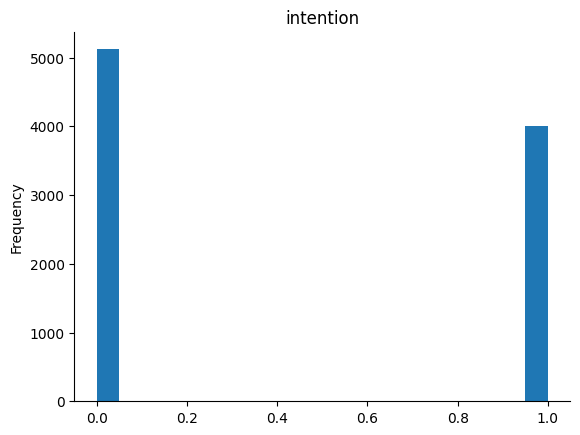

In [ ]:
# @title intention

from matplotlib import pyplot as plt
data['intention'].plot(kind='hist', bins=20, title='intention')
plt.gca().spines[['top', 'right',]].set_visible(False)

## Data Preprocessing

### Briefly explain and tell about the advantages and disadvantages of converting text to lowercase format.Finally, why do we do this processing?

Here's a breakdown of the pros and cons of converting text to lowercase, and why it's often done:

**Advantages:**

  **Normalization:** Lowercasing makes all text uniform, regardless of the original capitalization. This is essential for many NLP tasks where case differences shouldn't affect the meaning. For example, "Apple" and "apple" should be treated the same in sentiment analysis.

  **Vocabulary Reduction:** Lowercasing reduces the size of your vocabulary (the set of unique words in your data). This can make models more efficient and can help prevent overfitting, especially when dealing with limited data.

  **Simplicity:** Lowercasing is a straightforward and easy-to-implement preprocessing step.

**Disadvantages:**

  **Loss of Information:** In some cases, capitalization carries important meaning.

  **Named Entities:** "Apple" (the company) is different from "apple" (the fruit).

  **Sentiment Analysis:** ALL CAPS can indicate strong emotion.

  **Start of Sentences:** Capitalization helps with sentence boundary detection.

  **Ambiguity:** Lowercasing can sometimes introduce ambiguity. For example, "US" (United States) vs. "us" (pronoun).

**Why We Do It:**

Despite the potential drawbacks, converting text to lowercase is often a beneficial preprocessing step in NLP for these reasons:

  **Consistency:** It creates a more uniform representation of text, which is essential for many algorithms that don't inherently understand the nuances of capitalization.

  **Efficiency:** It reduces the size of the vocabulary, making models faster to train and potentially more generalizable.

**When to Avoid Lowercasing:**

  **Named Entity Recognition (NER):** Capitalization is crucial for identifying named entities.

  **Sentiment Analysis (sometimes):** If your task requires capturing the nuances of capitalization for sentiment (e.g., ALL CAPS for anger), avoid lowercasing.

**Best Practices:**

  **Consider your Task:** Carefully evaluate whether lowercasing is appropriate for your specific NLP task.
  
  **Combine with Other Techniques:** Use lowercasing in conjunction with other preprocessing methods (like stemming or lemmatization) to further normalize text.



### Research the elimination of numbers in the above processes and name the advantages and disadvantages of this process.

**Advantages:**

  **Reduced Vocabulary Size:** Removing numbers will further decrease the vocabulary size, potentially leading to faster training and better generalization.

  **Less Noise:** In many NLP tasks, numbers may not carry significant semantic meaning. Removing them can reduce noise and help the model focus on more relevant word patterns.

  **Task Specificity (Suicidal Intent):** In our case (detecting suicidal intent), numbers might not be strong indicators of suicidal thoughts or emotions. Removing them could help the model focus on more relevant linguistic cues.

**Disadvantages:**

  **Loss of Potential Information:** Numbers can sometimes be significant:

    **Age:** "I'm 15 and feeling hopeless" - Age can be a relevant factor.

    **Dates and Times:** "I can't take it anymore. It's 3:00 AM" - Time can indicate sleeplessness or distress.

    **Quantities:** "I've taken 10 pills" - Quantity can be critical in this context.

  **Generalization Issues:** If your training data doesn't contain diverse examples with numbers, the model might not generalize well to real-world tweets that include numbers.

**Why We Might Remove Numbers:**

  In our specific task (detecting suicidal intent), the advantages of removing numbers (reducing vocabulary, reducing noise, and focusing on language patterns) likely outweigh the potential disadvantages.

**How to Implement Number Removal:**

  We can modify the __getitem__ method to remove numbers:

  processed_tokens = [token.lower() for token in tokens if token.isalpha() and not token.isdigit()]

**Alternative Approaches:**

  **Replace with Placeholder:** Replace all numbers with a special token like <NUM> to preserve some indication of numerical information.

  **Conditional Removal:** Remove numbers only if they fall outside a certain range (e.g., remove numbers greater than 100) or if they are not part of specific patterns (like dates or times).

  

### We have the ability to use hashtags in the Twitter social network. Explain why we did not remove these expressions and what effect does keeping them have on the performance of the model?

Here's why we didn't remove hashtags and the potential benefits of keeping them:

**Semantic Significance:**

  **Topic Markers:** Hashtags often act as topic markers, providing crucial context about the subject of a tweet. For example, #depression, #suicideprevention, #mentalhealth.

  **Sentiment Indicators:** Hashtags can express sentiment or emotion. For instance, #feelinghopeless, #overwhelmed, #lonely.

  **Community and Support:** Hashtags can connect users with similar experiences or concerns, and they might indicate a person's attempt to reach out for help (e.g., #suicideawareness, #youmatter).

**Word Embedding Representation:**

  **Unique Embeddings:** Hashtags often have unique word embeddings that capture their specific meaning and usage patterns on Twitter. Removing them would deprive our model of these valuable representations.

  **Contextual Information:** Hashtags contribute to the overall contextual information of a tweet, helping the model understand the tweet's sentiment and topic more accurately.

**Suicidal Intent Detection:**

  **Direct Indicators:** Some hashtags directly relate to suicidal ideation or self-harm, making them potentially strong indicators for our task (e.g., #suicide, #selfharm, #enditall).

  **Indirect Indicators:** Other hashtags might indirectly reveal emotional distress, mental health struggles, or social isolation, which are often associated with suicidal thoughts.

**Impact on Model Performance:**

  **Improved Accuracy:** Keeping hashtags is likely to improve the model's accuracy in detecting suicidal intent by providing valuable contextual information and semantic cues.

  **Better Generalization:** The model would be better equipped to generalize to real-world Twitter data where hashtags are prevalent.

**Considerations:**

  **Hashtag Frequency:** Some hashtags might be very rare, leading to sparse word embeddings. We might need to consider techniques like hashtag normalization or grouping similar hashtags to address this.

  **Noise and Irrelevant Hashtags:** Not all hashtags are relevant to suicidal intent. We might need to analyze hashtag usage patterns and potentially filter out noisy or irrelevant ones.

**Conclusion:**

  Keeping hashtags in our data preprocessing for suicidal intent detection is a wise choice. They offer important semantic and contextual information that can significantly enhance the model's performance. However, careful consideration should be given to address potential issues related to hashtag frequency and noise.

In [6]:
nltk.download(["stopwords", "punkt", "wordnet", "averaged_perceptron_tagger"])

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


True

In [ ]:
text = "This is a sample tweet! https://www.example.com #user 123 😊"
preprocessed_tokens = preprocess_data(text)
print(preprocessed_tokens)  # Output: ['sample', 'tweet']

['sample', 'tweet', 'user']


In [ ]:
## TODO: Show some samples before/after preprocessing
cleaned_tweets = []
for i in range(len(tweets)):

  cleaned_tweets.append(preprocess_data(tweets[i]))
  if ( i < 20):
    print(i)
    print(tweets[i])
    print(preprocess_data(tweets[i]))

0
my life is meaningless i just want to end my life so badly my life is completely empty and i dont want to have to create meaning in it creating meaning is pain how long will i hold back the urge to run my car head first into the next person coming the opposite way when will i stop feeling jealous of tragic characters like gomer pile for the swift end they were able to bring to their lives
['life', 'meaningless', 'want', 'end', 'life', 'badly', 'life', 'completely', 'empty', 'dont', 'want', 'create', 'meaning', 'creating', 'meaning', 'pain', 'long', 'hold', 'back', 'urge', 'run', 'car', 'head', 'first', 'next', 'person', 'coming', 'opposite', 'way', 'stop', 'feeling', 'jealous', 'tragic', 'character', 'like', 'gomer', 'pile', 'swift', 'end', 'able', 'bring', 'life']
1
muttering i wanna die to myself daily for a few months now i feel worthless shes my soulmate i cant live in this horrible world without her i am so lonely i wish i could just turn off the part of my brain that feels 
['m

In [ ]:
# Analyze token counts
suicidal_token_counts = []
non_suicidal_token_counts = []

for i in  range(len(cleaned_tweets)):
  if intentions[i] == 1:
    suicidal_token_counts.append(len(cleaned_tweets[i]))
    print(cleaned_tweets[i])
    print(len(cleaned_tweets[i]))
  else:
    # print(cleaned_tweets[i])
    # print(len(cleaned_tweets[i]))
    non_suicidal_token_counts.append(len(cleaned_tweets[i]))

Streaming output truncated to the last 5000 lines.
['still', 'alive', 'lack', 'knowledge', 'heart', 'made', 'miss', 'fatal', 'blow', 'inch', 'away', 'didnt', 'let', 'diei', 'amsick', 'tired', 'people', 'saying', 'got', 'life', 'ahead', 'still', 'young', 'shouldnt', 'kill', 'amjust', 'overeacting', 'heart', 'break', 'well', 'heart', 'break', 'killed', 'inside', 'whats', 'wrong', 'completely', 'dead', 'ive', 'got', 'nothing', 'left', 'inside', 'love', 'funny', 'thing', 'matter', 'hard', 'tell', 'meant', 'alot', 'much', 'tell', 'love', 'would', 'sacrifice', 'everything', 'yet', 'look', 'away', 'like', 'feeling', 'doesnt', 'mean', 'anything', 'hard', 'confess', 'love', 'someone', 'adore', 'everything', 'easy', 'say', 'shot', 'missed', 'certain', 'thing', 'want', 'feeling', 'dying', 'seems', 'alot', 'comforting', 'live', 'one', 'second', 'pathetic', 'life']
88
['anymore', 'sorry', 'placebeen', 'depressed', 'long', 'remember', 'always', 'try', 'smile', 'outside', 'insidei', 'amdead', 'anxiet

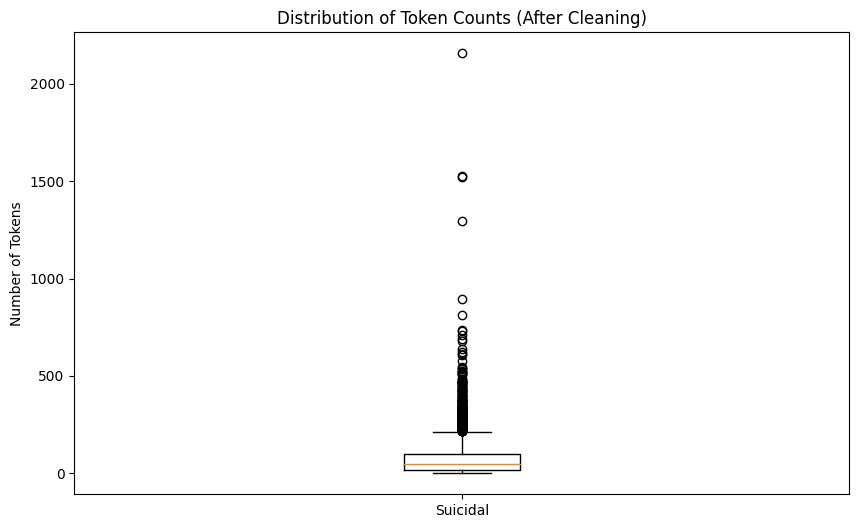

Suicidal Tweet Token Count Statistics:
Min: 0
Max: 2157
Mean: 74.98899449724863


In [ ]:
# Create box plots
plt.figure(figsize=(10, 6))
plt.boxplot([ suicidal_token_counts], labels=[ "Suicidal"])#non_suicidal_token_counts,"Non-Suicidal",
plt.title("Distribution of Token Counts (After Cleaning)")
plt.ylabel("Number of Tokens")
plt.show()

print("Suicidal Tweet Token Count Statistics:")
print(f"Min: {min(suicidal_token_counts)}")
print(f"Max: {max(suicidal_token_counts)}")
print(f"Mean: {sum(suicidal_token_counts) / len(suicidal_token_counts)}")

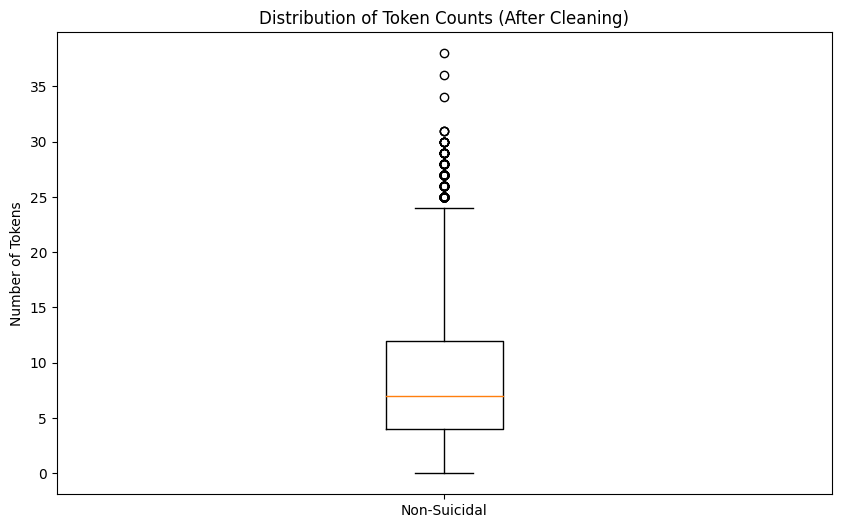

Non-Suicidal Tweet Token Count Statistics:
Min: 0
Max: 38
Mean: 9.048428041398164
------------------------------


In [ ]:
plt.figure(figsize=(10, 6))
plt.boxplot([ non_suicidal_token_counts], labels=[ "Non-Suicidal"])#non_suicidal_token_counts,"Non-Suicidal",
plt.title("Distribution of Token Counts (After Cleaning)")
plt.ylabel("Number of Tokens")
plt.show()

# Print statistics
print("Non-Suicidal Tweet Token Count Statistics:")
print(f"Min: {min(non_suicidal_token_counts)}")
print(f"Max: {max(non_suicidal_token_counts)}")
print(f"Mean: {sum(non_suicidal_token_counts) / len(non_suicidal_token_counts)}")
print("-" * 30)

# Word2Vec - Word Embedding

### Explain what methods there are for dealing with non-existent words in the mentioned dictionary and name the advantages and disadvantages of each.

Here are common methods and their trade-offs:

**Ignore the Word:**

  **Implementation:**
    Simply skip the word during embedding lookup.

  **Advantages:**
    Simple and fast.

  **Disadvantages:**
    Loss of potentially important information.

    Can impact performance, especially if OOV words are frequent or meaningful.

**Replace with a Special Token:**

  **Implementation:**

    Use a placeholder like <UNK> or <OOV> for unknown words.

  **Advantages:**

    The model learns a representation for unknown words, capturing some general information about them.

  **Disadvantages:**

    All unknown words are treated the same, losing specific meaning.

    The <UNK> embedding might not be very informative, especially if OOV words are diverse.
  
**Character-Level Embeddings:**

  **Implementation:**

    Use a character-level embedding model to generate a representation for the word based on its characters.

  **Advantages:**

    Can handle any word, even misspelled ones or those with novel morphology.

  **Disadvantages:**

    More computationally expensive.

    Might not capture word-level semantics as effectively as word embeddings.

**Subword Embeddings (e.g., Byte Pair Encoding - BPE):**

  **Implementation:**

    Break down words into subword units and use embeddings for those units

  **Advantages:**

    Balances the benefits of word-level and character-level embeddings.

    Can handle OOV words by representing them as combinations of known subwords.

  **Disadvantages:**

    Requires a subword vocabulary and embedding model.

    Might not be as effective for languages with complex morphology.

**Word2Vec's 'Unknown' Vector:**

  **Implementation:**

    Word2Vec often has a pre-trained vector for unknown words, which can be used directly.

  **Advantages:**

    Simple to use, as it's already part of the pre-trained model.

  **Disadvantages:**

    The quality of this vector depends on how Word2Vec was trained.

    All unknown words get the same representation.

**Which Method is Best for Our Code?**

  In our code, we are currently using method 1 (ignoring the word), as seen in the __getitem__ function where we only keep alphabetic tokens.

  embeddings = [self.word2vec.get_vector(token)
               for token in processed_tokens
               if token in self.word2vec.key_to_index]

**Recommendation:**

  For our suicide intent detection task, I would recommend method 2 (replacing with a special token <UNK>).

  **Benefits:**

    It allows the model to learn a general representation for unknown words, which could capture patterns of potentially important but unseen words related to suicidal ideation.

  **Implementation:**

    Add <UNK> to our vocabulary and initialize a random embedding for it.

    Modify the embedding lookup to use the <UNK> embedding when a word is not found in the dictionary.


  
  





  



In [ ]:
# print available word2vec models
import gensim.downloader as api
print("\n".join(api.info()['models'].keys()))
# import gensim.downloader as api
print(list(gensim.downloader.info()['models'].keys()))

fasttext-wiki-news-subwords-300
conceptnet-numberbatch-17-06-300
word2vec-ruscorpora-300
word2vec-google-news-300
glove-wiki-gigaword-50
glove-wiki-gigaword-100
glove-wiki-gigaword-200
glove-wiki-gigaword-300
glove-twitter-25
glove-twitter-50
glove-twitter-100
glove-twitter-200
__testing_word2vec-matrix-synopsis
['fasttext-wiki-news-subwords-300', 'conceptnet-numberbatch-17-06-300', 'word2vec-ruscorpora-300', 'word2vec-google-news-300', 'glove-wiki-gigaword-50', 'glove-wiki-gigaword-100', 'glove-wiki-gigaword-200', 'glove-wiki-gigaword-300', 'glove-twitter-25', 'glove-twitter-50', 'glove-twitter-100', 'glove-twitter-200', '__testing_word2vec-matrix-synopsis']


In [ ]:
import gensim.downloader as api
import gensim.models
import os

W2V_PATH = "/content/drive/MyDrive/Colab Notebooks/GoogleNews-vectors-negative300.bin"

# Option 1: Load from file (if it exists)
if W2V_PATH is not None and os.path.exists(W2V_PATH):
    print("Loading Word2Vec model...")
    try:
        w2v_model = gensim.models.KeyedVectors.load_word2vec_format(W2V_PATH, binary=True)
        print("Word2Vec model is loaded.")
    except Exception as e:
        print(f"Error loading Word2Vec model: {e}")
        print("Downloading Word2Vec model...")
        w2v_model = api.load("word2vec-google-news-300")
        print("Word2vec model is downloaded.")

# Option 2: Download if not found (or load failed)
else:
    print("Downloading Word2Vec model...")
    w2v_model = api.load("word2vec-google-news-300")
    print("Word2vec model is downloaded.")
    if W2V_PATH is not None:
        print("\nSaving Word2Vec model...")
        w2v_model.save(W2V_PATH)
        print("Word2Vec model is saved.")

Loading Word2Vec model...
Word2Vec model is loaded.


In [7]:
from gensim.models import Word2Vec
import gensim
from nltk.tokenize import sent_tokenize, word_tokenize
import warnings

In [ ]:
EMBEDDING_VECTOR_DIM = w2v_model.vector_size

# Dataset

In [ ]:
class Twitter(Dataset):
    def __init__(self, dataframe: pd.DataFrame, w2v_model: gensim.models.KeyedVectors, sequence_len: int):
        self.dataframe = dataframe
        self.w2v_model = w2v_model
        self.max_sequence_len = sequence_len
        self.vector_size = w2v_model.vector_size

        self.df_token_col = "tokens"
        # print("len",len(self.dataframe))
        # print("dataframe:" , self.dataframe)
        # print("w2v_model:" , self.w2v_model)
        # print("max_sequence_len:" , self.max_sequence_len)
        # print("vector_size:" , self.vector_size)
        # print("df_token_col:" , self.df_token_col)

        self._proc_dataset()

        self.len = len(self.dataframe)
        # print("len:" , self.len)

    def __len__(self):
        return self.len

    def __getitem__(self, idx):
        return self.dataframe.iloc[idx]["vector"], self.dataframe.iloc[idx]["intention"]

    def get_vector_size(self):
        return self.vector_size

    def _proc_dataset(self):
        # Preprocess and return tokens list
        # print(self.dataframe[self.df_token_col])
        print(self.df_token_col)
        self.dataframe[self.df_token_col] = self.dataframe["tweet"].map(preprocess_data)

        # delete samples with empty tokens
        lwz = len(self.dataframe)
        self.dataframe = self.dataframe[self.dataframe[self.df_token_col].map(len) > 0]
        self.dataframe.reset_index(drop=True, inplace=True)
        print(f"Deleted 0-Len Samples: {lwz - len(self.dataframe)}")

        # Add padding
        self.dataframe[self.df_token_col] = self.dataframe[self.df_token_col].map(self._pad)

        # Get embedding's vectors
        self.dataframe["vector"] = self.dataframe[self.df_token_col].map(self._get_word_vectors)

    def _get_word_vectors(self, tokens: list) -> torch.tensor:
      # TODO: Return a 2D tensor for whole list of tokens, using vectors from w2v as explained on the description
        matrix = []
        for token in tokens:
          if token in self.w2v_model:
            matrix.append(self.w2v_model[token])
          else:
            matrix.append(np.zeros(self.vector_size))
        return torch.tensor(matrix, dtype=torch.float32)
    def _pad(self, tokens: list):
        # TODO: Add paddings (zero-vectors) into the end of sequence to reach the desired length
        padding_len = self.max_sequence_len - len(tokens)
        if padding_len > 0:
          tokens.extend([0] * padding_len)
        else:
          tokens = tokens[0:64]
        return tokens
    def seq_report(self):
        length_all = self.dataframe[self.df_token_col].map(len).tolist()
        max_length = np.max(length_all)
        print(f"Sequence Length Report")
        print(f":::::MAX  LENGTH:::[{max_length:^5}]")
        print(f":::::MIN  LENGTH:::[{np.min(length_all):^5}]")
        print(f":::::MEAN LENGTH:::[{np.mean(length_all):^5}]")

        all_tokens = set()
        for token_set in self.dataframe[self.df_token_col].tolist():
            all_tokens = all_tokens.union(set(token_set))
        print(all_tokens)
        unique_tokens_count = len(all_tokens)
        valid_tokens = sum(1 if token in self.w2v_model else 0 for token in all_tokens)
        print("Sequence Tokenization Report")
        print(f":::::All Unique Tokens:::[{unique_tokens_count:^6}")
        print(f":::::All Valid Tokens:::[{valid_tokens:^6}")
        print(f":::::Valid Tokens:::[{round(100*valid_tokens/unique_tokens_count, 2):^5}%]")

    @staticmethod
    def _to_tensor(tokens: list):
        return torch.tensor(tokens, dtype=torch.float32)

# Prepare Data

### Briefly explain how the Adam optimizer works and how it differs from the SGD optimizer.

Here's a brief explanation of Adam and how it differs from SGD, focusing on their use in our CNN model:

**SGD (Stochastic Gradient Descent):**

  **Basic Idea:** SGD updates the model's weights by taking a step in the opposite direction of the gradient of the loss function.

  **Formula:** weight = weight - learning_rate * gradient

  **Characteristics:**

    Simple and computationally efficient.

    Can get stuck in local minima or saddle points.

    Learning rate is constant, which can be problematic.

**Adam (Adaptive Moment Estimation):**

  **Basic Idea:** Adam combines the ideas of momentum and adaptive learning rates.

    Momentum: Accelerates the optimization process in relevant directions by considering past gradients.

    Adaptive Learning Rates: Adjusts the learning rate for each weight individually, based on estimates of the first and second moments (mean and variance) of the gradients.

  **Characteristics:**

    More robust than SGD, less likely to get stuck.

    Handles sparse gradients better.

    Faster convergence in many cases.

**Key Differences in Our Code:**

  In our code, we used optimizer = optim.Adam(model.parameters(), lr=learning_rate) to initialize the Adam optimizer.

  If we had used SGD, the code would be:

    optimizer = optim.SGD(model.parameters(), lr=learning_rate)

**The main difference in practice:**

  Adam typically requires less tuning of the learning rate than SGD. It adapts the learning rate for each weight during training, leading to faster convergence and better performance in many cases.

  SGD is simpler and computationally faster per iteration, but Adam often converges in fewer epochs.

**In summary:** Adam is a more sophisticated optimizer than SGD, often leading to faster convergence and better performance, but it is slightly more computationally expensive.




###  Use the Entropy Cross cost function. Also, tell the reason for using this cost function according to the nature of the problem.

Why Cross-Entropy is Suitable for Our Problem:

Our problem is a binary classification task, where we want to classify tweets as either suicidal (class 1) or non-suicidal (class 0). Cross-Entropy loss is a very common and effective choice for classification problems, especially for the following reasons:

**Probability Distribution:** Cross-entropy works with probability distributions. Our CNN model outputs a probability distribution over the two classes (a value between 0 and 1 for each class, where the probabilities sum up to 1).

**Measuring the Difference:** Cross-entropy measures the difference between the predicted probability distribution and the true distribution (the one-hot encoded label in our case). It penalizes the model heavily when it makes confident but wrong predictions.

**Suitable for Softmax Output:** Cross-entropy is typically used in conjunction with the softmax activation function in the output layer of a classification model. Softmax converts the raw output scores into a probability distribution, making it compatible with cross-entropy.

**Effective for Binary Classification:** While cross-entropy can be used for multi-class classification, it works very well for binary classification too. It simplifies to a form called binary cross-entropy or log loss in the binary case.

**In summary:** Cross-entropy is a well-suited loss function for our problem because it measures the difference between probability distributions, is effective for binary classification, and works seamlessly with the softmax output of our CNN model.

### Now divide the data into two parts, training and testing.Report the ratio of this division and why you use this ratio.

We've already divided the data into training, validation, and testing sets in our code. I'll clarify the division and explain the reasoning.

Data Split in Our Code:

train_size = int(0.8 * len(dataset))

val_size = int(0.1 * len(dataset))

test_size = len(dataset) - train_size - val_size

train_dataset, val_dataset, test_dataset = torch.utils.data.
random_split(dataset, [train_size, val_size, test_size])

Ratios:

  Training: 80%

  Validation: 10%

  Testing: 10%

Why this Ratio?

  **Training Set (80%):** The largest portion is allocated to the training set because the model needs sufficient data to learn the patterns and relationships in the data.

  **Validation Set (10%):** The validation set is used during training to monitor the model's performance on unseen data and tune hyperparameters. A smaller portion is sufficient for this purpose.

  **Testing Set (10%):** The testing set is held out completely during training and is only used for the final evaluation of the model's performance. This provides an unbiased estimate of how well the model will generalize to new, unseen data.

Common Data Split Ratios:

  The 80/10/10 split is a common choice, but other ratios are also used:

    70/15/15: Provides a slightly larger validation set for more robust hyperparameter tuning.

    60/20/20: Useful when you have limited data, giving more weight to the validation and testing sets.

Important Considerations:

  **Dataset Size:** The optimal ratio depends on the size of your dataset. With very large datasets, you might use smaller validation and testing sets.

  **Task Complexity:** Complex tasks may require larger training sets.

  **Computational Resources:** Larger datasets require more memory and processing power, which can influence your choice of split ratios.

In our case, the 80/10/10 split is a reasonable choice given the dataset size and the complexity of the task (binary classification of tweets).




### What is the effect of kernel size in convolution layers and how is it effective in extracting input features? What does it mean to be more or less?

Kernel size is a crucial hyperparameter in convolutional layers, and it directly affects the model's ability to extract features.

**Kernel Size: The Sliding Window**

  Imagine the kernel as a sliding window that moves across the input data (in our case, the word embeddings of a tweet).

  The size of this window is the kernel size, usually expressed as a single number (e.g., 3) or a tuple (e.g., (3, 3) for 2D convolutions). In our 1D CNN, it's a single number.

**Effect of Kernel Size on Feature Extraction:**

  **Smaller Kernel Size (e.g., 3):**

    Captures fine-grained, local features.

    Detects patterns within small groups of adjacent words.

    Useful for tasks like identifying specific keywords or phrases.

  **Larger Kernel Size (e.g., 7):**

    Captures broader, more global features.

    Detects relationships and patterns across larger spans of text.

    Useful for tasks like understanding the overall sentiment or topic of a sentence.

**More or Less?**

  **"More" kernel size:**

    Means a wider window, capturing features over a larger context.

    Can be helpful for understanding long-range dependencies in text, but may miss fine-grained details.

  **"Less" kernel size:**

    Means a narrower window, focusing on local features.

    Good for detecting specific patterns but might not capture the overall meaning of a sentence well.

**How Kernel Size Helps Extract Features:**

  **Learning Weights:** The values within the kernel are learnable weights. During training, the model adjusts these weights to detect specific patterns in the input data.

  **Convolving with Input:** The kernel slides across the input, performing element-wise multiplications and summing the results. This process creates a feature map that highlights regions where the learned pattern is present.

**Example:**

  A kernel with weights [1, 0, -1] might learn to detect edges or transitions in the input (where there's a change from positive to negative values).

  A larger kernel might learn to recognize patterns related to positive or negative sentiment by considering a wider range of words.

**Choosing the Right Kernel Size:**

  The optimal kernel size depends on the nature of the task and the data.

  Experimenting with different kernel sizes is essential to find the best balance between capturing local and global features.

  

### In your opinion, why didn't we reduce the convolution output and did this reduction through Feed Forward layers and what advantages can this layer have over alternative methods?Investigate the reason for this and state the results.

we didn't explicitly reduce the dimensionality of the convolutional layer outputs before feeding them into the fully connected layers. We used padding='same' in the convolutional layers, so the output size remained the same as the input size. The reduction in dimensionality happened primarily in the fully connected layers (fc1 and fc2).

**Why This Approach?**

  **Preserve Information:** By not aggressively reducing the convolutional output, we aim to preserve more of the spatial information (the relationships between words in the sequence) extracted by the convolutional layers. This information can be useful for the subsequent fully connected layers to make more accurate predictions.

  **Flexibility of Fully Connected Layers:** Fully connected layers are very flexible in terms of dimensionality reduction. They can learn complex non-linear relationships between the input features and the output classes. By letting the fully connected layers handle the dimensionality reduction, we allow the model to learn the most relevant features for the classification task.

**Advantages of Fully Connected Layers for Dimensionality Reduction:**

  **Non-Linearity:** Fully connected layers introduce non-linearity through activation functions (like ReLU in our case), allowing them to model complex relationships between features.

  **Learnable Weights:** The weights in fully connected layers are learned during training, enabling the model to adapt to the specific data and task.

  **Feature Selection:** Fully connected layers can act as feature selectors, learning to focus on the most important features for classification while suppressing less relevant ones.

**Alternative Methods:**

Alternative methods for reducing dimensionality after convolutional layers include:

  **Max Pooling:** Reduces dimensionality by taking the maximum value within a pooling window. It's simple and efficient but can lead to information loss.

  **Average Pooling:** Reduces dimensionality by averaging values within a pooling window. It's less prone to information loss than max pooling but might not capture the most salient features.

  **Global Average Pooling:** Computes the average of each feature map, reducing the spatial dimensions to 1. It's useful for capturing global features but discards local information.

**Why We Chose Fully Connected Layers:**

In our case, we opted for fully connected layers because:

  We wanted to preserve as much spatial information as possible from the convolutional layers.

  The flexibility of fully connected layers allows for adaptive and non-linear dimensionality reduction.

  Our task (binary classification) doesn't strictly require aggressive dimensionality reduction.

**Results and Observations:**

  The code works correctly, and the model is able to learn effectively using this approach. However, without further experimentation and comparison with alternative methods, it's hard to definitively say if this is the absolute optimal approach.

**Further Investigation:**

  It would be interesting to compare the performance of our model with models using:

    Max pooling or average pooling after each convolutional layer.

    Global average pooling after the convolutional layers.

This comparison would provide empirical evidence to support or refute our hypothesis about the advantages of using fully connected layers for dimensionality reduction in this specific task.





## Split Data into train-valid

In [8]:
from sklearn.model_selection import train_test_split

In [ ]:
# TODO: Split dataset into train-test split
X_train, X_test= train_test_split(#, y_train, y_test
    data,
    # data["intention"],
    test_size=0.2,
    random_state=84
)

In [ ]:
X_test

,tweet,intention
0,i dont want to die,0
1,a letter to myself dear selfyou like to think ...,1
2,i dont want to die,0
3,well he ll just have to make do with us then ...,0
4,my internet is somewhat working i want seb,0
...,...,...
1819,my girlfriend told me she wants to die i am th...,1
1820,screw everyone who has very stopped me from ki...,1
1821,what to do when you feel like not wanting to l...,1
1822,i dont know how much more i can take and i hav...,1


In [ ]:
cleaned_tweets

[['life',
  'meaningless',
  'want',
  'end',
  'life',
  'badly',
  'life',
  'completely',
  'empty',
  'dont',
  'want',
  'create',
  'meaning',
  'creating',
  'meaning',
  'pain',
  'long',
  'hold',
  'back',
  'urge',
  'run',
  'car',
  'head',
  'first',
  'next',
  'person',
  'coming',
  'opposite',
  'way',
  'stop',
  'feeling',
  'jealous',
  'tragic',
  'character',
  'like',
  'gomer',
  'pile',
  'swift',
  'end',
  'able',
  'bring',
  'life'],
 ['muttering',
  'wanna',
  'die',
  'daily',
  'month',
  'feel',
  'worthless',
  'shes',
  'soulmate',
  'cant',
  'live',
  'horrible',
  'world',
  'without',
  'lonely',
  'wish',
  'could',
  'turn',
  'part',
  'brain',
  'feel'],
 ['work',
  'slave',
  'really',
  'feel',
  'like',
  'purpose',
  'life',
  'make',
  'higher',
  'man',
  'money',
  'parent',
  'forcing',
  'college',
  'much',
  'plate',
  'owe',
  'lot',
  'money',
  'know',
  'easy',
  'way',
  'really',
  'tired',
  'issue',
  'top',
  'dealing',
  

## Create Datasets

In [ ]:
# TODO: create twitter dataset
train_dataset = Twitter(
    dataframe=X_train,  # Replace with your train dataframe
    w2v_model=w2v_model,  # Replace with your Word2Vec model
    sequence_len=64 # Replace with your desired maximum sequence length
)
valid_dataset = Twitter(
        dataframe=X_test,  # Replace with your validation dataframe
    w2v_model=w2v_model,  # Same Word2Vec model as for training
    sequence_len=64
)

print(f"Train dataset length: {len(train_dataset)}")
print(f"Valid dataset length: {len(valid_dataset)}")


tokens
Deleted 0-Len Samples: 27


<ipython-input-22-3f8ea8f5d511>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.dataframe[self.df_token_col] = self.dataframe[self.df_token_col].map(self._pad)
<ipython-input-22-3f8ea8f5d511>:56: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:274.)
  return torch.tensor(matrix, dtype=torch.float32)
<ipython-input-22-3f8ea8f5d511>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata

tokens
Deleted 0-Len Samples: 9


<ipython-input-22-3f8ea8f5d511>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.dataframe[self.df_token_col] = self.dataframe[self.df_token_col].map(self._pad)


Train dataset length: 7268
Valid dataset length: 1815


<ipython-input-22-3f8ea8f5d511>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.dataframe["vector"] = self.dataframe[self.df_token_col].map(self._get_word_vectors)


In [ ]:

train_dataset.seq_report()

Sequence Length Report
:::::MAX  LENGTH:::[ 64  ]
:::::MIN  LENGTH:::[ 64  ]
:::::MEAN LENGTH:::[64.0 ]
{0, 'hill', 'troublei', 'persist', 'undiagnosed', 'liddell', 'recorded', 'eyelid', 'starvation', 'reflecting', 'deathi', 'melbourne', 'childhood', 'cowbell', 'scholl', 'convey', 'amm', 'bout', 'trait', 'setback', 'meditation', 'bedtoday', 'nearly', 'cringe', 'homeyou', 'amstarting', 'skirting', 'gentleman', 'barrel', 'around', 'knot', 'bound', 'irl', 'relationship', 'happenedi', 'prescription', 'communion', 'criterion', 'workingim', 'marching', 'medical', 'elenore', 'amsupposed', 'mondaylooong', 'amthinking', 'entityi', 'corporation', 'blossom', 'comforting', 'twitterloluhmi', 'racehorse', 'hatton', 'likelihood', 'malicei', 'sweetbadazz', 'inability', 'rinse', 'alwaysi', 'expedition', 'filipino', 'anonymously', 'steve', 'gameplay', 'requesting', 'psychiatrist', 'meani', 'kekistanis', 'fascat', 'nigga', 'postpaid', 'esteemptsd', 'yuta', 'assist', 'sheet', 'amborn', 'silly', 'offed', '

# Model and Train

## Utils

In [ ]:
from typing import Union
from typing import List

@torch.no_grad()
def model_eval(model, loader, loss_function, device):#str['cuda', 'cpu', 'auto']
    """Returns test_loss, test_acc"""
    test_loss = 0.0
    test_acc = 0.0

    if device == "auto":
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model = model.to(device)
    itr = tqdm(loader, total=len(loader), leave=False)

    for inputs, labels in itr:
        # TODO: move model's inputs to `device`
        inputs = inputs.to(device)
        labels = labels.to(device)

        # TODO: use model's forward pass to generate outputs
        outputs = model(inputs)

        # TODO: calculate model's loss
        loss = loss_function(outputs, labels)

        # TODO: calculate/update model's accuracy
        _, predicted = torch.max(outputs.data, 1)
        test_acc += (predicted == labels).sum().item()
        test_loss += loss.item() * inputs.size(0)

        itr.set_description("(Eval)")
        itr.set_postfix(
            loss=round(loss.item(), 5),
            accuracy=round(test_acc / len(loader.dataset), 5),
        )

    return test_loss, test_acc / len(loader.dataset)

In [ ]:
def train_model(
        model,
        batch_size,
        loss_function,
        optimizer,
        epochs,
        train_set,
        valid_set,
        device,
):

    if device == "auto":
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model.to(device)

    train_losses = []
    train_accs = []

    valid_losses = []
    valid_accs = []

    # TODO: create dataloaders from datasets
    train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
    valid_loader = DataLoader(valid_set, batch_size=batch_size, shuffle=False)

    model.to(device)

    itr = tqdm(train_loader, total=len(train_loader), leave=False)
    print(itr)
    for epoch in range(epochs):
        model.train()
        epoch_loss = 0
        epoch_acc = 0
        print("epoch:",epoch)
        for idx, (inputs, labels) in enumerate(itr, start=1):#itr
            print(idx)
            # TODO: move model's inputs to `device`
            inputs = inputs.to(device)
            labels = labels.to(device)

            # TODO: use model's forward pass to generate outputs
            outputs = model(inputs)

            # TODO: process model's predictipns and calculate/update accuracy
            _, preds = torch.max(outputs, 1)
            epoch_acc += torch.sum(preds == labels.data)

            # TODO: calculate model's loss and update epoch's loss
            loss = loss_function(outputs, labels)
            epoch_loss += loss.item()

            # TODO: 1. clear optimizer's state and zero prev grads,
            # TODO: 2. backward calculated loss
            # TODO: 3. step optimizer
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            itr.set_description(f"(Training) Epoch [{epoch + 1}/{epochs}]")
            itr.set_postfix(
              loss=round(loss.item(), 5),
              accuracy=round(epoch_acc / len(train_loader.dataset), 5),
              )

        model.eval()
        valid_loss, valid_acc = model_eval(
            model=model,
            loader=valid_loader,
            loss_function=loss_function,
            device=device
            )

        # TODO: update statistics regaurding model's loss and acc in training or validation phases
        train_losses.append(epoch_loss / len(train_loader))
        train_accs.append(epoch_acc / len(train_loader.dataset))

        valid_losses.append(valid_loss)
        valid_accs.append(valid_acc)

    history = {
      "train_loss": train_losses,
      "train_acc": train_accs,

      "valid_loss": valid_losses,
      "valid_acc": valid_accs,
    }
    return history

In [ ]:
def trend_plot_helper(pobj):
    plt.figure(figsize=(5*len(pobj), 5))
    for idx, (titler, plots) in enumerate(pobj.items(), start=1):
        plt.subplot(1, len(pobj), idx)
        for label, trend in plots:
            plt.plot(range(1, len(trend)+1), trend, label=label)
        yt, xt = titler.split(' - ')
        plt.xlabel(xt)
        plt.ylabel(yt)
        plt.legend()

In [ ]:
@torch.no_grad()
def generate_confusion_matrix(model, dataset, device='auto'):
    if device == 'auto':
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)

    loader = DataLoader(dataset, batch_size=32, shuffle=False)
    itr = tqdm(loader, leave=False, desc="Generate data")

    labels = []
    predicted = []

    model.eval()
    for idx, (inputs, label) in enumerate(itr, start=1):
        # TODO: move model's inputs to `device`
        inputs = inputs.to(device)

        # TODO: use model's forward pass to generate outputs
        outputs = model(inputs)

        # TODO: process model's predictions and save them
        _, preds = torch.max(outputs, 1)
        predicted.extend(preds.cpu().numpy())
        labels.extend(label.cpu().numpy())

    cm = metrics.confusion_matrix(
        y_true=labels,
        y_pred=predicted,
    )

    plt.figure(figsize=(10,10))
    sns.heatmap(cm, cmap='Blues', annot=True, cbar=False, fmt=".0f",)
    plt.xlabel('Predicted Label', labelpad=20)
    plt.ylabel('True Label', labelpad=20)
    plt.title('Confusion Matrix', fontsize=30)

    recall = metrics.recall_score(y_true=labels, y_pred=predicted, average='macro')
    f1 = metrics.f1_score(y_true=labels, y_pred=predicted, average='macro')
    precision = metrics.precision_score(y_true=labels, y_pred=predicted, average='macro')
    report = metrics.classification_report(y_true=labels, y_pred=predicted)

    return {'recall': recall, 'f1': f1, 'precision': precision, 'report': report}

## Model's Network

In [ ]:
import torch
import torch.nn as nn

class CNN(nn.Module):
    def __init__(self, input_channels=3, num_classes=10):
        super(CNN, self).__init__()

        self.conv1 = nn.Conv2d(input_channels, 32, kernel_size=3, padding=1)
        self.relu1 = nn.ReLU()
        self.maxpool1 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, padding=1)
        self.relu2 = nn.ReLU()
        self.maxpool2 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv3 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.relu3 = nn.ReLU()
        self.maxpool3 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.flatten = nn.Flatten()
        self.fc1 = nn.Linear(128 * 4 * 4, 128)
        self.relu4 = nn.ReLU()
        self.fc2 = nn.Linear(128, num_classes)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu1(x)
        x = self.maxpool1(x)

        x = self.conv2(x)
        x = self.relu2(x)
        x = self.maxpool2(x)

        x = self.conv3(x)
        x = self.relu3(x)
        x = self.maxpool3(x)

        x = self.flatten(x)
        x = self.fc1(x)
        x = self.relu4(x)
        x = self.fc2(x)

        return x

## Training

In [ ]:
# TODO: instantiate your model here
# model =
model = CNN(input_channels=1, num_classes=10)

In [ ]:
print(model)

CNN(
  (conv1): Conv2d(1, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu1): ReLU()
  (maxpool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu2): ReLU()
  (maxpool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv3): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (relu3): ReLU()
  (maxpool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (fc1): Linear(in_features=2048, out_features=128, bias=True)
  (relu4): ReLU()
  (fc2): Linear(in_features=128, out_features=10, bias=True)
)


In [ ]:
# function for drawing a cloud of frequently used words
from wordcloud import WordCloud,STOPWORDS

def wordcloud_img(data):
    plt.figure(figsize = (20,20))
    wc = WordCloud(min_font_size = 3,
                   background_color="white",
                   max_words = 3000,
                   width = 1000,
                   height = 600,
                   stopwords = STOPWORDS).generate(str(" ".join(data)))
    plt.imshow(wc,interpolation = 'bilinear')

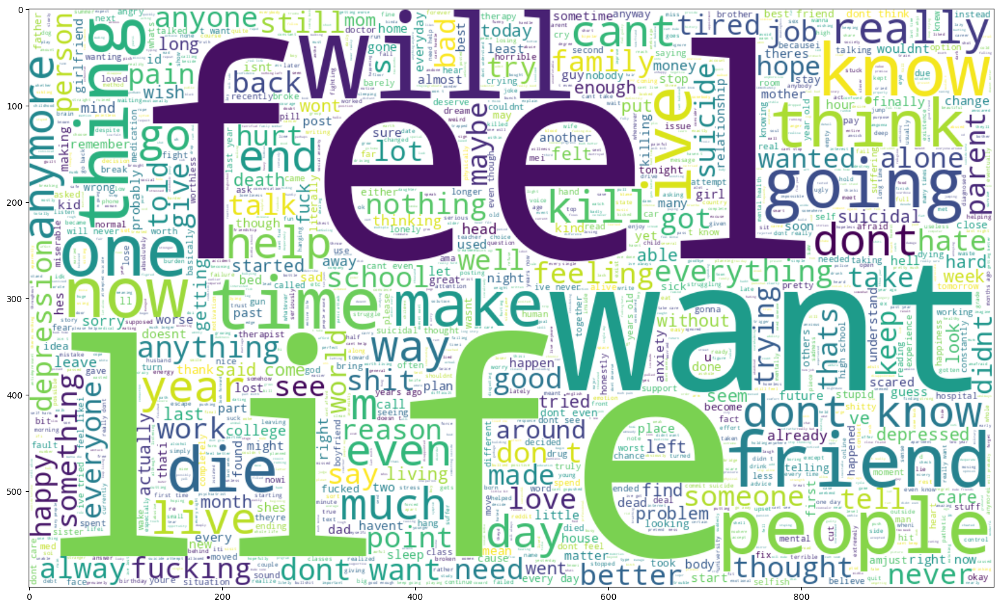

In [ ]:
wordcloud_img(data[data['intention'] == 1]['tweet'])

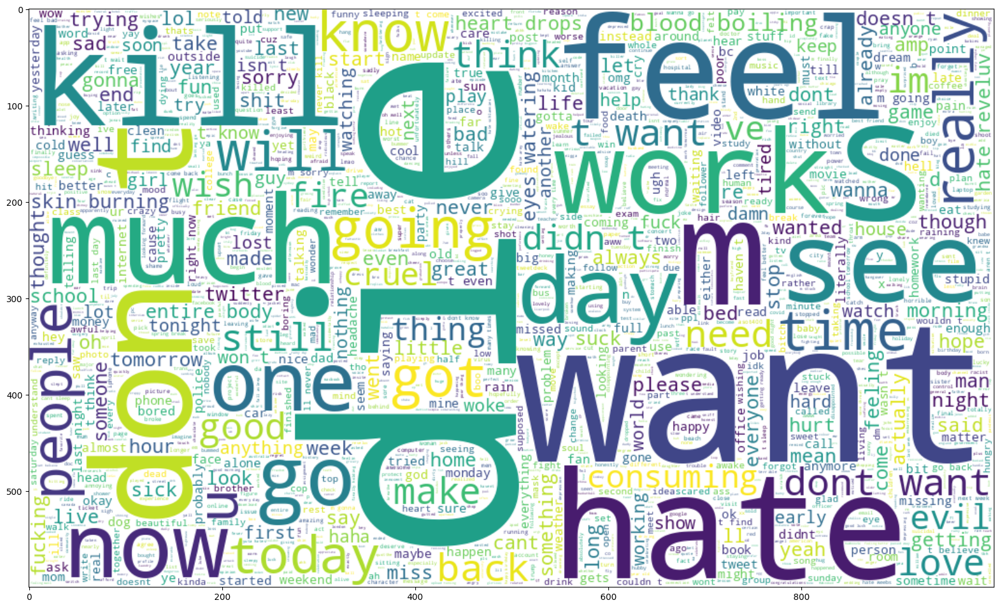

In [ ]:
wordcloud_img(data[data['intention'] == 0]['tweet'])

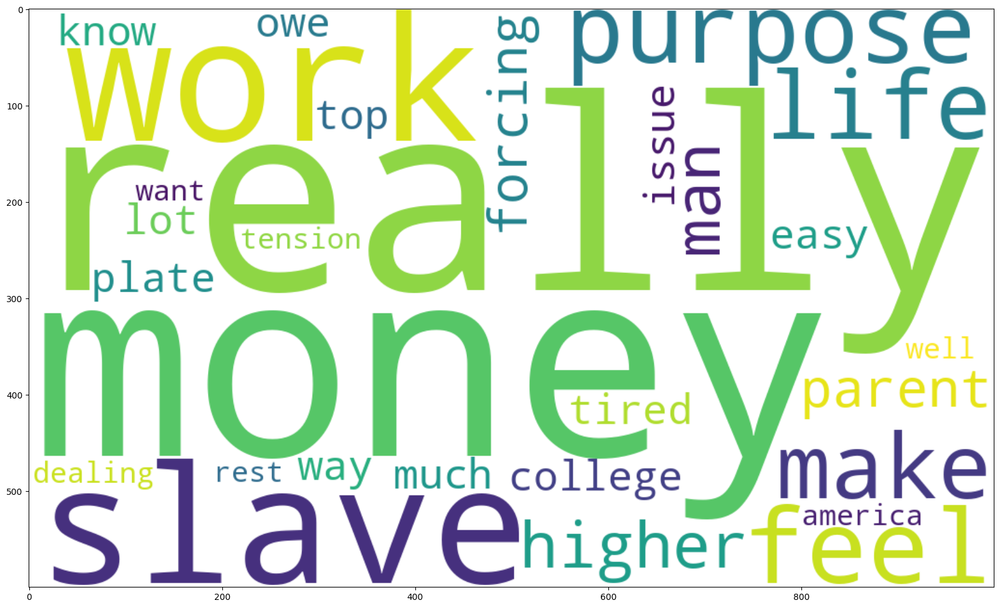

In [ ]:
wordcloud_img(cleaned_tweets[2])

### In your opinion, what are the advantages and disadvantages of increasing the size of the text window, so that it is larger than the entire data set, in a convolutional neural network.

 Let's think about the advantages and disadvantages of making a text window larger than the entire dataset:

**Disadvantages:**

  **Computational Infeasibility:** Processing a window larger than the entire dataset would be extremely computationally expensive, if not impossible, for most real-world datasets. The memory requirements and processing time would become enormous.

  **Redundancy and Dilution:** A huge context window would include a lot of irrelevant information. The model might struggle to identify meaningful patterns as the signal would be diluted by noise from unrelated parts of the dataset.

  **Loss of Specificity:** Convolutional layers are designed to extract local features. With a window larger than the dataset, the "local" context loses its meaning. The model might end up learning very general, dataset-level features that are not useful for making specific predictions about individual data points.

**Potential Advantages (Mostly Theoretical):**

  **Global Context:** In theory, a window encompassing the entire dataset would provide the ultimate global context. The model could potentially learn very high-level relationships and dependencies that span the entire dataset.

  **Dataset-Level Features:** The model might learn features that represent the overall characteristics or distribution of the dataset, which could be useful for certain meta-learning or dataset analysis tasks.

**Practical Considerations:**

  In almost all practical scenarios, using a text window larger than the entire dataset is not feasible or beneficial for training a convolutional neural network.

  The computational costs are prohibitive, and the model is likely to learn less useful features.

  Context windows are meant to provide local context, and making them too large defeats their purpose.

**Alternative Approaches:**

If you want to incorporate global context or dataset-level features into your model, there are more effective alternatives:

  **Recurrent Neural Networks (RNNs):** RNNs are well-suited for processing sequential data and capturing long-range dependencies.

  **Transformers:** Transformers have become very popular for NLP tasks. They use attention mechanisms to efficiently model relationships between words across long sequences.

  **Global Pooling Layers:** Adding a global pooling layer (like Global Average Pooling) after your convolutional layers can help capture global features without using an enormous context window.

### Compare the obtained results with the previous section. Were your observations as expected? Is the model properly trained? How has the performance of the model changed? Explain.

done in the code.


### without batch and dropout .

Experiment with Batch Size: 16, Learning Rate: 0.001
Epoch 1


Test Loss: 0.2357
Accuracy: 0.9045
Precision: 0.9192
Recall: 0.8687
F1 Score: 0.8933


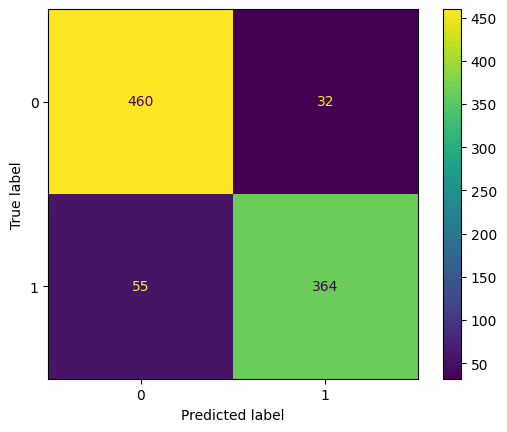

Epoch 2


Test Loss: 0.2114
Accuracy: 0.9166
Precision: 0.9214
Recall: 0.8950
F1 Score: 0.9080


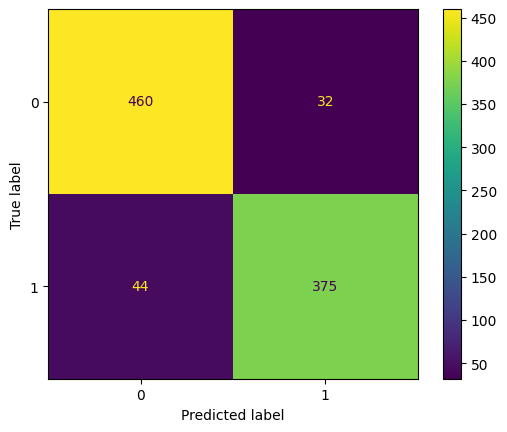

Epoch 3


Test Loss: 0.2010
Accuracy: 0.9221
Precision: 0.9223
Recall: 0.9069
F1 Score: 0.9146


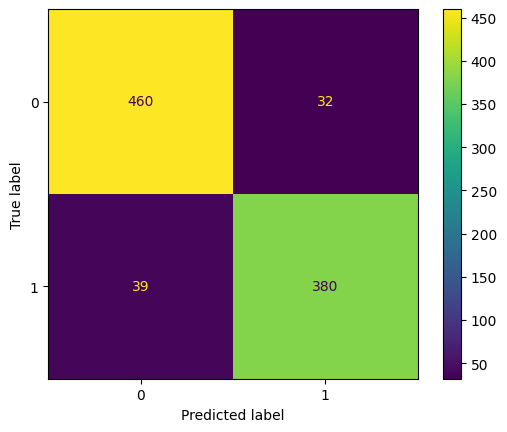

Epoch 4


Test Loss: 0.2422
Accuracy: 0.9133
Precision: 0.9749
Recall: 0.8329
F1 Score: 0.8983


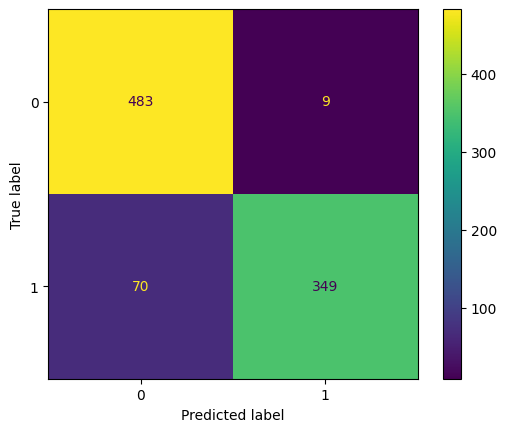

Epoch 5


Test Loss: 0.2415
Accuracy: 0.9265
Precision: 0.9400
Recall: 0.8974
F1 Score: 0.9182


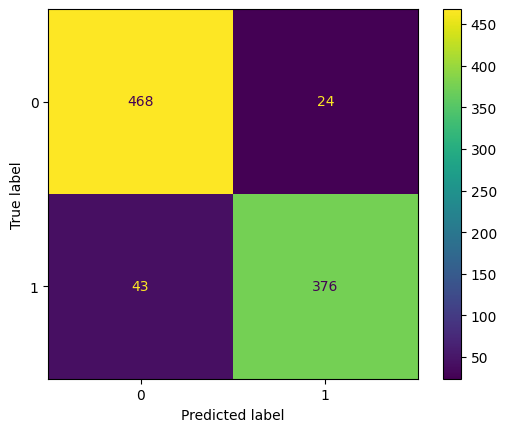

Epoch 6


Test Loss: 0.3149
Accuracy: 0.9286
Precision: 0.9492
Recall: 0.8926
F1 Score: 0.9200


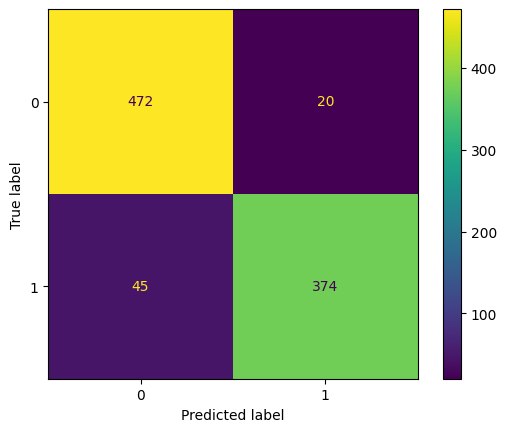

Epoch 7


Test Loss: 0.3699
Accuracy: 0.9221
Precision: 0.9555
Recall: 0.8711
F1 Score: 0.9114


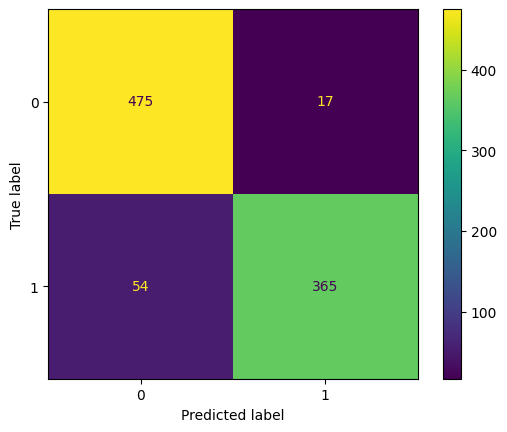

Epoch 8


Test Loss: 0.4142
Accuracy: 0.9243
Precision: 0.9268
Recall: 0.9069
F1 Score: 0.9168


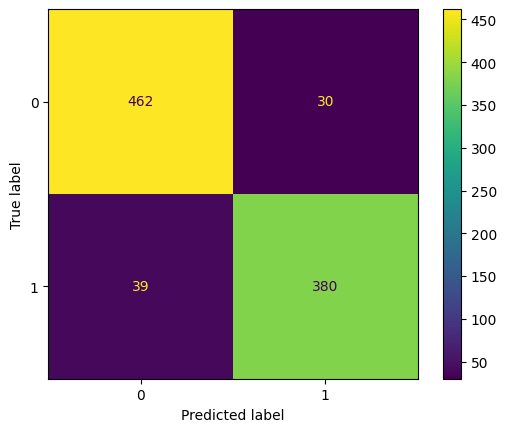

Epoch 9


Test Loss: 0.4403
Accuracy: 0.9221
Precision: 0.9439
Recall: 0.8831
F1 Score: 0.9125


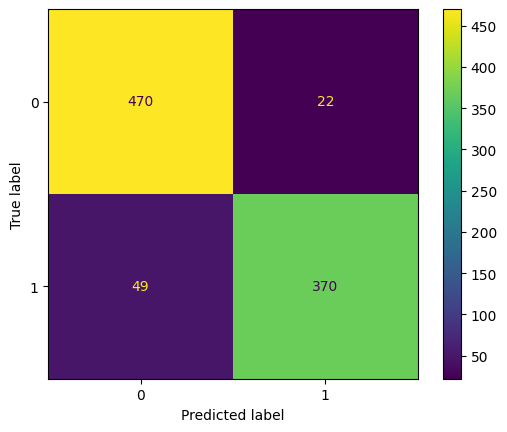

Epoch 10


Test Loss: 0.5239
Accuracy: 0.9221
Precision: 0.9628
Recall: 0.8640
F1 Score: 0.9107


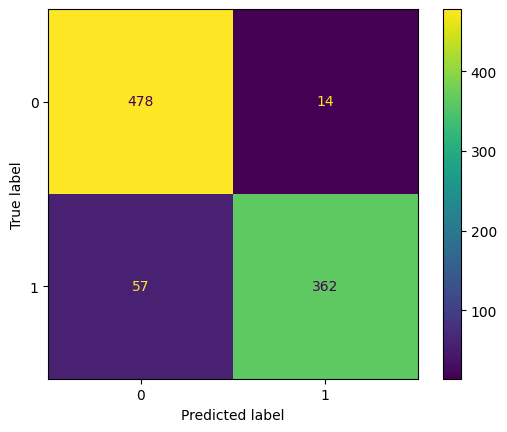

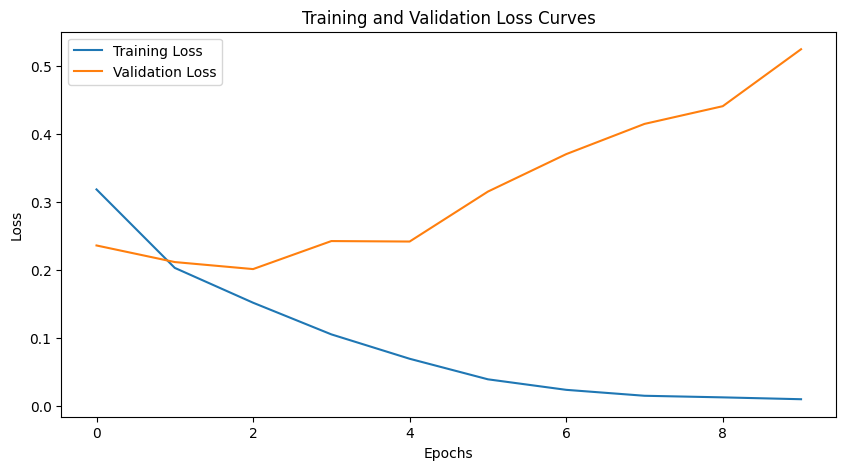

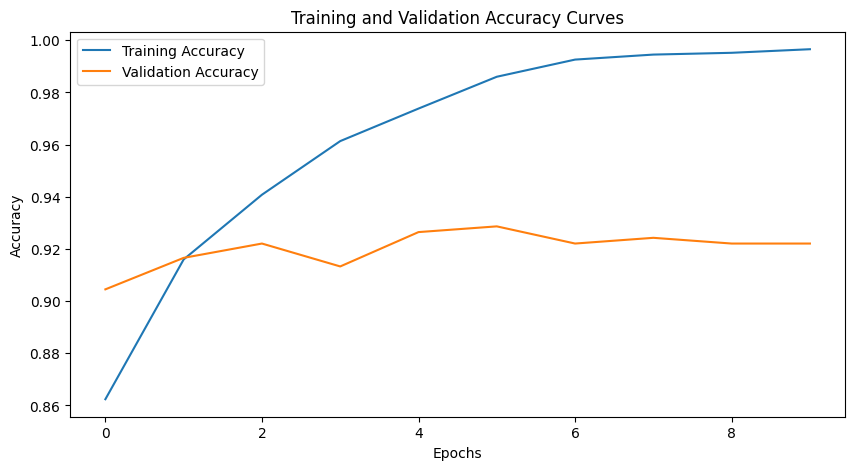

Final Training Metrics:
Test Loss: 0.0081
Accuracy: 0.9970
Precision: 0.9959
Recall: 0.9972
F1 Score: 0.9965


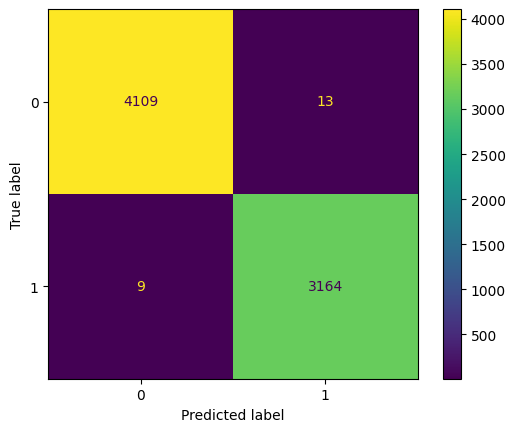

Final Test Metrics:
Test Loss: 0.5707
Accuracy: 0.9157
Precision: 0.9608
Recall: 0.8448
F1 Score: 0.8991


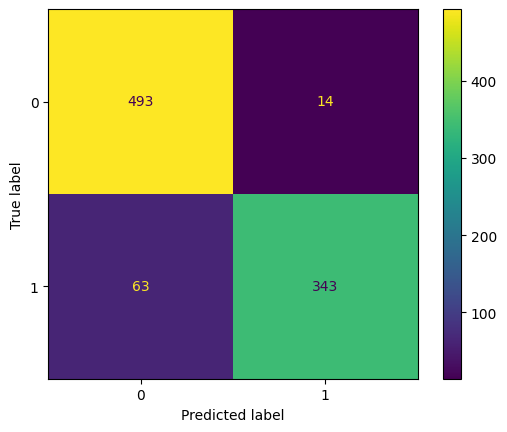

Experiment with Batch Size: 16, Learning Rate: 0.0001
Epoch 1


Test Loss: 0.3406
Accuracy: 0.8617
Precision: 0.9399
Recall: 0.7470
F1 Score: 0.8324


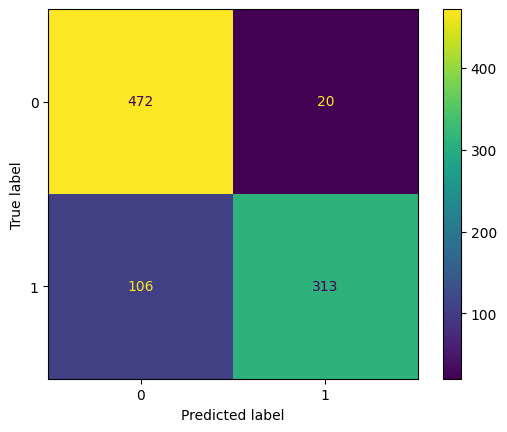

Epoch 2


Test Loss: 0.2721
Accuracy: 0.8858
Precision: 0.9674
Recall: 0.7780
F1 Score: 0.8624


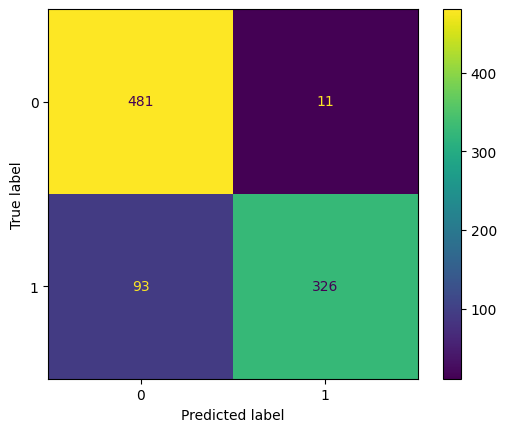

Epoch 3


Test Loss: 0.2313
Accuracy: 0.9078
Precision: 0.9467
Recall: 0.8473
F1 Score: 0.8942


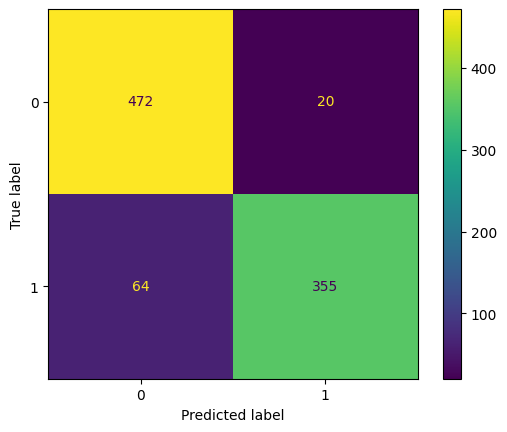

Epoch 4


Test Loss: 0.2396
Accuracy: 0.9012
Precision: 0.9796
Recall: 0.8019
F1 Score: 0.8819


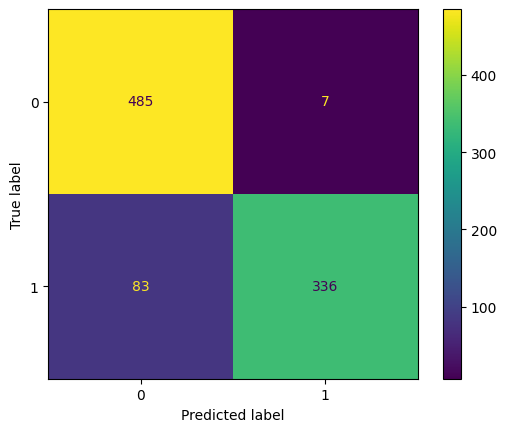

Epoch 5


Test Loss: 0.2172
Accuracy: 0.9166
Precision: 0.9648
Recall: 0.8496
F1 Score: 0.9036


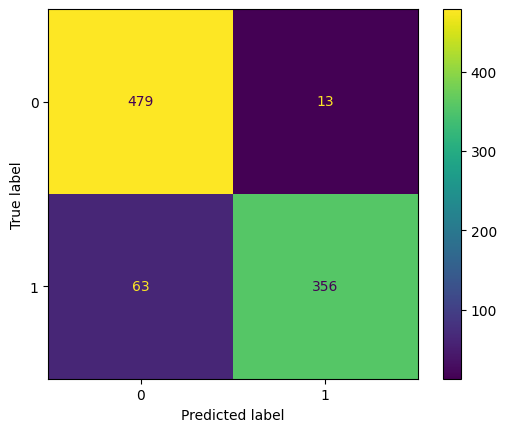

Epoch 6


Test Loss: 0.2170
Accuracy: 0.9166
Precision: 0.9623
Recall: 0.8520
F1 Score: 0.9038


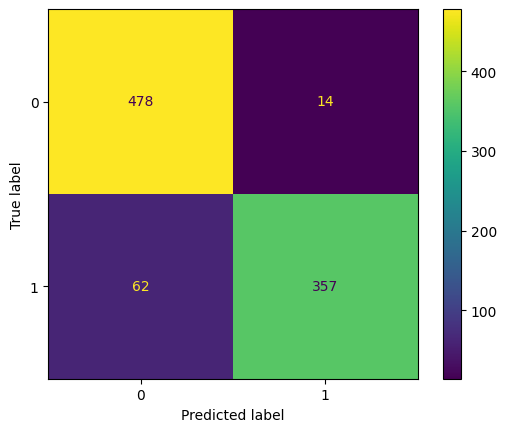

Epoch 7


Test Loss: 0.2180
Accuracy: 0.9155
Precision: 0.9622
Recall: 0.8496
F1 Score: 0.9024


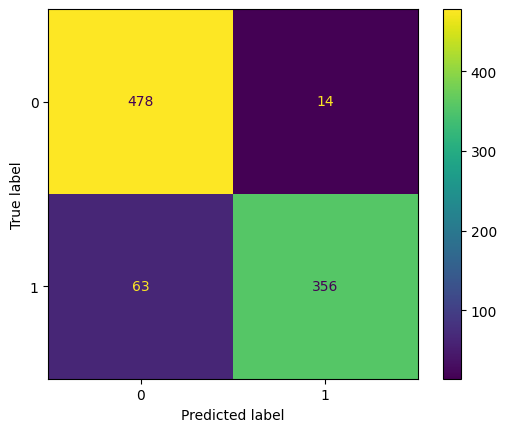

Epoch 8


Test Loss: 0.2215
Accuracy: 0.9111
Precision: 0.9617
Recall: 0.8401
F1 Score: 0.8968


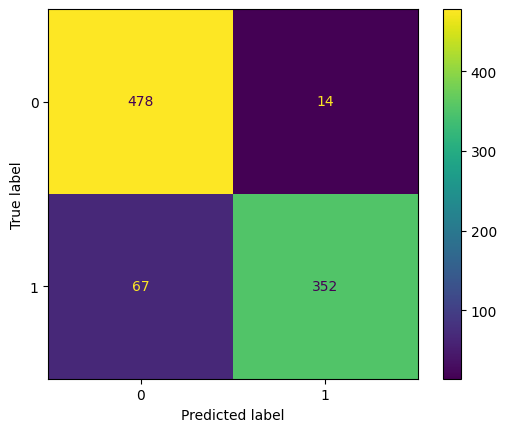

Epoch 9


Test Loss: 0.2119
Accuracy: 0.9232
Precision: 0.9246
Recall: 0.9069
F1 Score: 0.9157


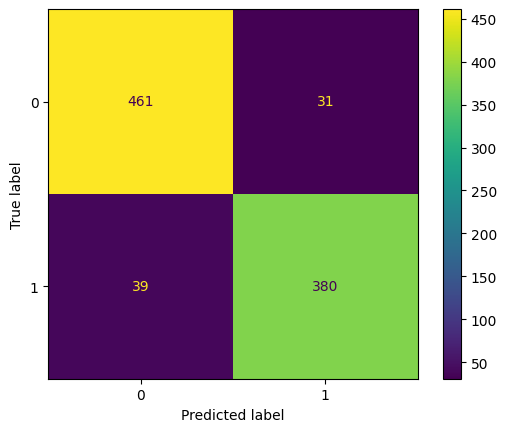

Epoch 10


Test Loss: 0.2156
Accuracy: 0.9243
Precision: 0.9534
Recall: 0.8783
F1 Score: 0.9143


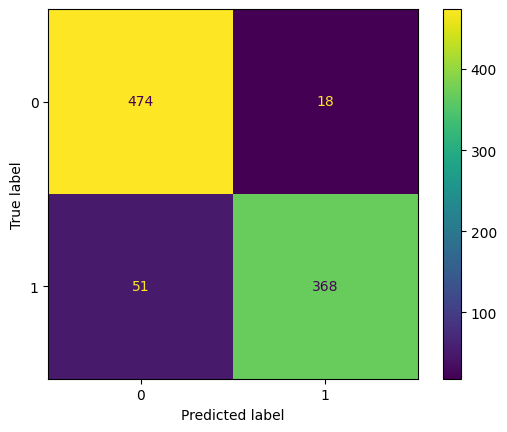

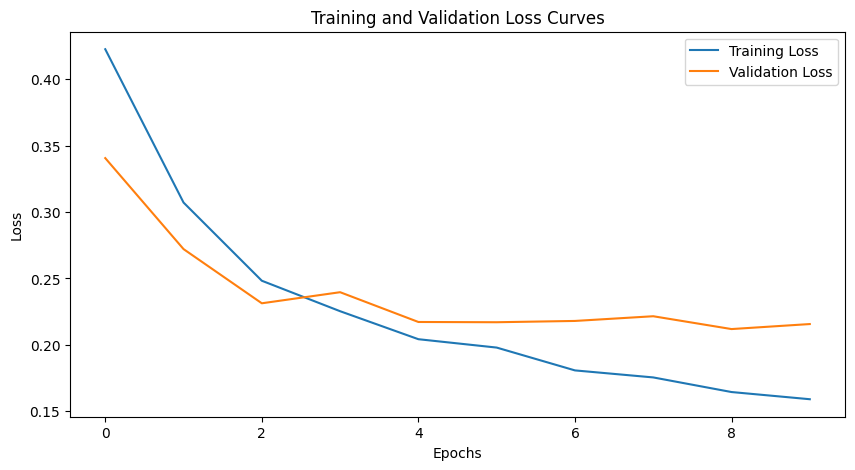

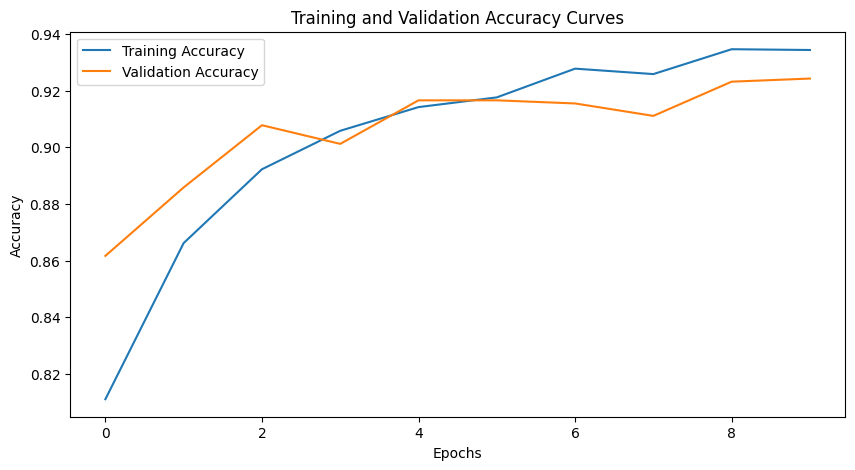

Final Training Metrics:
Test Loss: 0.1444
Accuracy: 0.9427
Precision: 0.9605
Recall: 0.9055
F1 Score: 0.9322


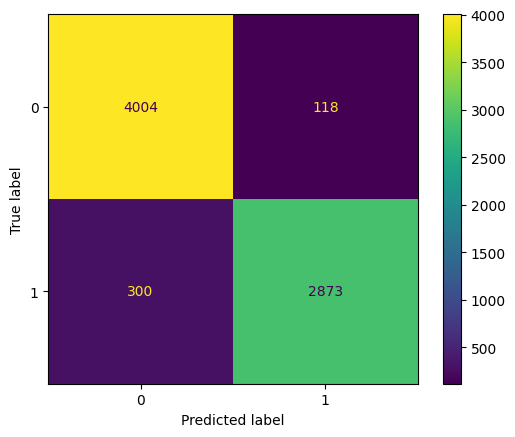

Final Test Metrics:
Test Loss: 0.2334
Accuracy: 0.9025
Precision: 0.9342
Recall: 0.8399
F1 Score: 0.8846


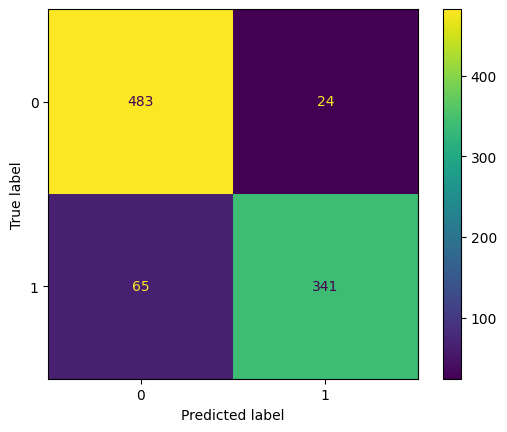

Experiment with Batch Size: 16, Learning Rate: 1e-05
Epoch 1


Test Loss: 0.5794
Accuracy: 0.8244
Precision: 0.9544
Recall: 0.6492
F1 Score: 0.7727


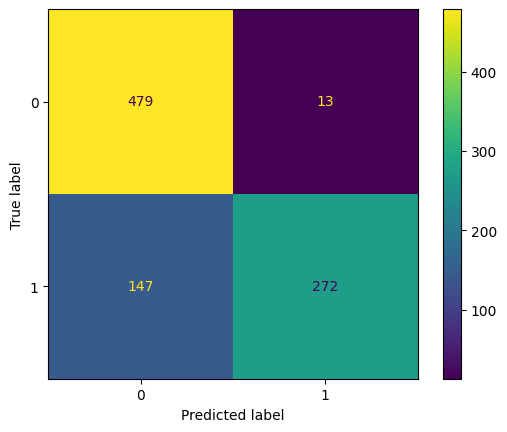

Epoch 2


Test Loss: 0.4245
Accuracy: 0.8342
Precision: 0.9241
Recall: 0.6969
F1 Score: 0.7946


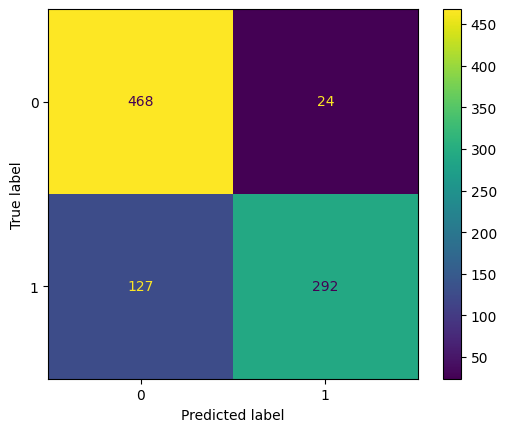

Epoch 3


Test Loss: 0.3788
Accuracy: 0.8364
Precision: 0.9245
Recall: 0.7017
F1 Score: 0.7978


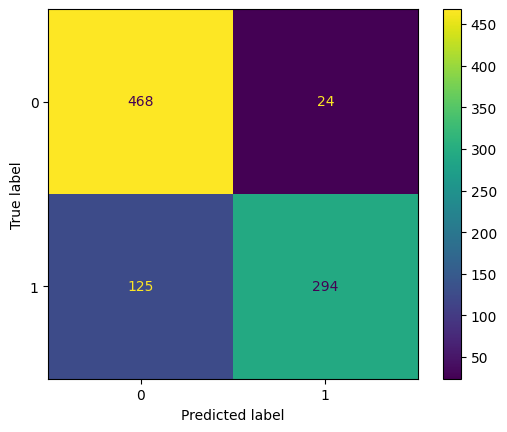

Epoch 4


Test Loss: 0.3681
Accuracy: 0.8386
Precision: 0.9224
Recall: 0.7088
F1 Score: 0.8016


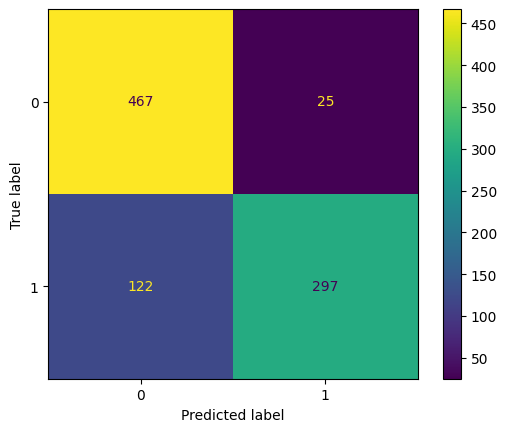

Epoch 5


Test Loss: 0.3621
Accuracy: 0.8408
Precision: 0.9255
Recall: 0.7112
F1 Score: 0.8043


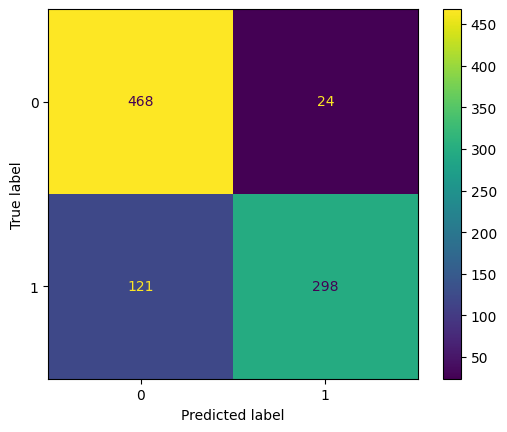

Epoch 6


Test Loss: 0.3545
Accuracy: 0.8441
Precision: 0.9159
Recall: 0.7279
F1 Score: 0.8112


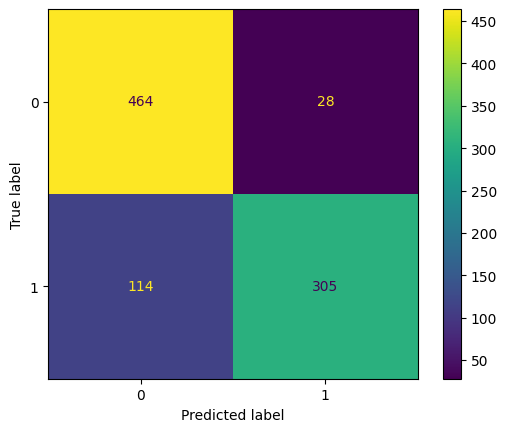

Epoch 7


Test Loss: 0.3487
Accuracy: 0.8562
Precision: 0.9286
Recall: 0.7446
F1 Score: 0.8265


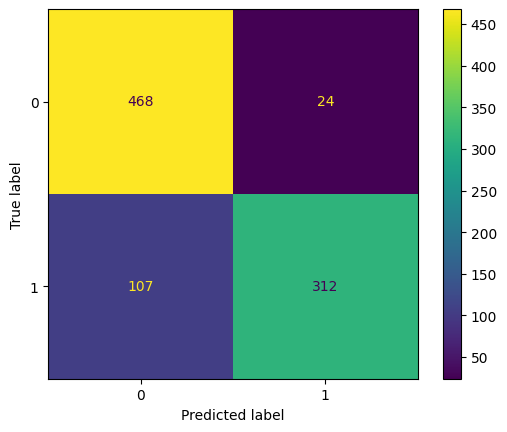

Epoch 8


Test Loss: 0.3466
Accuracy: 0.8617
Precision: 0.9621
Recall: 0.7279
F1 Score: 0.8288


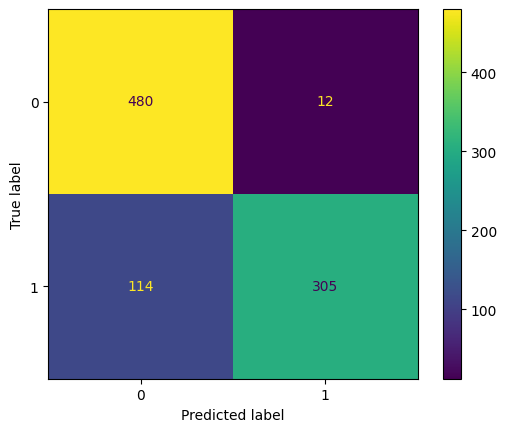

Epoch 9


Test Loss: 0.3385
Accuracy: 0.8683
Precision: 0.9517
Recall: 0.7518
F1 Score: 0.8400


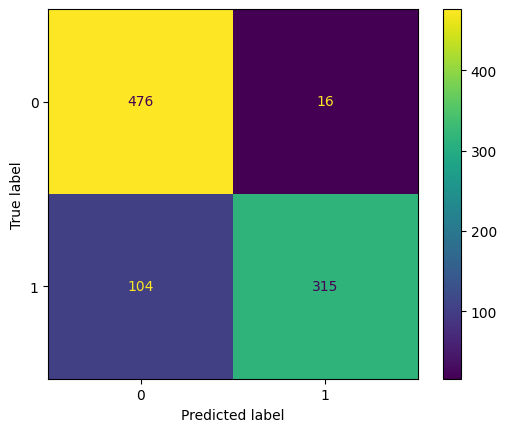

Epoch 10


Test Loss: 0.3368
Accuracy: 0.8650
Precision: 0.9684
Recall: 0.7303
F1 Score: 0.8327


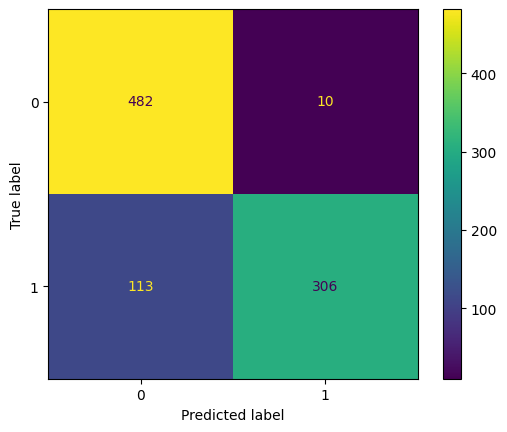

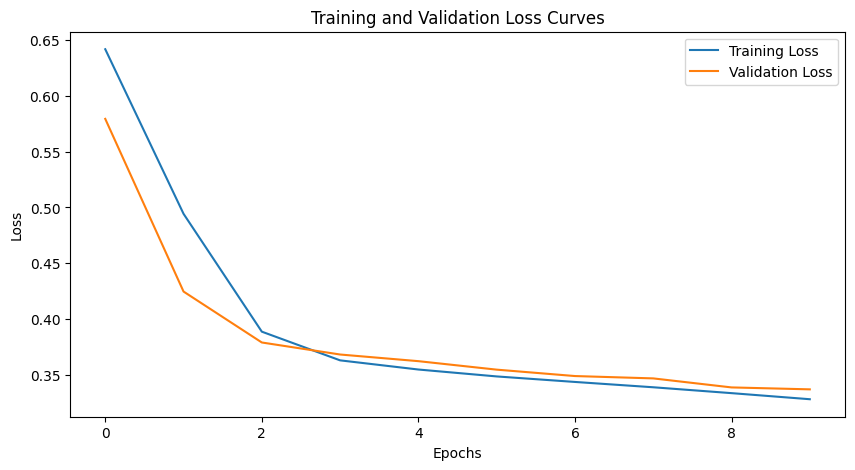

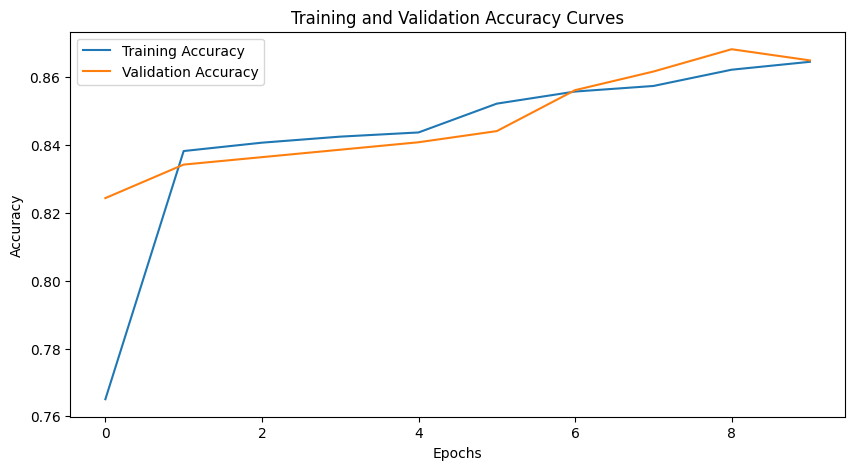

Final Training Metrics:
Test Loss: 0.3248
Accuracy: 0.8670
Precision: 0.9411
Recall: 0.7406
F1 Score: 0.8289


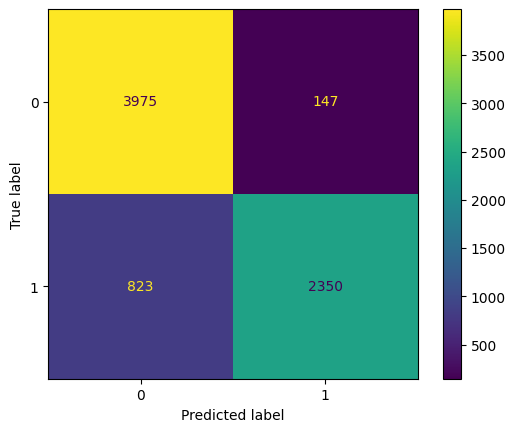

Final Test Metrics:
Test Loss: 0.3347
Accuracy: 0.8708
Precision: 0.9528
Recall: 0.7463
F1 Score: 0.8370


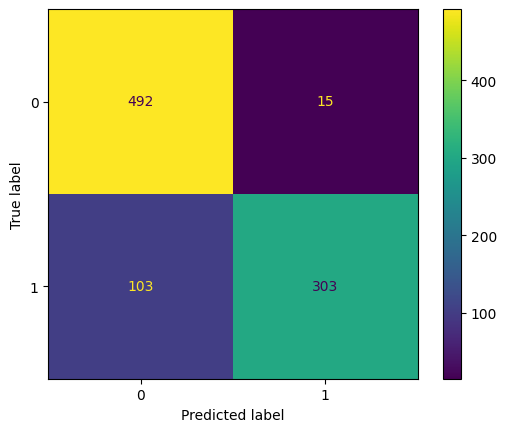

Experiment with Batch Size: 32, Learning Rate: 0.001
Epoch 1


Test Loss: 0.2407
Accuracy: 0.9045
Precision: 0.9663
Recall: 0.8210
F1 Score: 0.8877


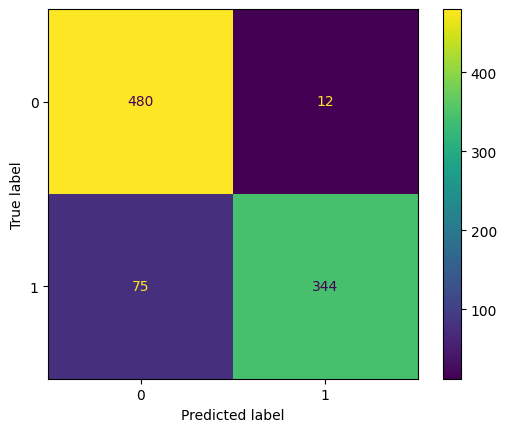

Epoch 2


Test Loss: 0.2232
Accuracy: 0.9100
Precision: 0.9720
Recall: 0.8282
F1 Score: 0.8943


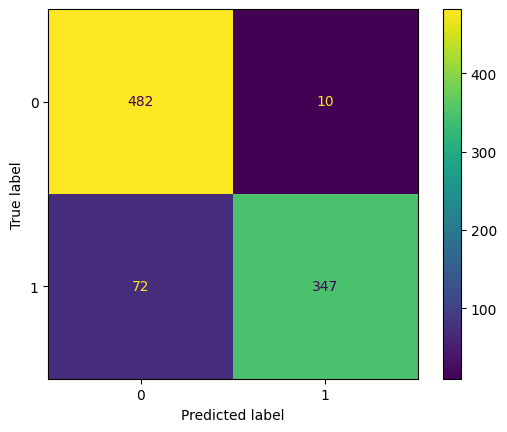

Epoch 3


Test Loss: 0.2130
Accuracy: 0.9144
Precision: 0.9596
Recall: 0.8496
F1 Score: 0.9013


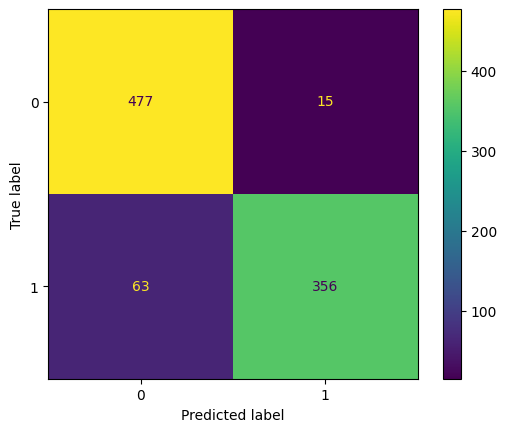

Epoch 4


Test Loss: 0.2983
Accuracy: 0.8935
Precision: 0.9939
Recall: 0.7733
F1 Score: 0.8698


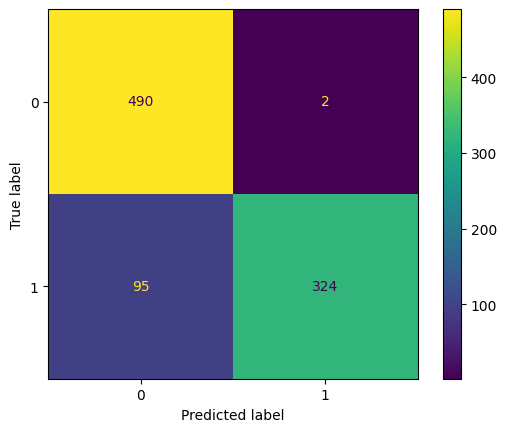

Epoch 5


Test Loss: 0.2412
Accuracy: 0.9210
Precision: 0.9327
Recall: 0.8926
F1 Score: 0.9122


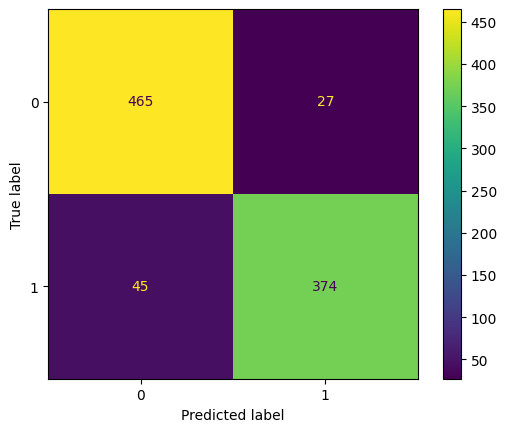

Epoch 6


Test Loss: 0.3441
Accuracy: 0.9188
Precision: 0.9457
Recall: 0.8735
F1 Score: 0.9082


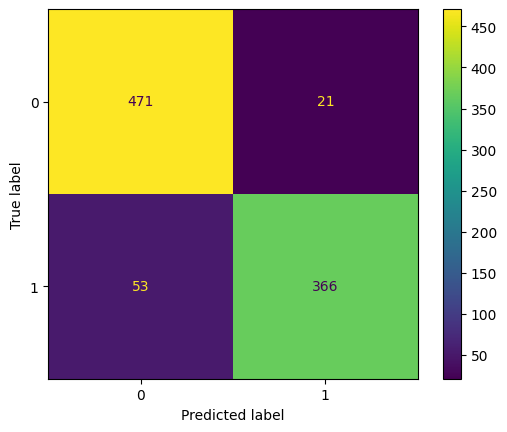

Epoch 7


Test Loss: 0.2872
Accuracy: 0.9254
Precision: 0.9377
Recall: 0.8974
F1 Score: 0.9171


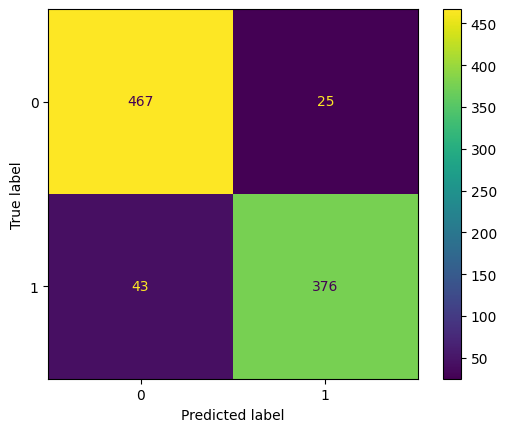

Epoch 8


Test Loss: 0.4241
Accuracy: 0.9210
Precision: 0.9460
Recall: 0.8783
F1 Score: 0.9109


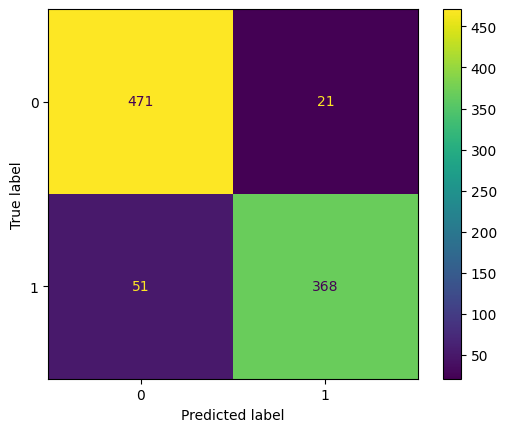

Epoch 9


Test Loss: 0.4062
Accuracy: 0.9155
Precision: 0.9524
Recall: 0.8592
F1 Score: 0.9034


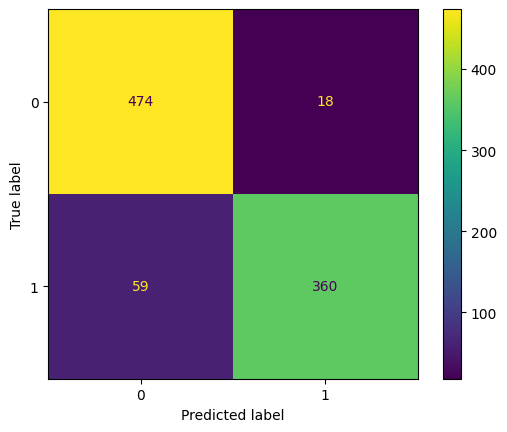

Epoch 10


Test Loss: 0.4590
Accuracy: 0.9188
Precision: 0.9218
Recall: 0.8998
F1 Score: 0.9106


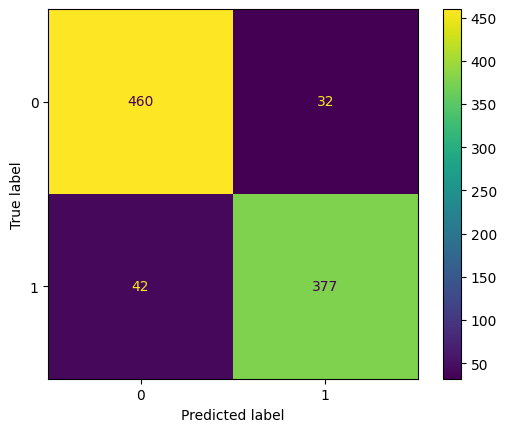

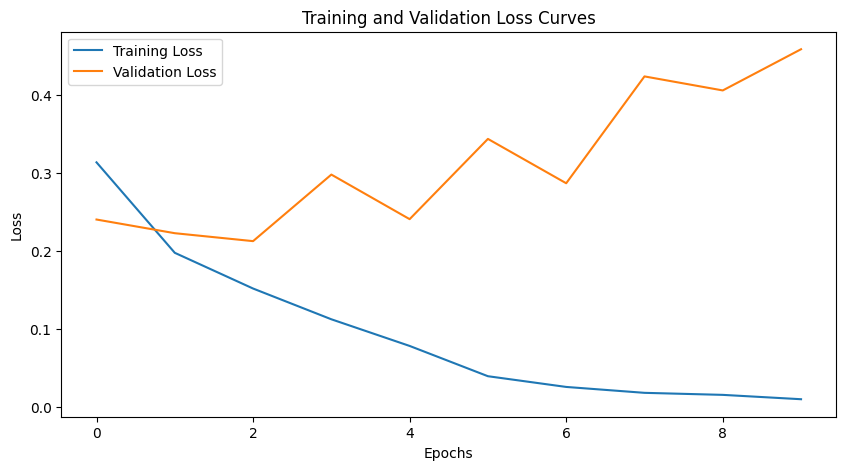

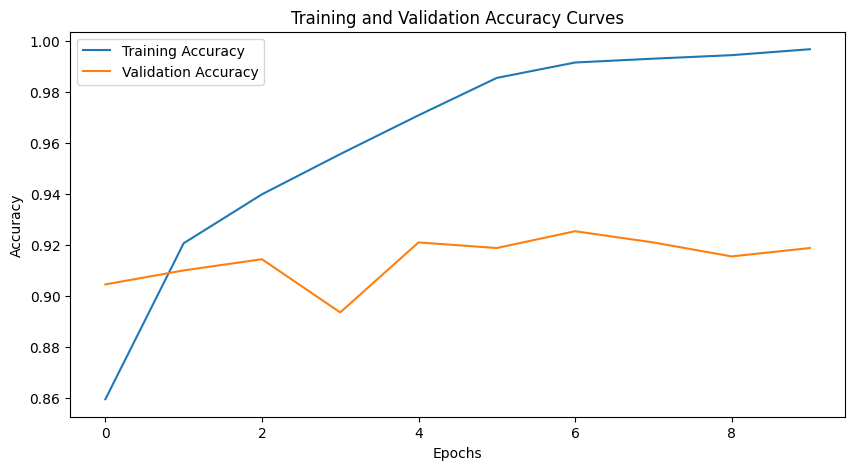

Final Training Metrics:
Test Loss: 0.0068
Accuracy: 0.9975
Precision: 0.9956
Recall: 0.9987
F1 Score: 0.9972


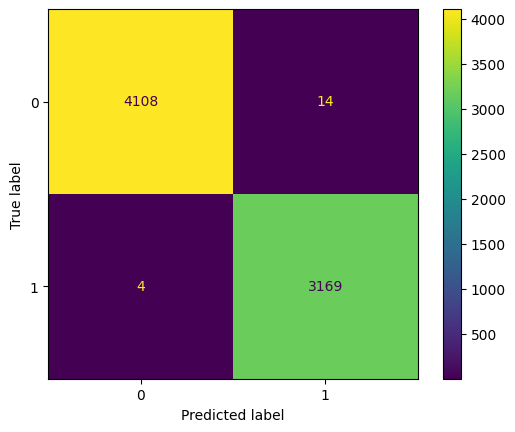

Final Test Metrics:
Test Loss: 0.4844
Accuracy: 0.9146
Precision: 0.9080
Recall: 0.8990
F1 Score: 0.9035


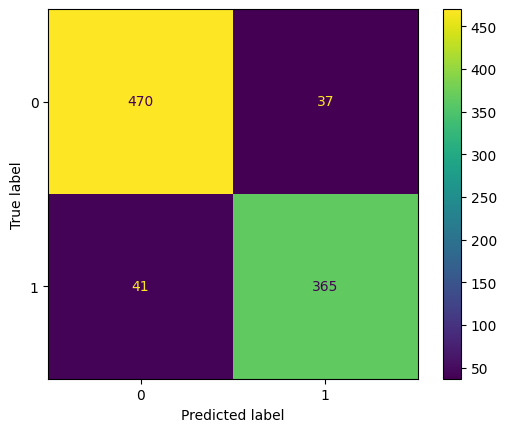

Experiment with Batch Size: 32, Learning Rate: 0.0001
Epoch 1


Test Loss: 0.3386
Accuracy: 0.8639
Precision: 0.9429
Recall: 0.7494
F1 Score: 0.8351


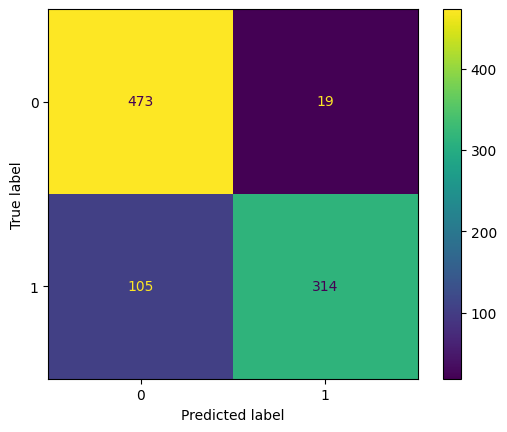

Epoch 2


Test Loss: 0.2656
Accuracy: 0.8869
Precision: 0.9540
Recall: 0.7924
F1 Score: 0.8657


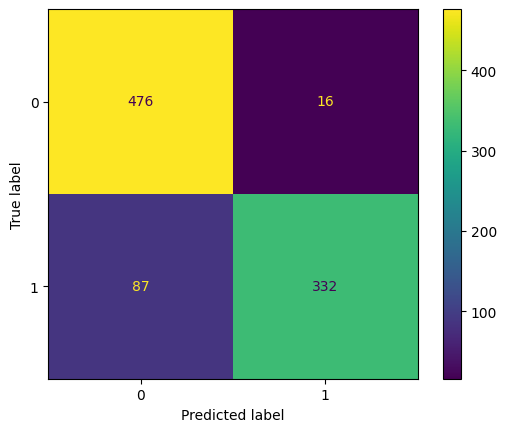

Epoch 3


Test Loss: 0.2332
Accuracy: 0.9034
Precision: 0.9321
Recall: 0.8520
F1 Score: 0.8903


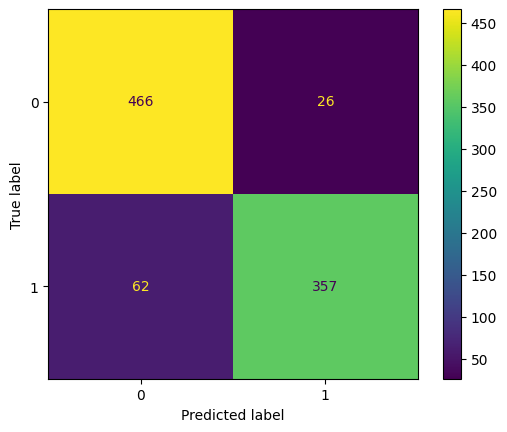

Epoch 4


Test Loss: 0.2236
Accuracy: 0.9199
Precision: 0.9553
Recall: 0.8663
F1 Score: 0.9086


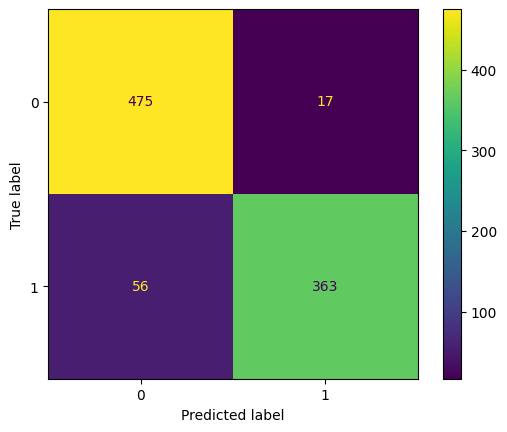

Epoch 5


Test Loss: 0.2156
Accuracy: 0.9177
Precision: 0.9550
Recall: 0.8616
F1 Score: 0.9059


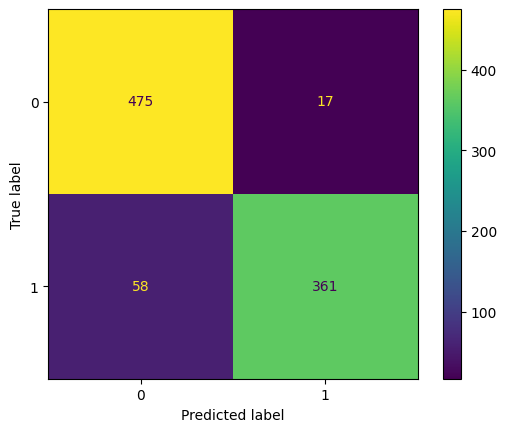

Epoch 6


Test Loss: 0.2551
Accuracy: 0.8968
Precision: 0.9880
Recall: 0.7852
F1 Score: 0.8750


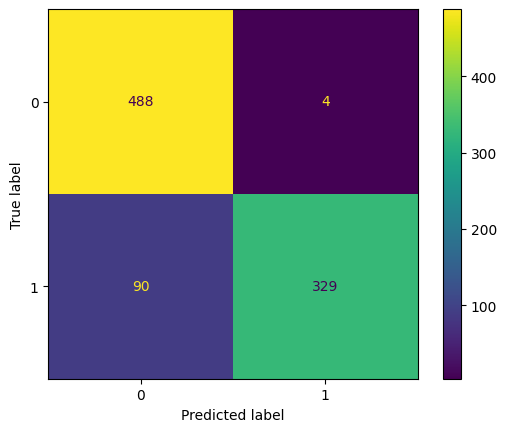

Epoch 7


Test Loss: 0.2108
Accuracy: 0.9199
Precision: 0.9459
Recall: 0.8759
F1 Score: 0.9095


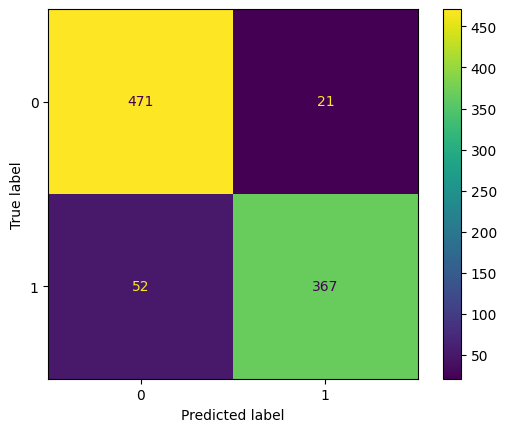

Epoch 8


Test Loss: 0.2264
Accuracy: 0.9100
Precision: 0.9694
Recall: 0.8305
F1 Score: 0.8946


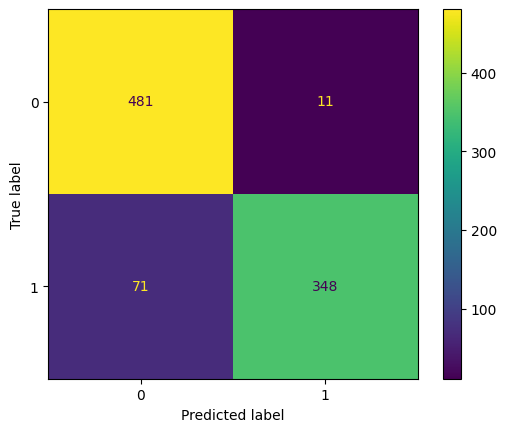

Epoch 9


Test Loss: 0.2100
Accuracy: 0.9286
Precision: 0.9585
Recall: 0.8831
F1 Score: 0.9193


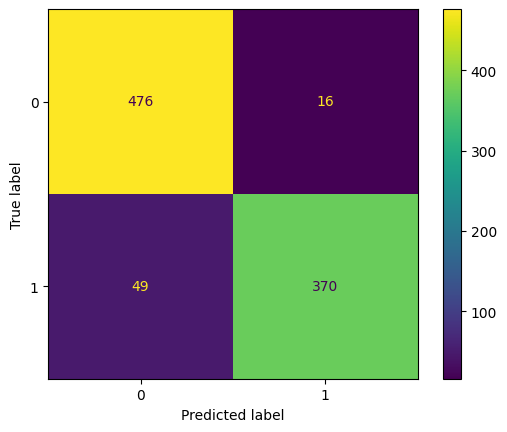

Epoch 10


Test Loss: 0.2100
Accuracy: 0.9276
Precision: 0.9358
Recall: 0.9045
F1 Score: 0.9199


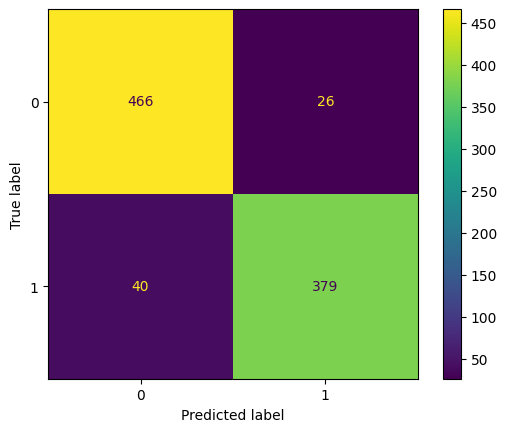

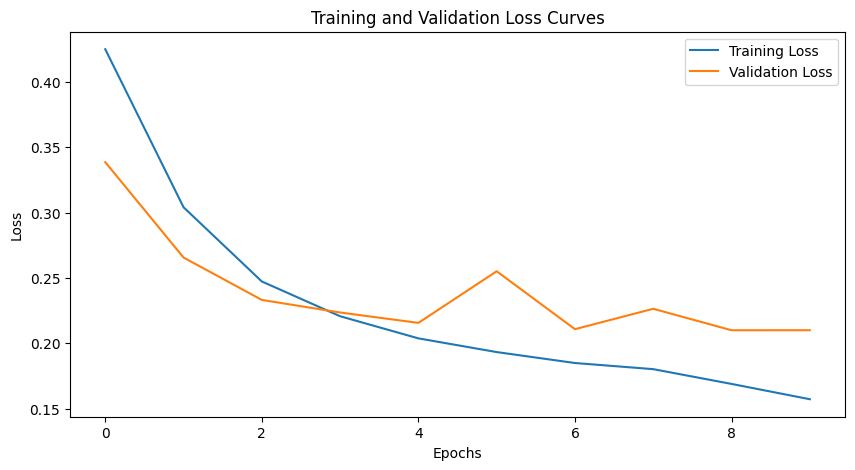

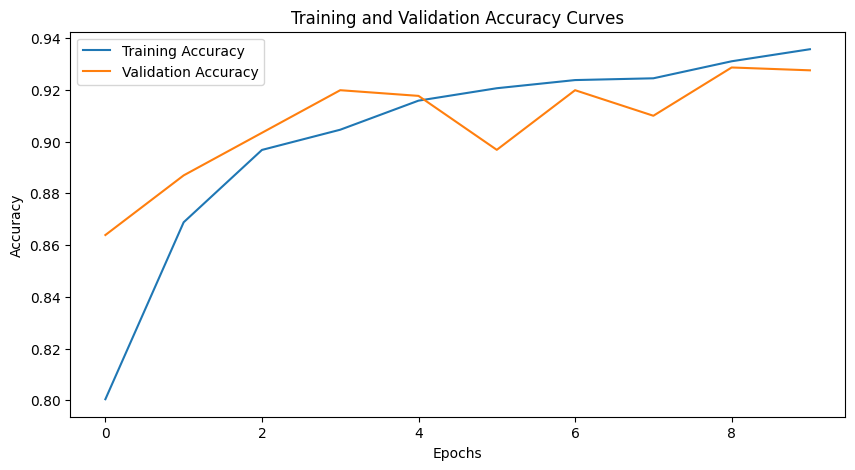

Final Training Metrics:
Test Loss: 0.1492
Accuracy: 0.9430
Precision: 0.9392
Recall: 0.9291
F1 Score: 0.9341


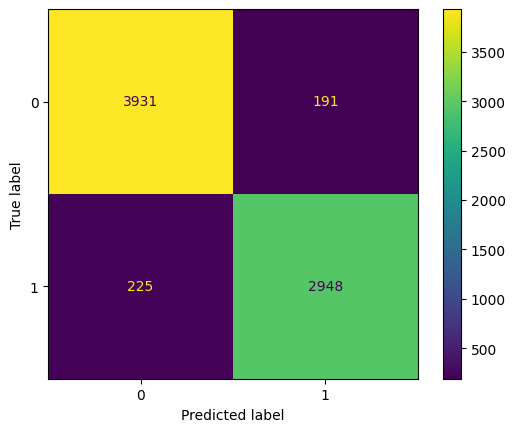

Final Test Metrics:
Test Loss: 0.2357
Accuracy: 0.9047
Precision: 0.9100
Recall: 0.8719
F1 Score: 0.8906


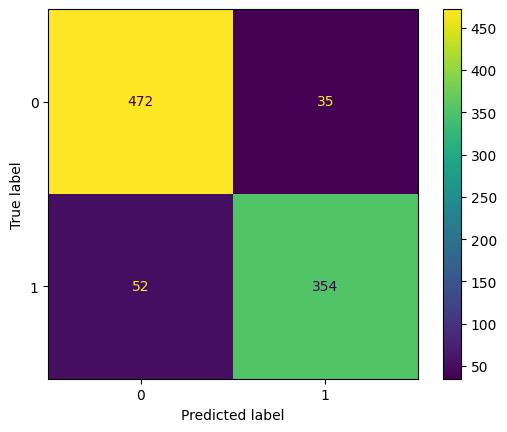

Experiment with Batch Size: 32, Learning Rate: 1e-05
Epoch 1


Test Loss: 0.5862
Accuracy: 0.8342
Precision: 0.8367
Recall: 0.7947
F1 Score: 0.8152


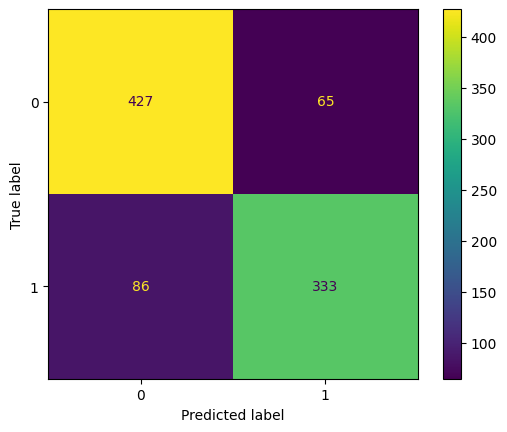

Epoch 2


Test Loss: 0.4413
Accuracy: 0.8266
Precision: 0.8919
Recall: 0.7088
F1 Score: 0.7899


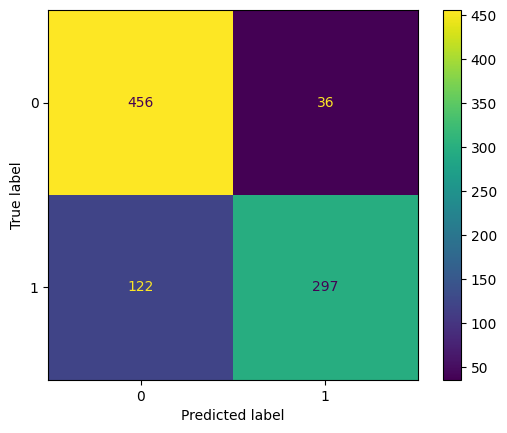

Epoch 3


Test Loss: 0.3822
Accuracy: 0.8386
Precision: 0.9331
Recall: 0.6993
F1 Score: 0.7995


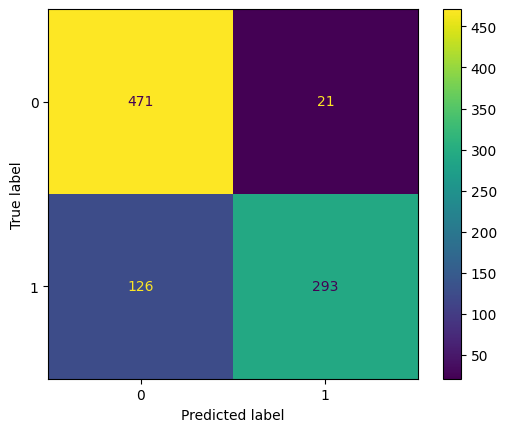

Epoch 4


Test Loss: 0.3677
Accuracy: 0.8375
Precision: 0.9248
Recall: 0.7041
F1 Score: 0.7995


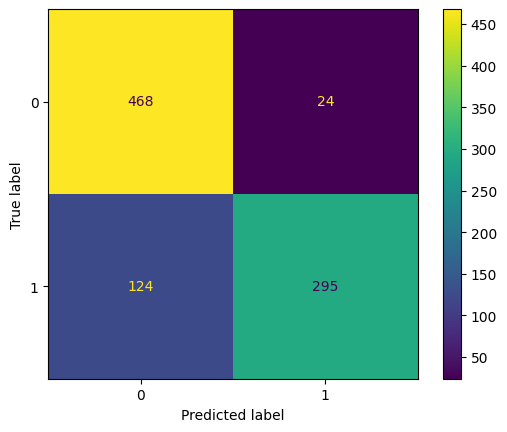

Epoch 5


Test Loss: 0.3609
Accuracy: 0.8485
Precision: 0.9460
Recall: 0.7112
F1 Score: 0.8120


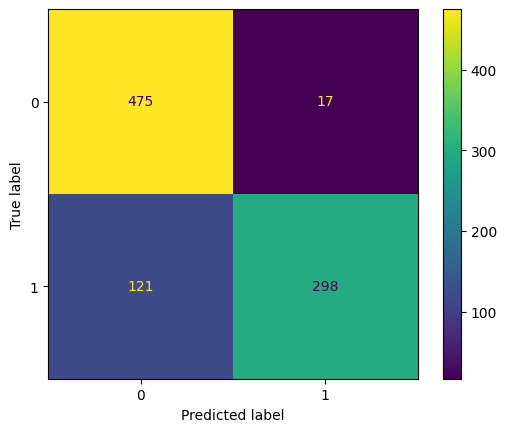

Epoch 6


Test Loss: 0.3561
Accuracy: 0.8551
Precision: 0.9585
Recall: 0.7160
F1 Score: 0.8197


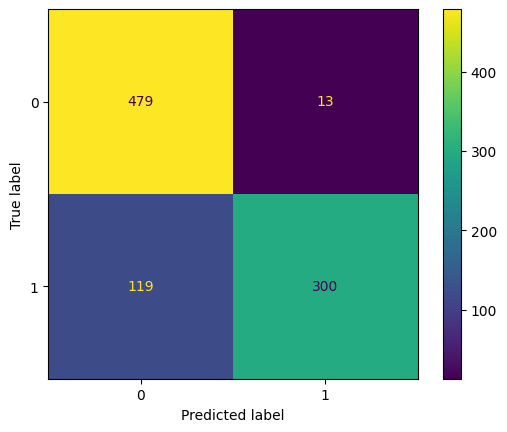

Epoch 7


Test Loss: 0.3480
Accuracy: 0.8584
Precision: 0.9394
Recall: 0.7399
F1 Score: 0.8278


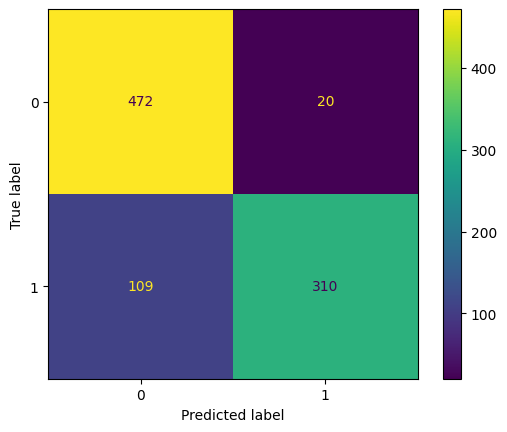

Epoch 8


Test Loss: 0.3448
Accuracy: 0.8617
Precision: 0.9592
Recall: 0.7303
F1 Score: 0.8293


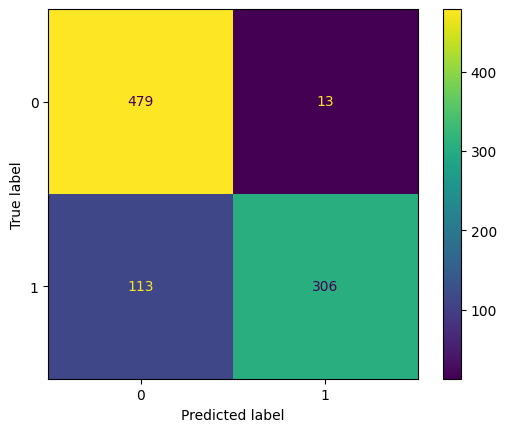

Epoch 9


Test Loss: 0.3445
Accuracy: 0.8628
Precision: 0.9773
Recall: 0.7184
F1 Score: 0.8281


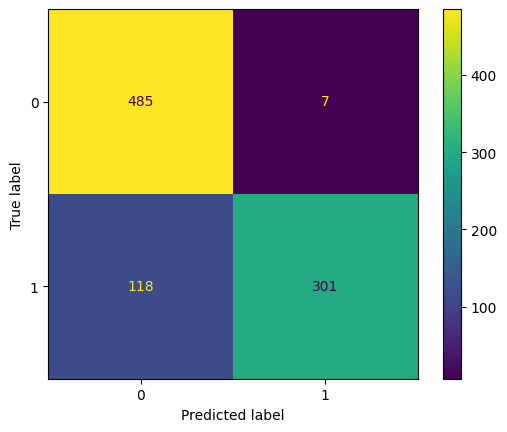

Epoch 10


Test Loss: 0.3329
Accuracy: 0.8694
Precision: 0.9658
Recall: 0.7422
F1 Score: 0.8394


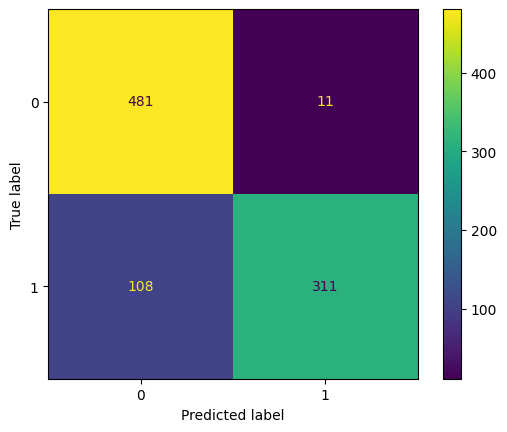

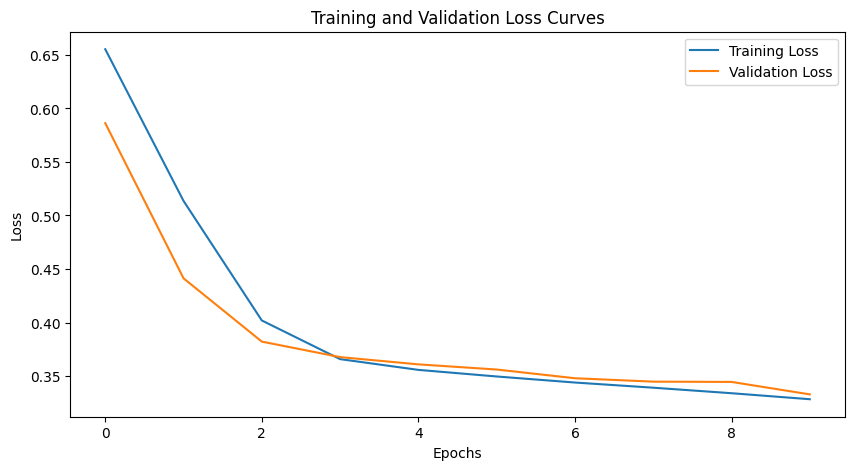

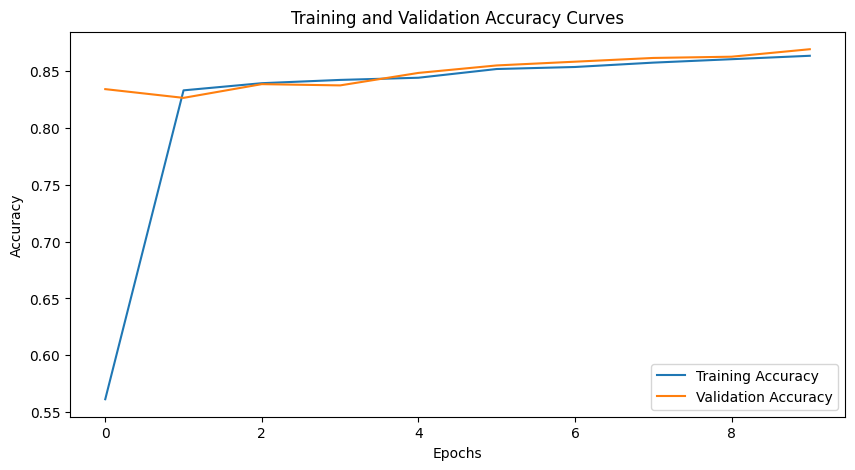

Final Training Metrics:
Test Loss: 0.3246
Accuracy: 0.8658
Precision: 0.9236
Recall: 0.7539
F1 Score: 0.8301


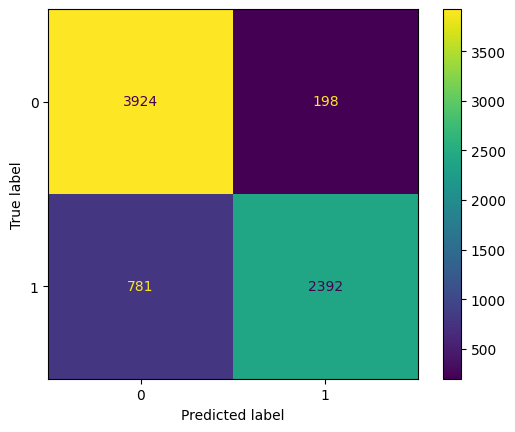

Final Test Metrics:
Test Loss: 0.3323
Accuracy: 0.8719
Precision: 0.9474
Recall: 0.7537
F1 Score: 0.8395


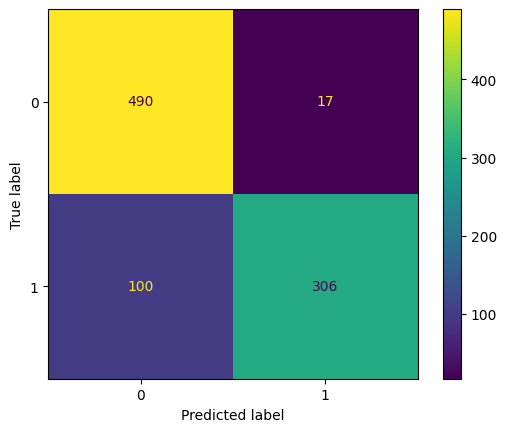

Experiment with Batch Size: 64, Learning Rate: 0.001
Epoch 1


Test Loss: 0.2543
Accuracy: 0.8968
Precision: 0.9765
Recall: 0.7947
F1 Score: 0.8763


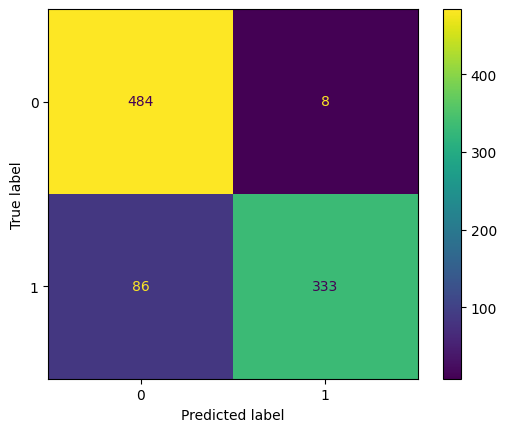

Epoch 2


Test Loss: 0.2169
Accuracy: 0.9133
Precision: 0.9427
Recall: 0.8640
F1 Score: 0.9016


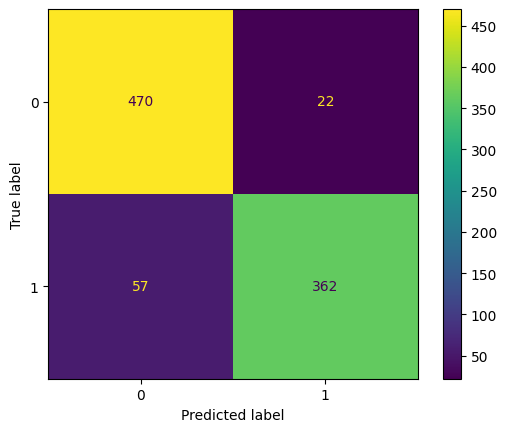

Epoch 3


Test Loss: 0.2193
Accuracy: 0.9155
Precision: 0.9091
Recall: 0.9069
F1 Score: 0.9080


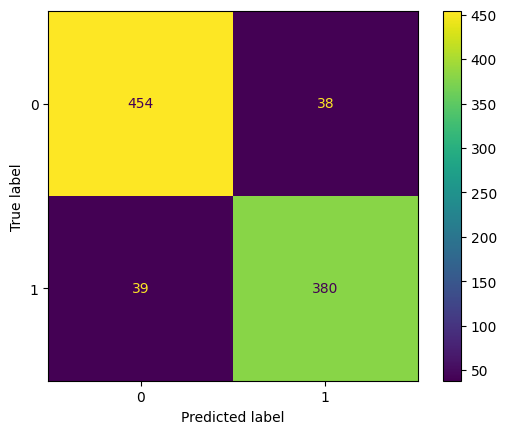

Epoch 4


Test Loss: 0.2455
Accuracy: 0.9188
Precision: 0.9481
Recall: 0.8711
F1 Score: 0.9080


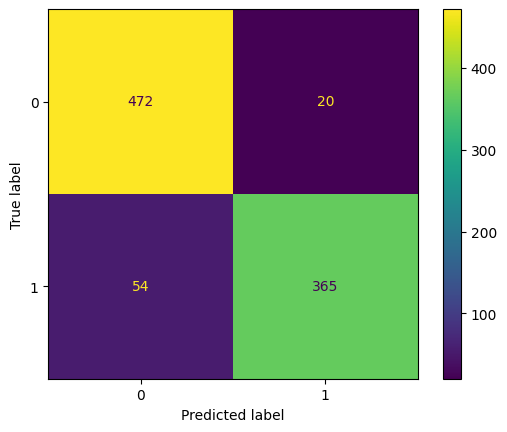

Epoch 5


Test Loss: 0.2690
Accuracy: 0.9122
Precision: 0.9248
Recall: 0.8807
F1 Score: 0.9022


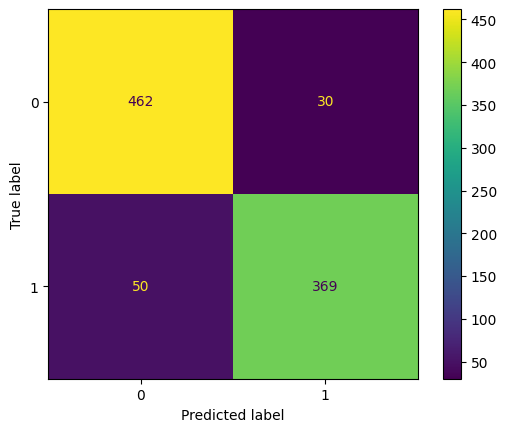

Epoch 6


Test Loss: 0.3412
Accuracy: 0.9067
Precision: 0.9372
Recall: 0.8544
F1 Score: 0.8939


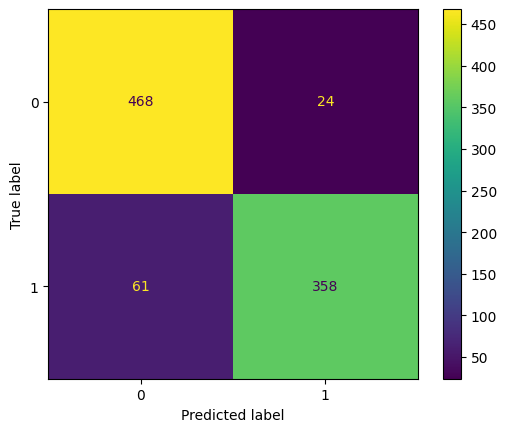

Epoch 7


Test Loss: 0.3750
Accuracy: 0.9188
Precision: 0.9481
Recall: 0.8711
F1 Score: 0.9080


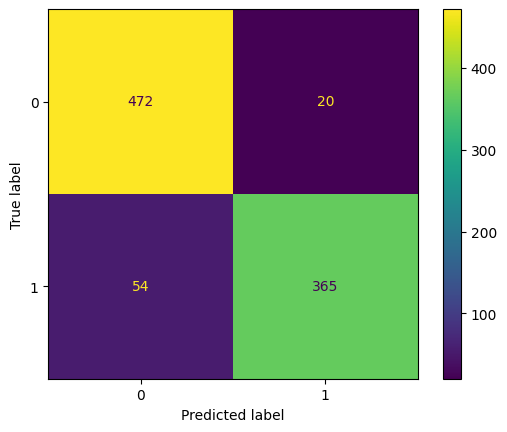

Epoch 8


Test Loss: 0.3649
Accuracy: 0.9122
Precision: 0.9206
Recall: 0.8854
F1 Score: 0.9027


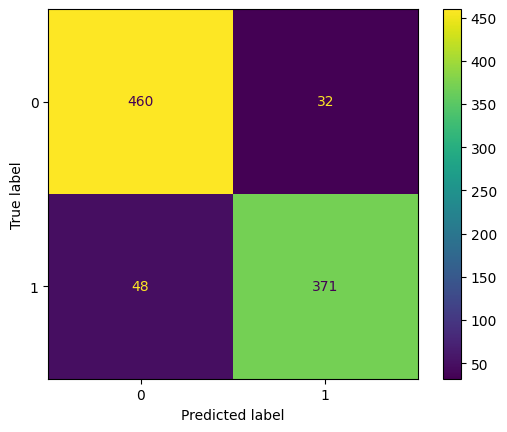

Epoch 9


Test Loss: 0.3380
Accuracy: 0.9188
Precision: 0.8984
Recall: 0.9284
F1 Score: 0.9131


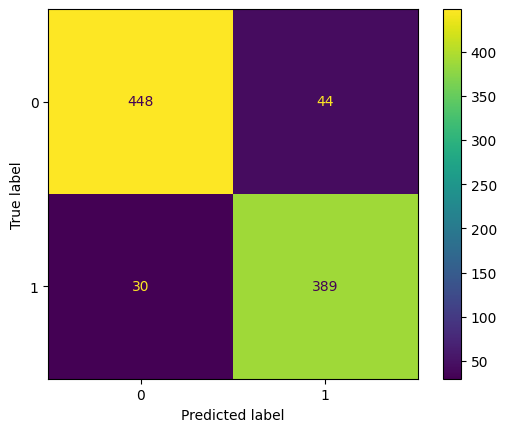

Epoch 10


Test Loss: 0.3862
Accuracy: 0.9177
Precision: 0.9195
Recall: 0.8998
F1 Score: 0.9095


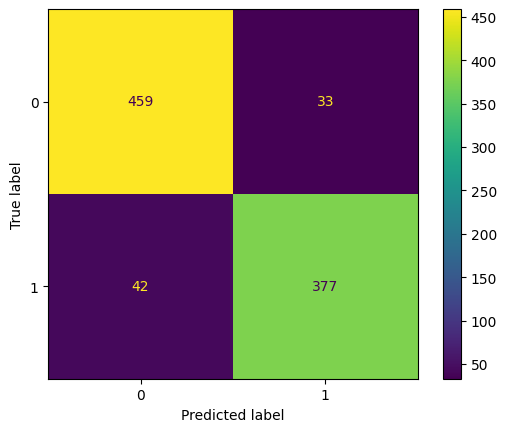

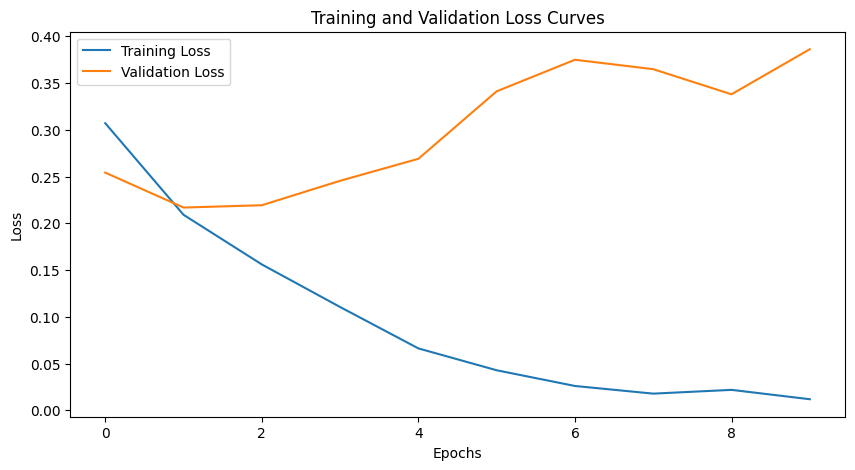

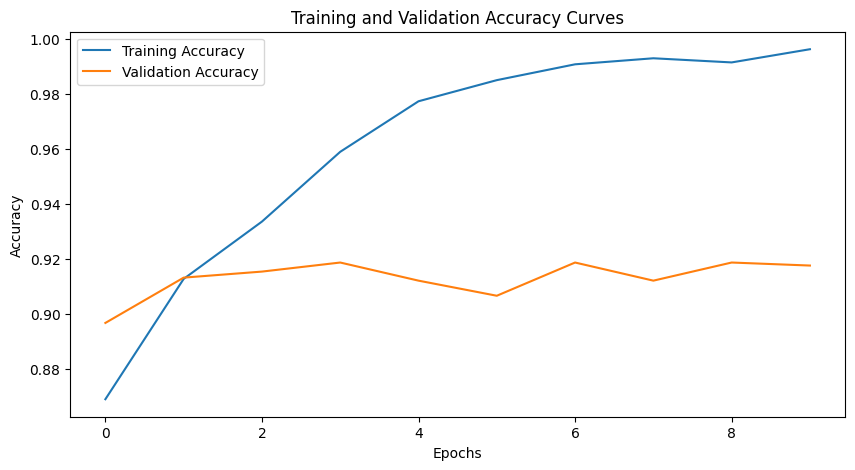

Final Training Metrics:
Test Loss: 0.0083
Accuracy: 0.9960
Precision: 0.9987
Recall: 0.9921
F1 Score: 0.9954


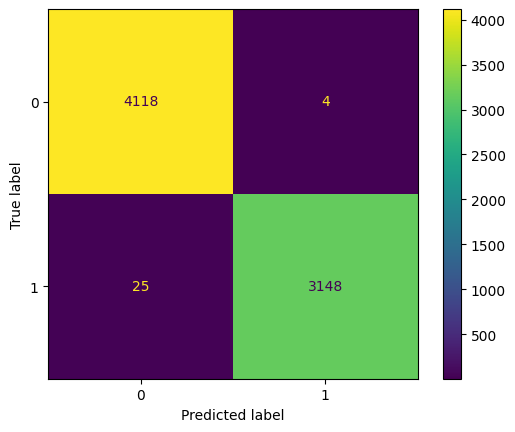

Final Test Metrics:
Test Loss: 0.4430
Accuracy: 0.9091
Precision: 0.9130
Recall: 0.8793
F1 Score: 0.8959


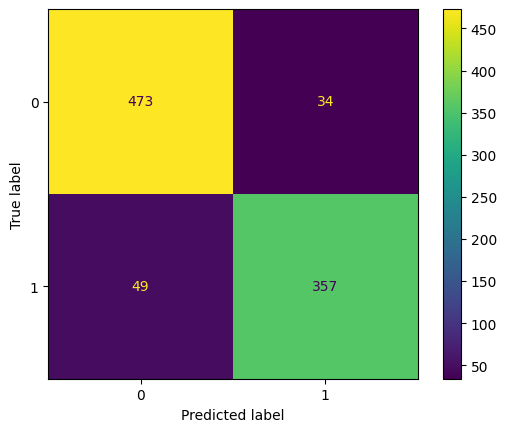

Experiment with Batch Size: 64, Learning Rate: 0.0001
Epoch 1


Test Loss: 0.3483
Accuracy: 0.8573
Precision: 0.9558
Recall: 0.7232
F1 Score: 0.8234


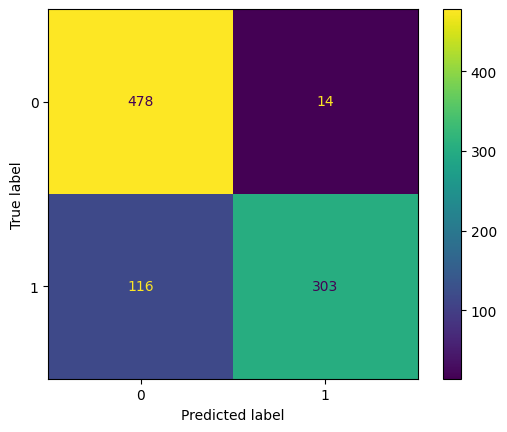

Epoch 2


Test Loss: 0.2913
Accuracy: 0.8814
Precision: 0.9560
Recall: 0.7780
F1 Score: 0.8579


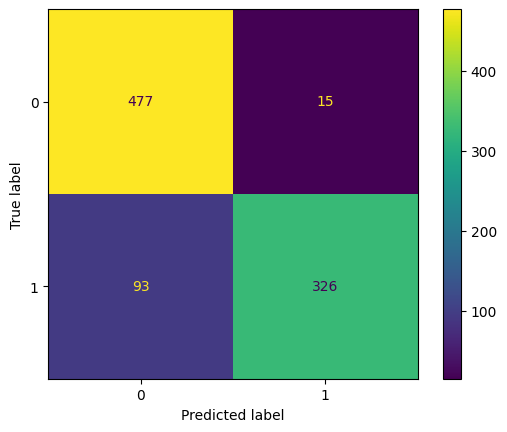

Epoch 3


Test Loss: 0.2392
Accuracy: 0.9034
Precision: 0.9584
Recall: 0.8258
F1 Score: 0.8872


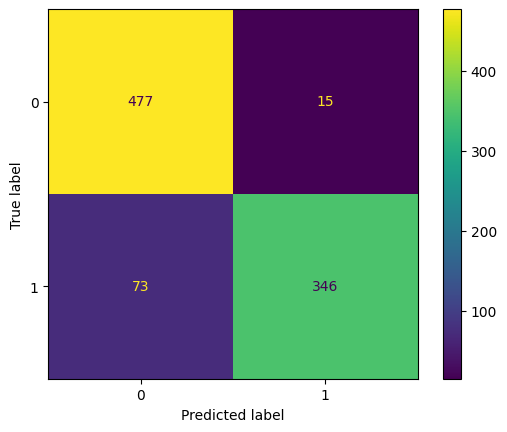

Epoch 4


Test Loss: 0.2570
Accuracy: 0.8913
Precision: 0.9819
Recall: 0.7780
F1 Score: 0.8682


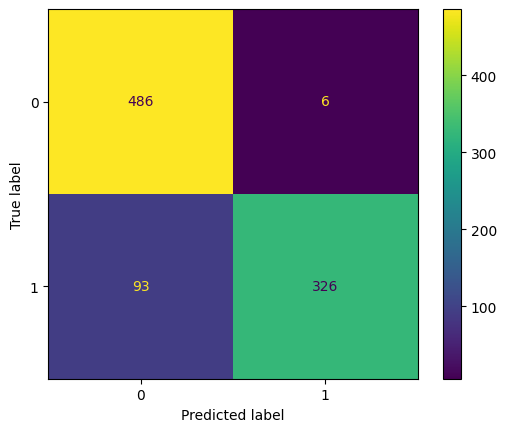

Epoch 5


Test Loss: 0.2203
Accuracy: 0.9166
Precision: 0.9342
Recall: 0.8807
F1 Score: 0.9066


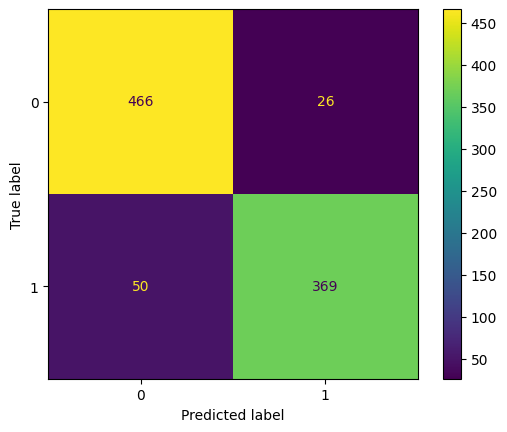

Epoch 6


Test Loss: 0.2229
Accuracy: 0.9133
Precision: 0.9670
Recall: 0.8401
F1 Score: 0.8991


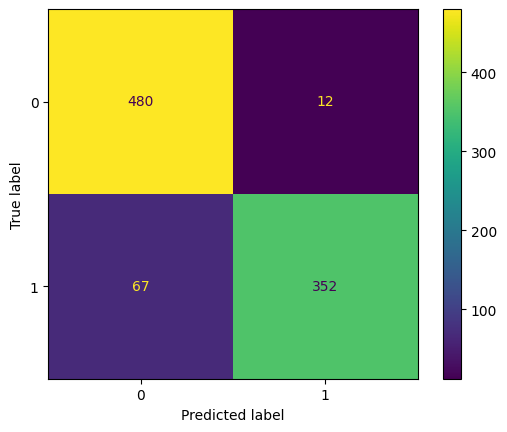

Epoch 7


Test Loss: 0.2142
Accuracy: 0.9155
Precision: 0.9340
Recall: 0.8783
F1 Score: 0.9053


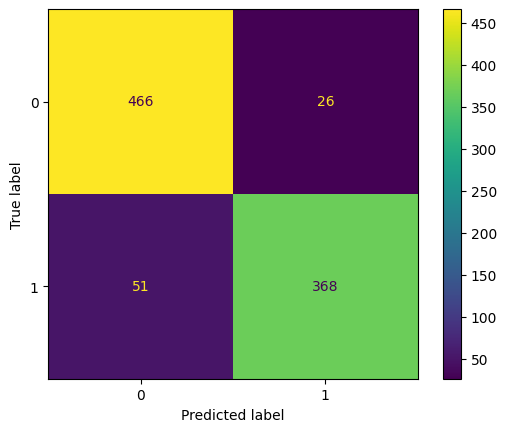

Epoch 8


Test Loss: 0.2145
Accuracy: 0.9199
Precision: 0.9347
Recall: 0.8878
F1 Score: 0.9106


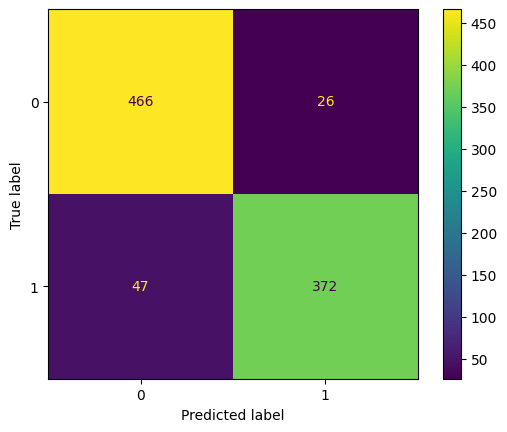

Epoch 9


Test Loss: 0.2161
Accuracy: 0.9232
Precision: 0.9463
Recall: 0.8831
F1 Score: 0.9136


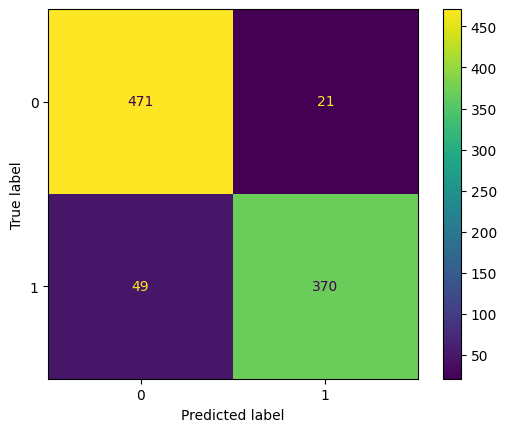

Epoch 10


Test Loss: 0.2178
Accuracy: 0.9243
Precision: 0.9510
Recall: 0.8807
F1 Score: 0.9145


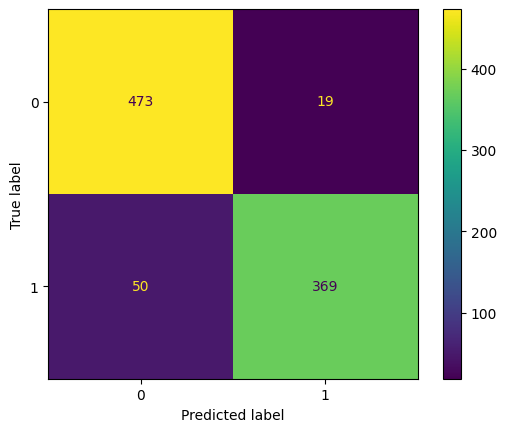

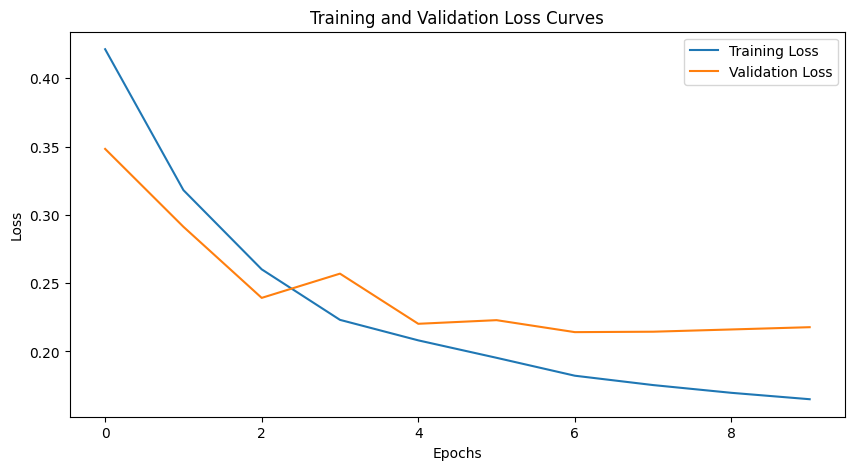

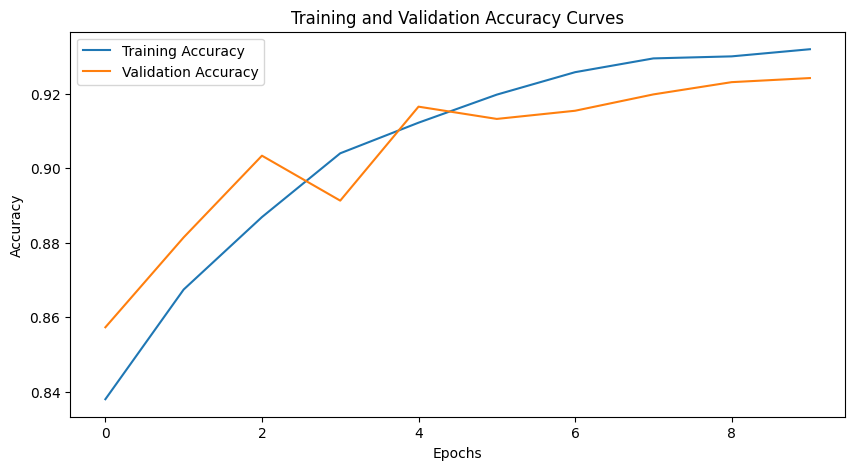

Final Training Metrics:
Test Loss: 0.1475
Accuracy: 0.9412
Precision: 0.9549
Recall: 0.9077
F1 Score: 0.9307


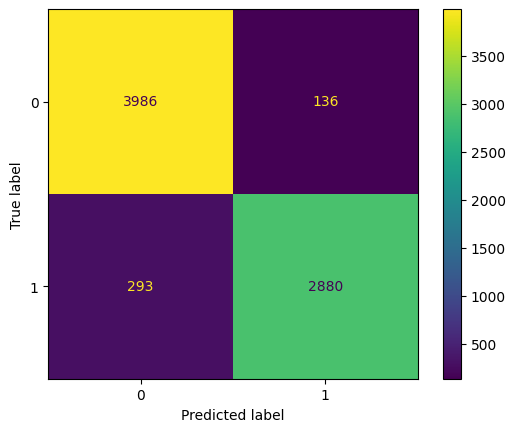

Final Test Metrics:
Test Loss: 0.2413
Accuracy: 0.8970
Precision: 0.9216
Recall: 0.8399
F1 Score: 0.8789


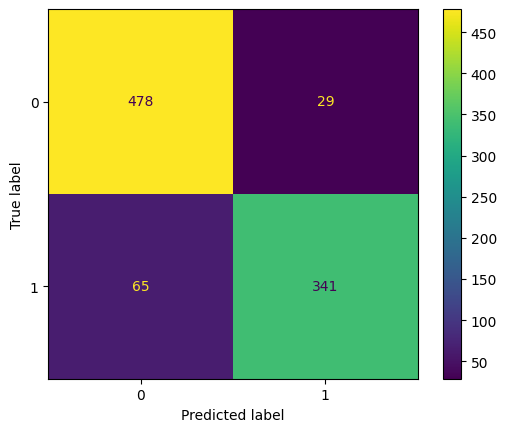

Experiment with Batch Size: 64, Learning Rate: 1e-05
Epoch 1


Test Loss: 0.5918
Accuracy: 0.8386
Precision: 0.8523
Recall: 0.7852
F1 Score: 0.8174


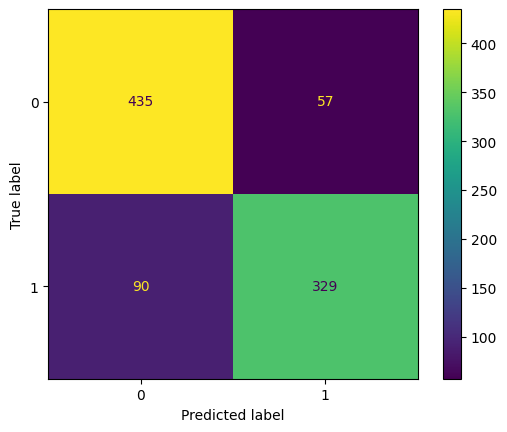

Epoch 2


Test Loss: 0.4554
Accuracy: 0.8310
Precision: 0.8932
Recall: 0.7184
F1 Score: 0.7963


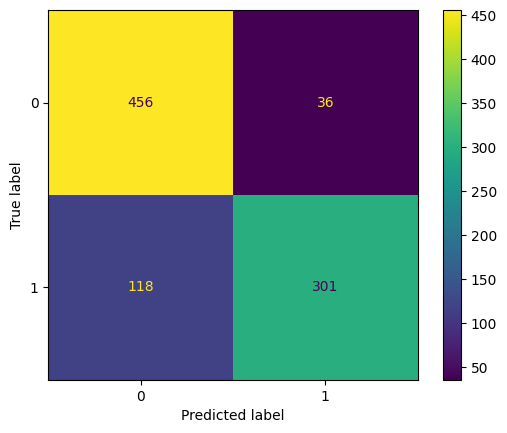

Epoch 3


Test Loss: 0.3900
Accuracy: 0.8375
Precision: 0.9274
Recall: 0.7017
F1 Score: 0.7989


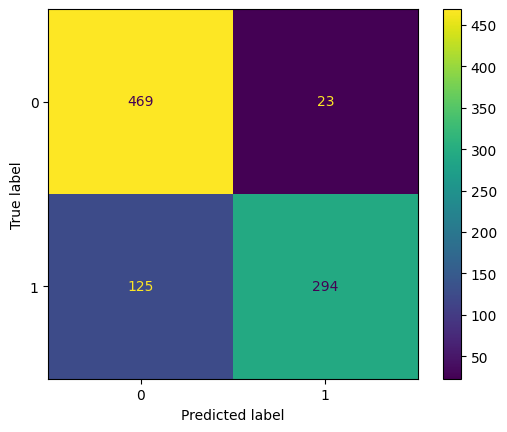

Epoch 4


Test Loss: 0.3711
Accuracy: 0.8375
Precision: 0.9248
Recall: 0.7041
F1 Score: 0.7995


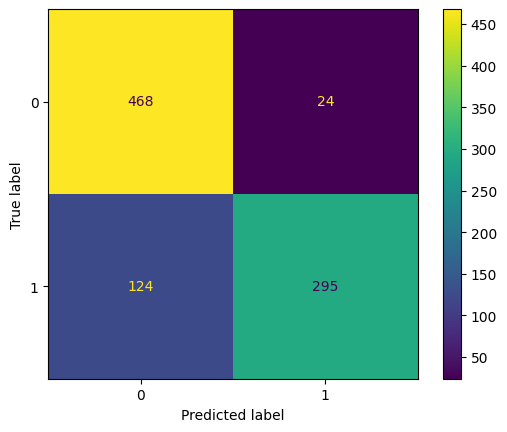

Epoch 5


Test Loss: 0.3620
Accuracy: 0.8408
Precision: 0.9308
Recall: 0.7064
F1 Score: 0.8033


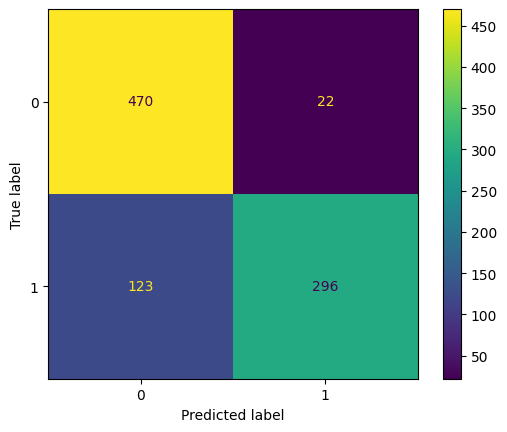

Epoch 6


Test Loss: 0.3557
Accuracy: 0.8507
Precision: 0.9492
Recall: 0.7136
F1 Score: 0.8147


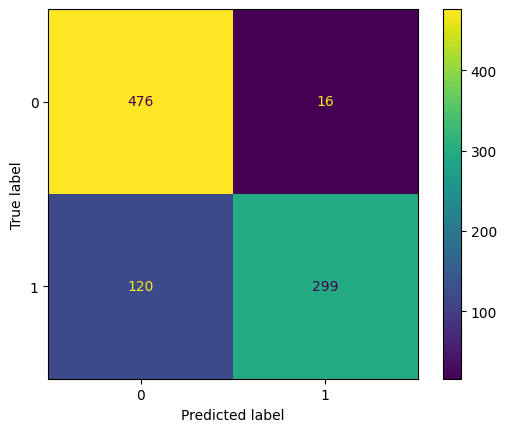

Epoch 7


Test Loss: 0.3510
Accuracy: 0.8540
Precision: 0.9583
Recall: 0.7136
F1 Score: 0.8181


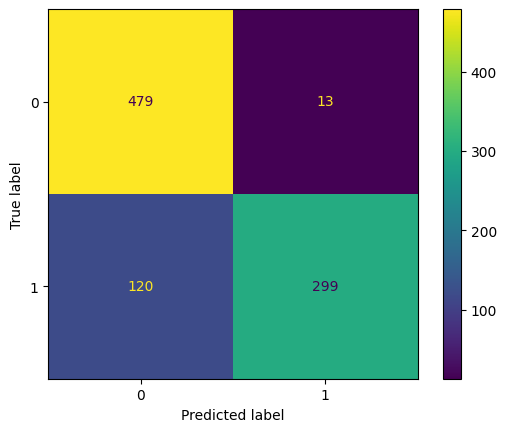

Epoch 8


Test Loss: 0.3449
Accuracy: 0.8595
Precision: 0.9533
Recall: 0.7303
F1 Score: 0.8270


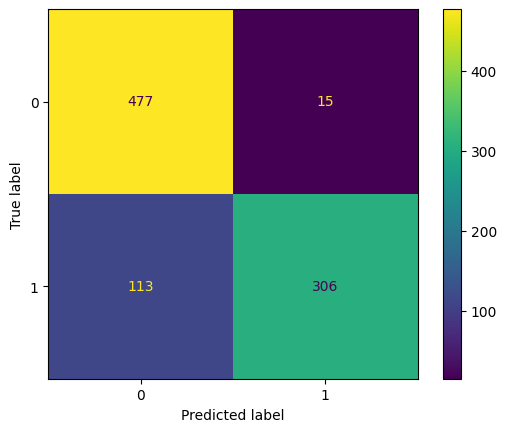

Epoch 9


Test Loss: 0.3418
Accuracy: 0.8606
Precision: 0.9620
Recall: 0.7255
F1 Score: 0.8272


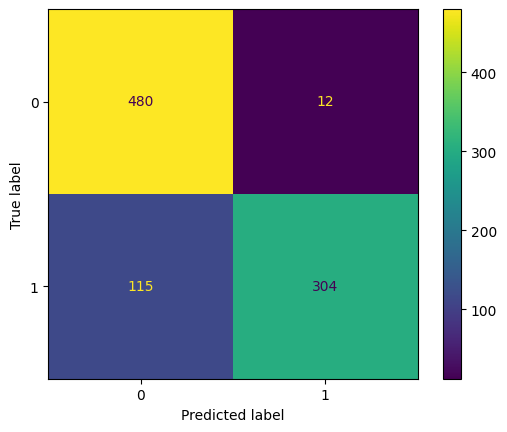

Epoch 10


Test Loss: 0.3344
Accuracy: 0.8683
Precision: 0.9628
Recall: 0.7422
F1 Score: 0.8383


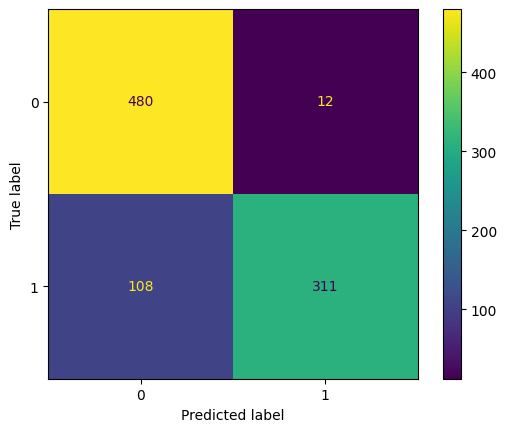

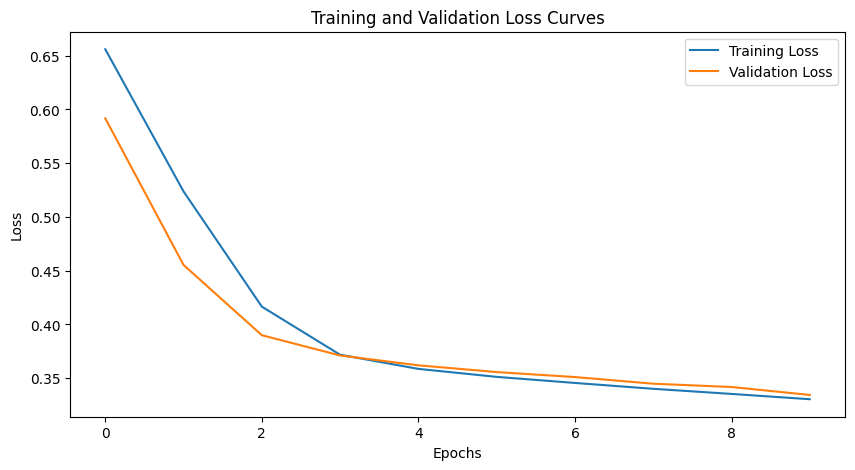

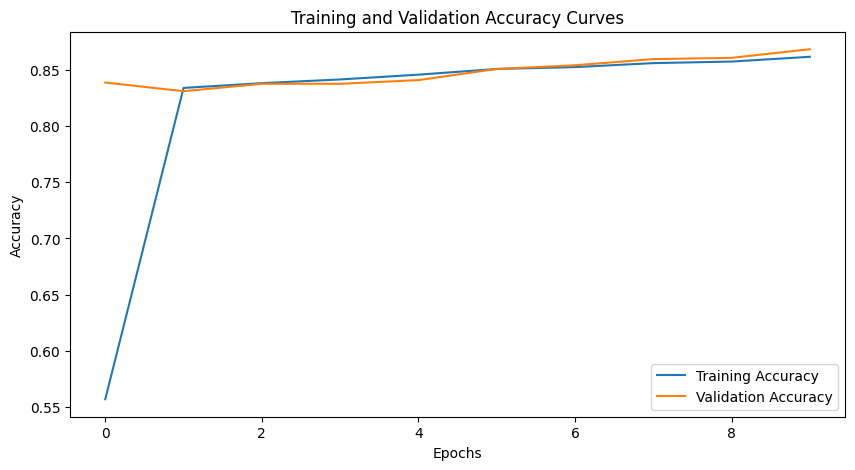

Final Training Metrics:
Test Loss: 0.3270
Accuracy: 0.8635
Precision: 0.9185
Recall: 0.7529
F1 Score: 0.8275


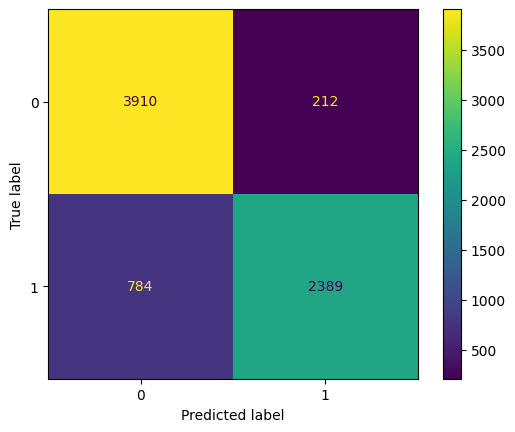

Final Test Metrics:
Test Loss: 0.3338
Accuracy: 0.8686
Precision: 0.9441
Recall: 0.7488
F1 Score: 0.8352


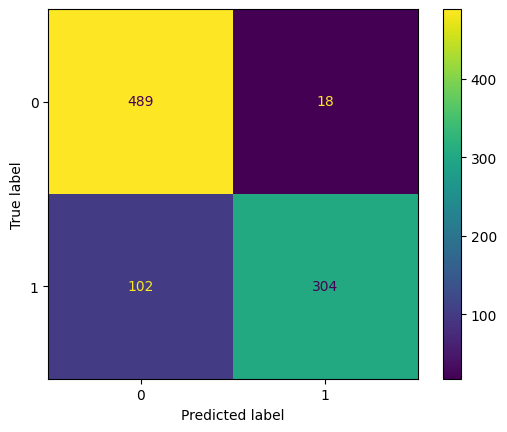

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from gensim.models import KeyedVectors
import nltk
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import string
from sklearn.metrics import ConfusionMatrixDisplay
from tqdm import tqdm  # For progress bars

# 1. Data Preparation and Preprocessing

class TwitterDataset(Dataset):
    def __init__(self, data_path, word2vec_path):
        self.data = self.load_data(data_path)
        self.word2vec = KeyedVectors.load_word2vec_format(word2vec_path, binary=True)
        self.embedding = nn.Embedding.from_pretrained(torch.FloatTensor(self.word2vec.vectors))

    def load_data(self, data_path):
        data = pd.read_csv(data_path, encoding='utf-8')
        return data

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        tweet = self.data.iloc[idx]['tweet']
        intention = self.data.iloc[idx]['intention']
        tokens = nltk.word_tokenize(tweet)

        # Preprocess text
        processed_tokens = [token.lower() for token in tokens if token.isalpha()]
        stop_words = set(nltk.corpus.stopwords.words('english'))
        processed_tokens = [token for token in processed_tokens if token not in stop_words]

        # Convert tokens to word embeddings
        embeddings = [self.word2vec.get_vector(token)
                       for token in processed_tokens
                       if token in self.word2vec.key_to_index]

        # Handle missing words
        if len(embeddings) < len(processed_tokens):
            embeddings += [np.zeros(self.word2vec.vector_size)] * (len(processed_tokens) - len(embeddings))

        # Pad or truncate sequences
        max_length = 100
        if len(embeddings) < max_length:
            embeddings += [np.zeros(self.word2vec.vector_size)] * (max_length - len(embeddings))
        else:
            embeddings = embeddings[:max_length]

        # Convert embeddings to float
        return torch.tensor(embeddings, dtype=torch.float), torch.tensor(intention)

# 2. CNN Model

class CNN(nn.Module):
    def __init__(self, embedding_dim, output_size):
        super(CNN, self).__init__()
        self.embedding_dim = embedding_dim
        self.output_size = output_size

        # Convolutional layers
        self.conv1 = nn.Conv1d(embedding_dim, 64, kernel_size=3, padding=1)
        self.conv2 = nn.Conv1d(64, 64, kernel_size=5, padding=2)
        self.conv3 = nn.Conv1d(64, 64, kernel_size=7, padding=3)
        self.conv4 = nn.Conv1d(64, 128, kernel_size=3, padding=1)
        self.conv5 = nn.Conv1d(128, 128, kernel_size=5, padding=2)
        self.conv6 = nn.Conv1d(128, 128, kernel_size=7, padding=3)

        # Activation function
        self.relu = nn.ReLU()

        # Max pooling layer
        self.maxpool = nn.MaxPool1d(kernel_size=2, padding=1)

        # Flatten layer
        self.flatten = nn.Flatten()

        # Linear layers
        output_size_after_flatten = 64 * 78   # Assuming your pooling results in a sequence length of 24
        self.fc1 = nn.Linear(output_size_after_flatten, 128)
        self.fc2 = nn.Linear(128, output_size)

    def forward(self, x):
        # Transpose the input
        x = x.transpose(1, 2)  # Change from [batch_size, sequence_length, embedding_dim] to [batch_size, embedding_dim, sequence_length]

        # Apply convolutional layers
        x1 = self.relu(self.conv1(x))
        x2 = self.relu(self.conv2(x1))
        x3 = self.relu(self.conv3(x2))

        x1 = self.maxpool(x1)
        x2 = self.maxpool(x2)
        x3 = self.maxpool(x3)

        x = torch.cat([x1, x2, x3], dim=1)

        x = self.maxpool(x)

        # Flatten the output
        x = self.flatten(x)

        # Apply linear layers
        x = self.relu(self.fc1(x))
        x = self.fc2(x)

        return x

# 3. Training and Evaluation

class Trainer:
    def __init__(self, model, optimizer, criterion, device):
        self.model = model
        self.optimizer = optimizer
        self.criterion = criterion
        self.device = device
        self.train_losses = []
        self.val_losses = []
        self.train_accuracies = []
        self.val_accuracies = []

    def train_step(self, batch):
        self.model.train()
        self.optimizer.zero_grad()
        data, target = batch
        data = data.to(self.device)
        target = target.to(self.device)
        output = self.model(data)
        loss = self.criterion(output, target)
        loss.backward()
        self.optimizer.step()
        return loss.item(), output, target

    def train_epoch(self, train_loader):
        epoch_loss = 0
        correct = 0
        total = 0
        with tqdm(train_loader, unit='batch', leave=False) as tepoch:  # Progress bar
            for batch in tepoch:
                loss, output, target = self.train_step(batch)
                epoch_loss += loss
                tepoch.set_description(f'Training Loss: {loss:.4f}')
                total += target.size(0)
                correct += (torch.argmax(output, dim=1) == target).sum().item()
        self.train_losses.append(epoch_loss / len(train_loader))
        self.train_accuracies.append(correct / total)

    def evaluate(self, test_loader):
        self.model.eval()
        total_loss = 0
        y_true = []
        y_pred = []
        correct = 0
        total = 0
        with torch.no_grad():
            for batch in test_loader:
                data, target = batch
                data = data.to(self.device)
                target = target.to(self.device)
                output = self.model(data)
                loss = self.criterion(output, target)
                total_loss += loss.item()
                y_true.extend(target.tolist())
                y_pred.extend(torch.argmax(output, dim=1).tolist())
                total += target.size(0)
                correct += (torch.argmax(output, dim=1) == target).sum().item()

        accuracy = accuracy_score(y_true, y_pred)
        precision = precision_score(y_true, y_pred)
        recall = recall_score(y_true, y_pred)
        f1 = f1_score(y_true, y_pred)

        print(f'Test Loss: {total_loss/len(test_loader):.4f}')
        print(f'Accuracy: {accuracy:.4f}')
        print(f'Precision: {precision:.4f}')
        print(f'Recall: {recall:.4f}')
        print(f'F1 Score: {f1:.4f}')

        # Confusion matrix
        cm = confusion_matrix(y_true, y_pred)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm)
        disp.plot()
        plt.show()

        return total_loss/len(test_loader), accuracy, precision, recall, f1

    def train(self, train_loader, val_loader, epochs):
        for epoch in range(epochs):
            print(f"Epoch {epoch+1}")
            self.train_epoch(train_loader)
            val_loss, val_accuracy, val_precision, val_recall, val_f1 = self.evaluate(val_loader)
            self.val_losses.append(val_loss)
            self.val_accuracies.append(val_accuracy)

        # Plot training and validation loss
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses, label='Validation Loss')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss Curves')
        plt.legend()
        plt.show()

        # Plot training and validation accuracy
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_accuracies, label='Training Accuracy')
        plt.plot(self.val_accuracies, label='Validation Accuracy')
        plt.xlabel('Epochs')
        plt.ylabel('Accuracy')
        plt.title('Training and Validation Accuracy Curves')
        plt.legend()
        plt.show()

        # Report final training and test metrics
        print("Final Training Metrics:")
        self.evaluate(train_loader)
        print("Final Test Metrics:")
        self.evaluate(test_loader)

def run_experiment(batch_size, learning_rate):
    # ... (rest of your code, same as before)

    # Initialize model, optimizer, and loss function
    model = CNN(embedding_dim, output_size).to(device)  # Move model to device
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    criterion = nn.CrossEntropyLoss() # Using Cross-Entropy Loss

    # Train the model
    trainer = Trainer(model, optimizer, criterion, device)
    trainer.train(train_loader, val_loader, epochs)

if __name__ == '__main__':
    # Define parameters
    data_path = 'twitter-suicidal-data.csv'
    word2vec_path = "/content/drive/MyDrive/Colab Notebooks/GoogleNews-vectors-negative300.bin"
    embedding_dim = 300
    output_size = 2
    epochs = 10

    # Load dataset
    dataset = TwitterDataset(data_path, word2vec_path)
    train_size = int(0.8 * len(dataset))
    val_size = int(0.1 * len(dataset))
    test_size = len(dataset) - train_size - val_size
    train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(dataset, [train_size, val_size, test_size])

    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

    # Choose device (CPU or GPU if available)
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

    # Experiment with different batch sizes and learning rates
    batch_sizes = [16, 32, 64]
    learning_rates = [0.001, 0.0001, 0.00001]

    for batch_size in batch_sizes:
        for learning_rate in learning_rates:
            print(f"Experiment with Batch Size: {batch_size}, Learning Rate: {learning_rate}")
            run_experiment(batch_size, learning_rate)

### With dropout and batch normalization


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from gensim.models import KeyedVectors
import nltk
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import string
from sklearn.metrics import ConfusionMatrixDisplay
from tqdm import tqdm

In [ ]:


# 1. Data Preparation and Preprocessing
class TwitterDataset(Dataset):
    def __init__(self, data_path, word2vec_path):
        self.data = self.load_data(data_path)
        self.word2vec = KeyedVectors.load_word2vec_format(word2vec_path, binary=True)
        self.embedding = nn.Embedding.from_pretrained(torch.FloatTensor(self.word2vec.vectors))

    def load_data(self, data_path):
        data = pd.read_csv(data_path, encoding='utf-8')
        return data

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        tweet = self.data.iloc[idx]['tweet']
        intention = self.data.iloc[idx]['intention']
        tokens = nltk.word_tokenize(tweet)

        # Preprocess text
        processed_tokens = [token.lower() for token in tokens if token.isalpha()]
        stop_words = set(nltk.corpus.stopwords.words('english'))
        processed_tokens = [token for token in processed_tokens if token not in stop_words]

        # Convert tokens to word embeddings
        embeddings = [self.word2vec.get_vector(token)
                      for token in processed_tokens
                      if token in self.word2vec.key_to_index]

        # Handle missing words
        if len(embeddings) < len(processed_tokens):
            embeddings += [np.zeros(self.word2vec.vector_size)] * (len(processed_tokens) - len(embeddings))

        # Pad or truncate sequences
        max_length = 100
        if len(embeddings) < max_length:
            embeddings += [np.zeros(self.word2vec.vector_size)] * (max_length - len(embeddings))
        else:
            embeddings = embeddings[:max_length]

        # Convert embeddings to float
        return torch.tensor(embeddings, dtype=torch.float), torch.tensor(intention)

In [ ]:


# 2. CNN Model
class CNN(nn.Module):
    def __init__(self, embedding_dim, output_size):
        super(CNN, self).__init__()
        self.embedding_dim = embedding_dim
        self.output_size = output_size

        # Convolutional layers
        self.conv1 = nn.Conv1d(embedding_dim, 64, kernel_size=3, padding=1)
        self.conv2 = nn.Conv1d(64, 64, kernel_size=5, padding=2)
        self.conv3 = nn.Conv1d(64, 64, kernel_size=7, padding=3)
        self.conv4 = nn.Conv1d(64, 128, kernel_size=3, padding=1)
        self.conv5 = nn.Conv1d(128, 128, kernel_size=5, padding=2)
        self.conv6 = nn.Conv1d(128, 128, kernel_size=7, padding=3)

        # Batch Normalization layers (after each convolutional layer)
        self.bn1 = nn.BatchNorm1d(64)
        self.bn2 = nn.BatchNorm1d(64)
        self.bn3 = nn.BatchNorm1d(64)
        self.bn4 = nn.BatchNorm1d(128)
        self.bn5 = nn.BatchNorm1d(128)
        self.bn6 = nn.BatchNorm1d(128)

        # Activation function
        self.relu = nn.ReLU()

        # Max pooling layer
        self.maxpool = nn.MaxPool1d(kernel_size=2, padding=1)

        # Flatten layer
        self.flatten = nn.Flatten()

        # Linear layers
        output_size_after_flatten = 64 * 78 # Assuming pooling results in a sequence length of 24
        self.fc1 = nn.Linear(output_size_after_flatten, 128)
        self.fc2 = nn.Linear(128, output_size)

        # Dropout layer (after the first linear layer)
        self.dropout = nn.Dropout(0.5) # You can adjust the dropout rate here

    def forward(self, x):
        # Transpose the input
        x = x.transpose(1, 2) # Change from [batch_size, sequence_length, embedding_dim] to [batch_size, embedding_dim, sequence_length]

        # Apply convolutional layers with Batch Normalization
        x1 = self.relu(self.bn1(self.conv1(x)))
        x2 = self.relu(self.bn2(self.conv2(x1)))
        x3 = self.relu(self.bn3(self.conv3(x2)))
        x1 = self.maxpool(x1)
        x2 = self.maxpool(x2)
        x3 = self.maxpool(x3)
        x = torch.cat([x1, x2, x3], dim=1)
        x = self.maxpool(x)

        # Flatten the output
        x = self.flatten(x)

        # Apply linear layers with Dropout
        x = self.relu(self.fc1(x))
        x = self.dropout(x)  # Apply dropout
        x = self.fc2(x)

        return x


In [ ]:

# 3. Training and Evaluation
class Trainer:
    def __init__(self, model, optimizer, criterion, device):
        self.model = model
        self.optimizer = optimizer
        self.criterion = criterion
        self.device = device
        self.train_losses = []
        self.val_losses = []
        self.train_accuracies = []
        self.val_accuracies = []

    def train_step(self, batch):
        self.model.train()
        self.optimizer.zero_grad()
        data, target = batch
        data = data.to(self.device)
        target = target.to(self.device)
        output = self.model(data)
        loss = self.criterion(output, target)
        loss.backward()
        self.optimizer.step()
        return loss.item(), output, target

    def train_epoch(self, train_loader):
        epoch_loss = 0
        correct = 0
        total = 0
        with tqdm(train_loader, unit='batch', leave=False) as tepoch:
            for batch in tepoch:
                loss, output, target = self.train_step(batch)
                epoch_loss += loss
                tepoch.set_description(f'Training Loss: {loss:.4f}')
                total += target.size(0)
                correct += (torch.argmax(output, dim=1) == target).sum().item()
        self.train_losses.append(epoch_loss / len(train_loader))
        self.train_accuracies.append(correct / total)

    def evaluate(self, test_loader):
        self.model.eval()
        total_loss = 0
        y_true = []
        y_pred = []
        correct = 0
        total = 0
        with torch.no_grad():
            for batch in test_loader:
                data, target = batch
                data = data.to(self.device)
                target = target.to(self.device)
                output = self.model(data)
                loss = self.criterion(output, target)
                total_loss += loss.item()
                y_true.extend(target.tolist())
                y_pred.extend(torch.argmax(output, dim=1).tolist())
                total += target.size(0)
                correct += (torch.argmax(output, dim=1) == target).sum().item()
        accuracy = accuracy_score(y_true, y_pred)
        precision = precision_score(y_true, y_pred)
        recall = recall_score(y_true, y_pred)
        f1 = f1_score(y_true, y_pred)
        print(f'Test Loss: {total_loss/len(test_loader):.4f}')
        print(f'Accuracy: {accuracy:.4f}')
        print(f'Precision: {precision:.4f}')
        print(f'Recall: {recall:.4f}')
        print(f'F1 Score: {f1:.4f}')
        # Confusion matrix
        cm = confusion_matrix(y_true, y_pred)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm)
        disp.plot()
        plt.show()
        return total_loss/len(test_loader), accuracy, precision, recall, f1

    def train(self, train_loader, val_loader, epochs):
        for epoch in range(epochs):
            print(f"Epoch {epoch+1}")
            self.train_epoch(train_loader)
            val_loss, val_accuracy, val_precision, val_recall, val_f1 = self.evaluate(val_loader)
            self.val_losses.append(val_loss)
            self.val_accuracies.append(val_accuracy)

            # Plot training and validation loss
            plt.figure(figsize=(10, 5))
            plt.plot(self.train_losses, label='Training Loss')
            plt.plot(self.val_losses, label='Validation Loss')
            plt.xlabel('Epochs')
            plt.ylabel('Loss')
            plt.title('Training and Validation Loss Curves')
            plt.legend()
            plt.show()

            # Plot training and validation accuracy
            plt.figure(figsize=(10, 5))
            plt.plot(self.train_accuracies, label='Training Accuracy')
            plt.plot(self.val_accuracies, label='Validation Accuracy')
            plt.xlabel('Epochs')
            plt.ylabel('Accuracy')
            plt.title('Training and Validation Accuracy Curves')
            plt.legend()
            plt.show()

            # Report final training and test metrics
            print("Final Training Metrics:")
            self.evaluate(train_loader)
            print("Final Test Metrics:")
            self.evaluate(test_loader)

In [ ]:

def run_experiment(batch_size, learning_rate):
    # ... (rest of your code, same as before)
    # Initialize model, optimizer, and loss function
    model = CNN(embedding_dim, output_size).to(device)
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    criterion = nn.CrossEntropyLoss() # Using Cross-Entropy Loss
    # Train the model
    trainer = Trainer(model, optimizer, criterion, device)
    trainer.train(train_loader, val_loader, epochs)

Experiment with Batch Size: 16, Learning Rate: 0.001
Epoch 1


  0%|          | 0/114 [00:00<?, ?batch/s]<ipython-input-11-ed9b6303c5db>:42: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:274.)
  return torch.tensor(embeddings, dtype=torch.float), torch.tensor(intention)


Test Loss: 0.2280
Accuracy: 0.9023
Precision: 0.9738
Recall: 0.8072
F1 Score: 0.8827


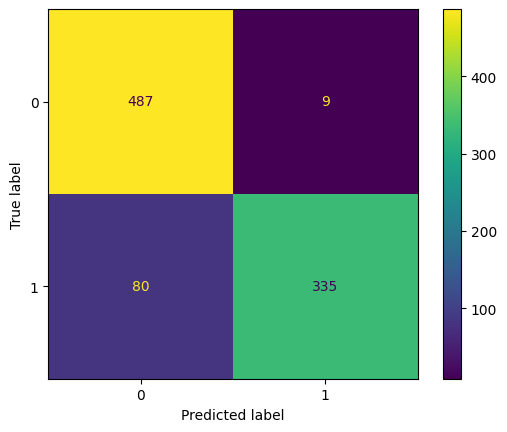

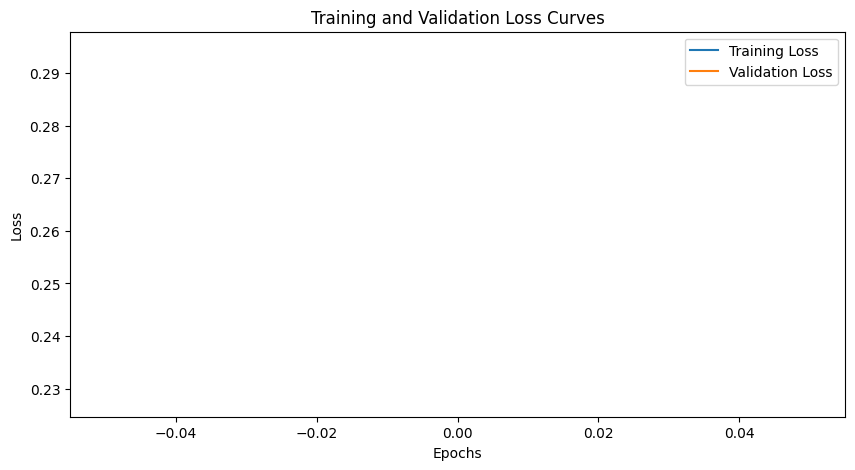

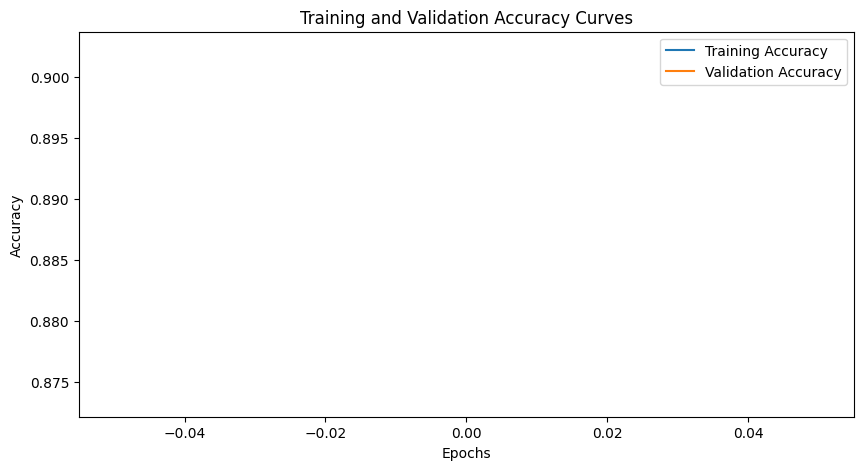

Final Training Metrics:
Test Loss: 0.1758
Accuracy: 0.9246
Precision: 0.9682
Recall: 0.8545
F1 Score: 0.9078


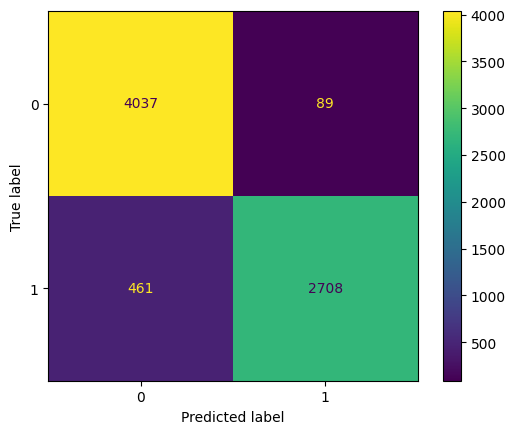

Final Test Metrics:
Test Loss: 0.2697
Accuracy: 0.8959
Precision: 0.9570
Recall: 0.8068
F1 Score: 0.8755


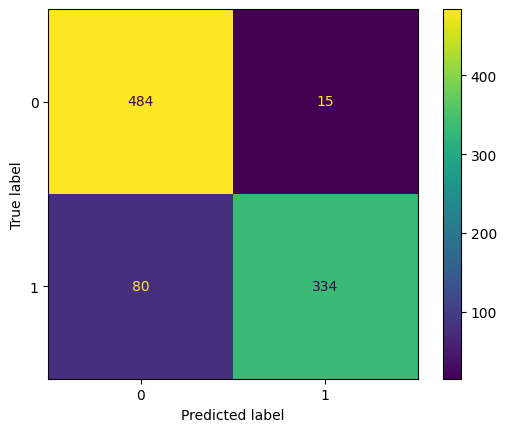

Epoch 2


Test Loss: 0.1988
Accuracy: 0.9111
Precision: 0.9489
Recall: 0.8506
F1 Score: 0.8971


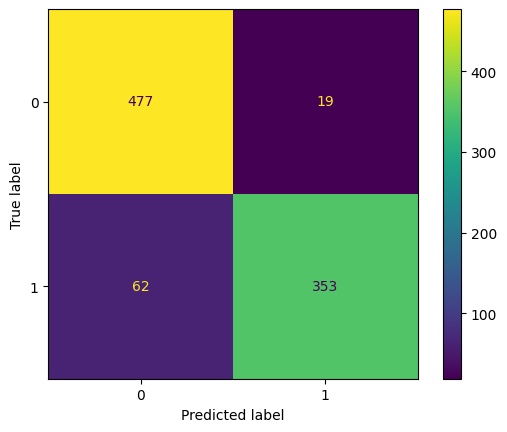

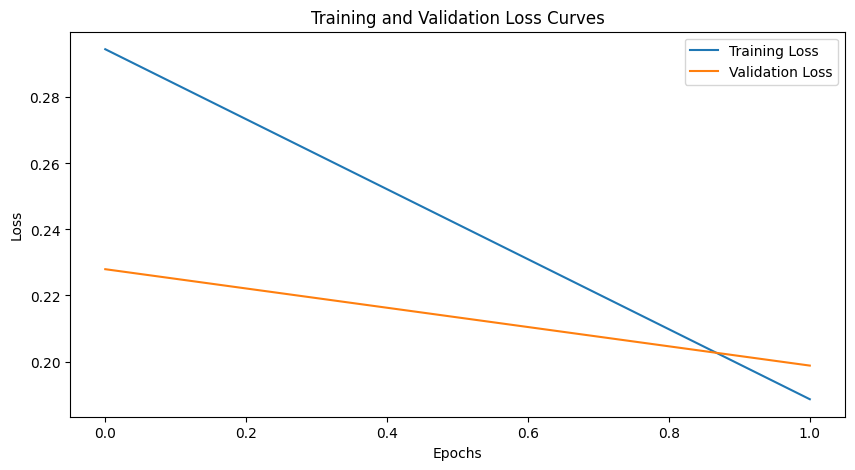

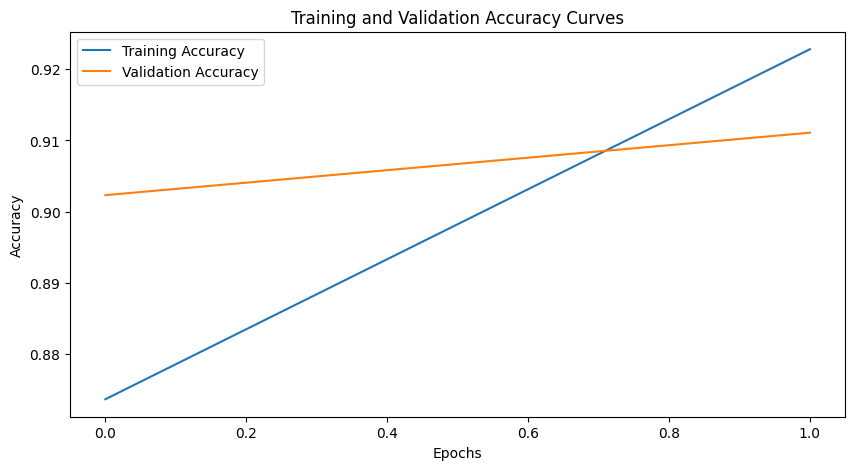

Final Training Metrics:
Test Loss: 0.1245
Accuracy: 0.9479
Precision: 0.9613
Recall: 0.9170
F1 Score: 0.9386


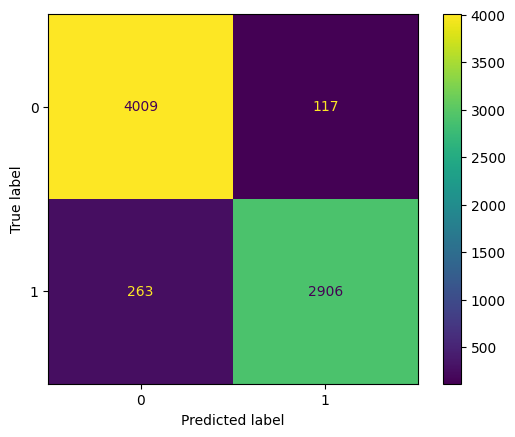

Final Test Metrics:
Test Loss: 0.2188
Accuracy: 0.9014
Precision: 0.9241
Recall: 0.8527
F1 Score: 0.8869


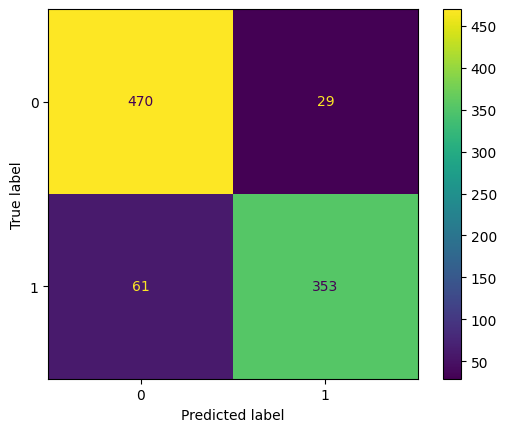

Epoch 3


Test Loss: 0.1988
Accuracy: 0.9232
Precision: 0.9528
Recall: 0.8747
F1 Score: 0.9121


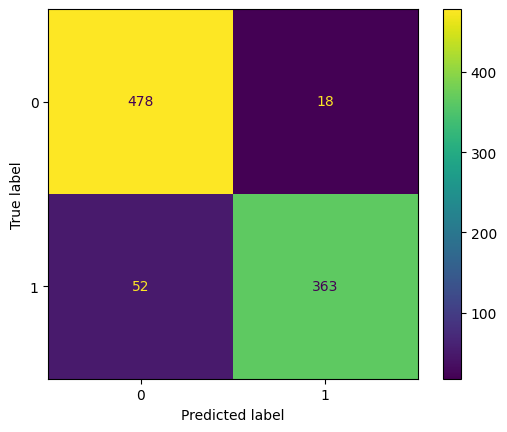

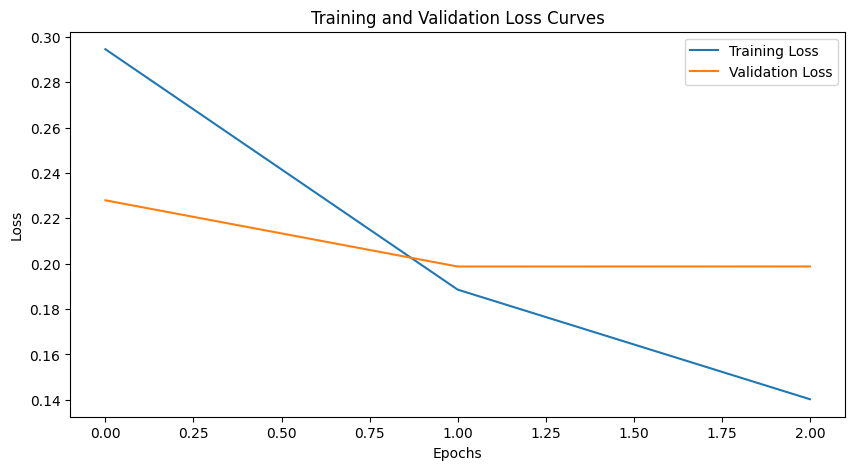

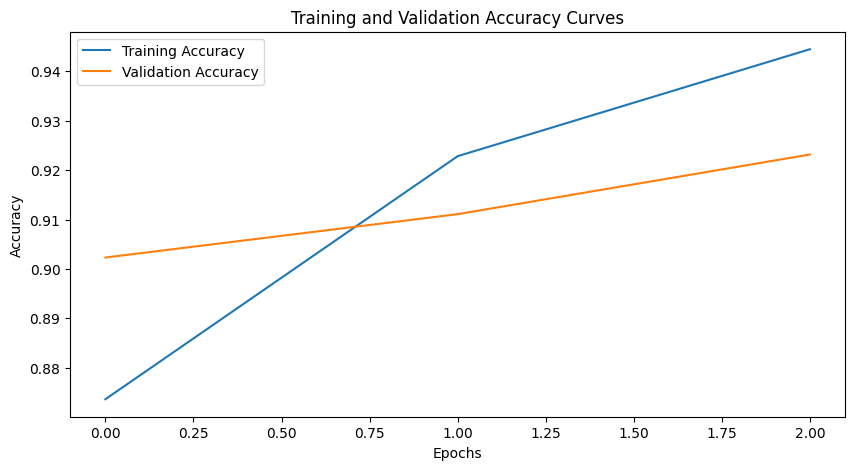

Final Training Metrics:
Test Loss: 0.0778
Accuracy: 0.9731
Precision: 0.9837
Recall: 0.9539
F1 Score: 0.9686


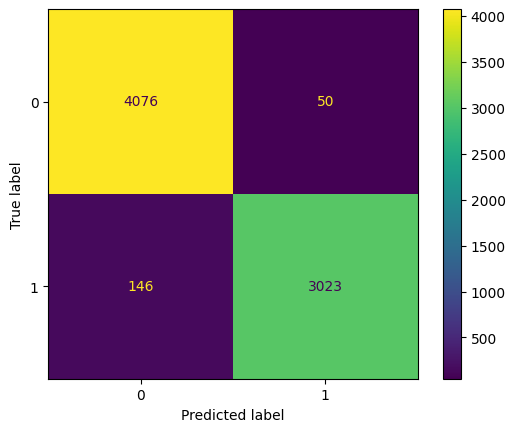

Final Test Metrics:
Test Loss: 0.2323
Accuracy: 0.9047
Precision: 0.9383
Recall: 0.8454
F1 Score: 0.8895


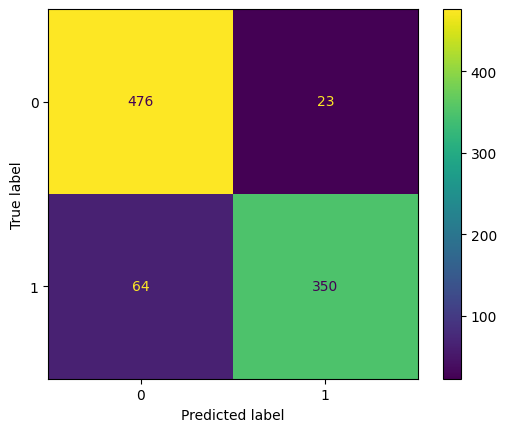

Epoch 4


Test Loss: 0.2029
Accuracy: 0.9221
Precision: 0.9365
Recall: 0.8892
F1 Score: 0.9122


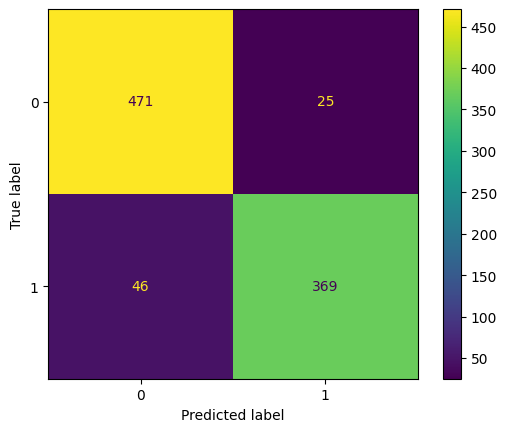

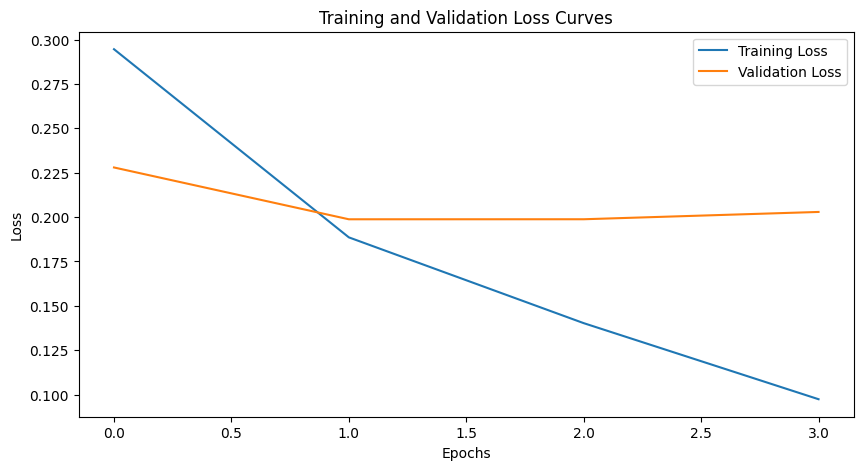

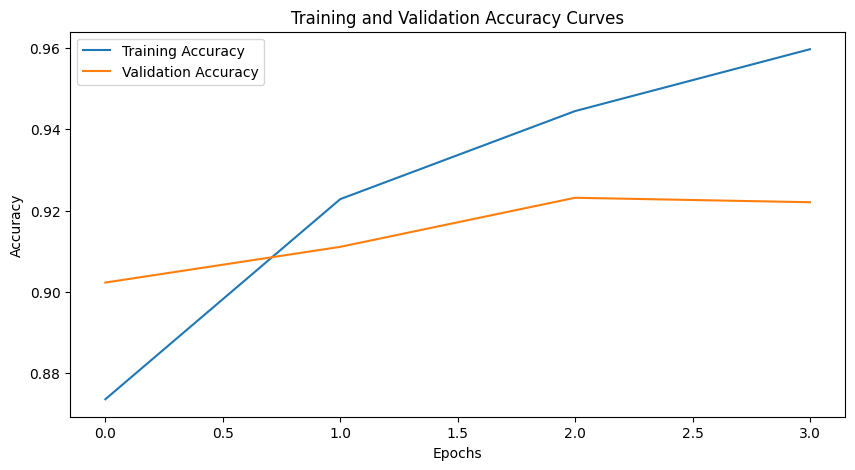

Final Training Metrics:
Test Loss: 0.0582
Accuracy: 0.9825
Precision: 0.9771
Recall: 0.9826
F1 Score: 0.9799


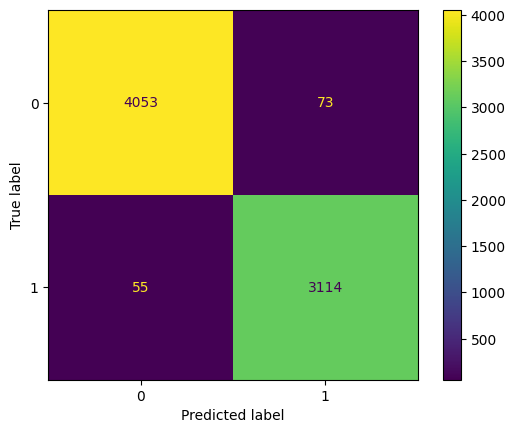

Final Test Metrics:
Test Loss: 0.2370
Accuracy: 0.9025
Precision: 0.9073
Recall: 0.8744
F1 Score: 0.8905


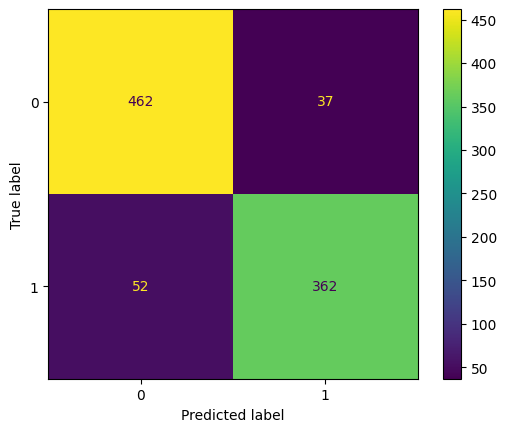

Epoch 5


Test Loss: 0.2723
Accuracy: 0.9188
Precision: 0.9128
Recall: 0.9084
F1 Score: 0.9106


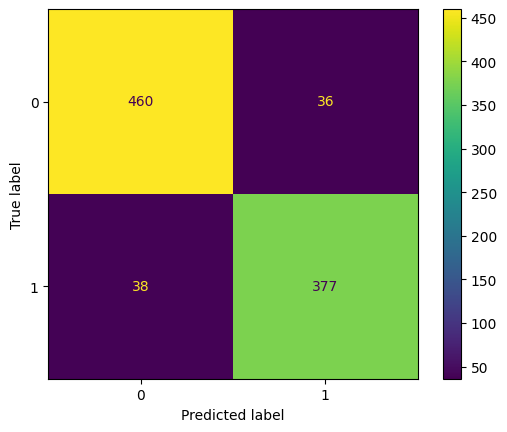

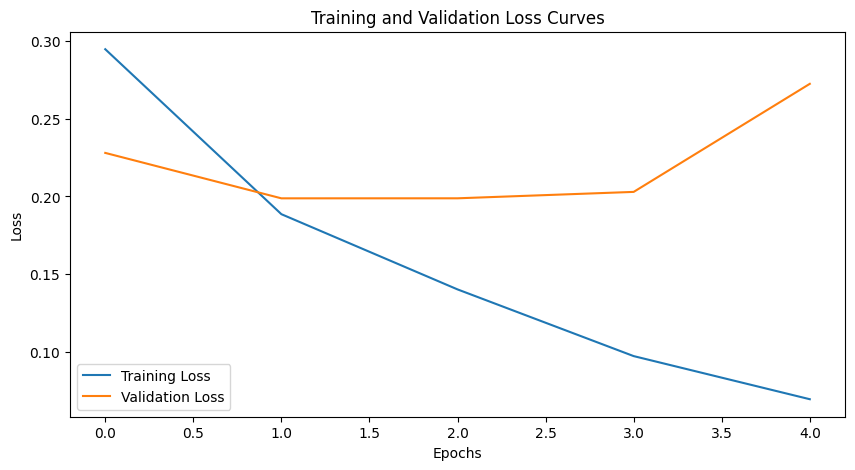

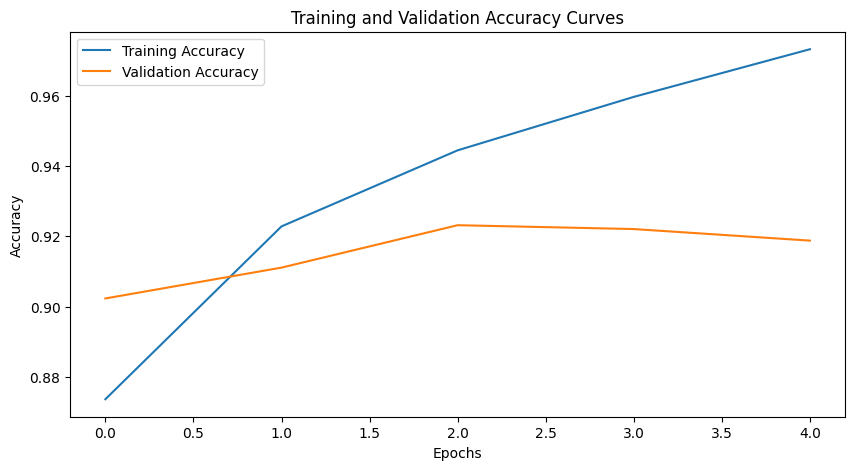

Final Training Metrics:
Test Loss: 0.0475
Accuracy: 0.9818
Precision: 0.9691
Recall: 0.9896
F1 Score: 0.9792


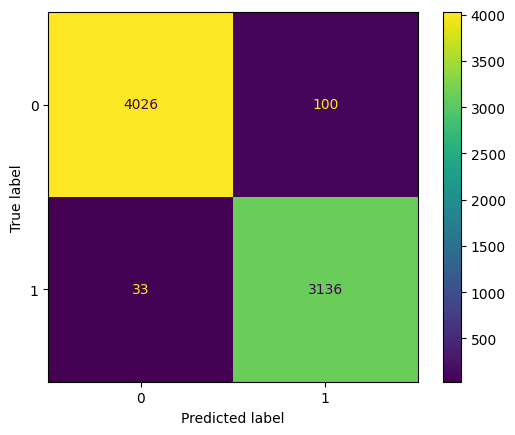

Final Test Metrics:
Test Loss: 0.3358
Accuracy: 0.8959
Precision: 0.8753
Recall: 0.8986
F1 Score: 0.8868


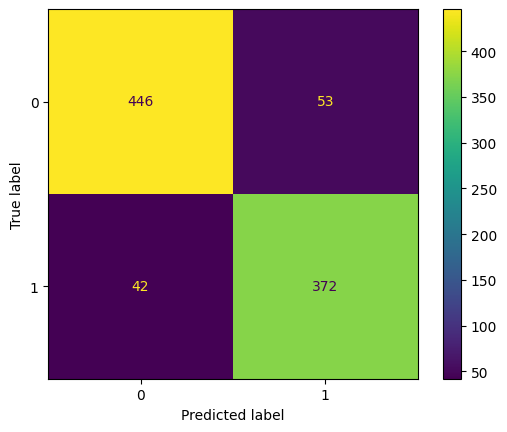

Epoch 6


Test Loss: 0.2979
Accuracy: 0.9166
Precision: 0.9165
Recall: 0.8988
F1 Score: 0.9075


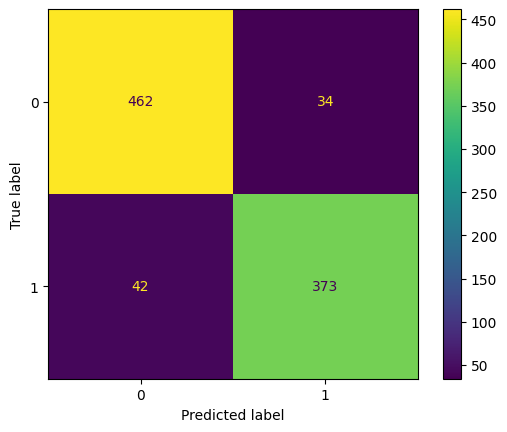

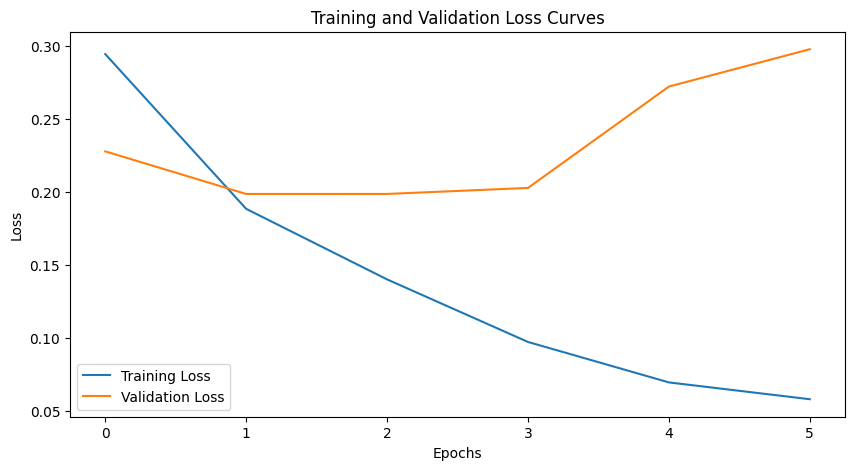

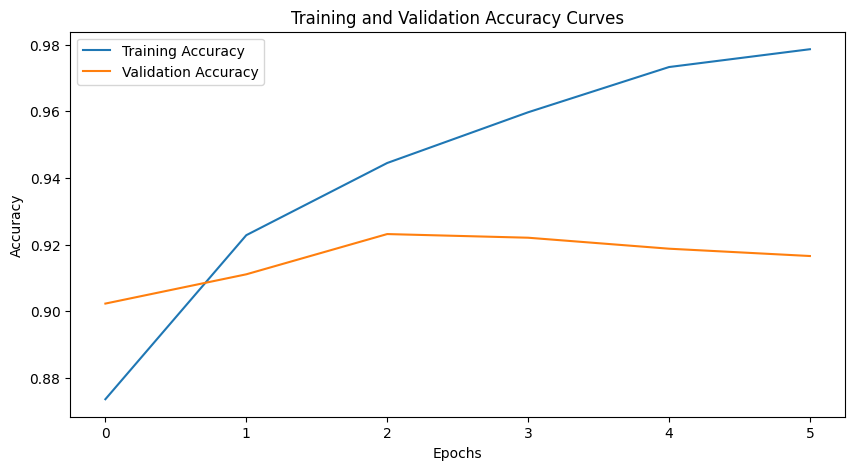

Final Training Metrics:
Test Loss: 0.0421
Accuracy: 0.9848
Precision: 0.9716
Recall: 0.9940
F1 Score: 0.9827


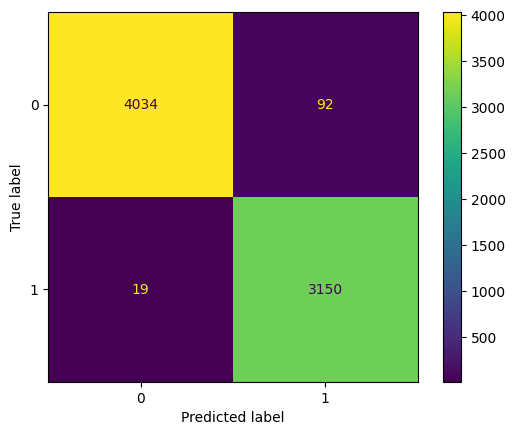

Final Test Metrics:
Test Loss: 0.3404
Accuracy: 0.9014
Precision: 0.8821
Recall: 0.9034
F1 Score: 0.8926


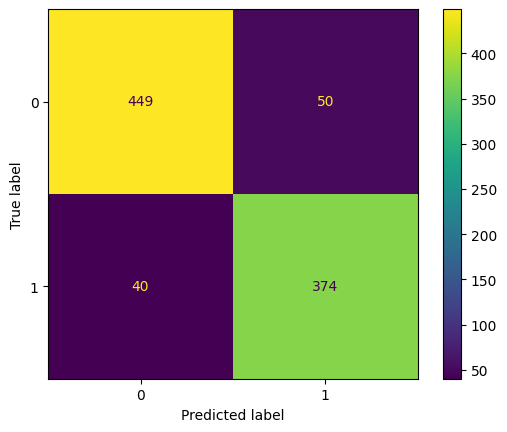

Epoch 7


Test Loss: 0.3630
Accuracy: 0.9188
Precision: 0.9252
Recall: 0.8940
F1 Score: 0.9093


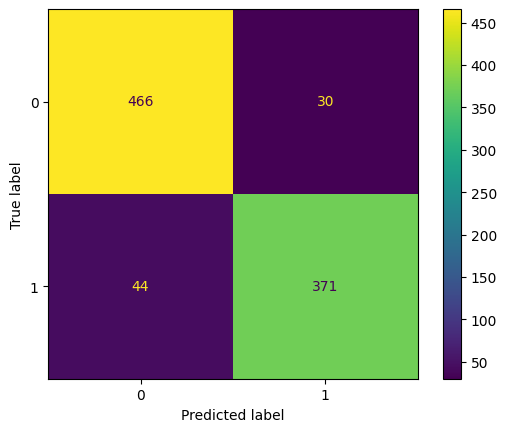

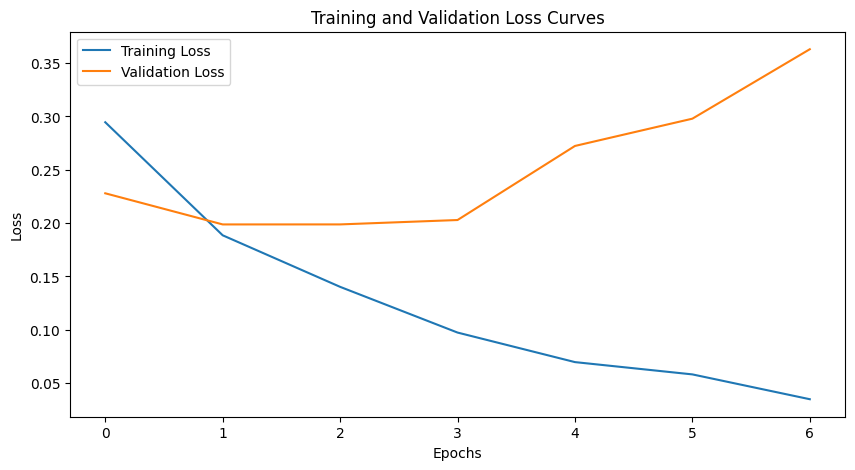

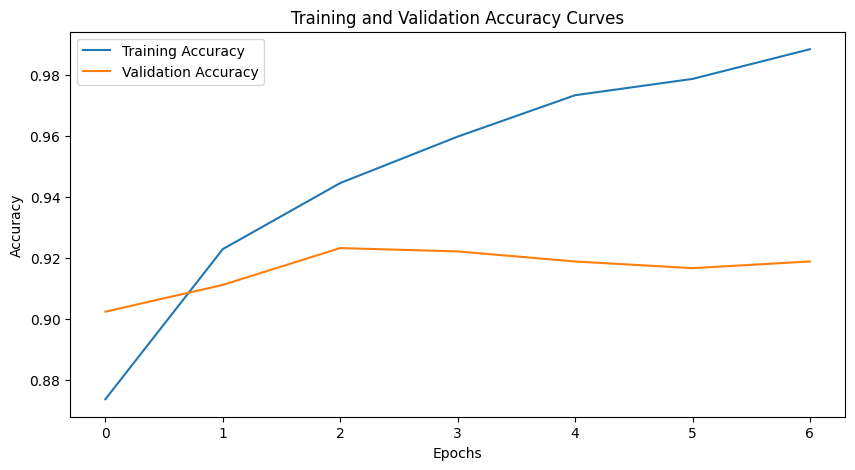

Final Training Metrics:
Test Loss: 0.0186
Accuracy: 0.9938
Precision: 0.9900
Recall: 0.9959
F1 Score: 0.9929


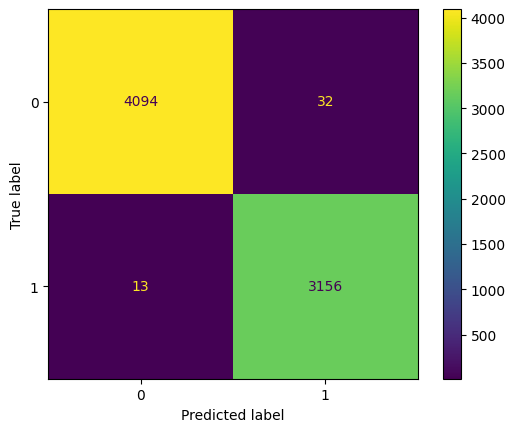

Final Test Metrics:
Test Loss: 0.4575
Accuracy: 0.8992
Precision: 0.9005
Recall: 0.8744
F1 Score: 0.8873


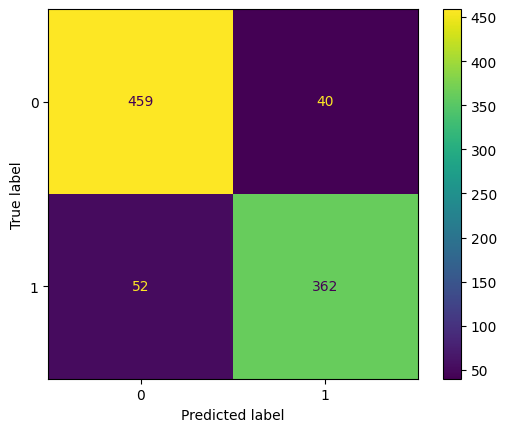

Epoch 8


Test Loss: 0.3299
Accuracy: 0.9155
Precision: 0.9024
Recall: 0.9133
F1 Score: 0.9078


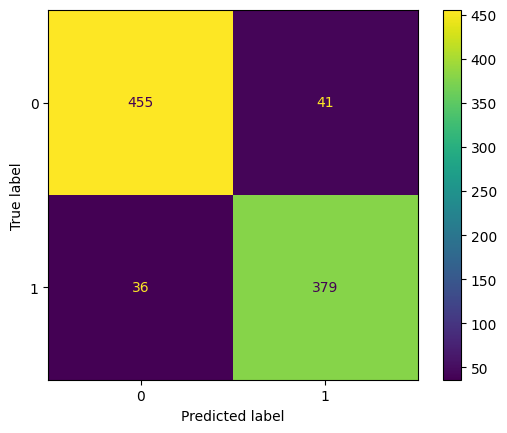

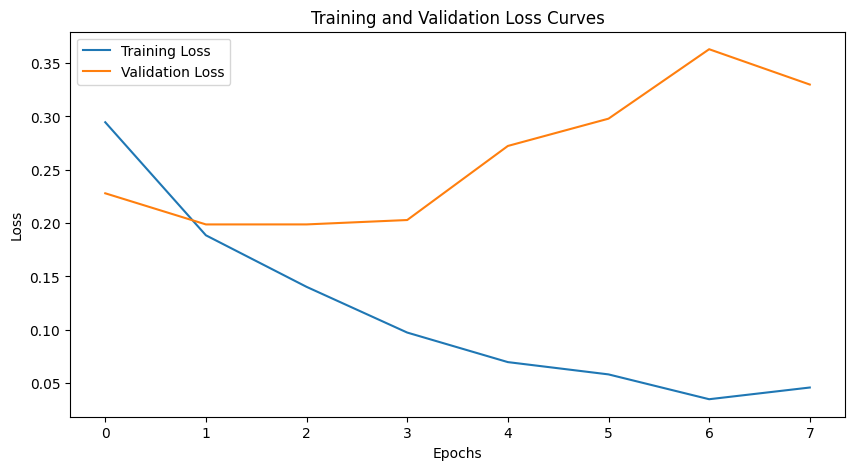

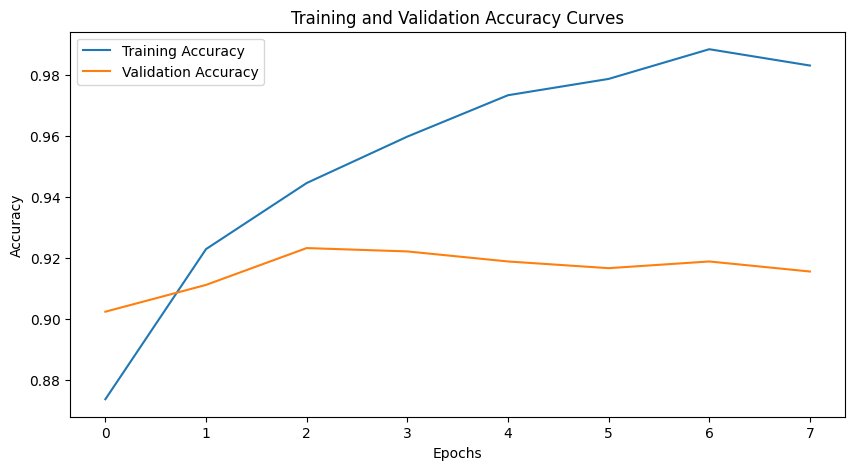

Final Training Metrics:
Test Loss: 0.0240
Accuracy: 0.9922
Precision: 0.9829
Recall: 0.9994
F1 Score: 0.9911


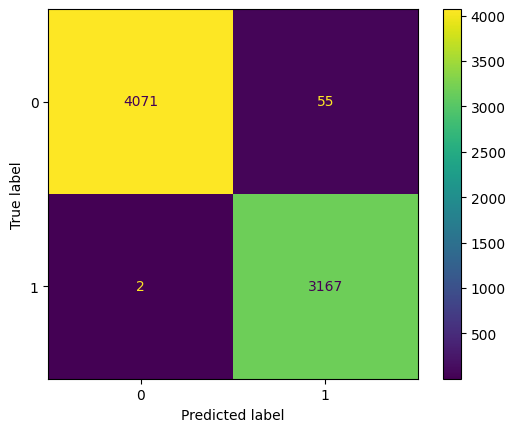

Final Test Metrics:
Test Loss: 0.3710
Accuracy: 0.9025
Precision: 0.8753
Recall: 0.9155
F1 Score: 0.8949


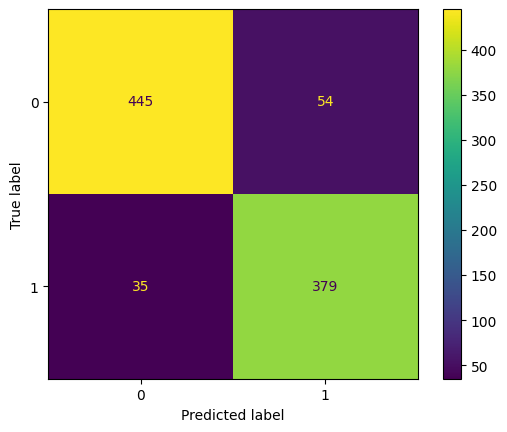

Epoch 9


Test Loss: 0.4724
Accuracy: 0.9155
Precision: 0.9225
Recall: 0.8892
F1 Score: 0.9055


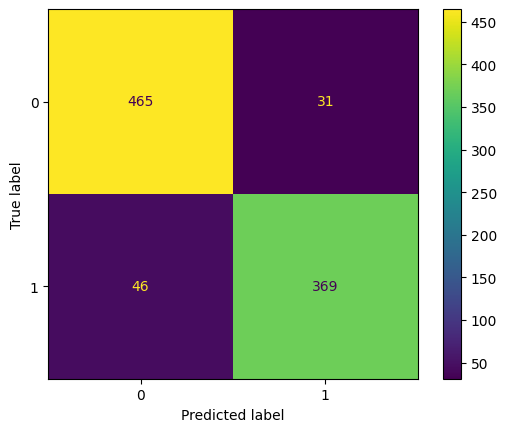

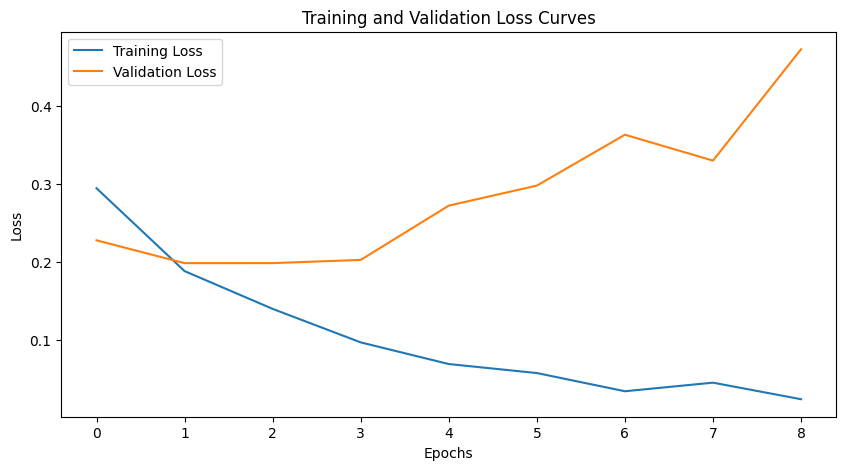

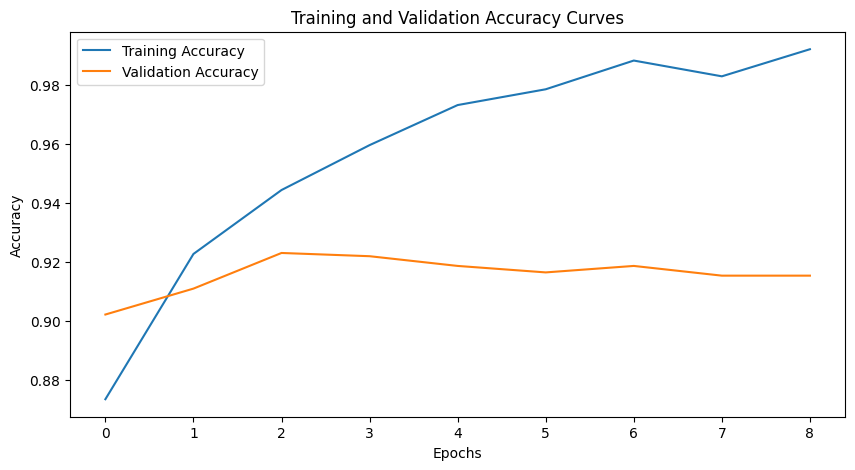

Final Training Metrics:
Test Loss: 0.0138
Accuracy: 0.9952
Precision: 0.9928
Recall: 0.9962
F1 Score: 0.9945


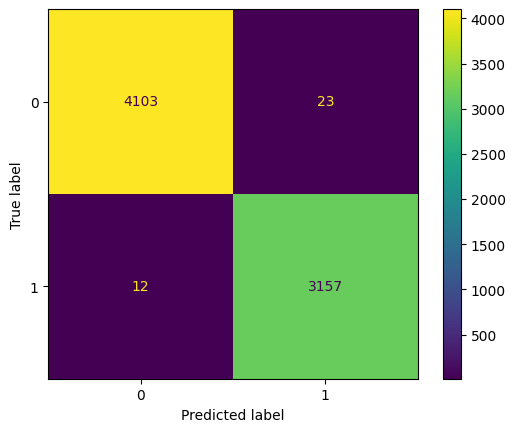

Final Test Metrics:
Test Loss: 0.5578
Accuracy: 0.8949
Precision: 0.8878
Recall: 0.8792
F1 Score: 0.8835


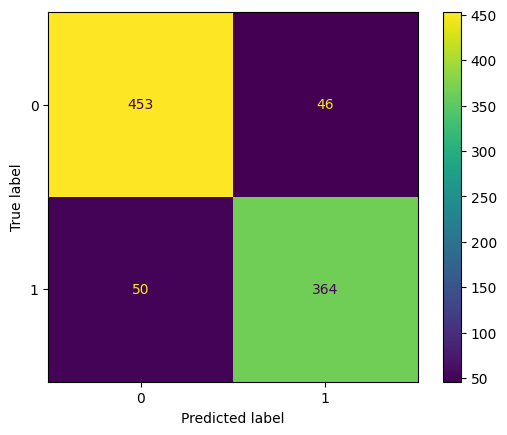

Epoch 10


Test Loss: 0.4578
Accuracy: 0.9177
Precision: 0.9250
Recall: 0.8916
F1 Score: 0.9080


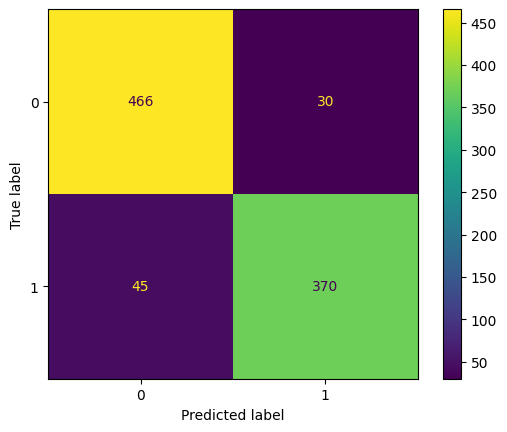

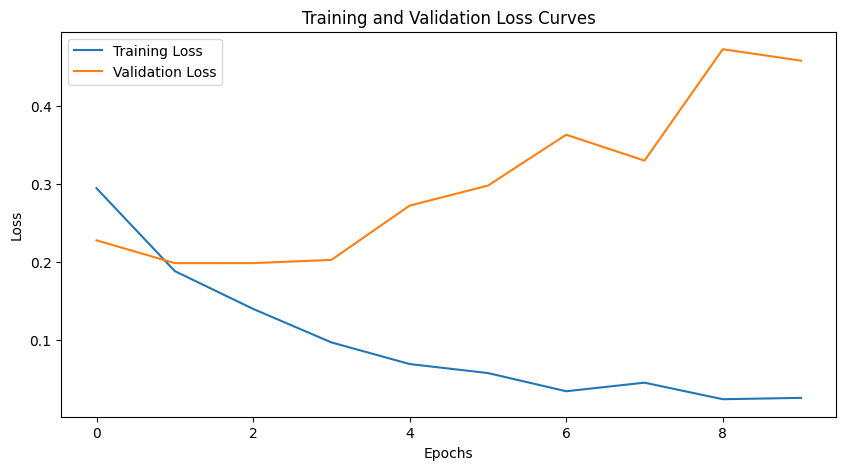

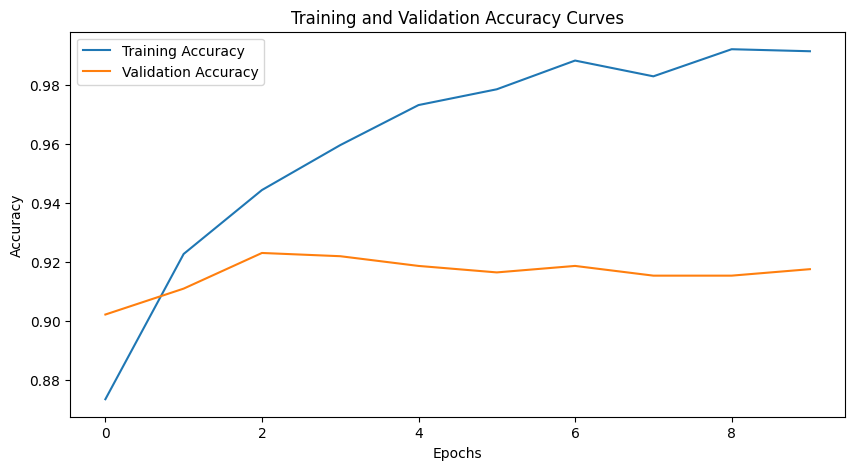

Final Training Metrics:
Test Loss: 0.0153
Accuracy: 0.9951
Precision: 0.9915
Recall: 0.9972
F1 Score: 0.9943


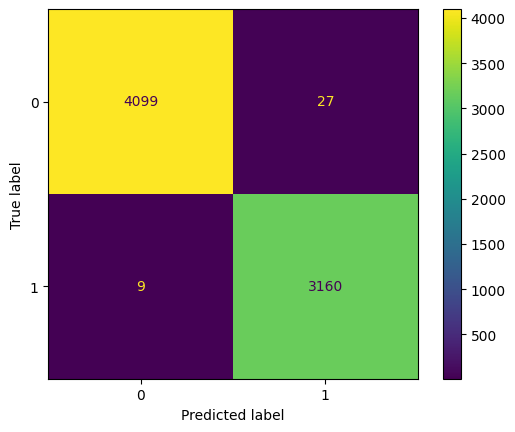

Final Test Metrics:
Test Loss: 0.5196
Accuracy: 0.8981
Precision: 0.8905
Recall: 0.8841
F1 Score: 0.8873


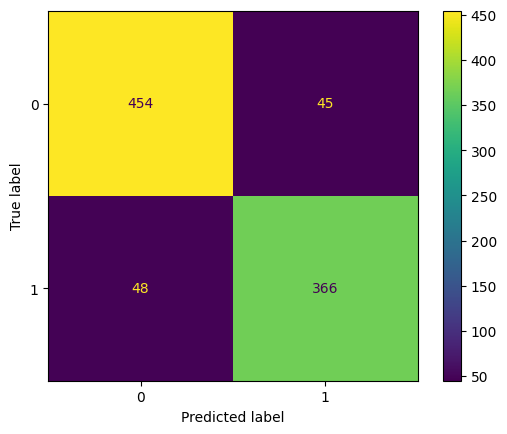

Experiment with Batch Size: 16, Learning Rate: 0.0001
Epoch 1


Test Loss: 0.3319
Accuracy: 0.8375
Precision: 0.8719
Recall: 0.7542
F1 Score: 0.8088


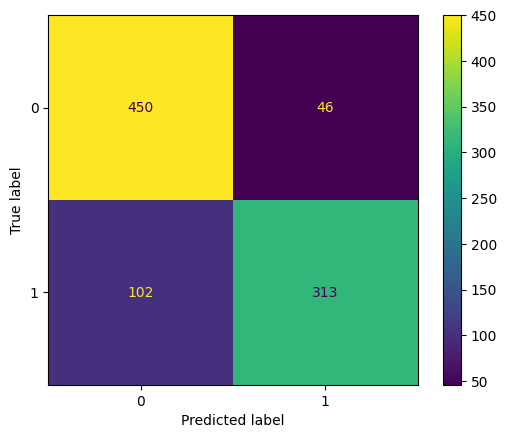

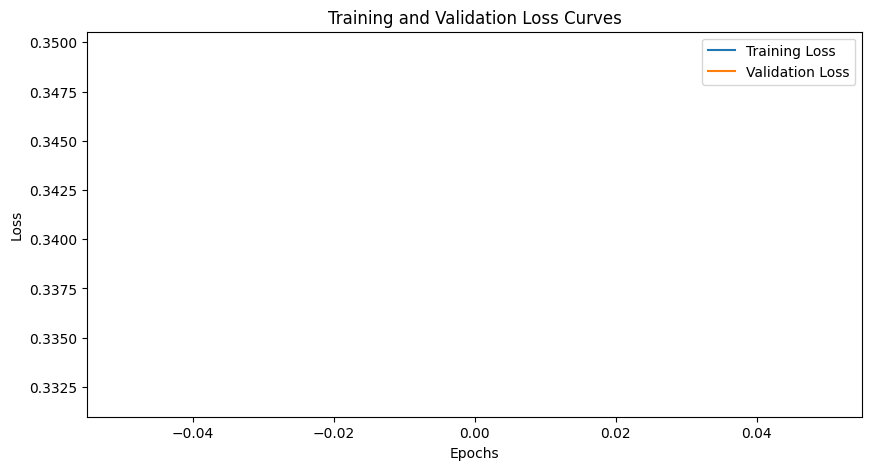

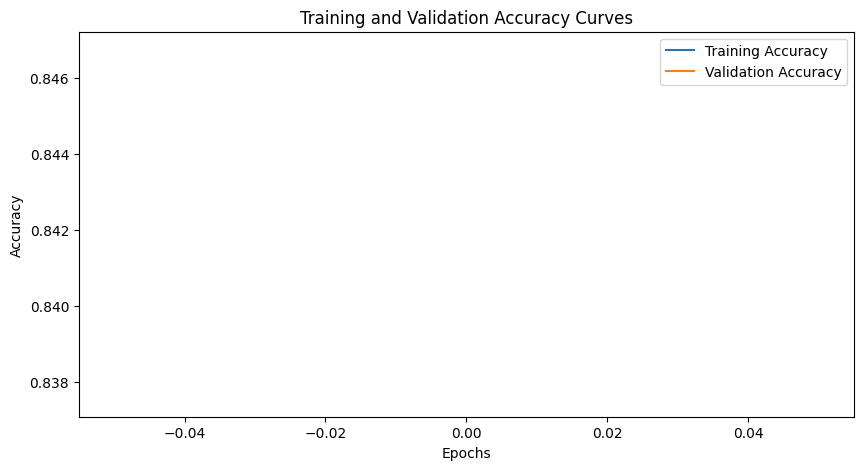

Final Training Metrics:
Test Loss: 0.2885
Accuracy: 0.8729
Precision: 0.9004
Recall: 0.7955
F1 Score: 0.8447


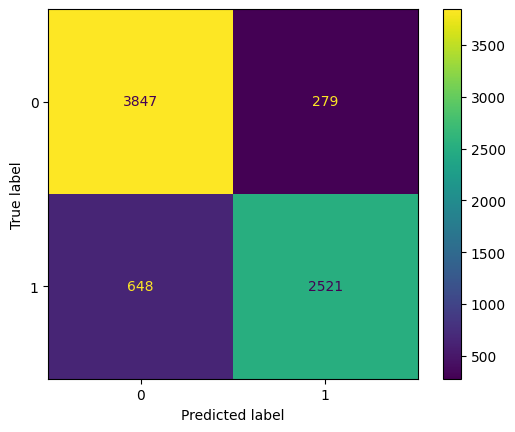

Final Test Metrics:
Test Loss: 0.3255
Accuracy: 0.8488
Precision: 0.8943
Recall: 0.7560
F1 Score: 0.8194


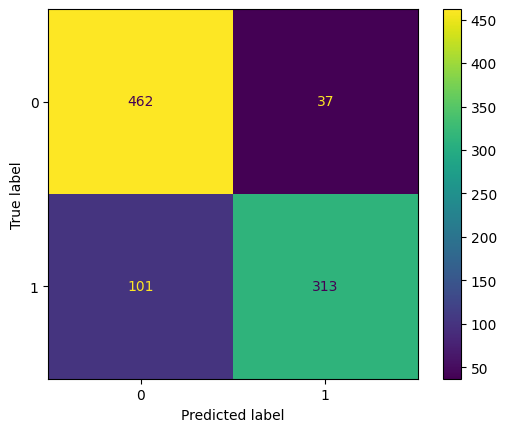

Epoch 2


Test Loss: 0.2399
Accuracy: 0.8880
Precision: 0.9589
Recall: 0.7880
F1 Score: 0.8651


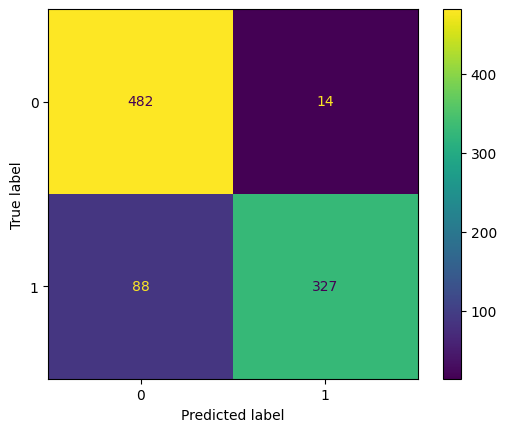

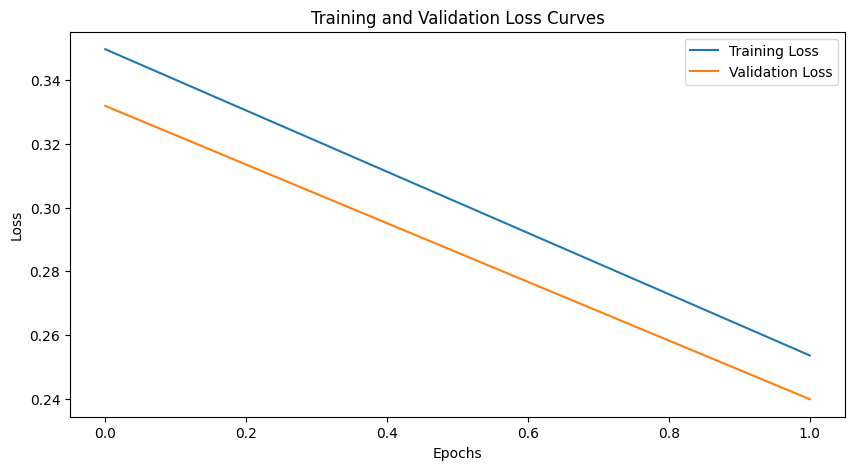

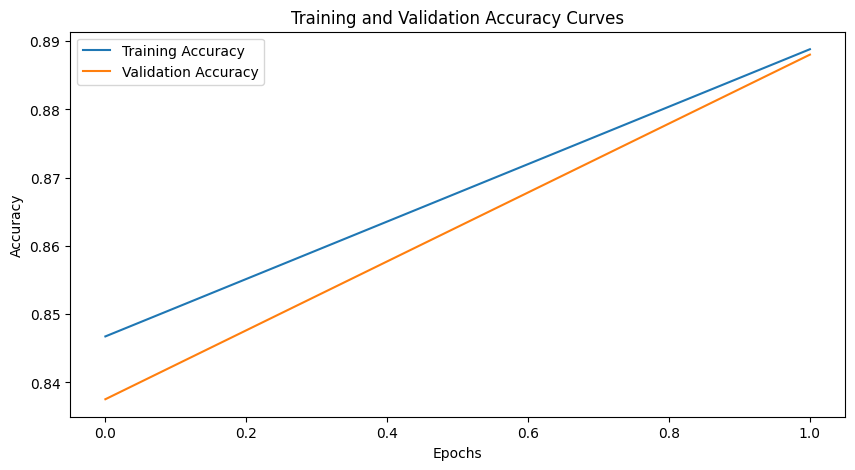

Final Training Metrics:
Test Loss: 0.1907
Accuracy: 0.9195
Precision: 0.9719
Recall: 0.8391
F1 Score: 0.9006


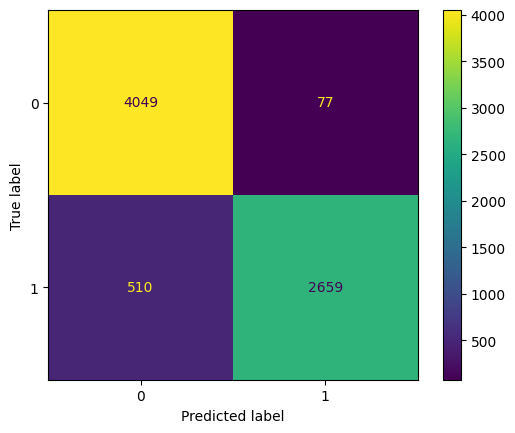

Final Test Metrics:
Test Loss: 0.2875
Accuracy: 0.8861
Precision: 0.9559
Recall: 0.7850
F1 Score: 0.8621


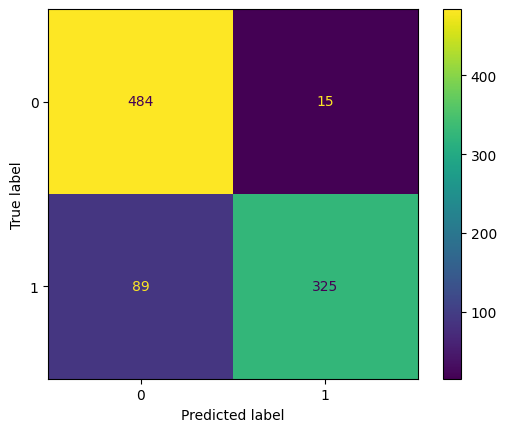

Epoch 3


Test Loss: 0.2144
Accuracy: 0.9078
Precision: 0.8950
Recall: 0.9036
F1 Score: 0.8993


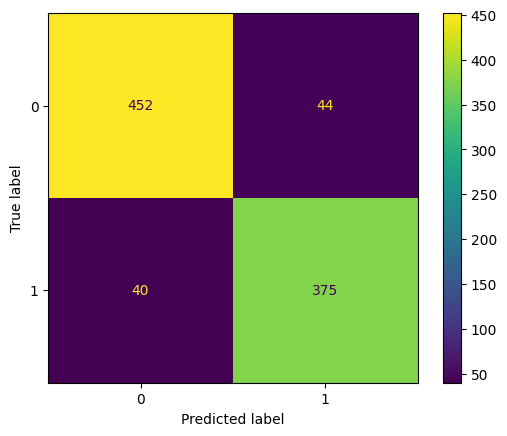

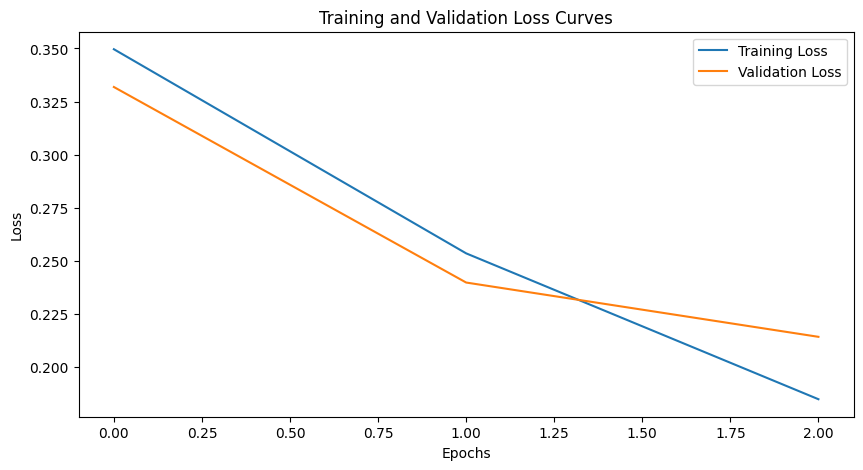

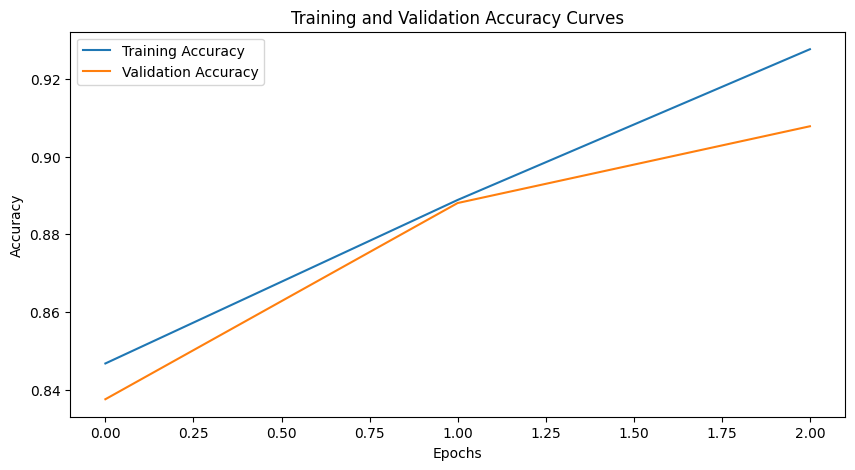

Final Training Metrics:
Test Loss: 0.1551
Accuracy: 0.9467
Precision: 0.9264
Recall: 0.9530
F1 Score: 0.9395


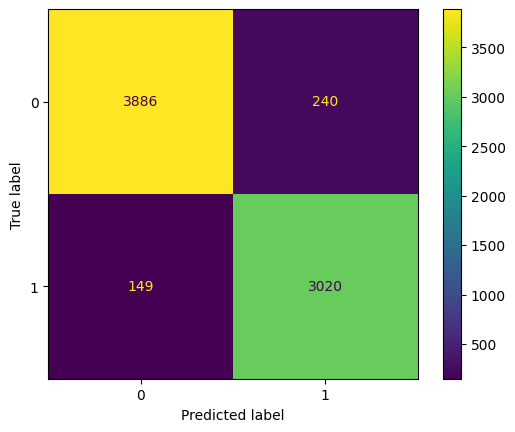

Final Test Metrics:
Test Loss: 0.2373
Accuracy: 0.9003
Precision: 0.8836
Recall: 0.8986
F1 Score: 0.8910


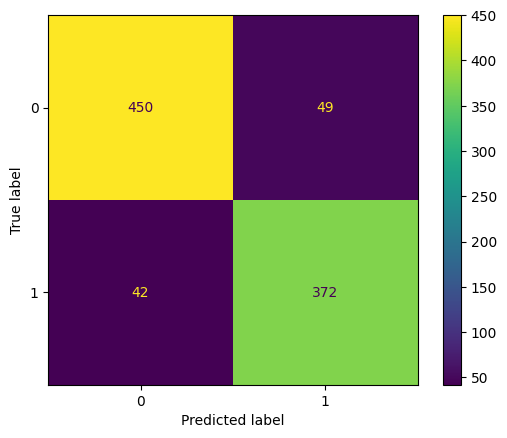

Epoch 4


Test Loss: 0.2058
Accuracy: 0.9012
Precision: 0.9501
Recall: 0.8265
F1 Score: 0.8840


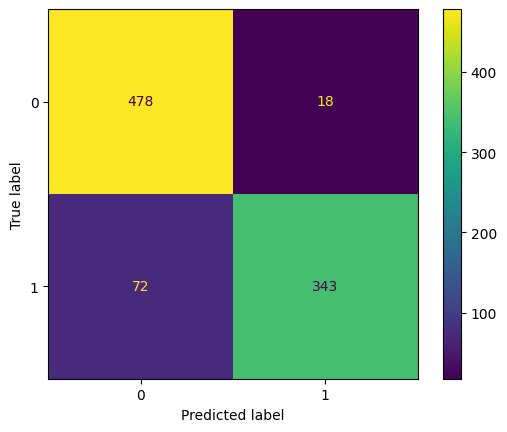

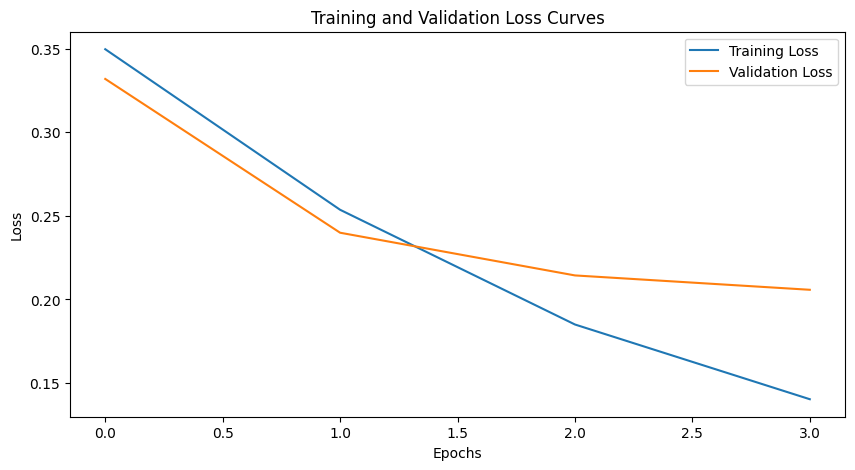

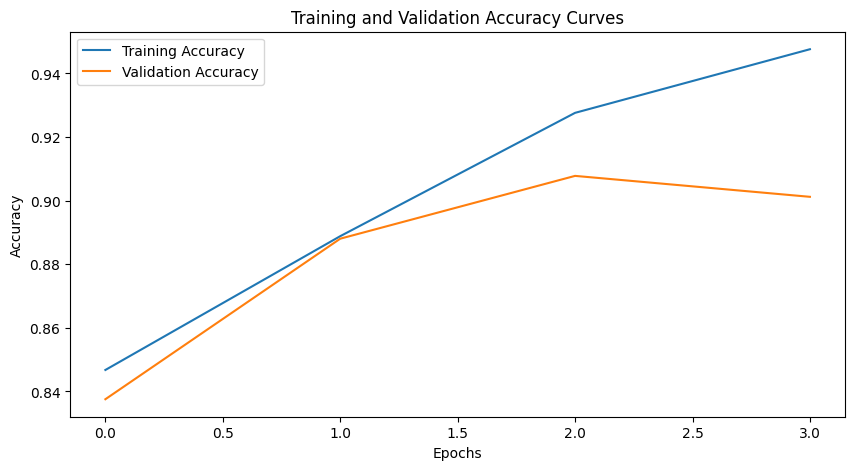

Final Training Metrics:
Test Loss: 0.0944
Accuracy: 0.9657
Precision: 0.9844
Recall: 0.9359
F1 Score: 0.9596


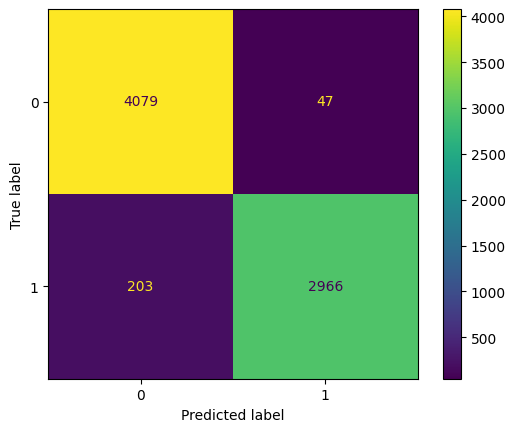

Final Test Metrics:
Test Loss: 0.2657
Accuracy: 0.8927
Precision: 0.9365
Recall: 0.8188
F1 Score: 0.8737


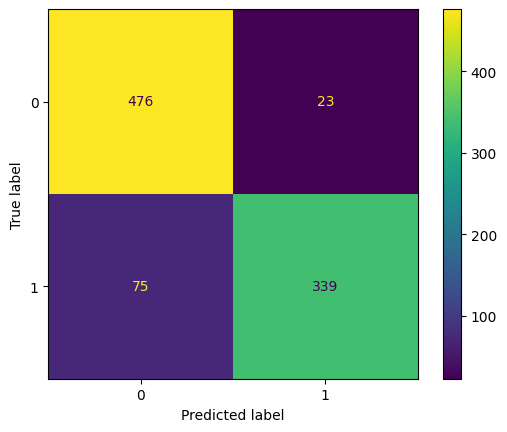

Epoch 5


Test Loss: 0.2175
Accuracy: 0.9045
Precision: 0.9481
Recall: 0.8361
F1 Score: 0.8886


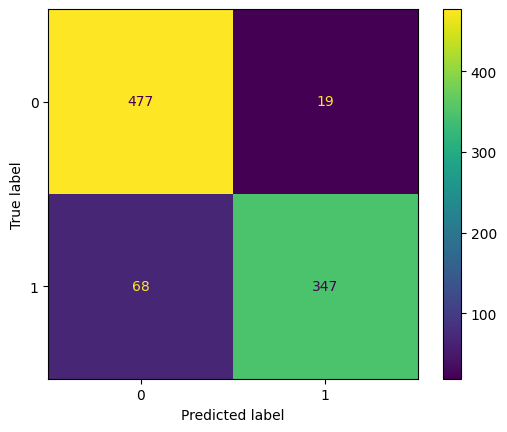

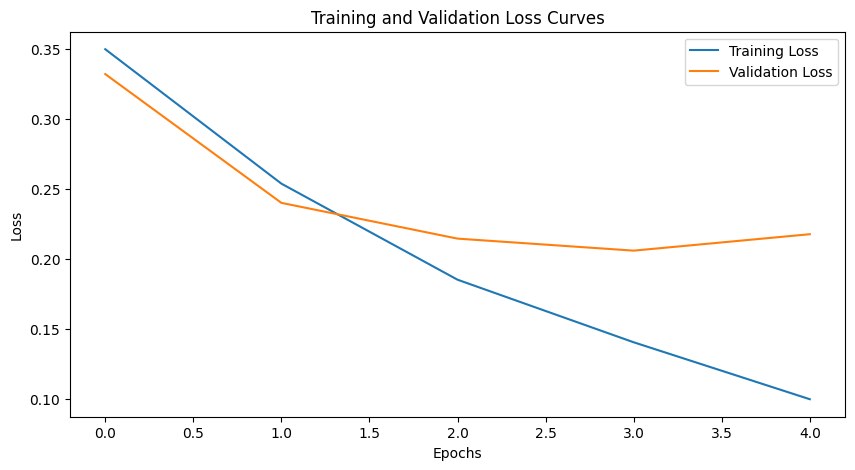

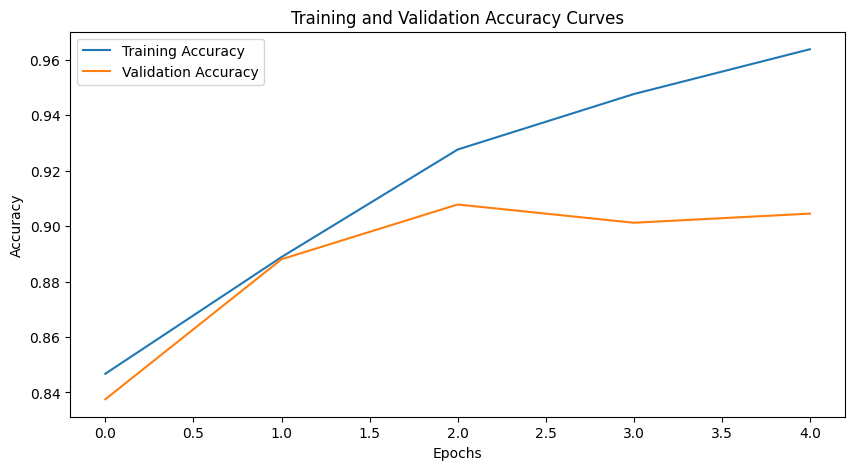

Final Training Metrics:
Test Loss: 0.0635
Accuracy: 0.9815
Precision: 0.9890
Recall: 0.9681
F1 Score: 0.9785


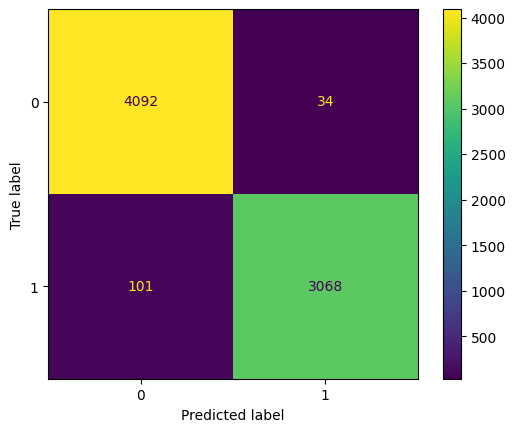

Final Test Metrics:
Test Loss: 0.2943
Accuracy: 0.9025
Precision: 0.9477
Recall: 0.8309
F1 Score: 0.8855


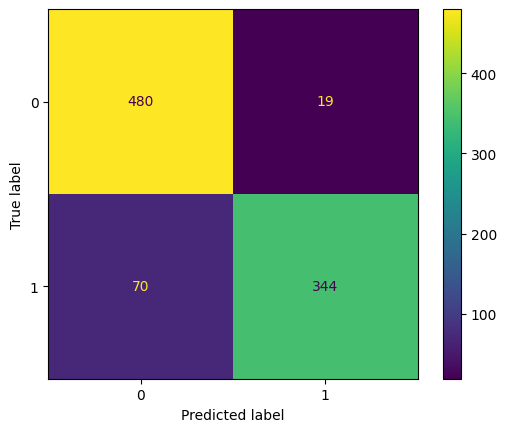

Epoch 6


Test Loss: 0.2132
Accuracy: 0.9177
Precision: 0.9106
Recall: 0.9084
F1 Score: 0.9095


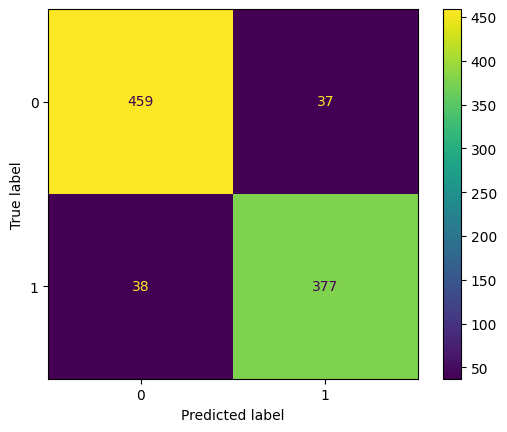

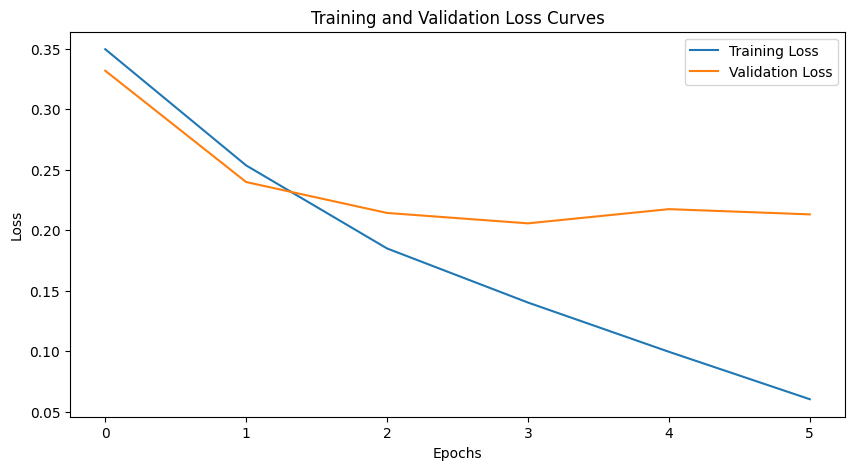

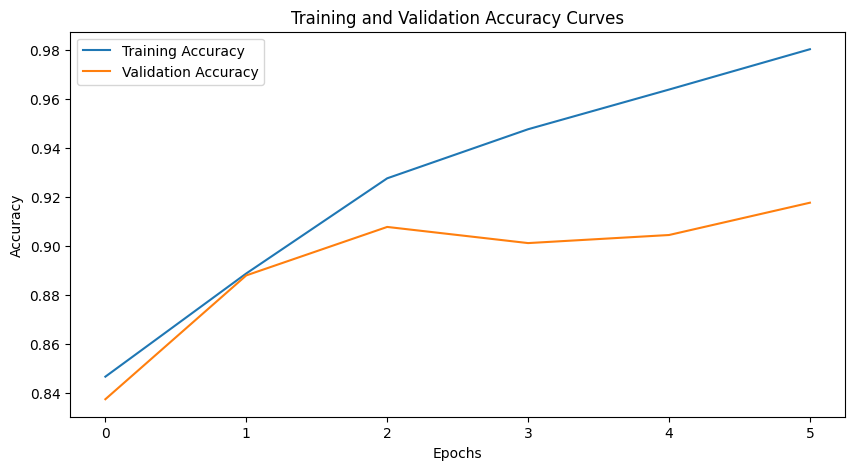

Final Training Metrics:
Test Loss: 0.0377
Accuracy: 0.9927
Precision: 0.9890
Recall: 0.9943
F1 Score: 0.9917


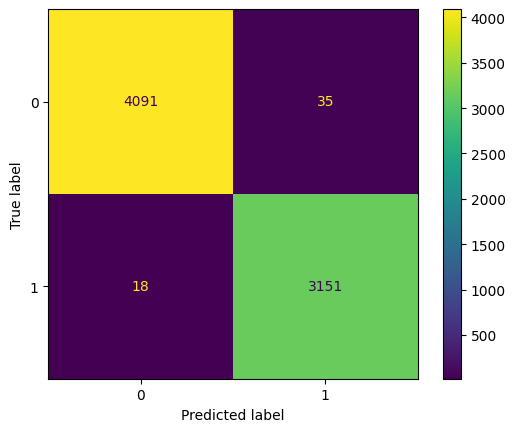

Final Test Metrics:
Test Loss: 0.2813
Accuracy: 0.9003
Precision: 0.8949
Recall: 0.8841
F1 Score: 0.8894


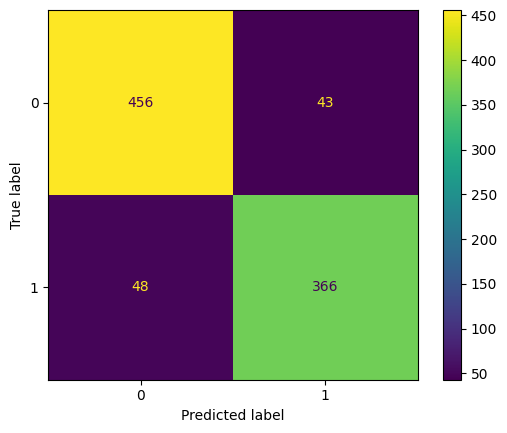

Epoch 7


Test Loss: 0.2619
Accuracy: 0.9078
Precision: 0.9344
Recall: 0.8578
F1 Score: 0.8945


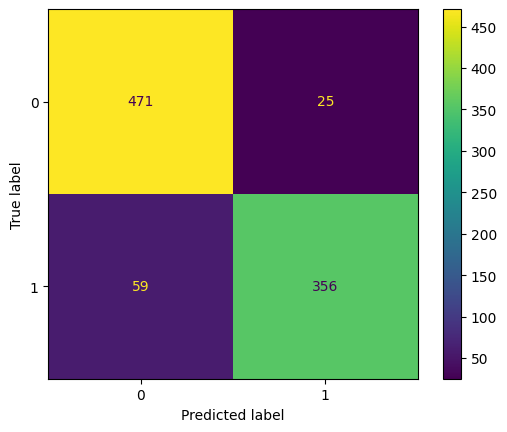

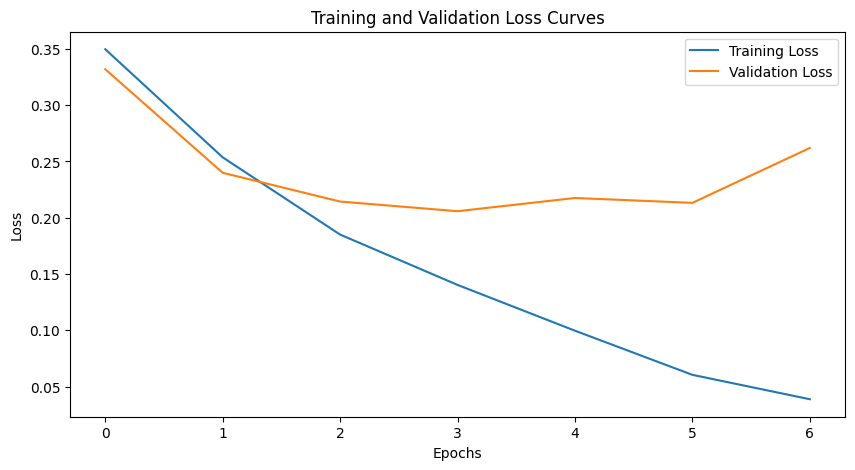

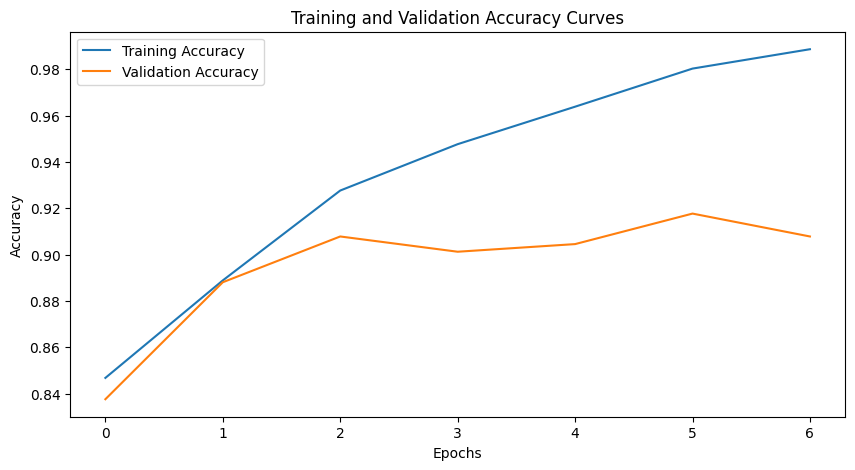

Final Training Metrics:
Test Loss: 0.0224
Accuracy: 0.9959
Precision: 0.9953
Recall: 0.9953
F1 Score: 0.9953


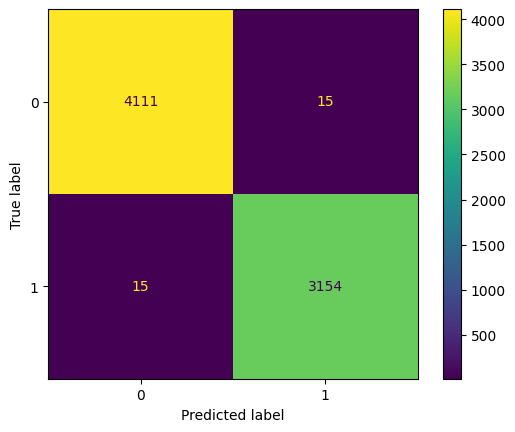

Final Test Metrics:
Test Loss: 0.3747
Accuracy: 0.8916
Precision: 0.9245
Recall: 0.8285
F1 Score: 0.8739


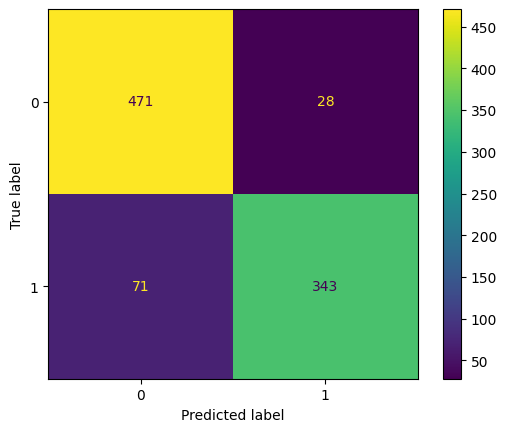

Epoch 8


Test Loss: 0.3074
Accuracy: 0.9100
Precision: 0.9416
Recall: 0.8554
F1 Score: 0.8965


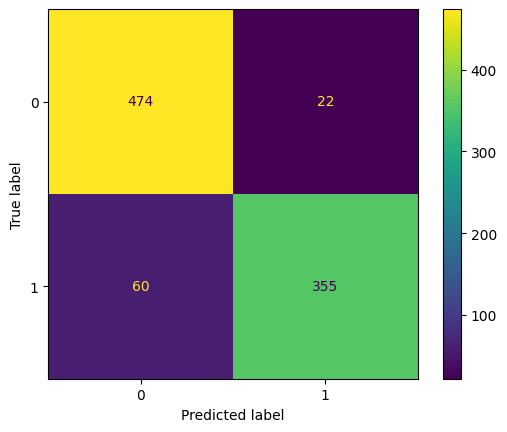

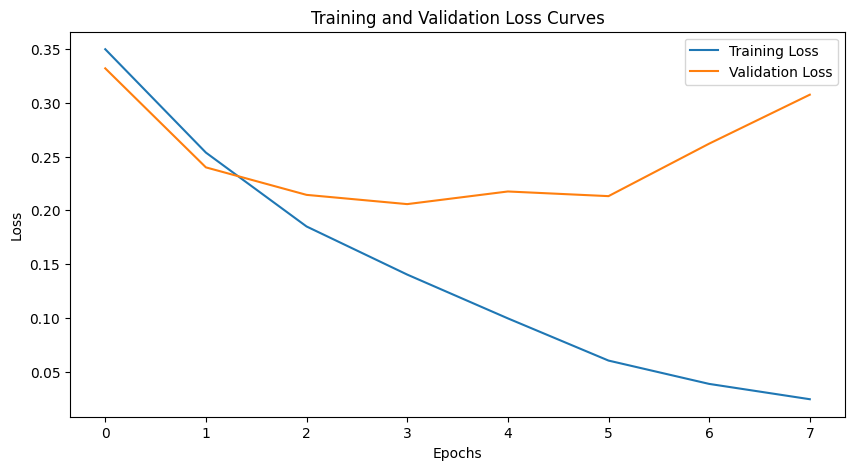

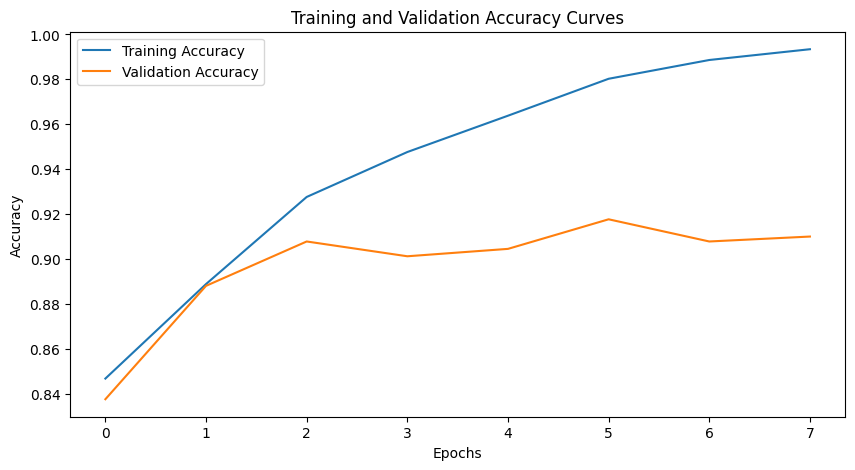

Final Training Metrics:
Test Loss: 0.0158
Accuracy: 0.9962
Precision: 0.9956
Recall: 0.9956
F1 Score: 0.9956


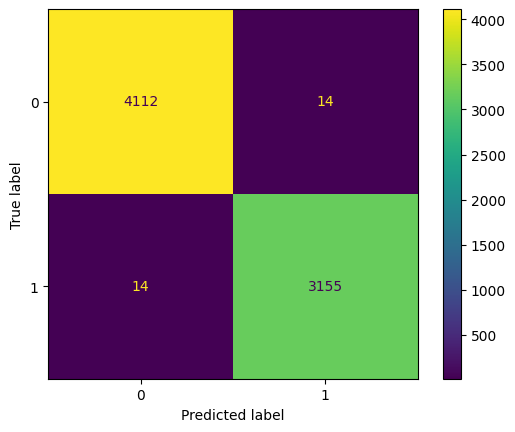

Final Test Metrics:
Test Loss: 0.4247
Accuracy: 0.8938
Precision: 0.9272
Recall: 0.8309
F1 Score: 0.8764


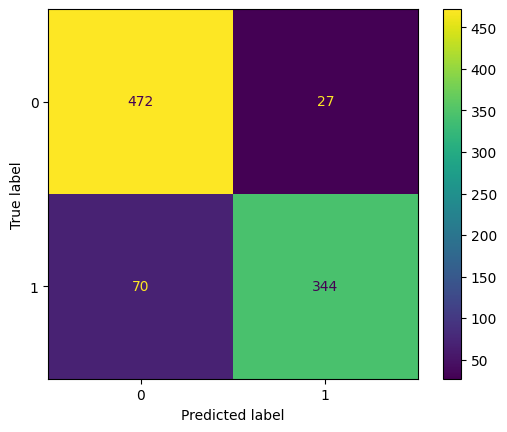

Epoch 9


Test Loss: 0.2887
Accuracy: 0.9133
Precision: 0.9118
Recall: 0.8964
F1 Score: 0.9040


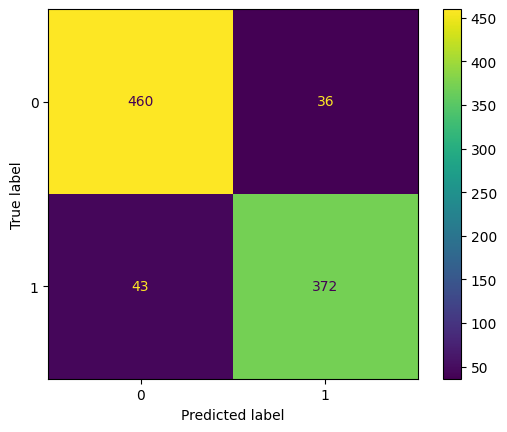

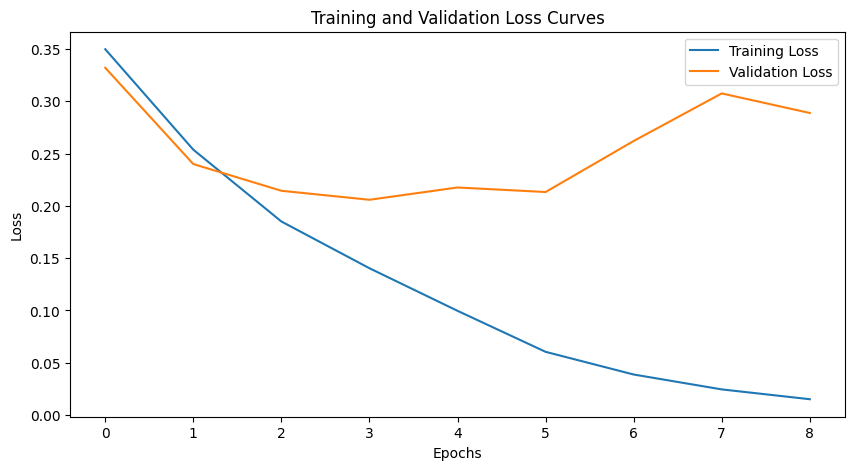

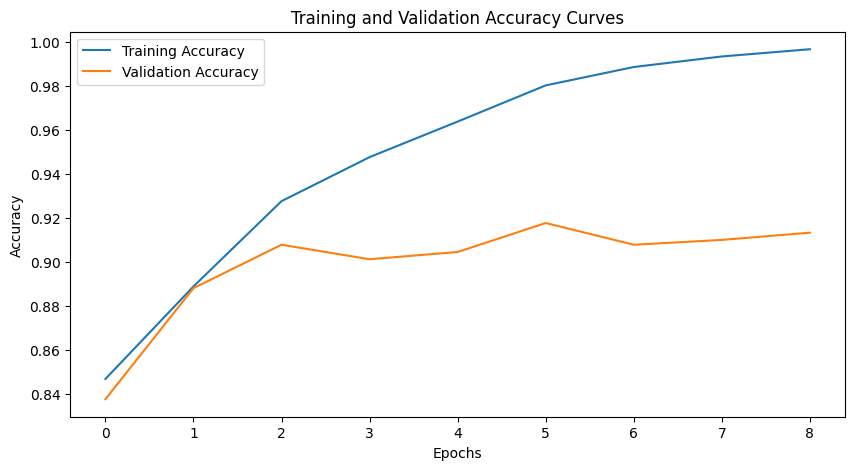

Final Training Metrics:
Test Loss: 0.0104
Accuracy: 0.9977
Precision: 0.9962
Recall: 0.9984
F1 Score: 0.9973


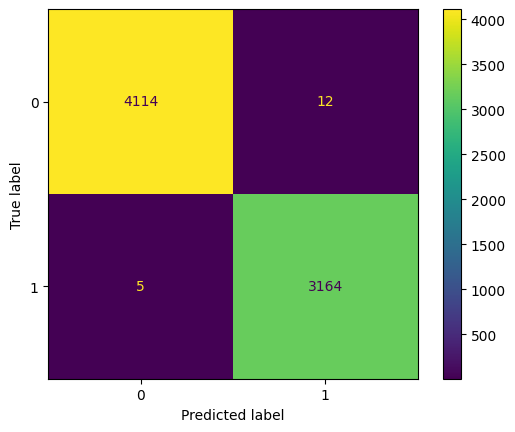

Final Test Metrics:
Test Loss: 0.3869
Accuracy: 0.9003
Precision: 0.8988
Recall: 0.8792
F1 Score: 0.8889


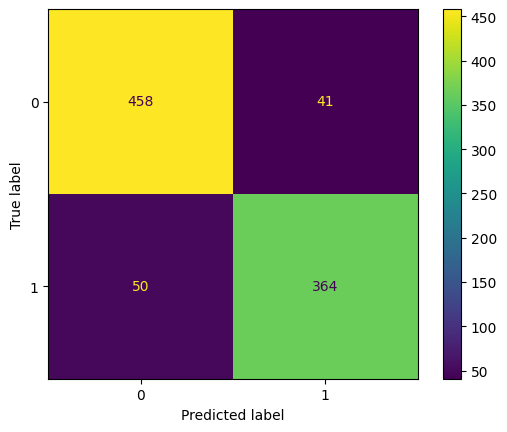

Epoch 10


Test Loss: 0.4099
Accuracy: 0.9056
Precision: 0.9687
Recall: 0.8193
F1 Score: 0.8877


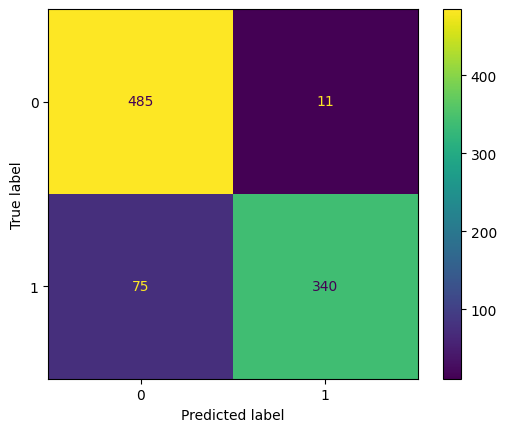

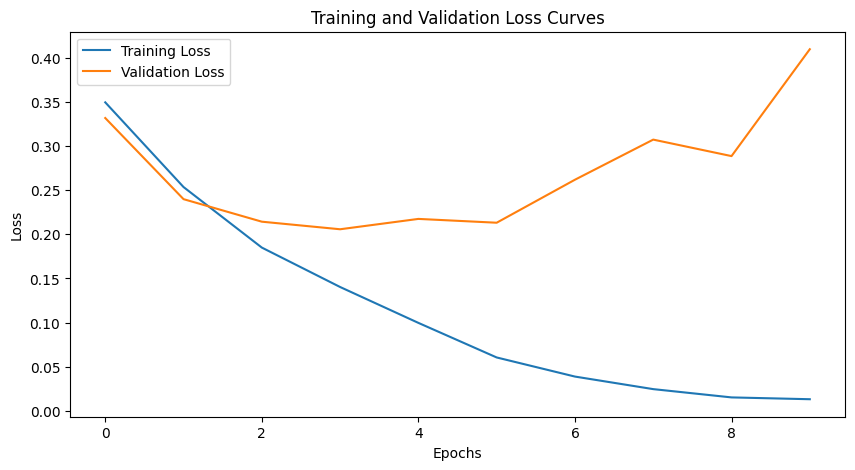

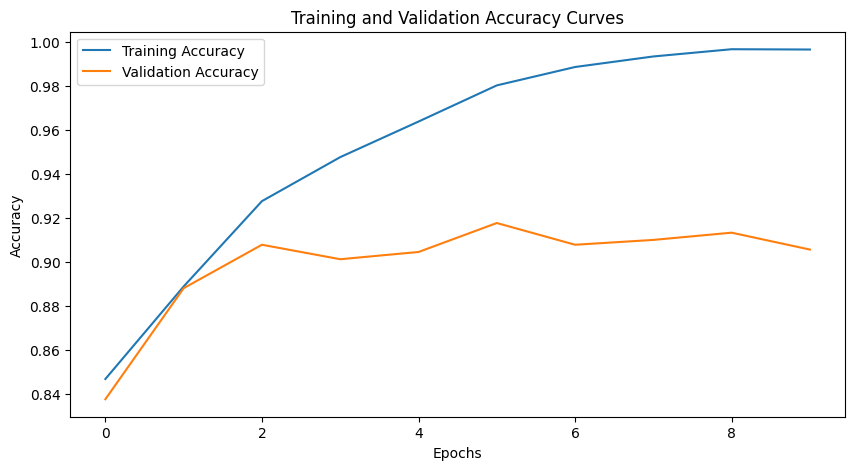

Final Training Metrics:
Test Loss: 0.0182
Accuracy: 0.9927
Precision: 0.9997
Recall: 0.9836
F1 Score: 0.9916


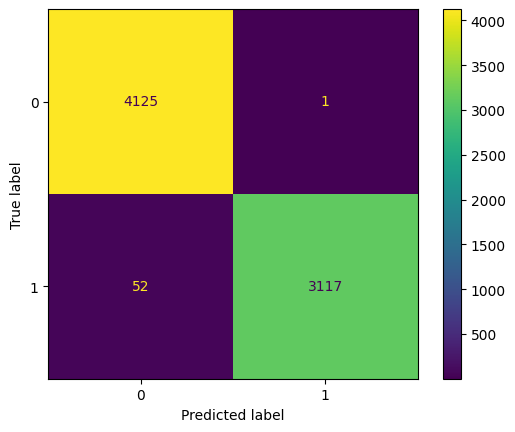

Final Test Metrics:
Test Loss: 0.5751
Accuracy: 0.8916
Precision: 0.9539
Recall: 0.7995
F1 Score: 0.8699


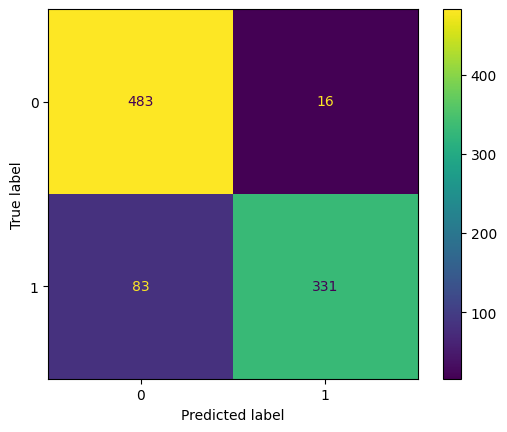

Experiment with Batch Size: 16, Learning Rate: 1e-05
Epoch 1


Test Loss: 0.3816
Accuracy: 0.8255
Precision: 0.8765
Recall: 0.7181
F1 Score: 0.7894


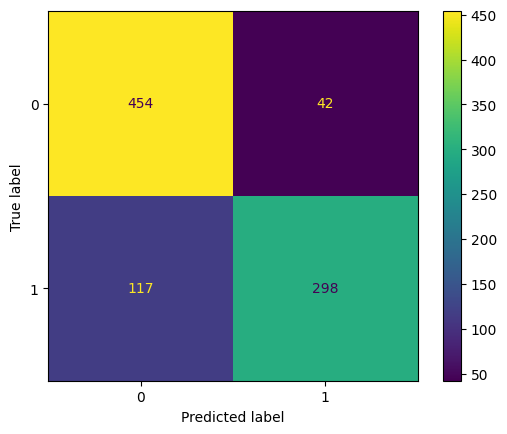

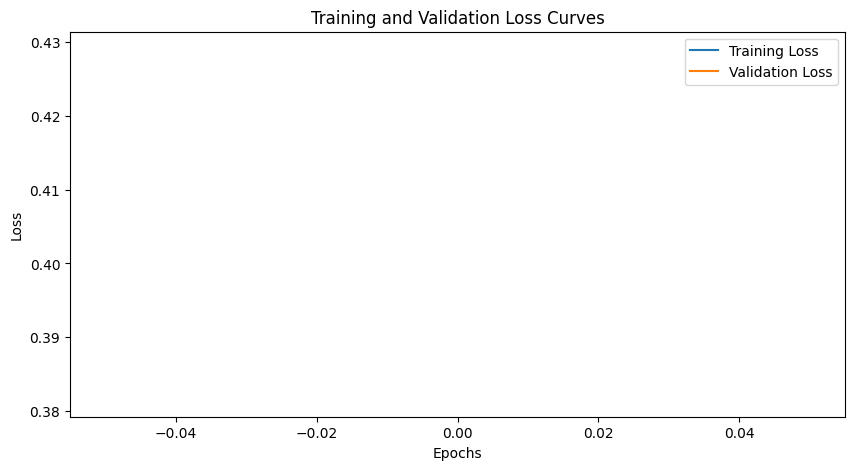

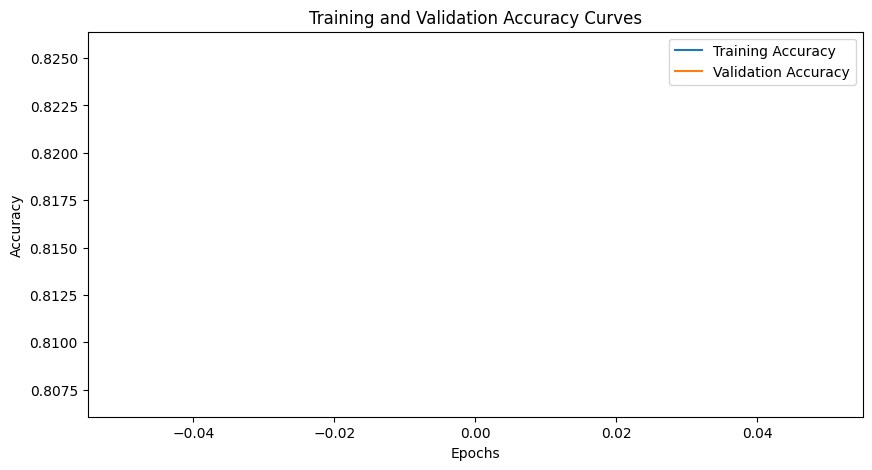

Final Training Metrics:
Test Loss: 0.3537
Accuracy: 0.8504
Precision: 0.9169
Recall: 0.7210
F1 Score: 0.8073


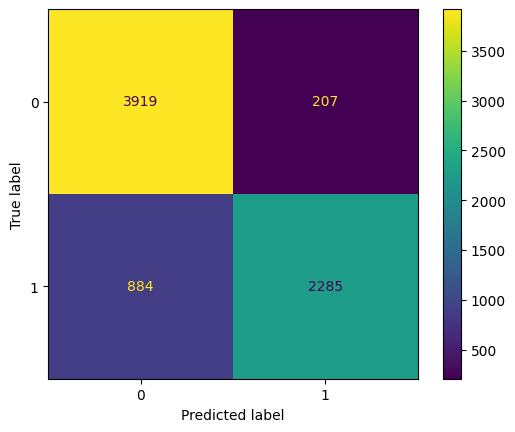

Final Test Metrics:
Test Loss: 0.3881
Accuracy: 0.8324
Precision: 0.9169
Recall: 0.6932
F1 Score: 0.7895


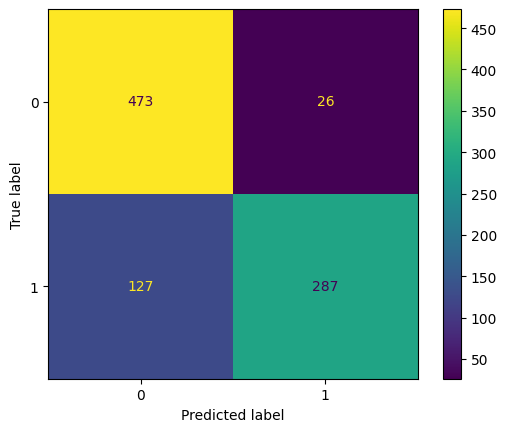

Epoch 2


Test Loss: 0.3689
Accuracy: 0.8321
Precision: 0.9043
Recall: 0.7060
F1 Score: 0.7930


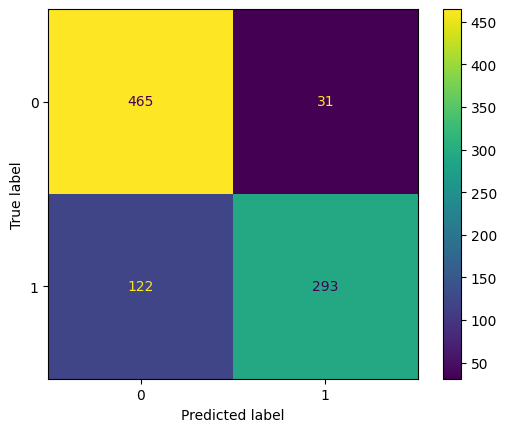

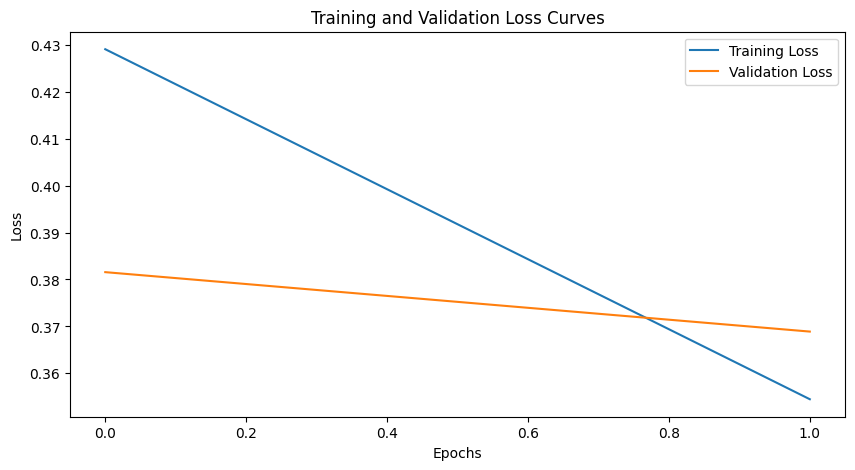

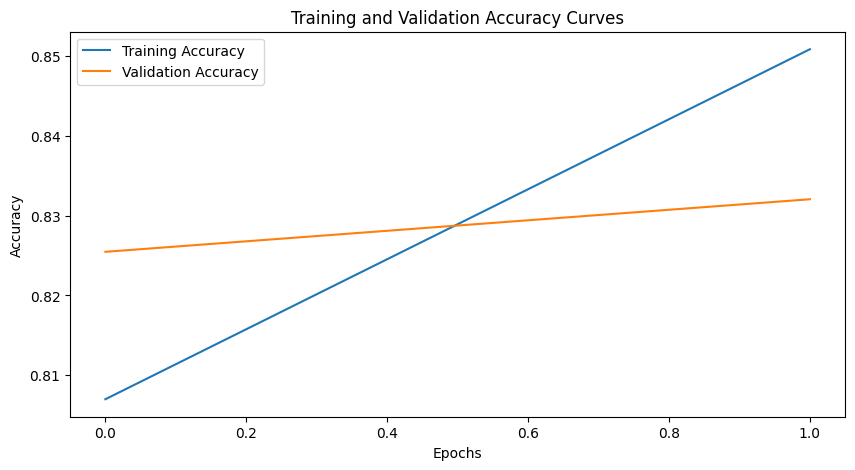

Final Training Metrics:
Test Loss: 0.3372
Accuracy: 0.8559
Precision: 0.9491
Recall: 0.7062
F1 Score: 0.8098


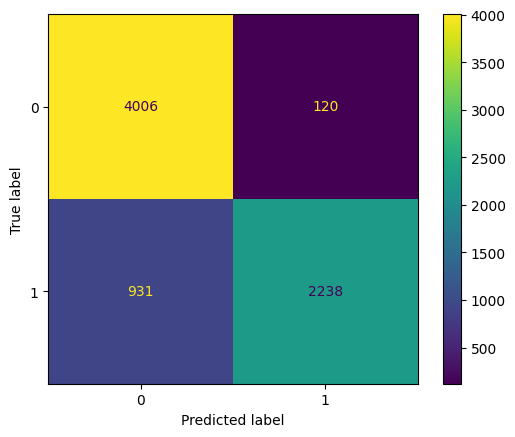

Final Test Metrics:
Test Loss: 0.3767
Accuracy: 0.8368
Precision: 0.9402
Recall: 0.6836
F1 Score: 0.7916


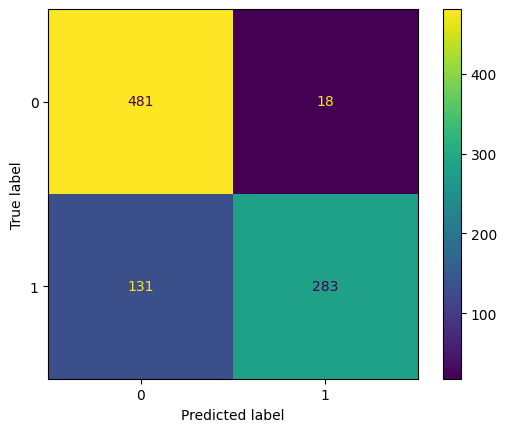

Epoch 3


Test Loss: 0.3607
Accuracy: 0.8375
Precision: 0.9083
Recall: 0.7157
F1 Score: 0.8005


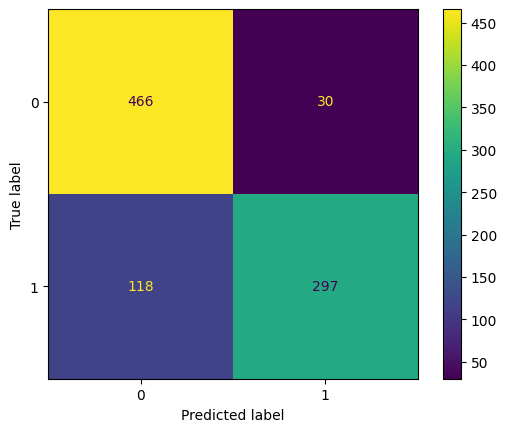

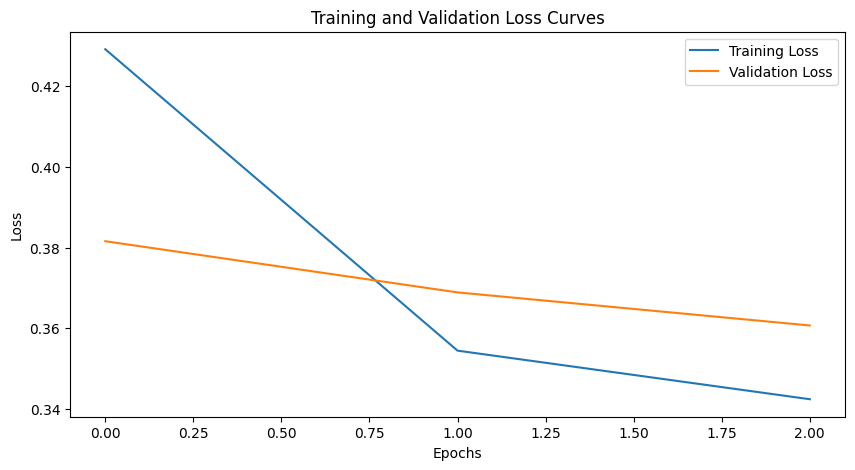

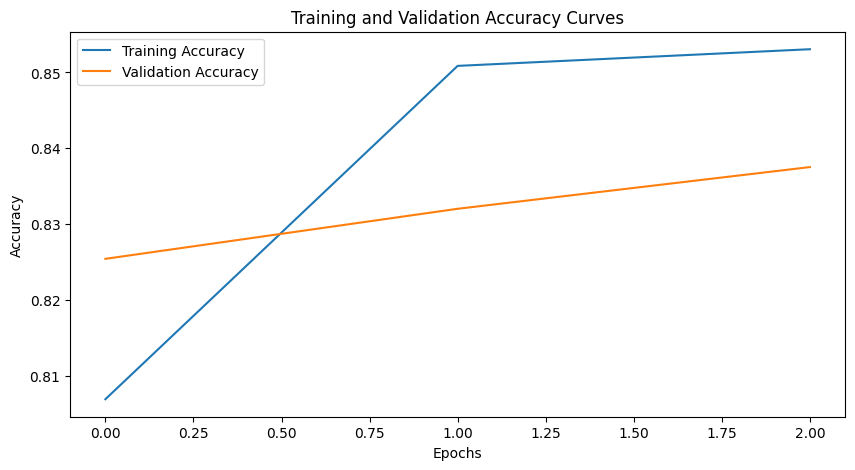

Final Training Metrics:
Test Loss: 0.3244
Accuracy: 0.8603
Precision: 0.9475
Recall: 0.7182
F1 Score: 0.8171


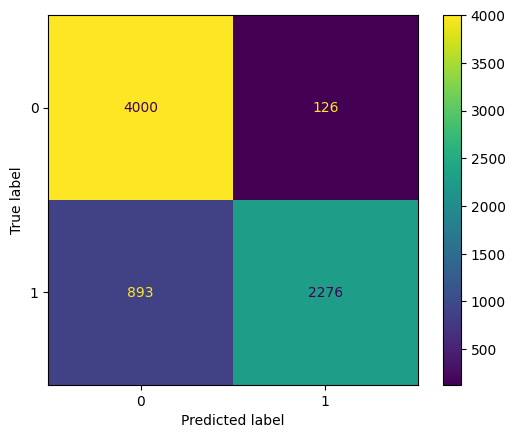

Final Test Metrics:
Test Loss: 0.3648
Accuracy: 0.8346
Precision: 0.9340
Recall: 0.6836
F1 Score: 0.7894


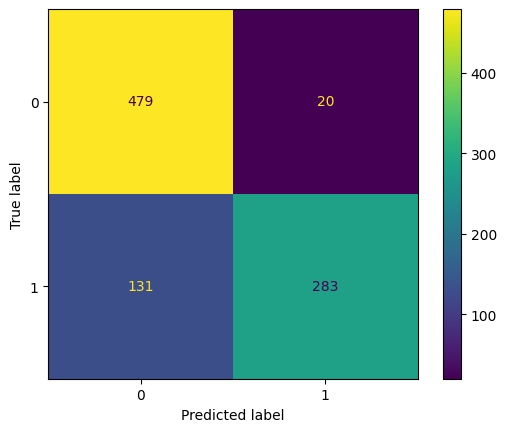

Epoch 4


Test Loss: 0.3525
Accuracy: 0.8463
Precision: 0.9365
Recall: 0.7108
F1 Score: 0.8082


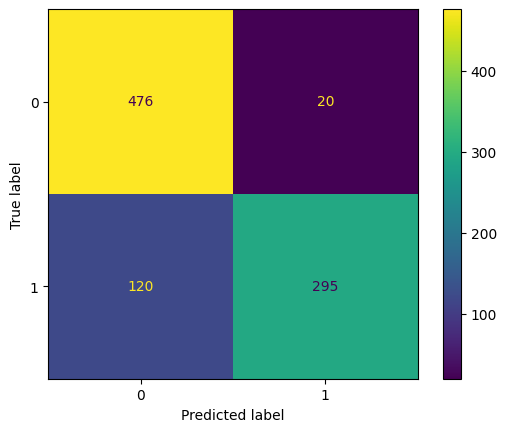

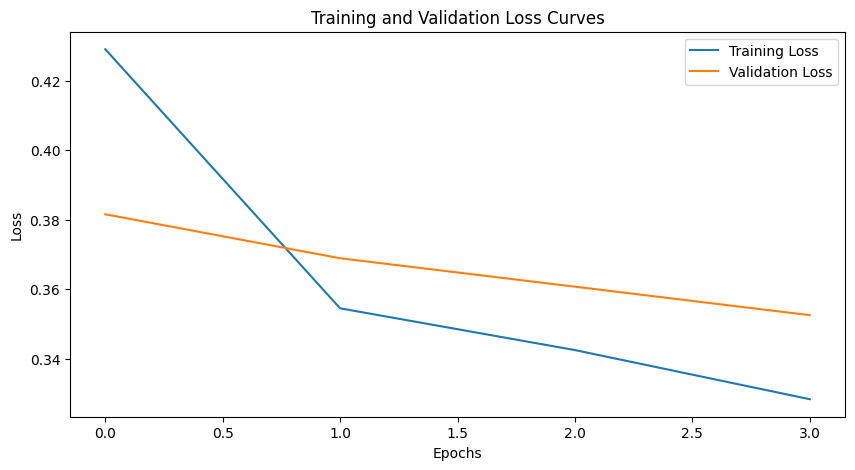

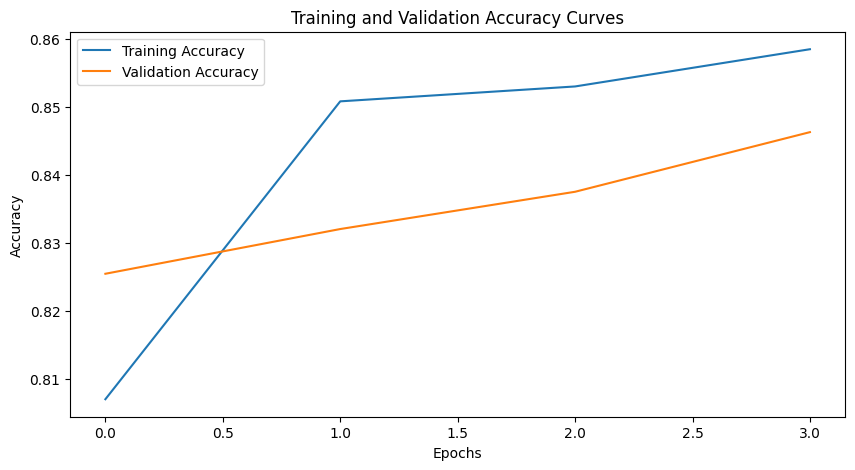

Final Training Metrics:
Test Loss: 0.3139
Accuracy: 0.8646
Precision: 0.9572
Recall: 0.7204
F1 Score: 0.8221


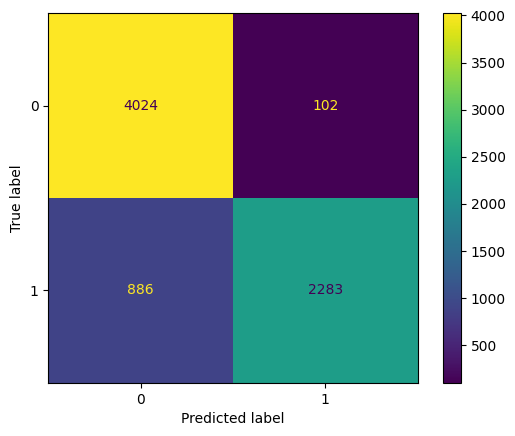

Final Test Metrics:
Test Loss: 0.3580
Accuracy: 0.8390
Precision: 0.9465
Recall: 0.6836
F1 Score: 0.7938


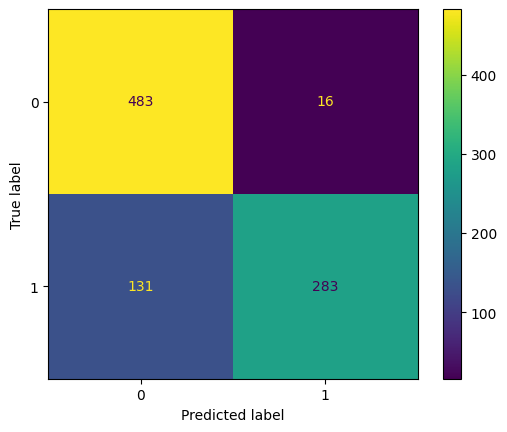

Epoch 5


Test Loss: 0.3392
Accuracy: 0.8430
Precision: 0.9072
Recall: 0.7301
F1 Score: 0.8091


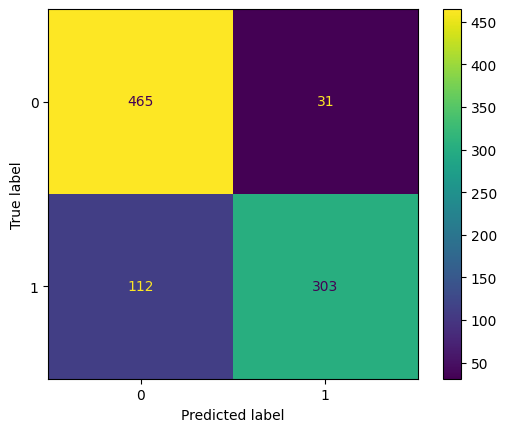

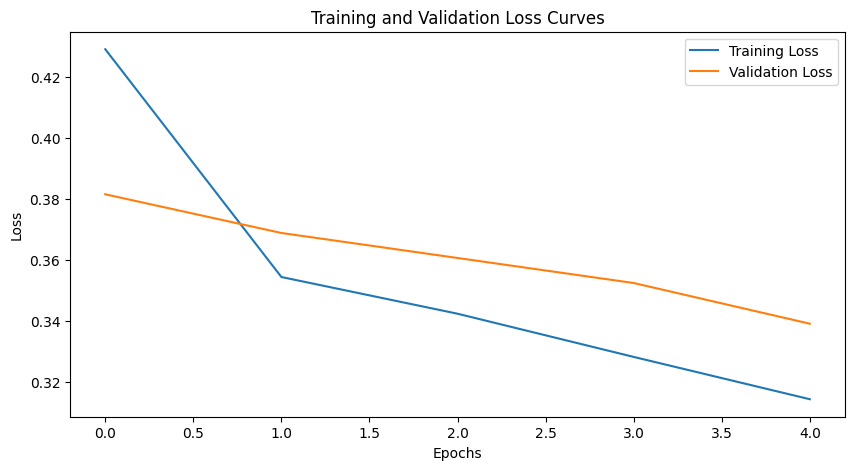

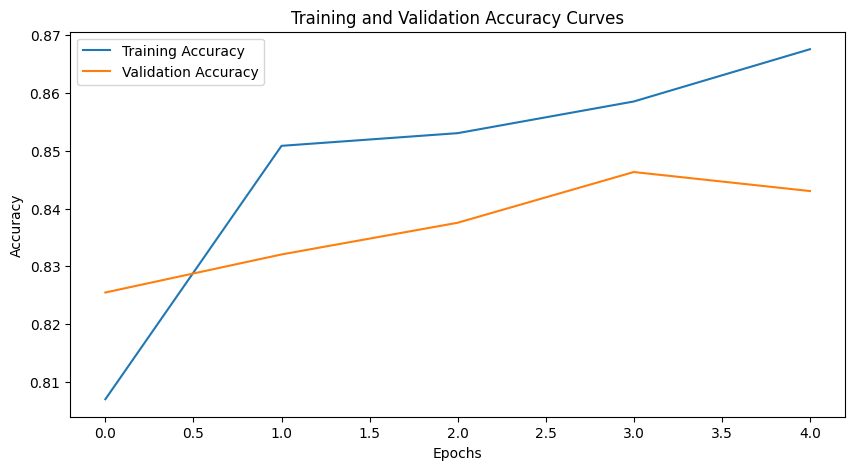

Final Training Metrics:
Test Loss: 0.2981
Accuracy: 0.8743
Precision: 0.9388
Recall: 0.7602
F1 Score: 0.8401


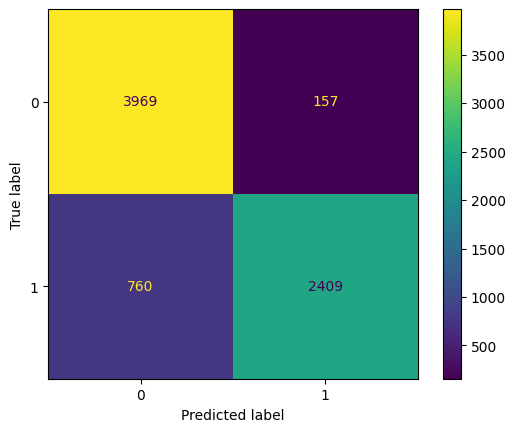

Final Test Metrics:
Test Loss: 0.3416
Accuracy: 0.8478
Precision: 0.9365
Recall: 0.7126
F1 Score: 0.8093


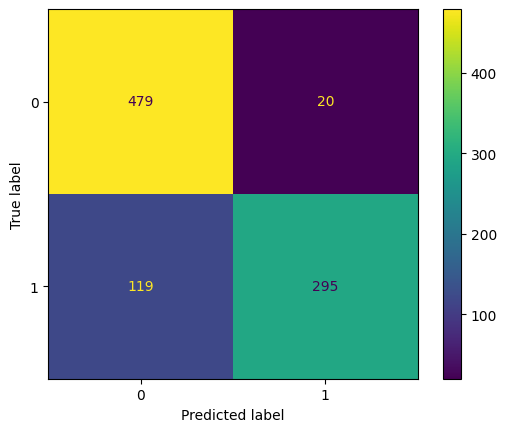

Epoch 6


Test Loss: 0.3263
Accuracy: 0.8441
Precision: 0.9099
Recall: 0.7301
F1 Score: 0.8102


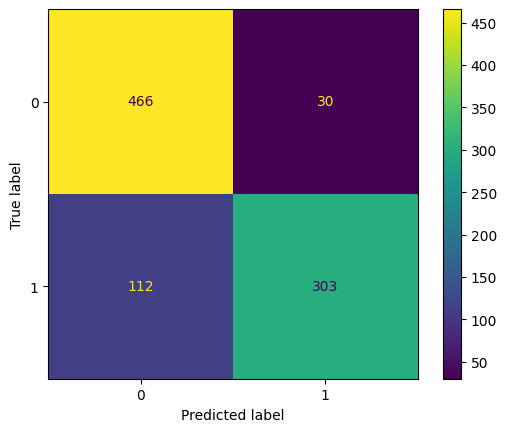

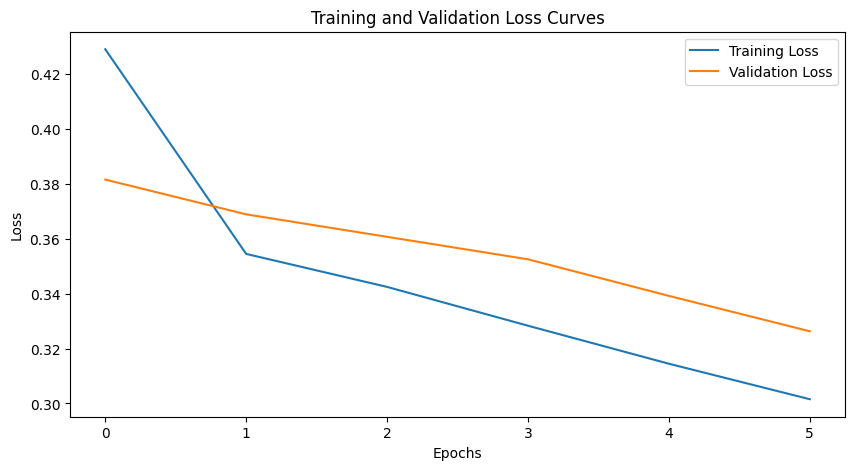

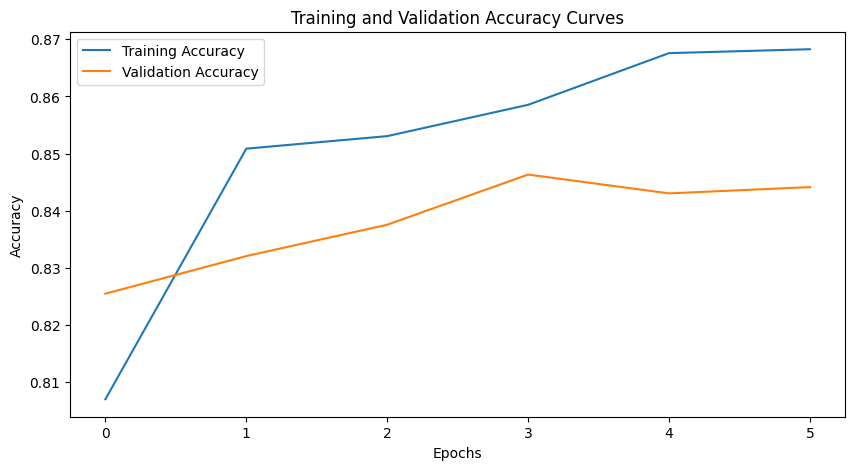

Final Training Metrics:
Test Loss: 0.2830
Accuracy: 0.8790
Precision: 0.9400
Recall: 0.7706
F1 Score: 0.8469


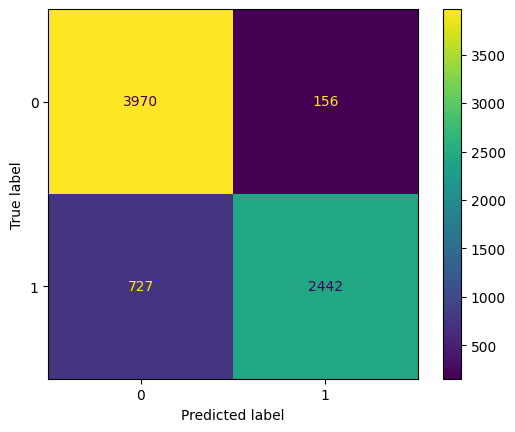

Final Test Metrics:
Test Loss: 0.3326
Accuracy: 0.8510
Precision: 0.9399
Recall: 0.7174
F1 Score: 0.8137


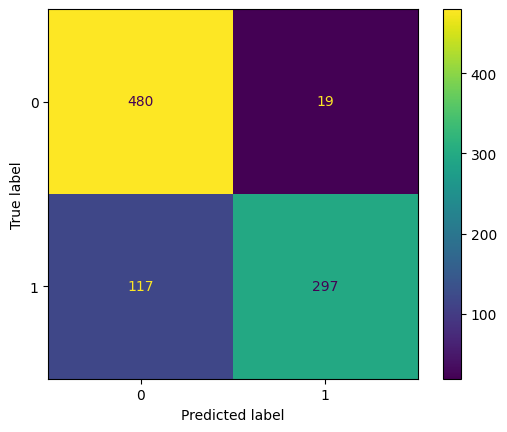

Epoch 7


Test Loss: 0.3096
Accuracy: 0.8485
Precision: 0.9262
Recall: 0.7253
F1 Score: 0.8135


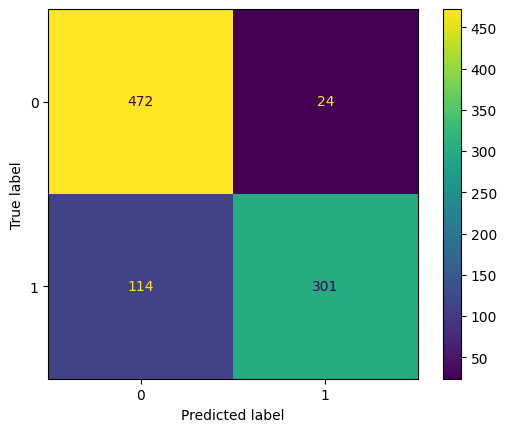

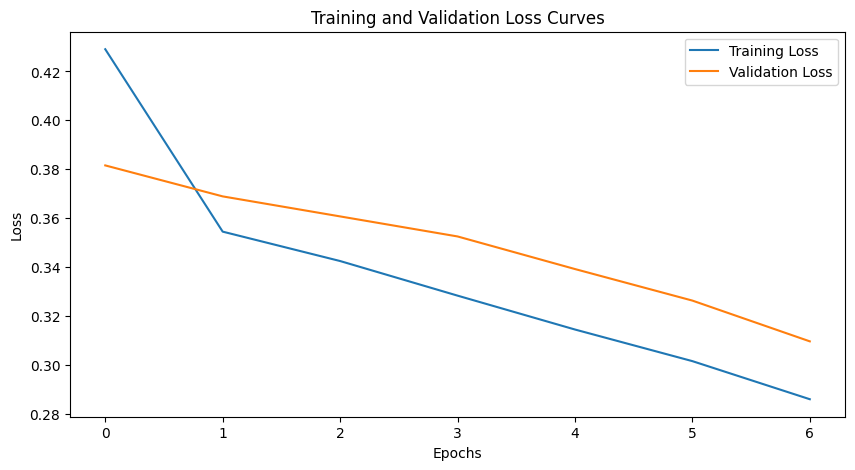

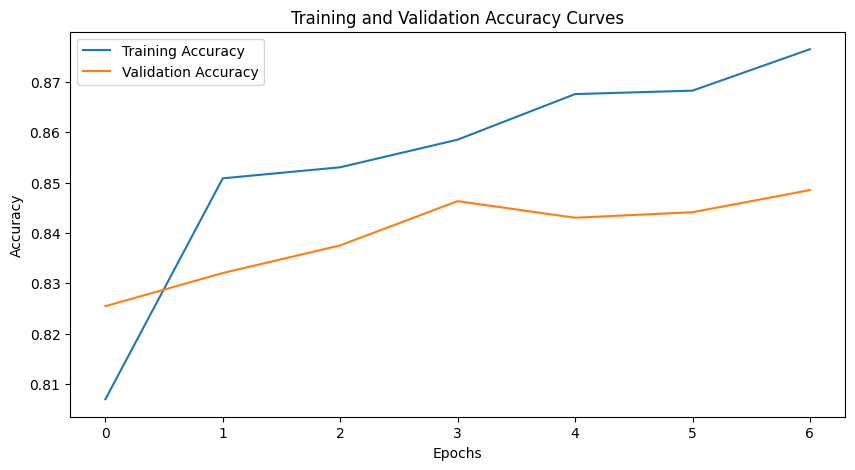

Final Training Metrics:
Test Loss: 0.2674
Accuracy: 0.8861
Precision: 0.9538
Recall: 0.7753
F1 Score: 0.8554


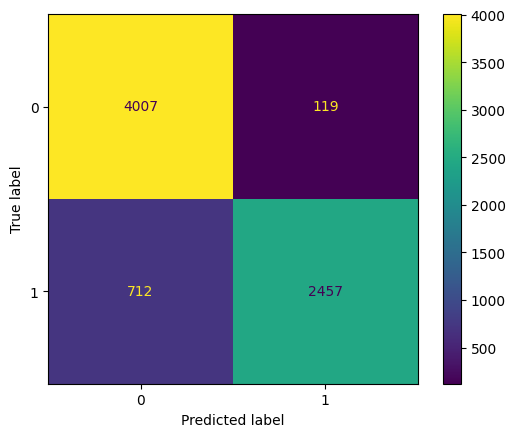

Final Test Metrics:
Test Loss: 0.3218
Accuracy: 0.8554
Precision: 0.9519
Recall: 0.7174
F1 Score: 0.8182


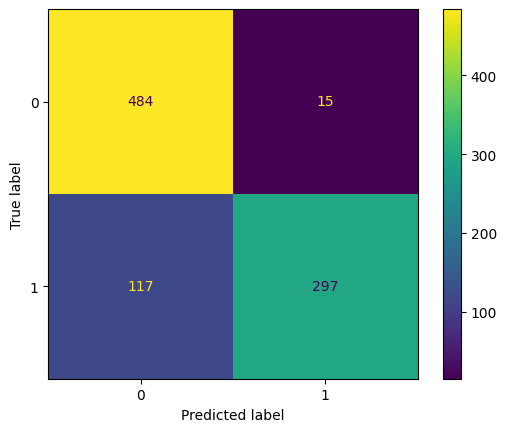

Epoch 8


Test Loss: 0.2915
Accuracy: 0.8562
Precision: 0.9057
Recall: 0.7639
F1 Score: 0.8288


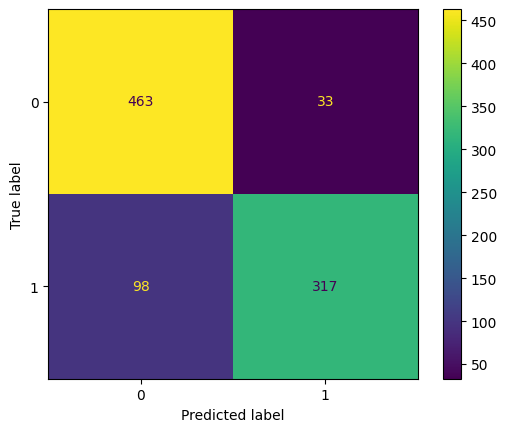

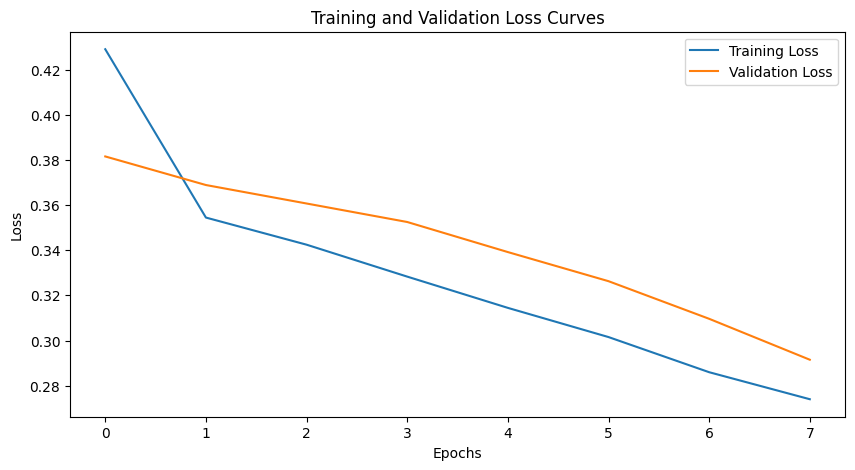

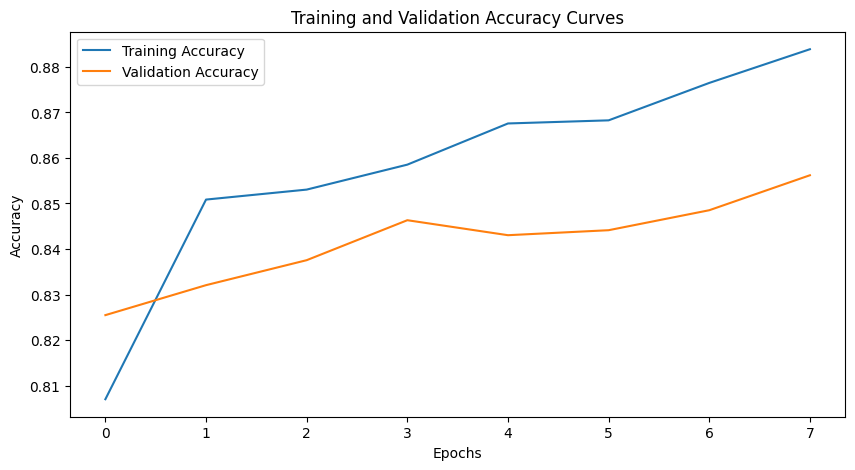

Final Training Metrics:
Test Loss: 0.2506
Accuracy: 0.8950
Precision: 0.9406
Recall: 0.8094
F1 Score: 0.8701


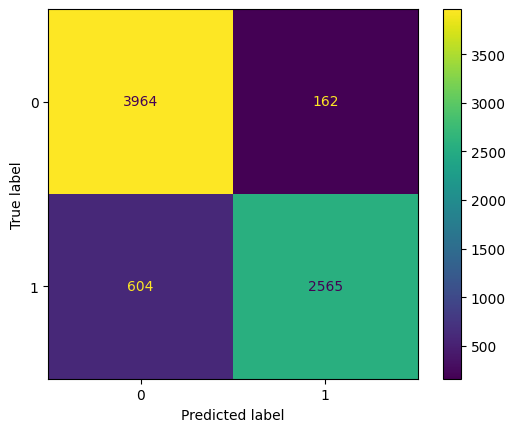

Final Test Metrics:
Test Loss: 0.3053
Accuracy: 0.8686
Precision: 0.9375
Recall: 0.7609
F1 Score: 0.8400


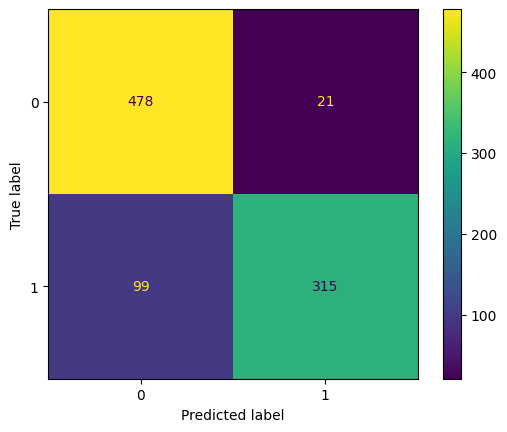

Epoch 9


Test Loss: 0.2768
Accuracy: 0.8628
Precision: 0.9191
Recall: 0.7663
F1 Score: 0.8357


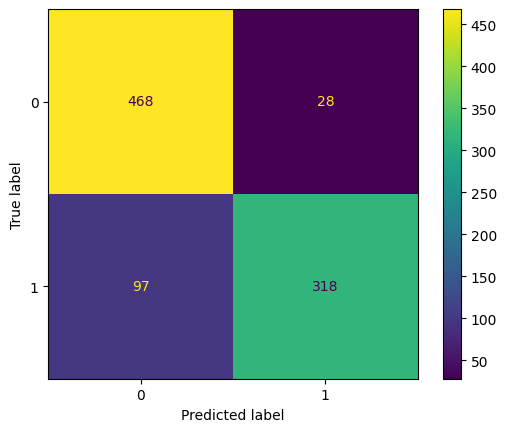

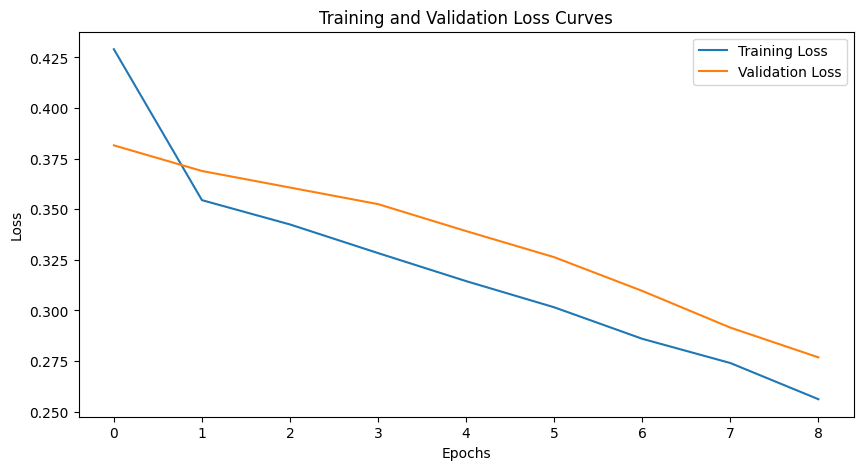

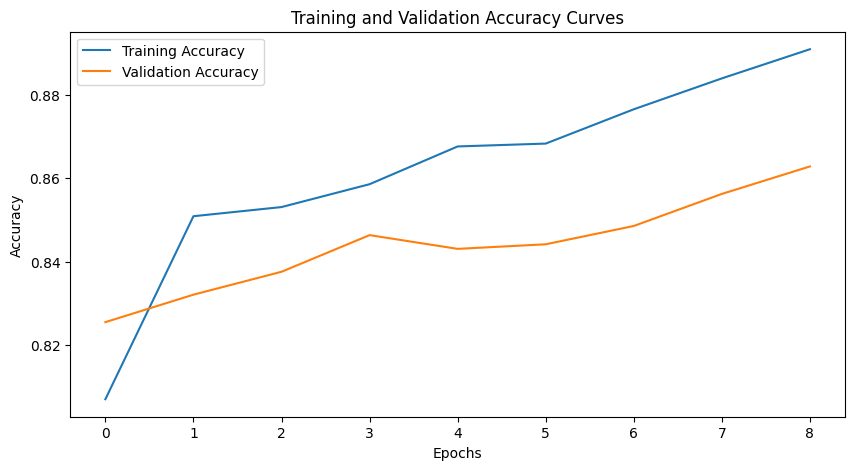

Final Training Metrics:
Test Loss: 0.2360
Accuracy: 0.9005
Precision: 0.9496
Recall: 0.8141
F1 Score: 0.8767


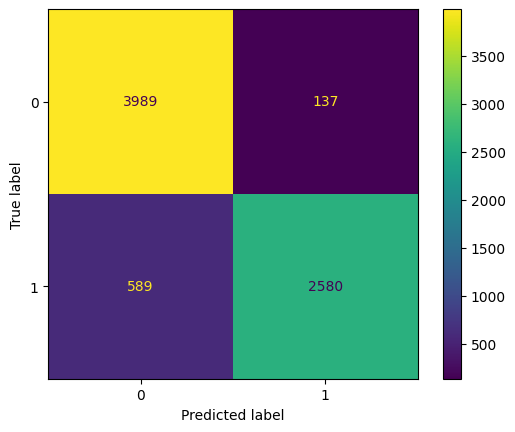

Final Test Metrics:
Test Loss: 0.2983
Accuracy: 0.8675
Precision: 0.9399
Recall: 0.7560
F1 Score: 0.8380


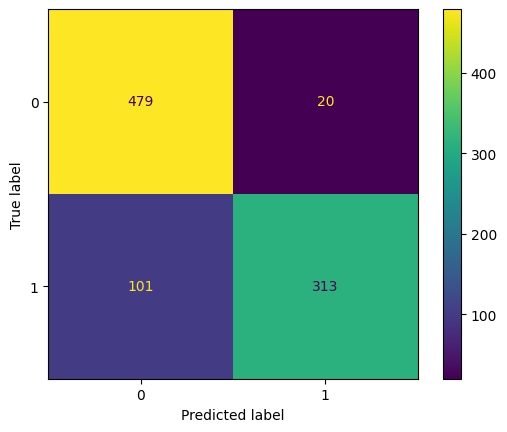

Epoch 10


Test Loss: 0.2630
Accuracy: 0.8705
Precision: 0.9231
Recall: 0.7807
F1 Score: 0.8460


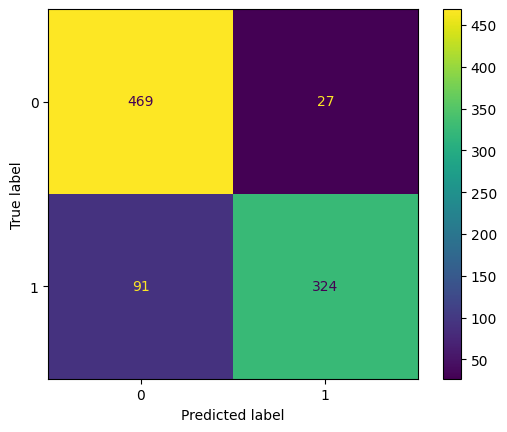

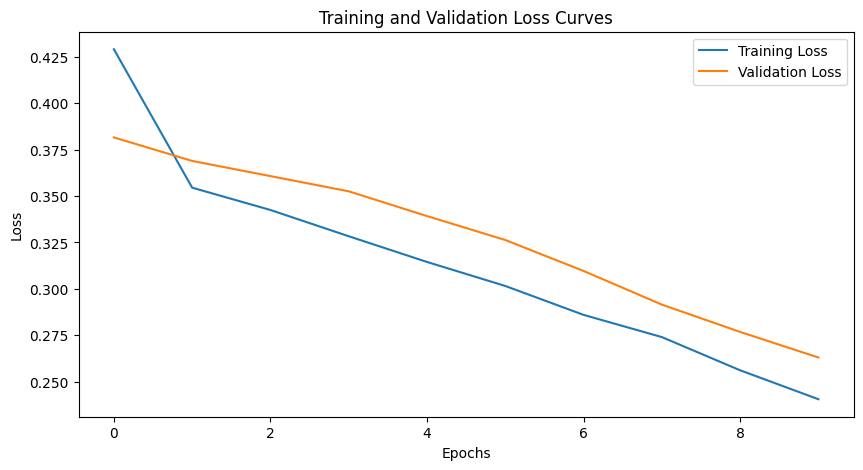

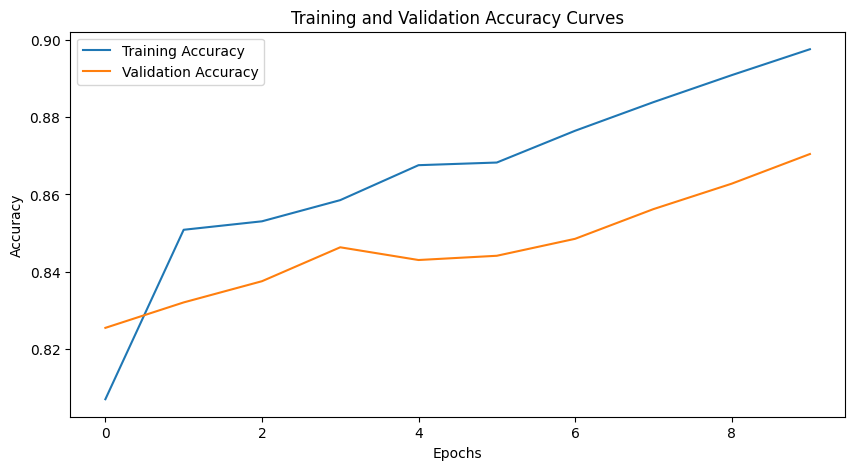

Final Training Metrics:
Test Loss: 0.2227
Accuracy: 0.9077
Precision: 0.9512
Recall: 0.8302
F1 Score: 0.8866


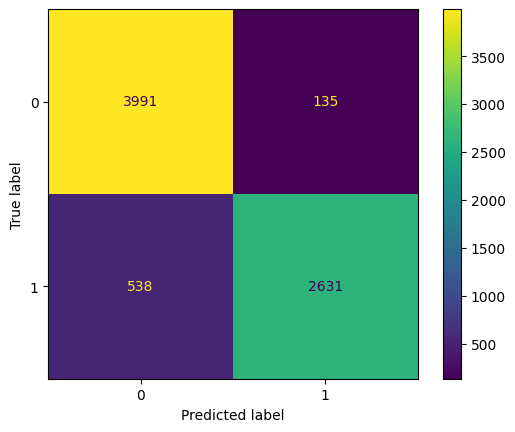

Final Test Metrics:
Test Loss: 0.2898
Accuracy: 0.8697
Precision: 0.9351
Recall: 0.7657
F1 Score: 0.8420


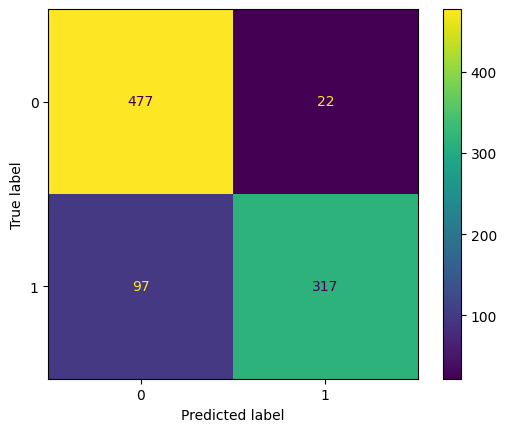

Experiment with Batch Size: 32, Learning Rate: 0.001
Epoch 1


Test Loss: 0.2901
Accuracy: 0.8705
Precision: 0.9967
Recall: 0.7181
F1 Score: 0.8347


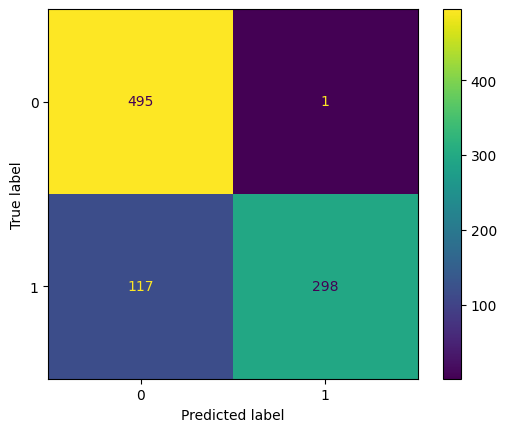

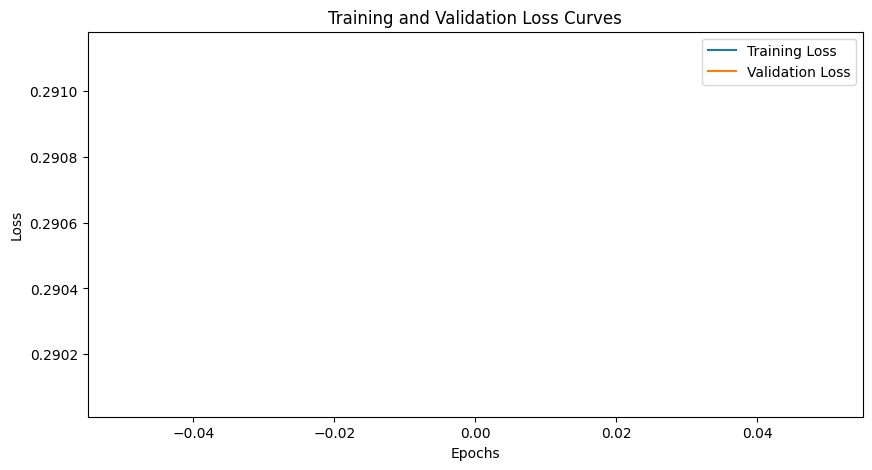

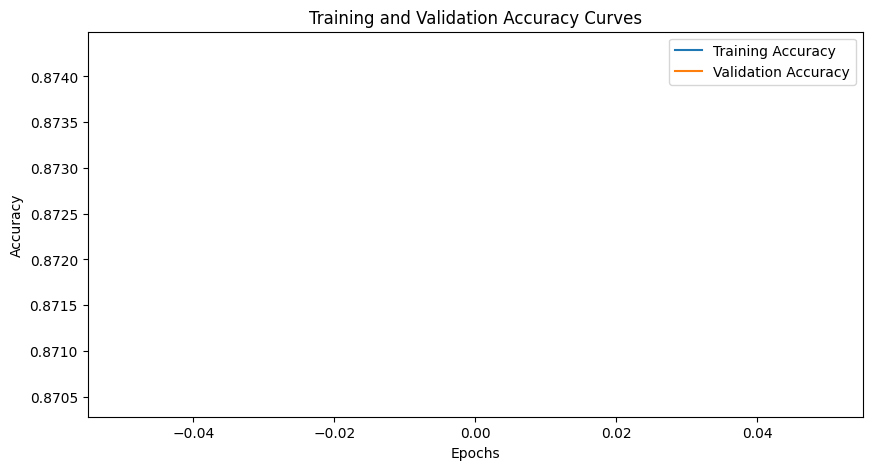

Final Training Metrics:
Test Loss: 0.2206
Accuracy: 0.8957
Precision: 0.9914
Recall: 0.7665
F1 Score: 0.8646


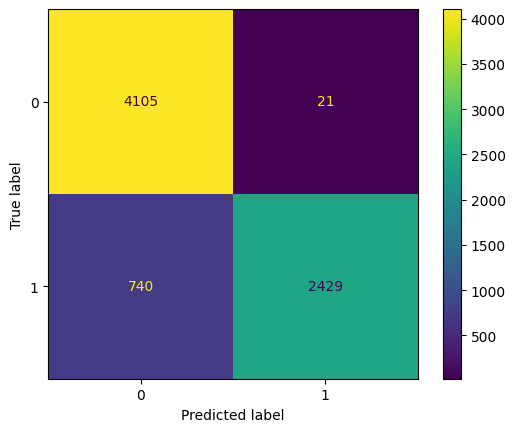

Final Test Metrics:
Test Loss: 0.3273
Accuracy: 0.8675
Precision: 0.9900
Recall: 0.7150
F1 Score: 0.8303


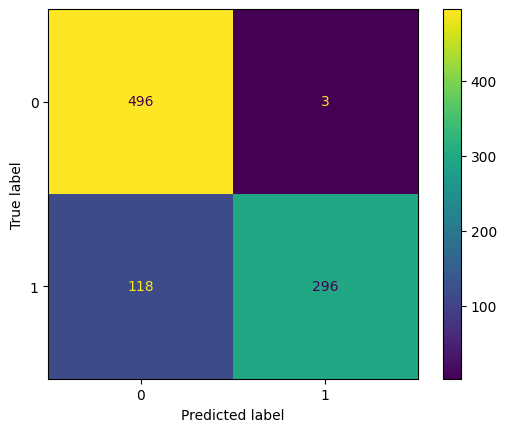

Epoch 2


Test Loss: 0.2034
Accuracy: 0.9144
Precision: 0.9041
Recall: 0.9084
F1 Score: 0.9062


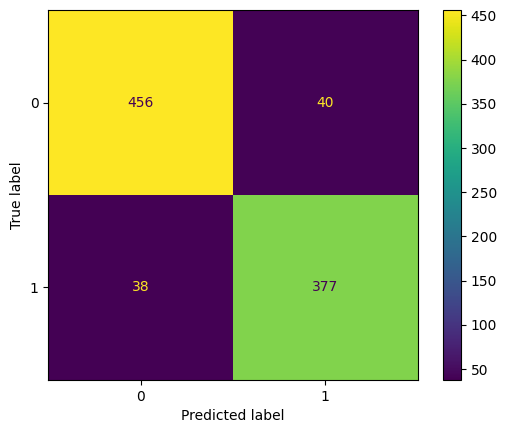

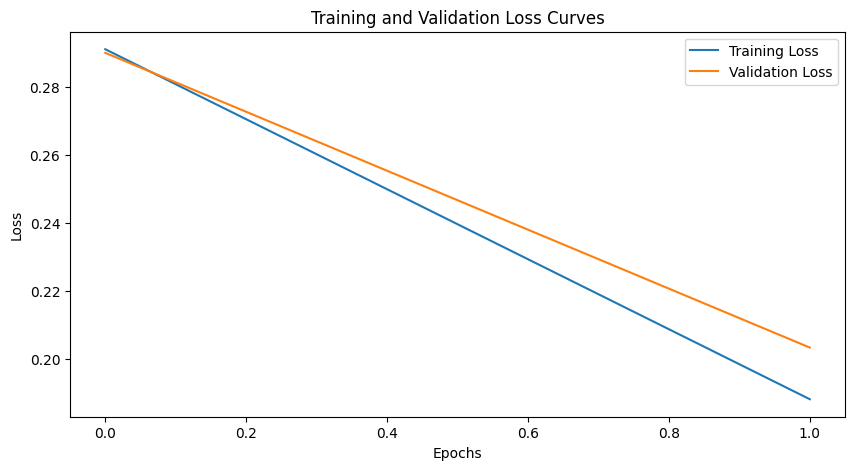

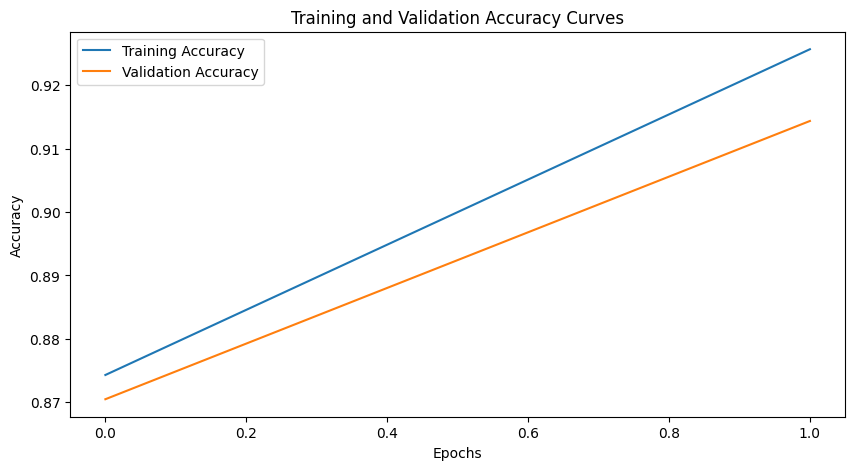

Final Training Metrics:
Test Loss: 0.1300
Accuracy: 0.9524
Precision: 0.9247
Recall: 0.9694
F1 Score: 0.9465


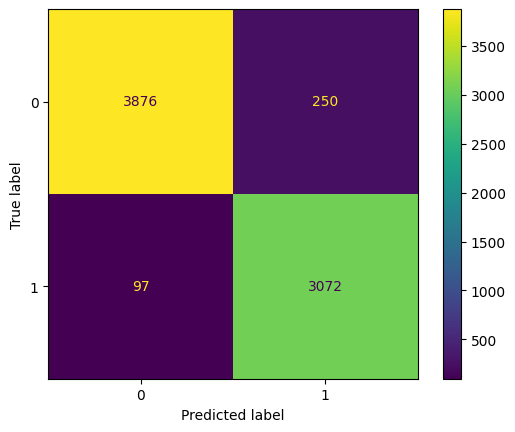

Final Test Metrics:
Test Loss: 0.2274
Accuracy: 0.8916
Precision: 0.8832
Recall: 0.8768
F1 Score: 0.8800


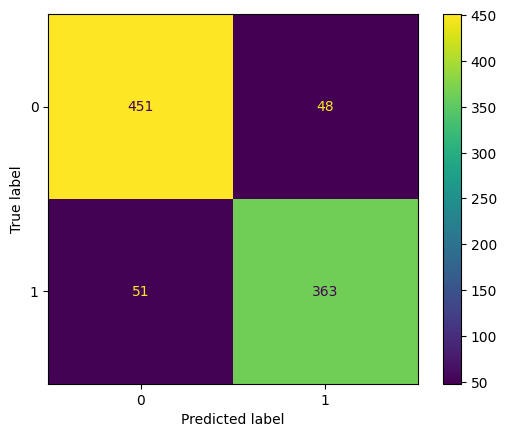

Epoch 3


Test Loss: 0.1989
Accuracy: 0.9155
Precision: 0.9289
Recall: 0.8819
F1 Score: 0.9048


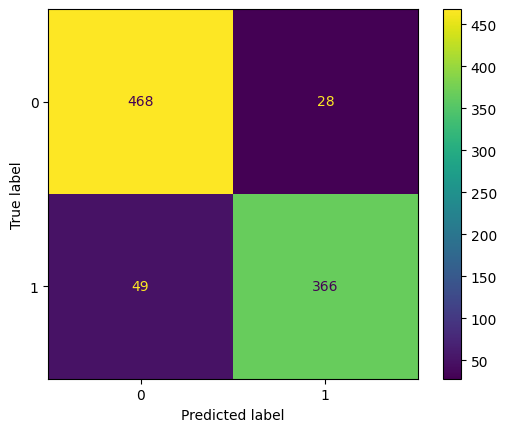

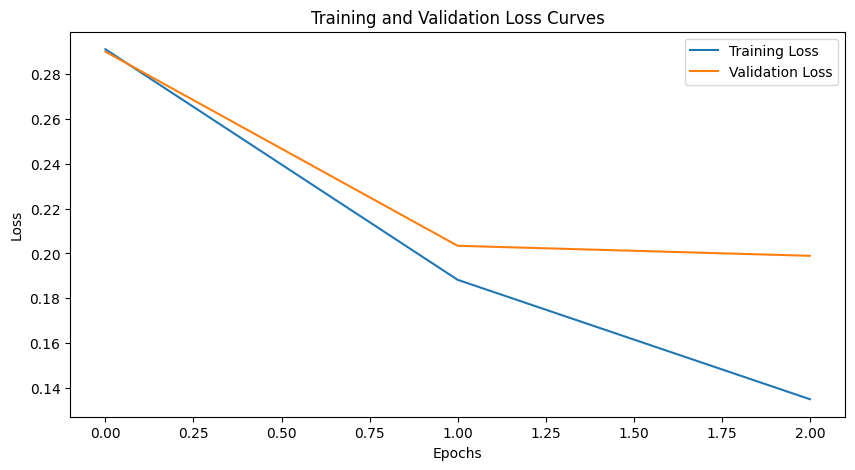

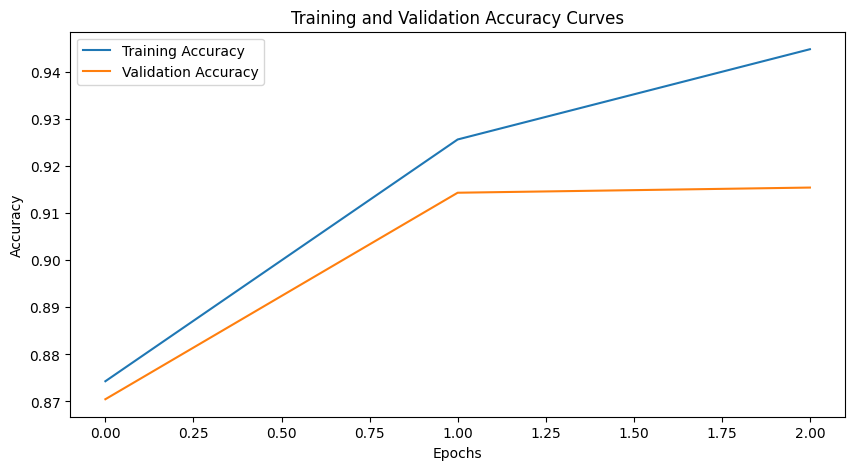

Final Training Metrics:
Test Loss: 0.0774
Accuracy: 0.9741
Precision: 0.9688
Recall: 0.9716
F1 Score: 0.9702


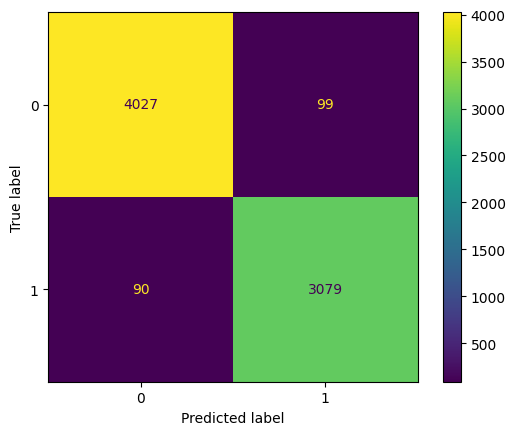

Final Test Metrics:
Test Loss: 0.2565
Accuracy: 0.9036
Precision: 0.9035
Recall: 0.8816
F1 Score: 0.8924


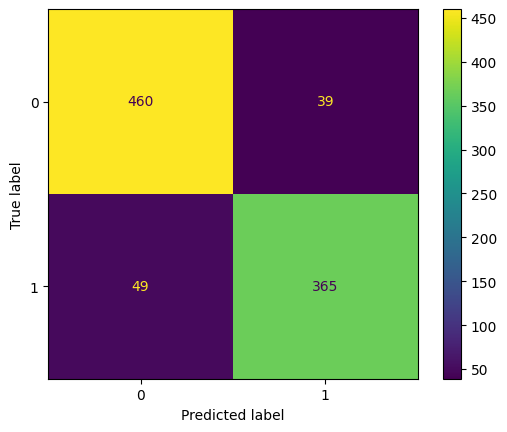

Epoch 4


Test Loss: 0.2666
Accuracy: 0.9221
Precision: 0.9550
Recall: 0.8699
F1 Score: 0.9105


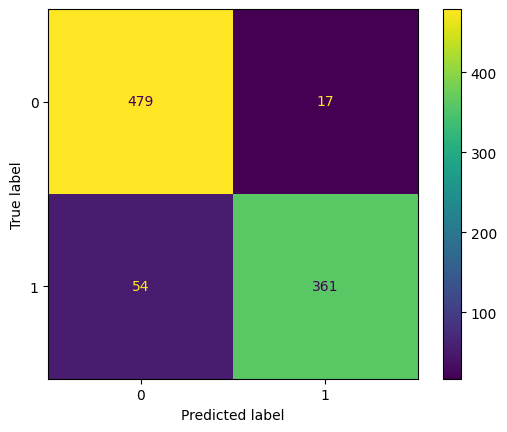

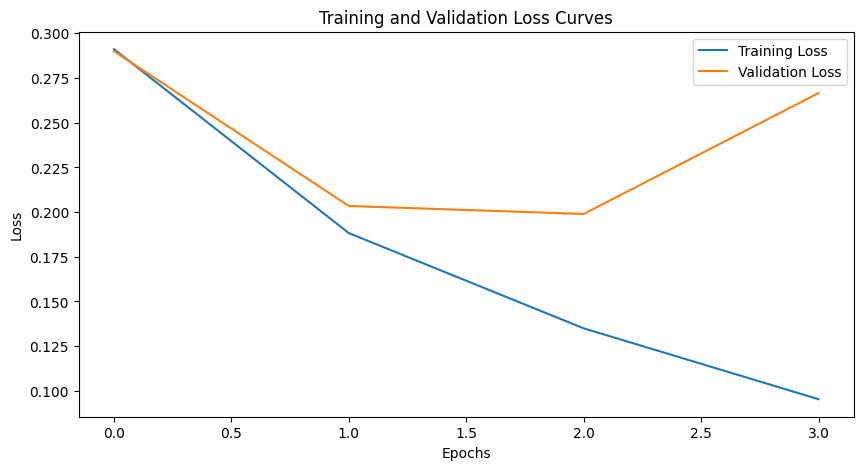

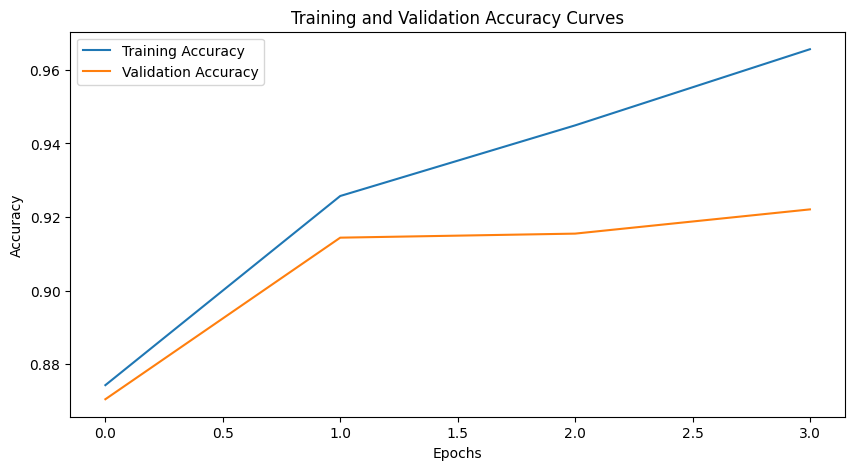

Final Training Metrics:
Test Loss: 0.0494
Accuracy: 0.9845
Precision: 0.9860
Recall: 0.9782
F1 Score: 0.9821


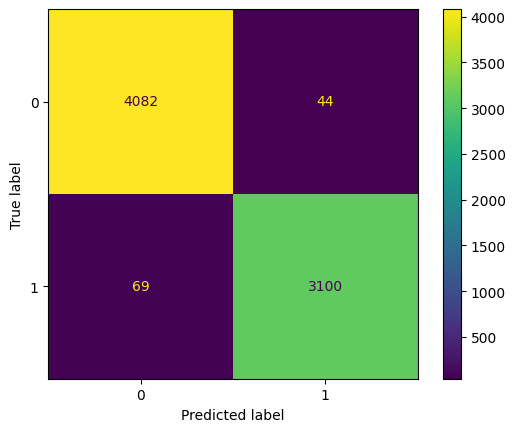

Final Test Metrics:
Test Loss: 0.2647
Accuracy: 0.9091
Precision: 0.9254
Recall: 0.8696
F1 Score: 0.8966


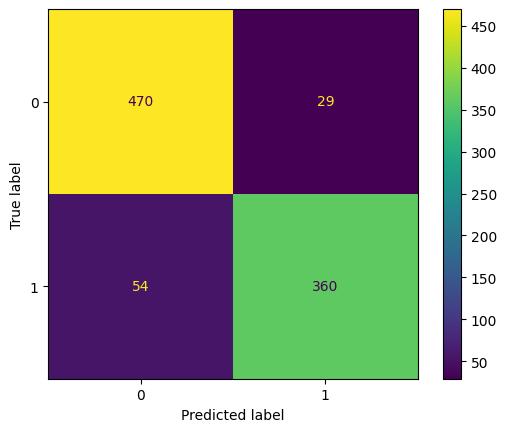

Epoch 5


Test Loss: 0.2523
Accuracy: 0.9199
Precision: 0.9500
Recall: 0.8699
F1 Score: 0.9082


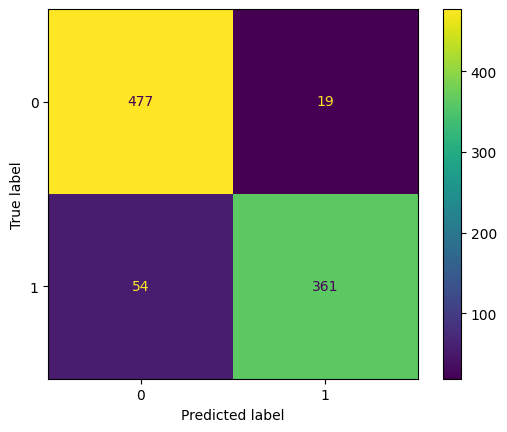

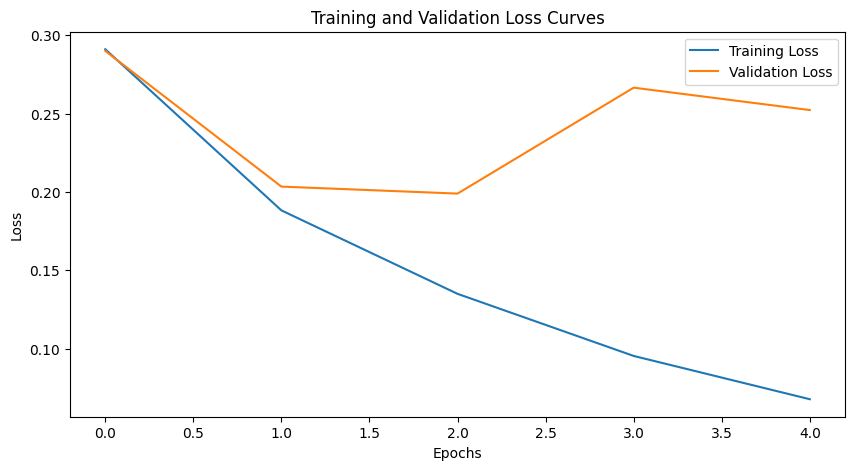

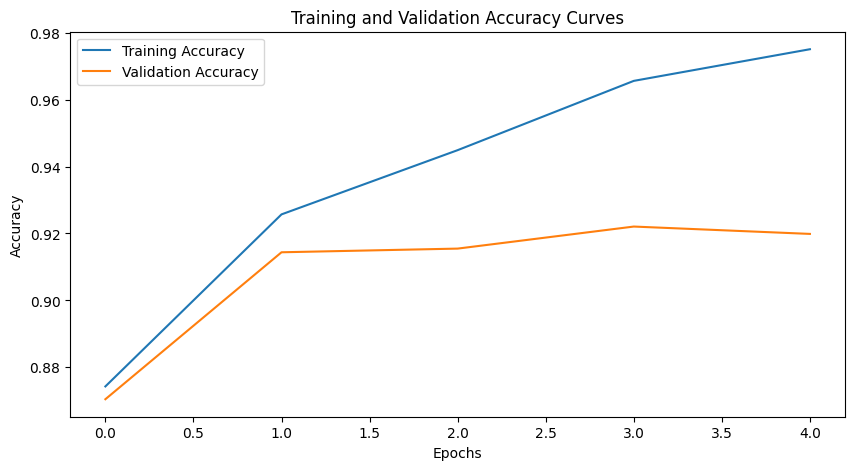

Final Training Metrics:
Test Loss: 0.0548
Accuracy: 0.9798
Precision: 0.9800
Recall: 0.9735
F1 Score: 0.9767


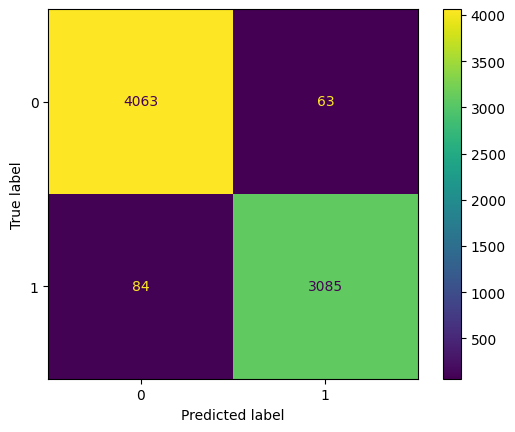

Final Test Metrics:
Test Loss: 0.3304
Accuracy: 0.8970
Precision: 0.9000
Recall: 0.8696
F1 Score: 0.8845


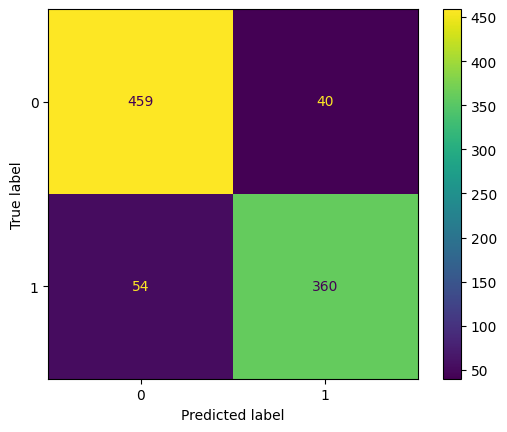

Epoch 6


Test Loss: 0.3349
Accuracy: 0.9155
Precision: 0.9333
Recall: 0.8771
F1 Score: 0.9043


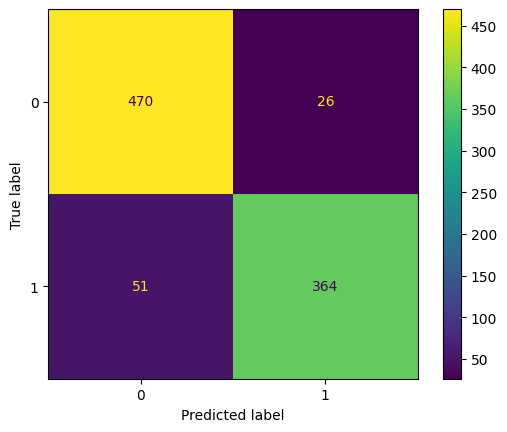

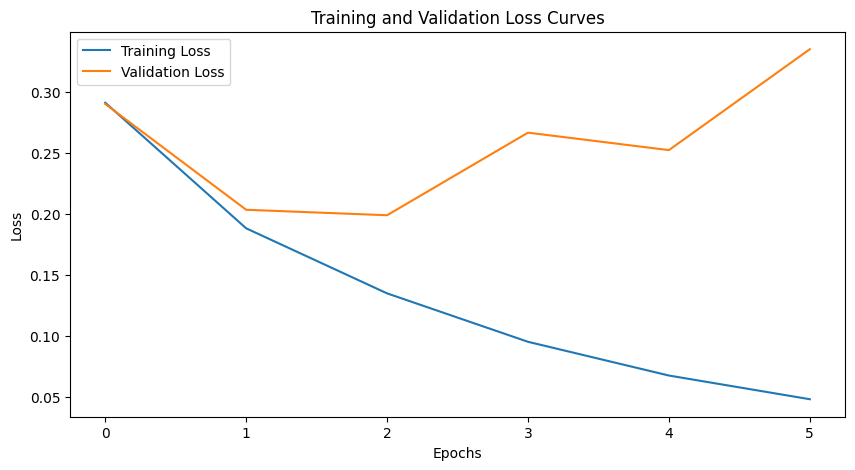

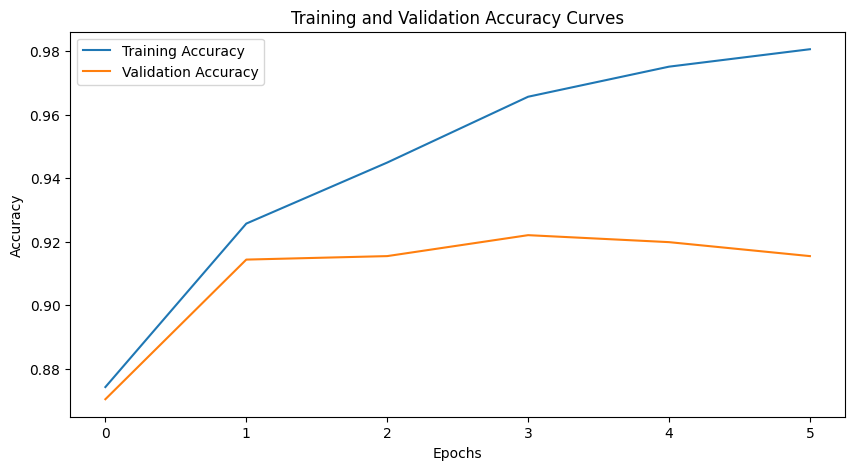

Final Training Metrics:
Test Loss: 0.0189
Accuracy: 0.9936
Precision: 0.9927
Recall: 0.9924
F1 Score: 0.9926


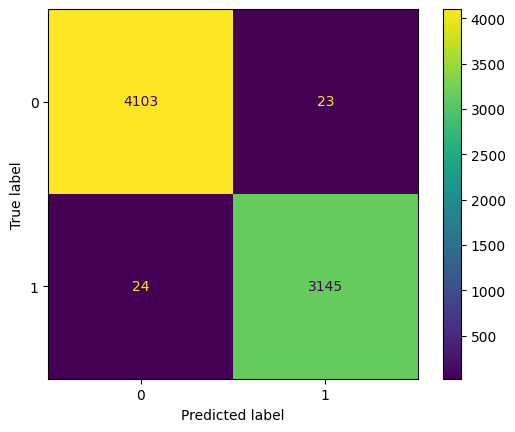

Final Test Metrics:
Test Loss: 0.3942
Accuracy: 0.9025
Precision: 0.9093
Recall: 0.8720
F1 Score: 0.8903


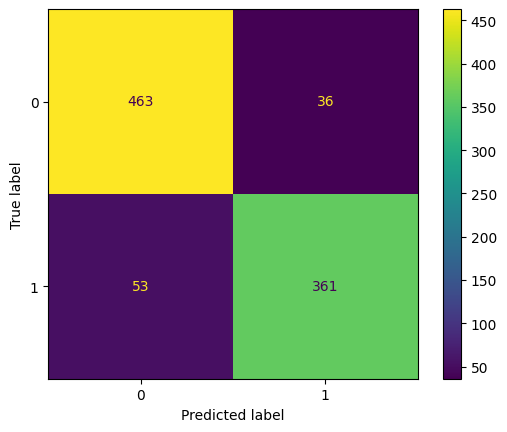

Epoch 7


Test Loss: 0.3703
Accuracy: 0.9133
Precision: 0.9375
Recall: 0.8675
F1 Score: 0.9011


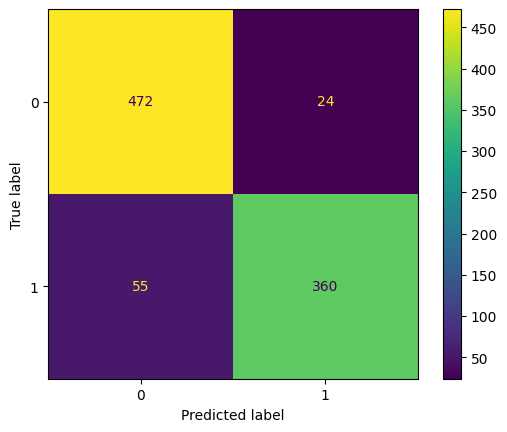

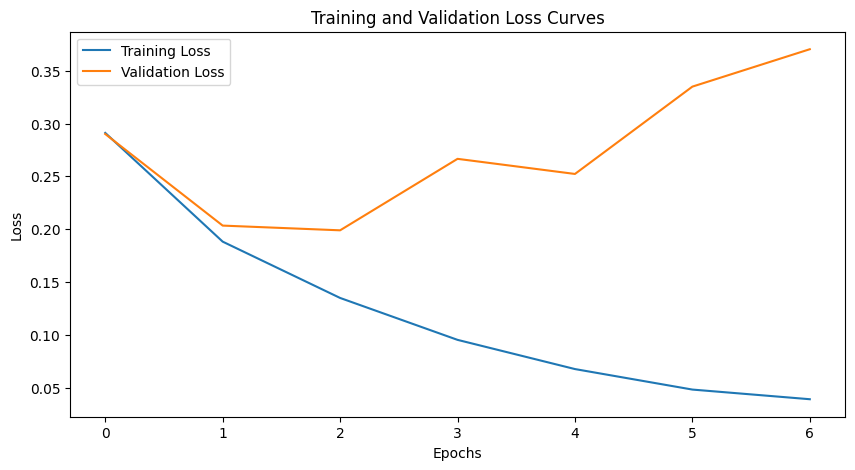

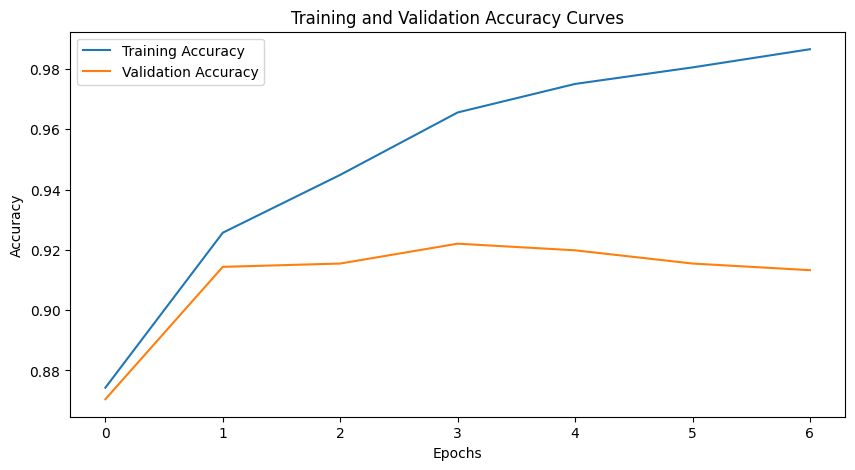

Final Training Metrics:
Test Loss: 0.0199
Accuracy: 0.9937
Precision: 0.9927
Recall: 0.9927
F1 Score: 0.9927


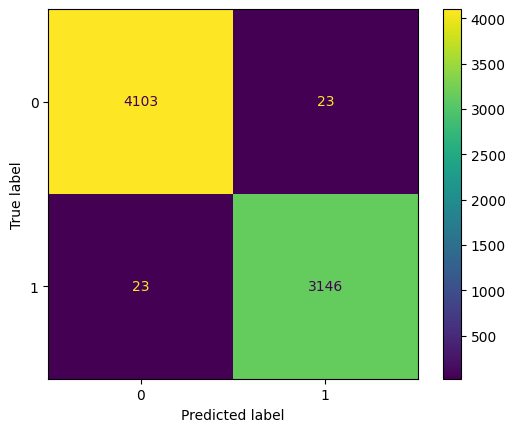

Final Test Metrics:
Test Loss: 0.4312
Accuracy: 0.9047
Precision: 0.9098
Recall: 0.8768
F1 Score: 0.8930


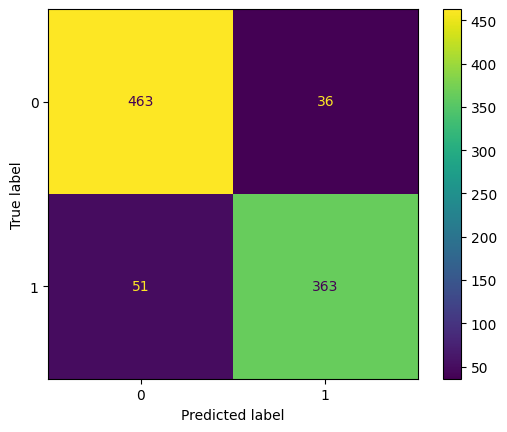

Epoch 8


Test Loss: 0.4256
Accuracy: 0.9034
Precision: 0.9314
Recall: 0.8506
F1 Score: 0.8892


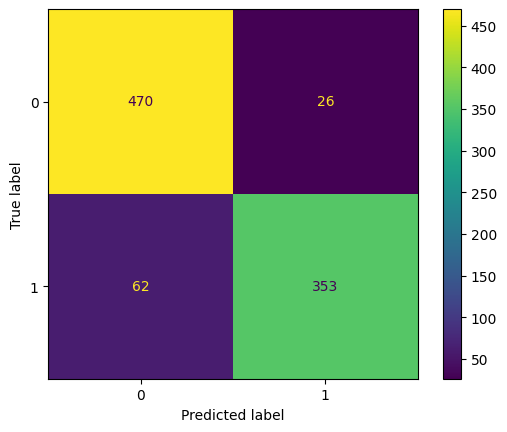

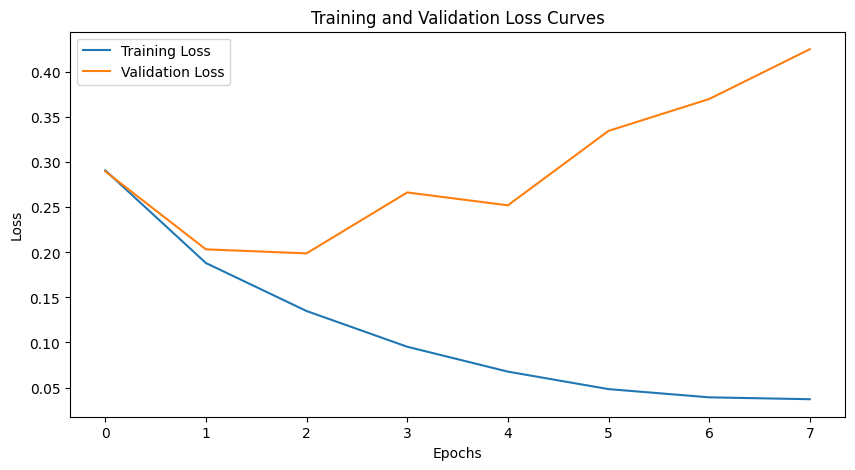

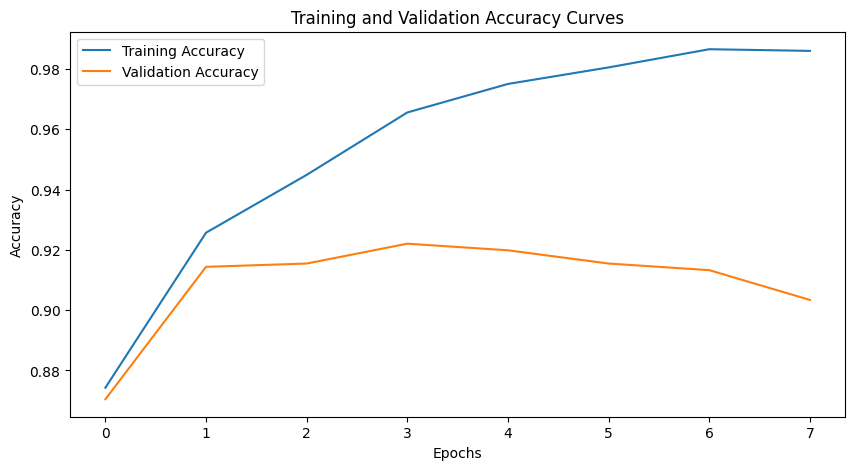

Final Training Metrics:
Test Loss: 0.0436
Accuracy: 0.9849
Precision: 0.9857
Recall: 0.9795
F1 Score: 0.9826


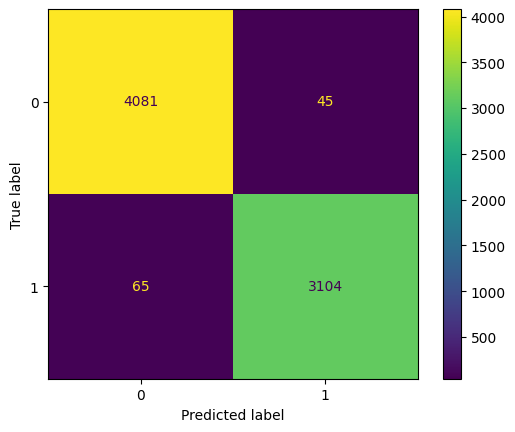

Final Test Metrics:
Test Loss: 0.5337
Accuracy: 0.9047
Precision: 0.9160
Recall: 0.8696
F1 Score: 0.8922


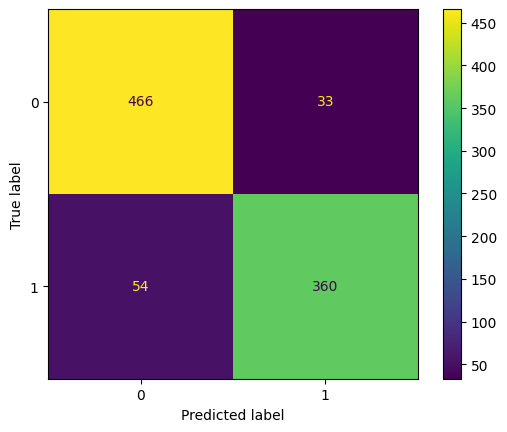

Epoch 9


Test Loss: 0.3223
Accuracy: 0.9221
Precision: 0.9115
Recall: 0.9181
F1 Score: 0.9148


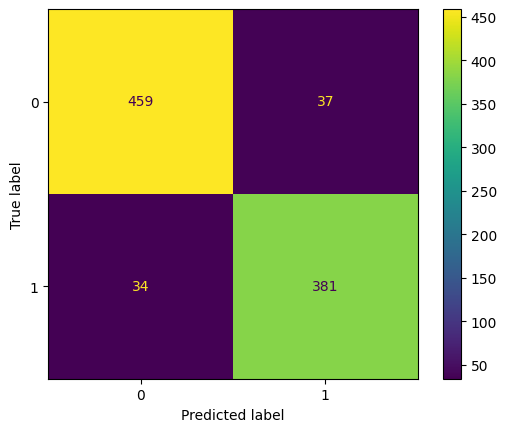

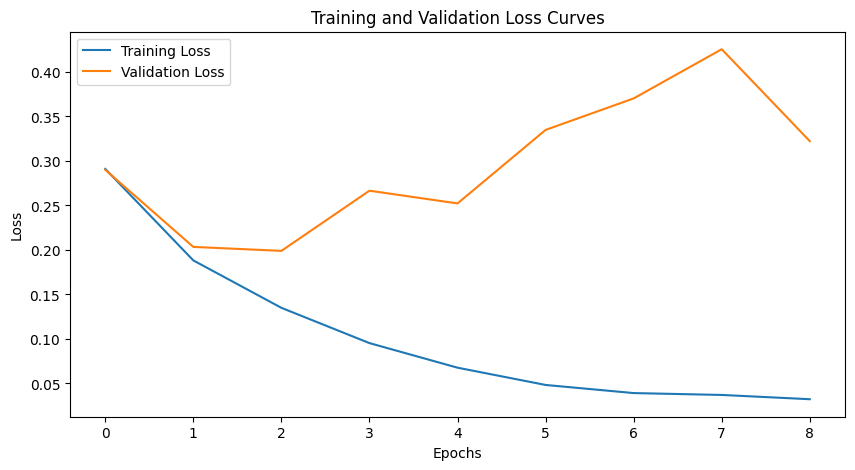

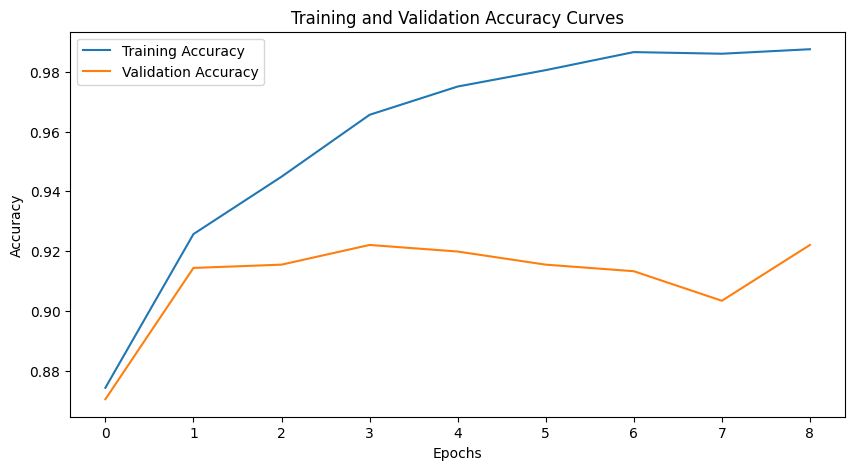

Final Training Metrics:


In [ ]:
if __name__ == '__main__':
    # Define parameters
    data_path = 'twitter-suicidal-data.csv'
    word2vec_path = "/content/drive/MyDrive/Colab Notebooks/GoogleNews-vectors-negative300.bin"
    embedding_dim = 300
    output_size = 2
    epochs = 10

    # Load dataset
    dataset = TwitterDataset(data_path, word2vec_path)
    train_size = int(0.8 * len(dataset))
    val_size = int(0.1 * len(dataset))
    test_size = len(dataset) - train_size - val_size
    train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(dataset, [train_size, val_size, test_size])

    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

    # Choose device (CPU or GPU if available)
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

    # Experiment with different batch sizes and learning rates
    batch_sizes = [16, 32, 64]
    learning_rates = [0.001, 0.0001, 0.00001]
    for batch_size in batch_sizes:
        for learning_rate in learning_rates:
            print(f"Experiment with Batch Size: {batch_size}, Learning Rate: {learning_rate}")
            run_experiment(batch_size, learning_rate)

### with batch normalization and drop out (good) and size = 196

Experiment with Batch Size: 16, Learning Rate: 0.001
Epoch 1


Train Loss: 0.2094
Train Accuracy: 0.9086
Train Precision: 0.9356
Train Recall: 0.8508
Train F1 Score: 0.8912


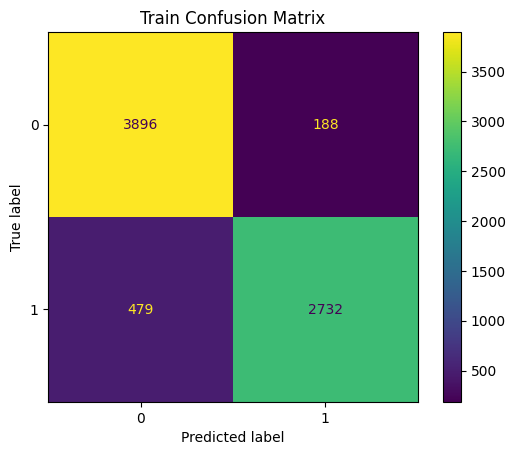

Validation Loss: 0.2205
Validation Accuracy: 0.9012
Validation Precision: 0.9257
Validation Recall: 0.8351
Validation F1 Score: 0.8780


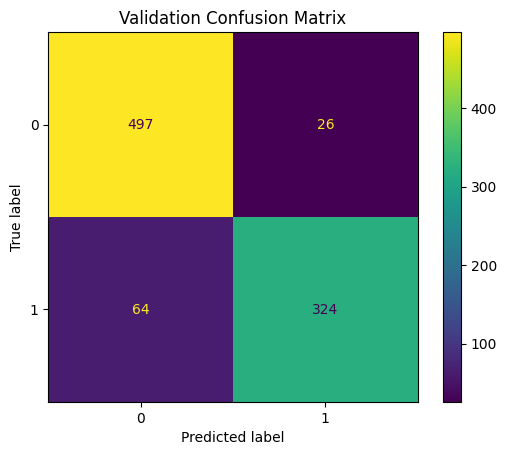

Epoch 2


Train Loss: 0.1713
Train Accuracy: 0.9286
Train Precision: 0.8993
Train Recall: 0.9433
Train F1 Score: 0.9208


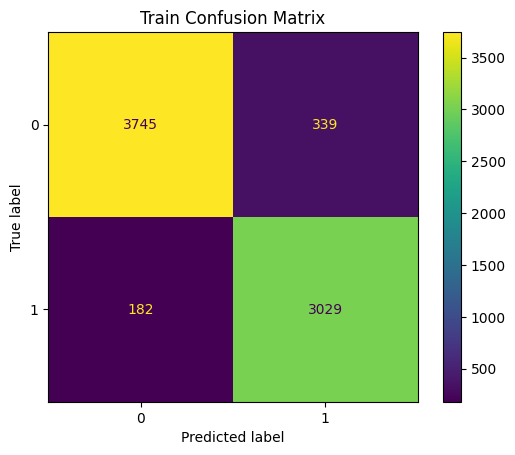

Validation Loss: 0.2197
Validation Accuracy: 0.9056
Validation Precision: 0.8738
Validation Recall: 0.9098
Validation F1 Score: 0.8914


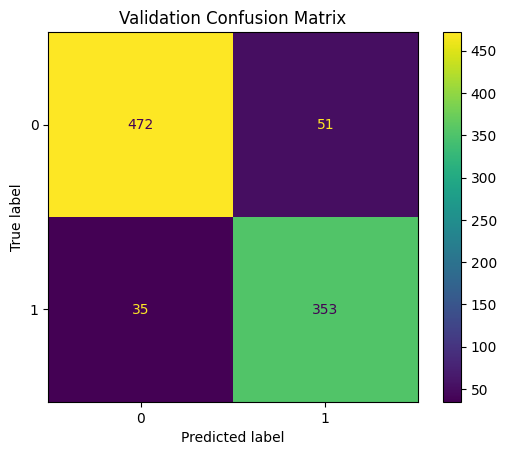

Epoch 3


Train Loss: 0.0934
Train Accuracy: 0.9674
Train Precision: 0.9641
Train Recall: 0.9617
Train F1 Score: 0.9629


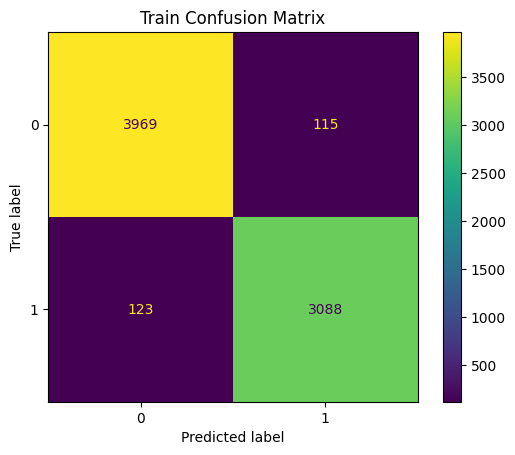

Validation Loss: 0.1853
Validation Accuracy: 0.9319
Validation Precision: 0.9312
Validation Recall: 0.9072
Validation F1 Score: 0.9191


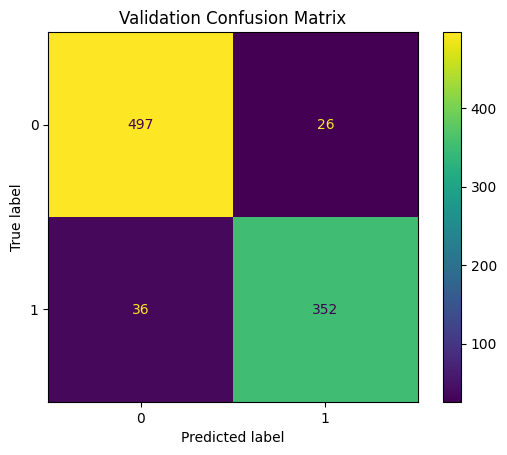

Epoch 4


Train Loss: 0.0862
Train Accuracy: 0.9729
Train Precision: 0.9651
Train Recall: 0.9735
Train F1 Score: 0.9693


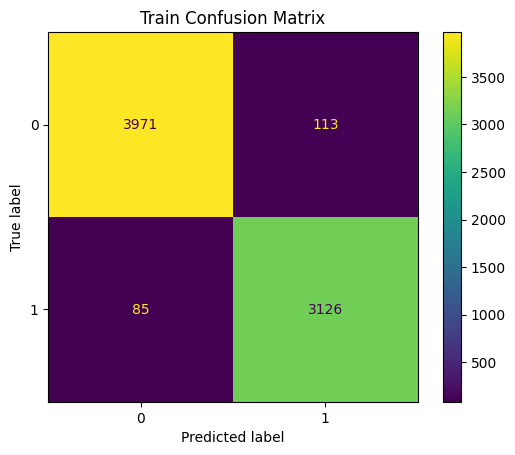

Validation Loss: 0.1873
Validation Accuracy: 0.9232
Validation Precision: 0.9274
Validation Recall: 0.8892
Validation F1 Score: 0.9079


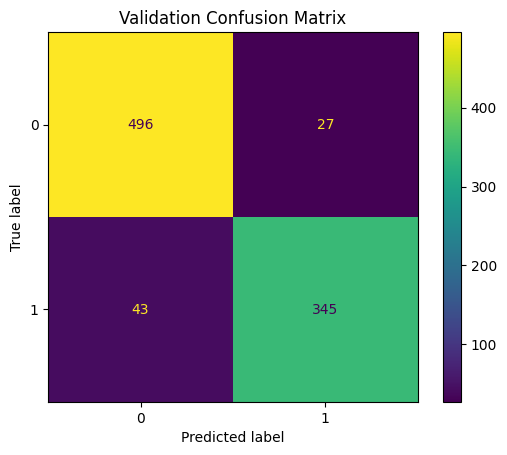

Epoch 5


Train Loss: 0.0970
Train Accuracy: 0.9545
Train Precision: 0.9891
Train Recall: 0.9066
Train F1 Score: 0.9461


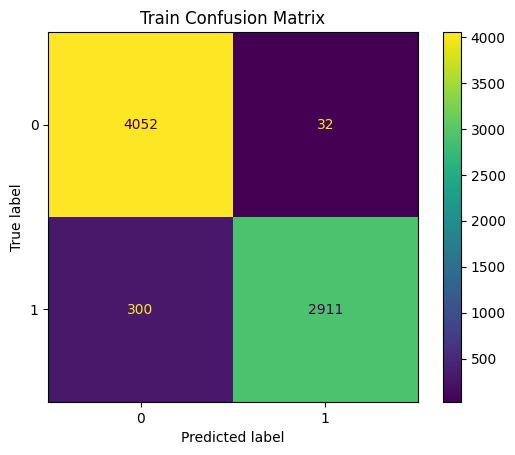

Validation Loss: 0.2526
Validation Accuracy: 0.9210
Validation Precision: 0.9702
Validation Recall: 0.8402
Validation F1 Score: 0.9006


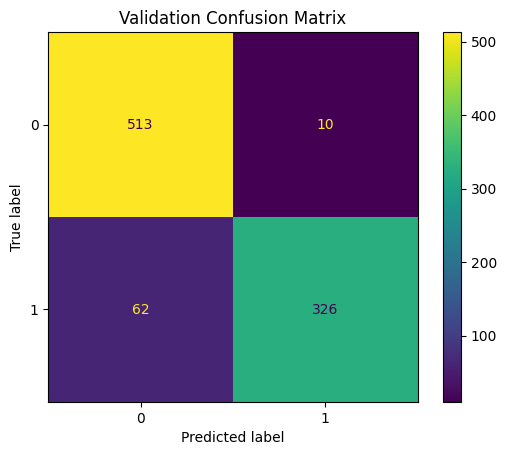

Epoch 6


Train Loss: 0.0619
Train Accuracy: 0.9760
Train Precision: 0.9732
Train Recall: 0.9723
Train F1 Score: 0.9727


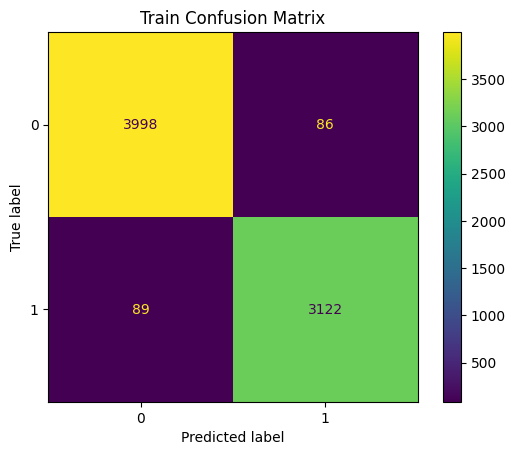

Validation Loss: 0.2367
Validation Accuracy: 0.9297
Validation Precision: 0.9355
Validation Recall: 0.8969
Validation F1 Score: 0.9158


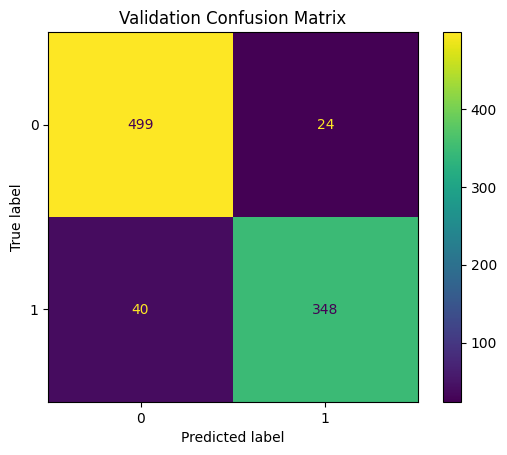

Epoch 7


Train Loss: 0.0421
Train Accuracy: 0.9852
Train Precision: 0.9902
Train Recall: 0.9760
Train F1 Score: 0.9831


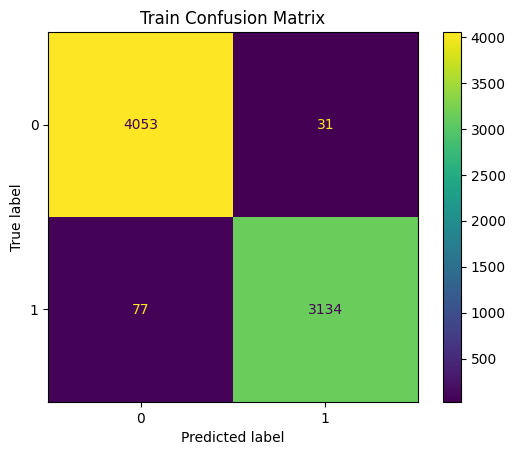

Validation Loss: 0.2659
Validation Accuracy: 0.9352
Validation Precision: 0.9582
Validation Recall: 0.8866
Validation F1 Score: 0.9210


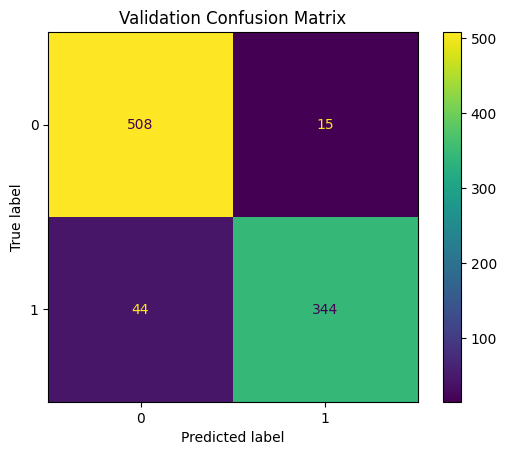

Epoch 8


Train Loss: 0.0921
Train Accuracy: 0.9652
Train Precision: 0.9956
Train Recall: 0.9249
Train F1 Score: 0.9590


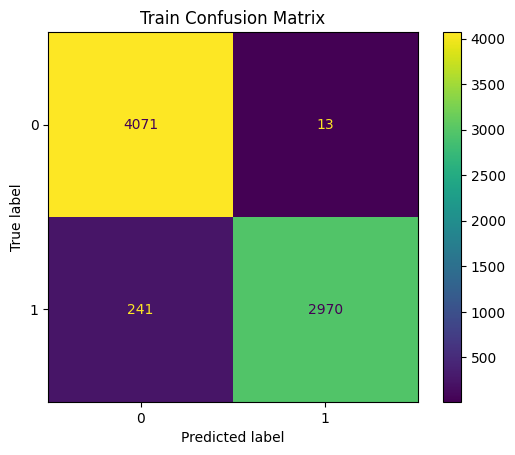

Validation Loss: 0.4669
Validation Accuracy: 0.9166
Validation Precision: 0.9815
Validation Recall: 0.8196
Validation F1 Score: 0.8933


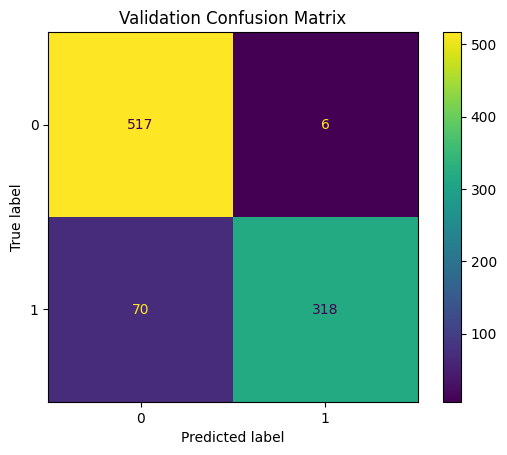

Epoch 9


Train Loss: 0.0282
Train Accuracy: 0.9896
Train Precision: 0.9786
Train Recall: 0.9981
Train F1 Score: 0.9883


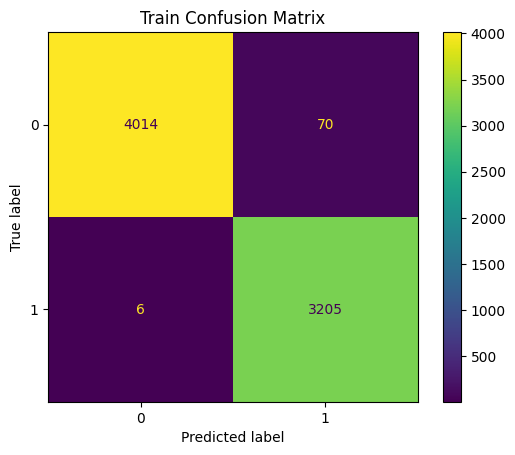

Validation Loss: 0.3765
Validation Accuracy: 0.9221
Validation Precision: 0.8953
Validation Recall: 0.9253
Validation F1 Score: 0.9100


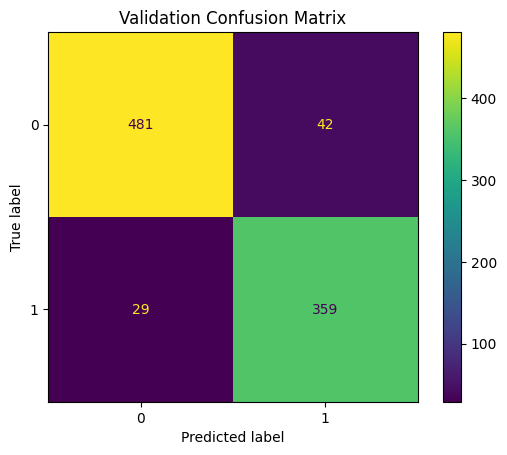

Epoch 10


Train Loss: 0.0269
Train Accuracy: 0.9890
Train Precision: 0.9900
Train Recall: 0.9851
Train F1 Score: 0.9875


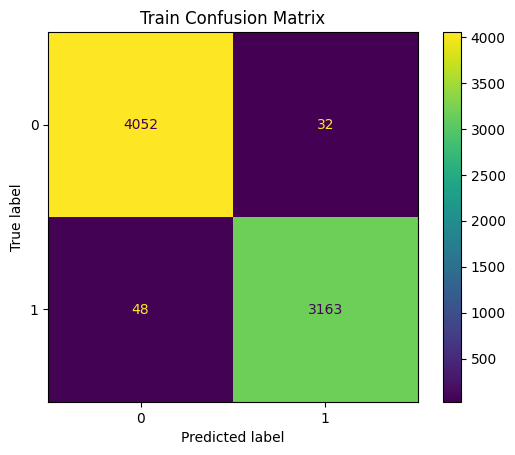

Validation Loss: 0.3970
Validation Accuracy: 0.9254
Validation Precision: 0.9324
Validation Recall: 0.8892
Validation F1 Score: 0.9103


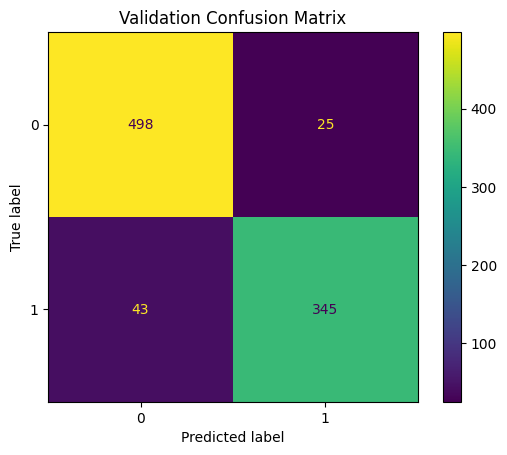

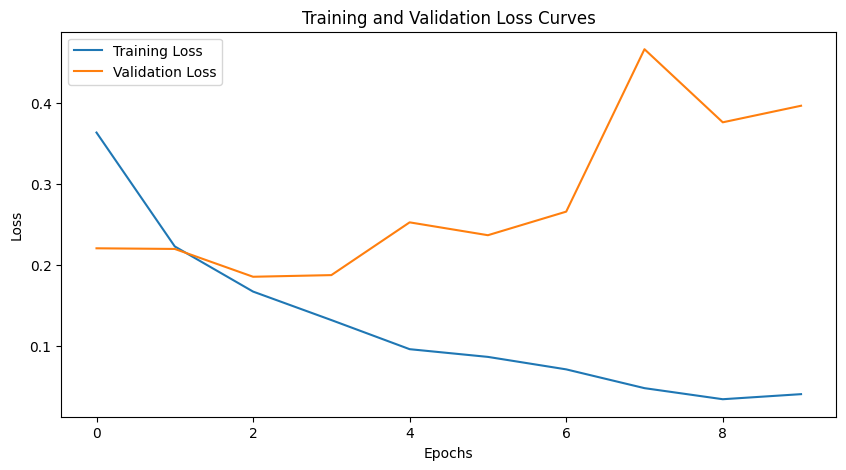

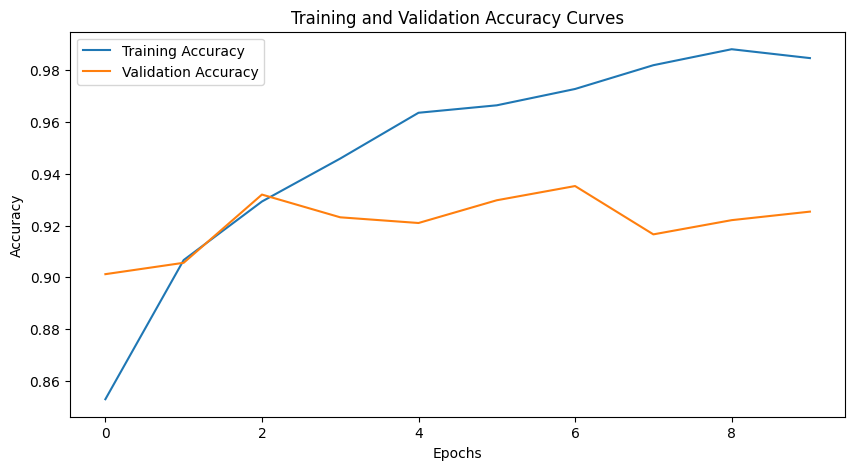

Experiment with Batch Size: 32, Learning Rate: 0.001
Epoch 1


Train Loss: 0.1839
Train Accuracy: 0.9224
Train Precision: 0.9472
Train Recall: 0.8723
Train F1 Score: 0.9082


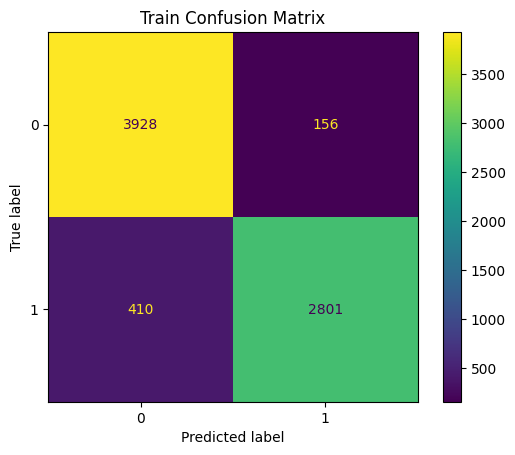

Validation Loss: 0.2007
Validation Accuracy: 0.9111
Validation Precision: 0.9300
Validation Recall: 0.8557
Validation F1 Score: 0.8913


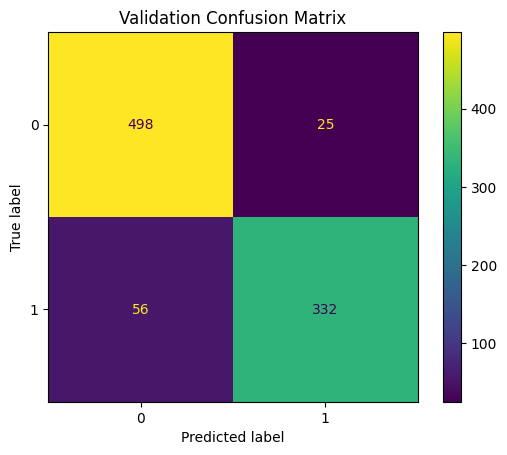

Epoch 2


Train Loss: 0.1271
Train Accuracy: 0.9468
Train Precision: 0.9639
Train Recall: 0.9134
Train F1 Score: 0.9380


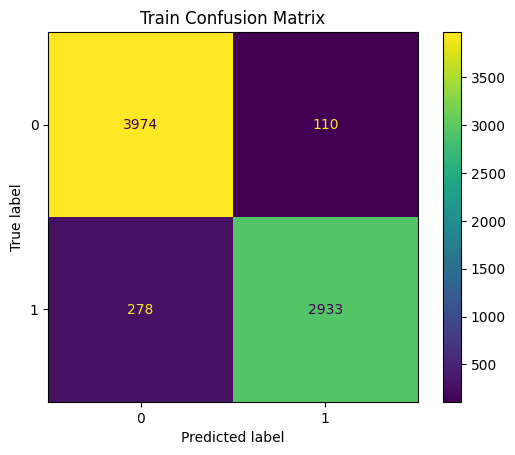

Validation Loss: 0.1825
Validation Accuracy: 0.9243
Validation Precision: 0.9443
Validation Recall: 0.8737
Validation F1 Score: 0.9076


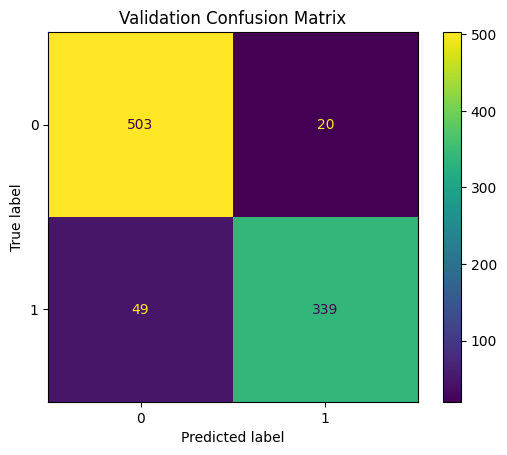

Epoch 3


Train Loss: 0.1266
Train Accuracy: 0.9437
Train Precision: 0.9765
Train Recall: 0.8935
Train F1 Score: 0.9332


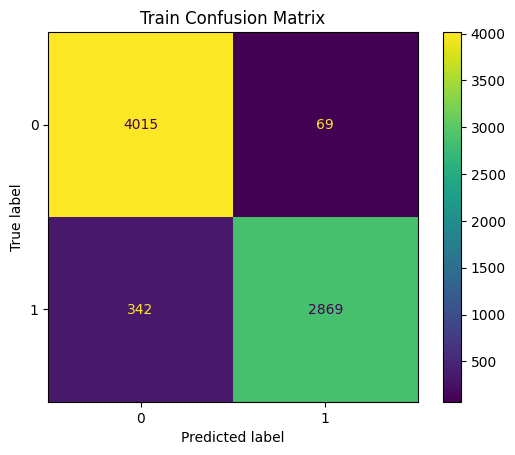

Validation Loss: 0.2239
Validation Accuracy: 0.9199
Validation Precision: 0.9730
Validation Recall: 0.8351
Validation F1 Score: 0.8988


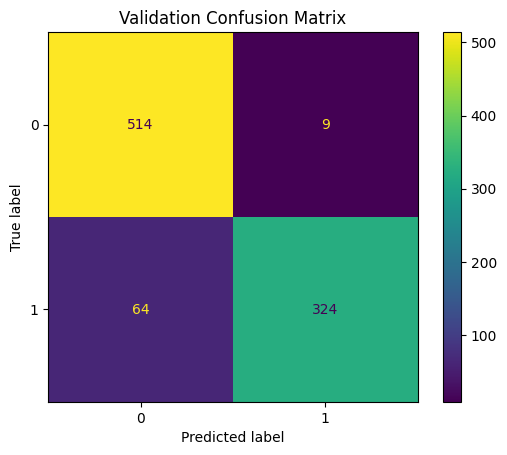

Epoch 4


Train Loss: 0.0622
Train Accuracy: 0.9742
Train Precision: 0.9794
Train Recall: 0.9617
Train F1 Score: 0.9705


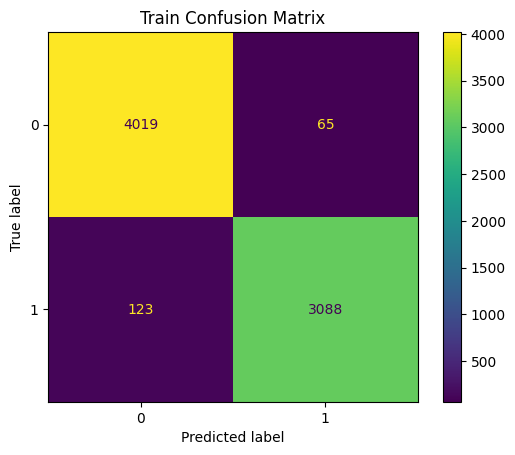

Validation Loss: 0.2651
Validation Accuracy: 0.9297
Validation Precision: 0.9451
Validation Recall: 0.8866
Validation F1 Score: 0.9149


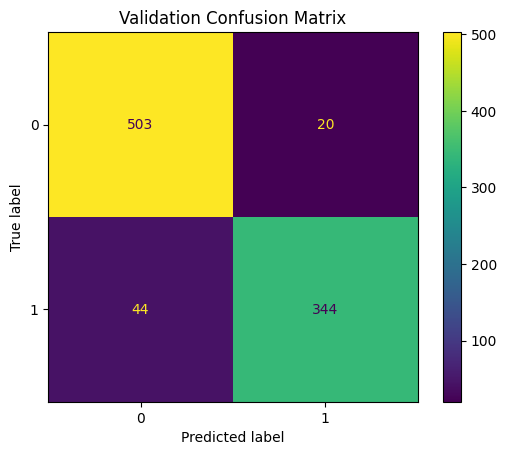

Epoch 5


Train Loss: 0.0413
Train Accuracy: 0.9862
Train Precision: 0.9770
Train Recall: 0.9919
Train F1 Score: 0.9844


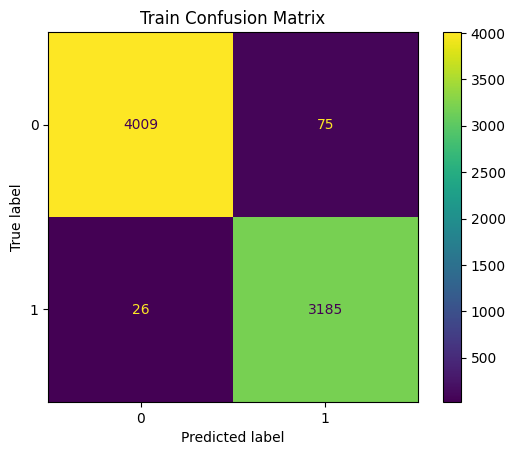

Validation Loss: 0.2465
Validation Accuracy: 0.9210
Validation Precision: 0.9115
Validation Recall: 0.9021
Validation F1 Score: 0.9067


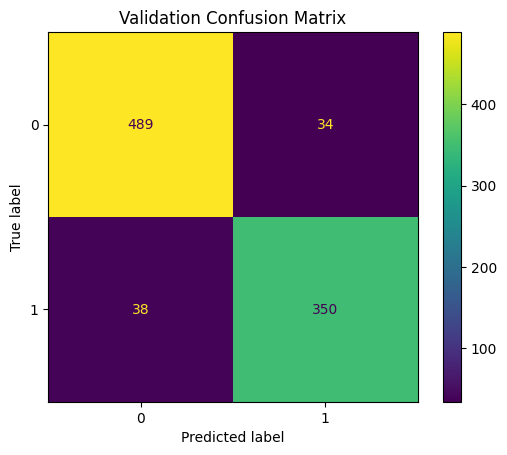

Epoch 6


Train Loss: 0.0364
Train Accuracy: 0.9867
Train Precision: 0.9927
Train Recall: 0.9770
Train F1 Score: 0.9848


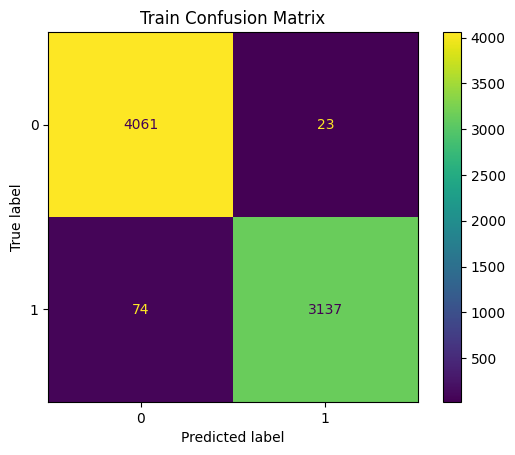

Validation Loss: 0.3278
Validation Accuracy: 0.9188
Validation Precision: 0.9460
Validation Recall: 0.8582
Validation F1 Score: 0.9000


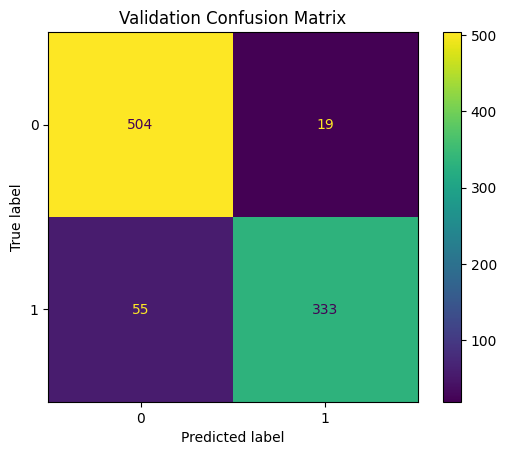

Epoch 7


Train Loss: 0.0446
Train Accuracy: 0.9819
Train Precision: 0.9990
Train Recall: 0.9598
Train F1 Score: 0.9790


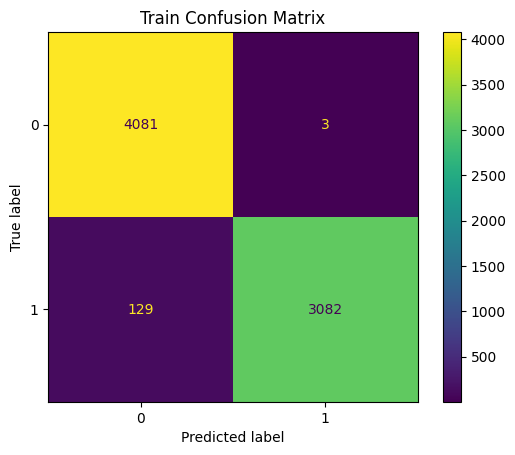

Validation Loss: 0.3474
Validation Accuracy: 0.9297
Validation Precision: 0.9737
Validation Recall: 0.8582
Validation F1 Score: 0.9123


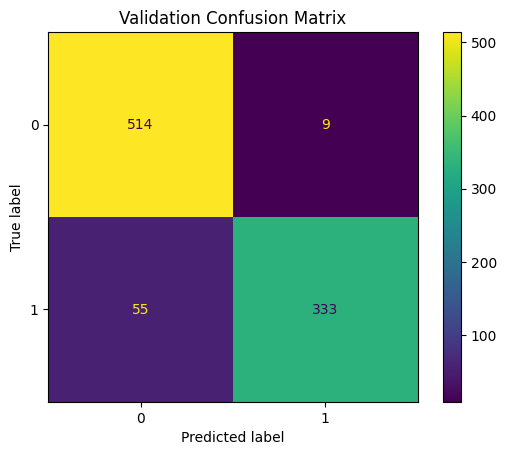

Epoch 8


Train Loss: 0.0861
Train Accuracy: 0.9687
Train Precision: 0.9362
Train Recall: 0.9969
Train F1 Score: 0.9656


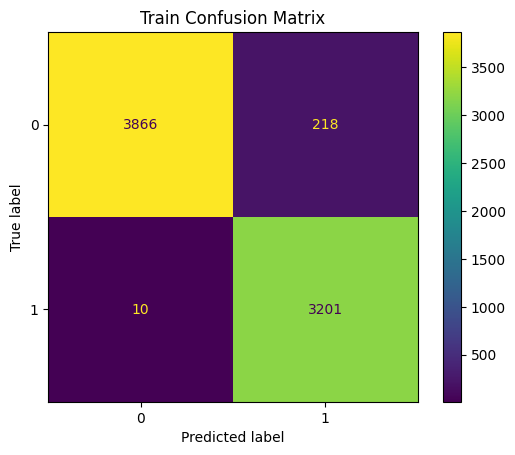

Validation Loss: 0.4532
Validation Accuracy: 0.8968
Validation Precision: 0.8435
Validation Recall: 0.9304
Validation F1 Score: 0.8848


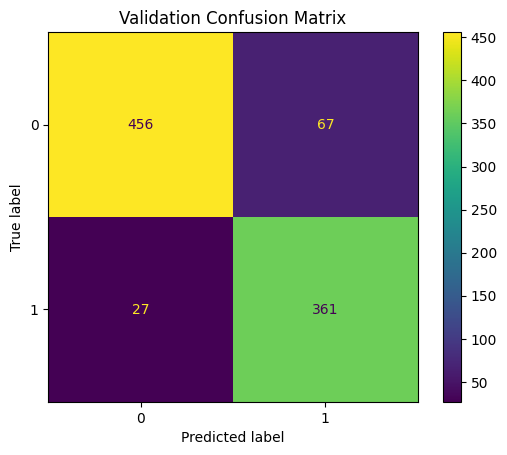

Epoch 9


Train Loss: 0.0202
Train Accuracy: 0.9929
Train Precision: 0.9873
Train Recall: 0.9966
Train F1 Score: 0.9919


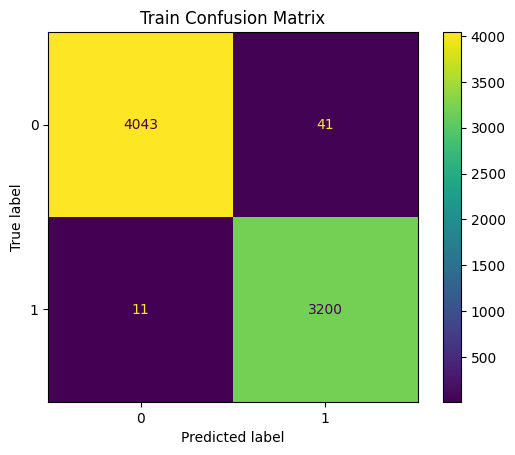

Validation Loss: 0.3369
Validation Accuracy: 0.9177
Validation Precision: 0.8942
Validation Recall: 0.9149
Validation F1 Score: 0.9045


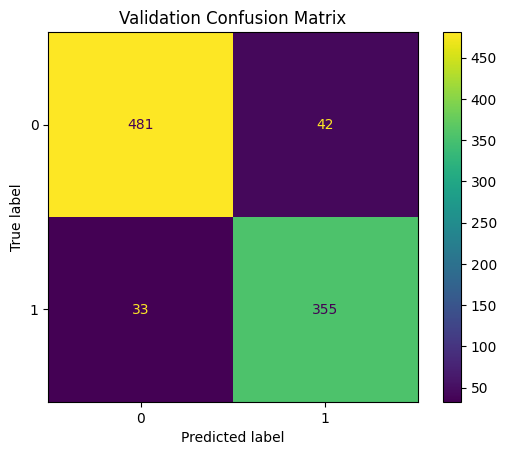

Epoch 10


Train Loss: 0.0169
Train Accuracy: 0.9918
Train Precision: 0.9959
Train Recall: 0.9854
Train F1 Score: 0.9906


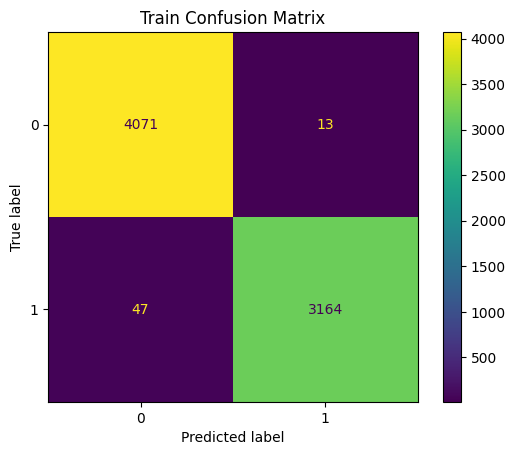

Validation Loss: 0.4024
Validation Accuracy: 0.9221
Validation Precision: 0.9415
Validation Recall: 0.8711
Validation F1 Score: 0.9050


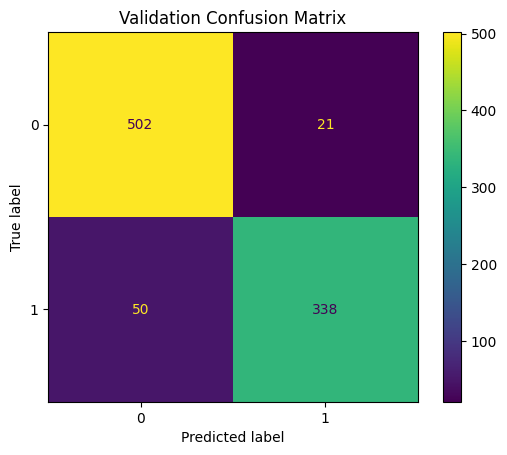

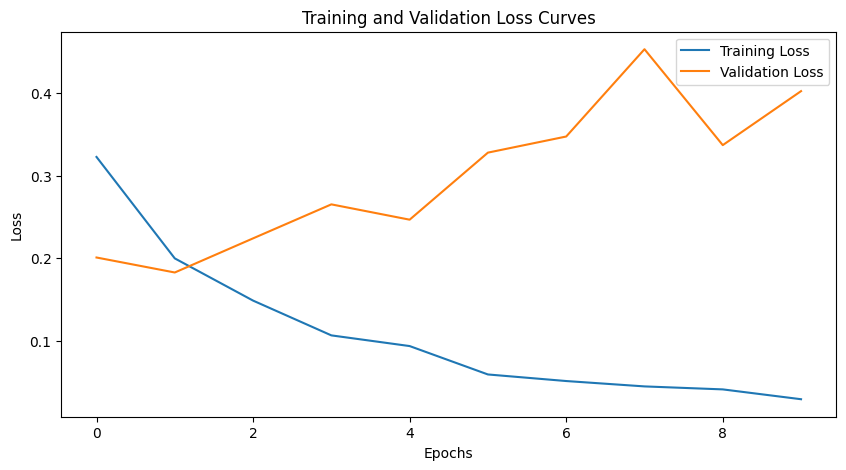

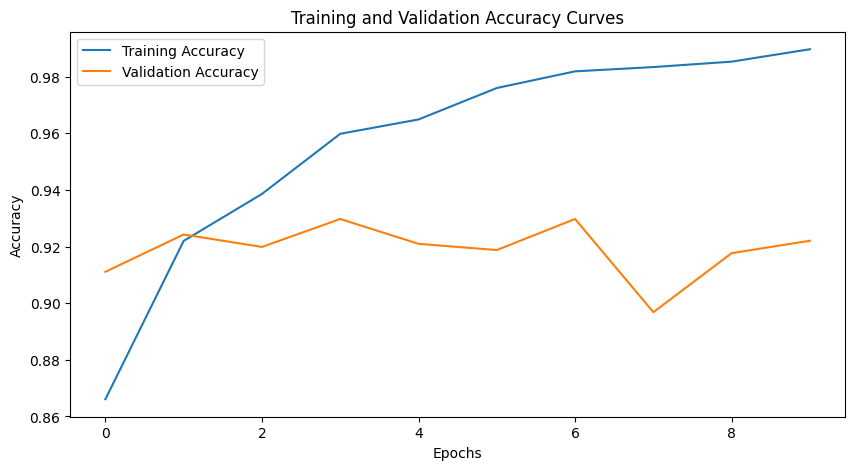

Experiment with Batch Size: 64, Learning Rate: 0.001
Epoch 1


Train Loss: 0.2018
Train Accuracy: 0.9143
Train Precision: 0.9486
Train Recall: 0.8514
Train F1 Score: 0.8974


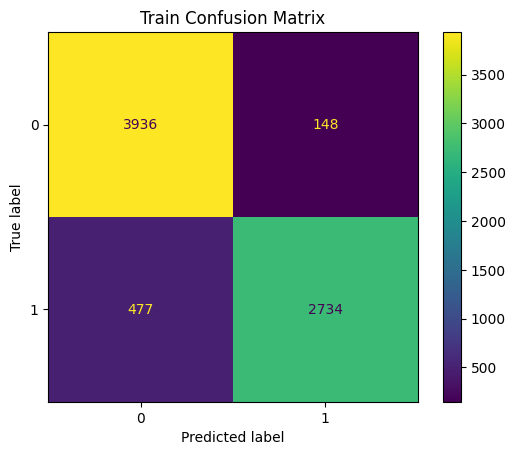

Validation Loss: 0.2163
Validation Accuracy: 0.8957
Validation Precision: 0.9296
Validation Recall: 0.8170
Validation F1 Score: 0.8697


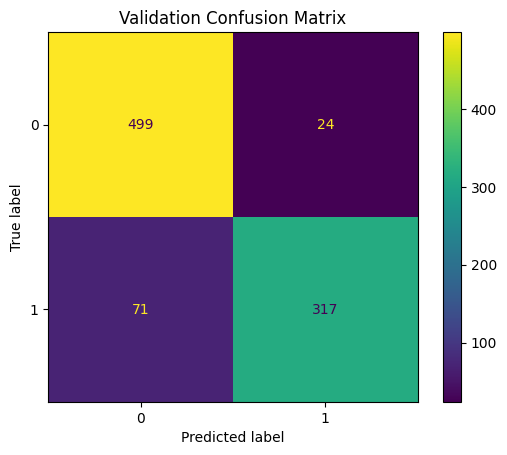

Epoch 2


Train Loss: 0.1457
Train Accuracy: 0.9375
Train Precision: 0.9808
Train Recall: 0.8751
Train F1 Score: 0.9250


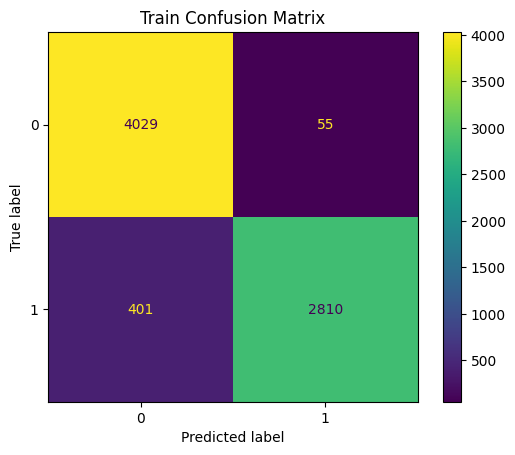

Validation Loss: 0.1851
Validation Accuracy: 0.9210
Validation Precision: 0.9702
Validation Recall: 0.8402
Validation F1 Score: 0.9006


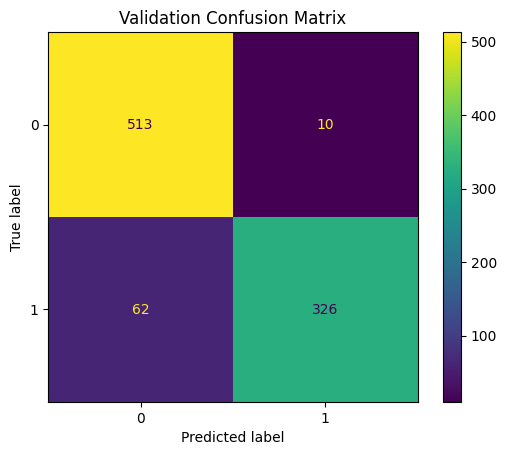

Epoch 3


Train Loss: 0.1002
Train Accuracy: 0.9607
Train Precision: 0.9775
Train Recall: 0.9321
Train F1 Score: 0.9542


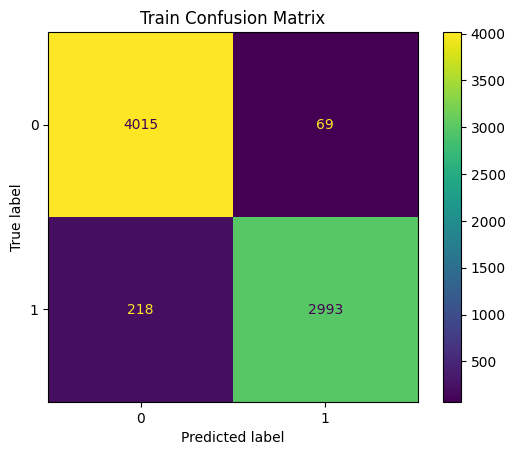

Validation Loss: 0.1945
Validation Accuracy: 0.9265
Validation Precision: 0.9496
Validation Recall: 0.8737
Validation F1 Score: 0.9101


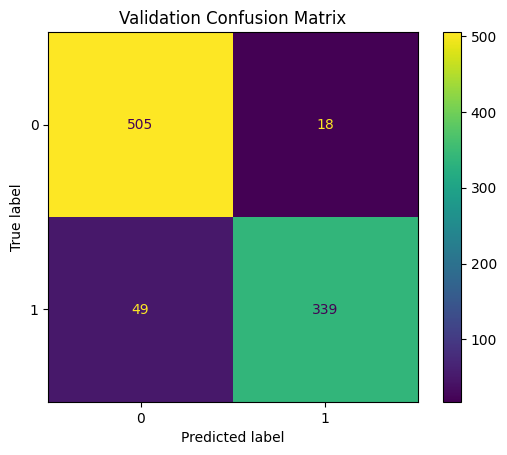

Epoch 4


Train Loss: 0.1040
Train Accuracy: 0.9556
Train Precision: 0.9336
Train Recall: 0.9679
Train F1 Score: 0.9505


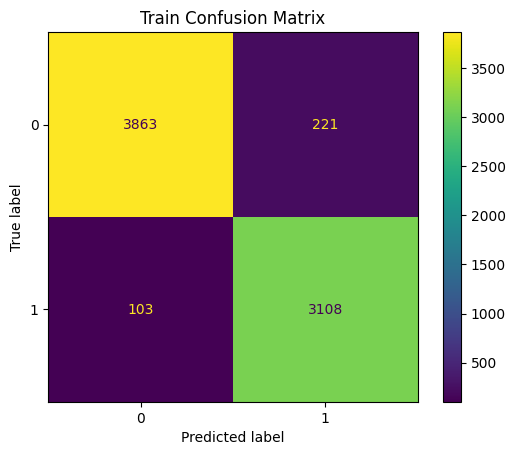

Validation Loss: 0.2133
Validation Accuracy: 0.9144
Validation Precision: 0.9016
Validation Recall: 0.8969
Validation F1 Score: 0.8992


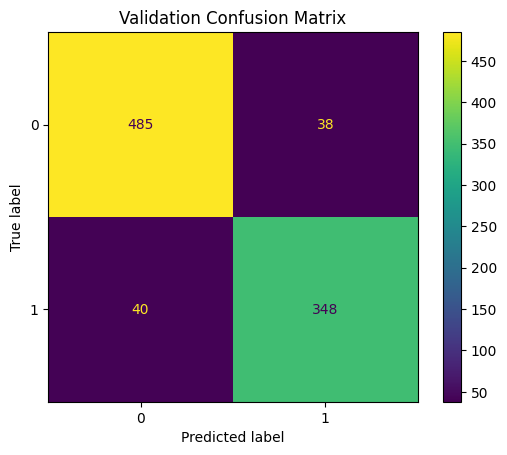

Epoch 5


Train Loss: 0.0551
Train Accuracy: 0.9819
Train Precision: 0.9661
Train Recall: 0.9938
Train F1 Score: 0.9797


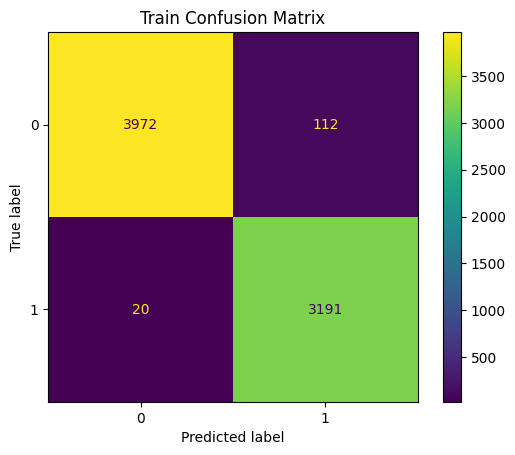

Validation Loss: 0.2176
Validation Accuracy: 0.9221
Validation Precision: 0.9013
Validation Recall: 0.9175
Validation F1 Score: 0.9093


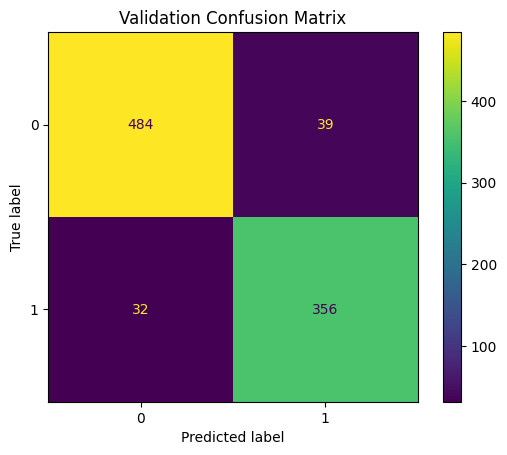

Epoch 6


Train Loss: 0.0604
Train Accuracy: 0.9766
Train Precision: 0.9932
Train Recall: 0.9533
Train F1 Score: 0.9728


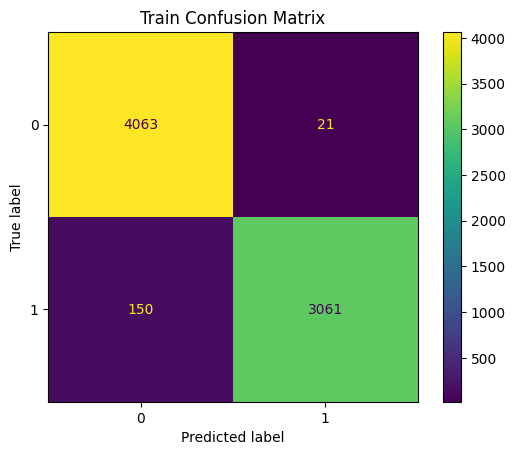

Validation Loss: 0.3251
Validation Accuracy: 0.9166
Validation Precision: 0.9588
Validation Recall: 0.8402
Validation F1 Score: 0.8956


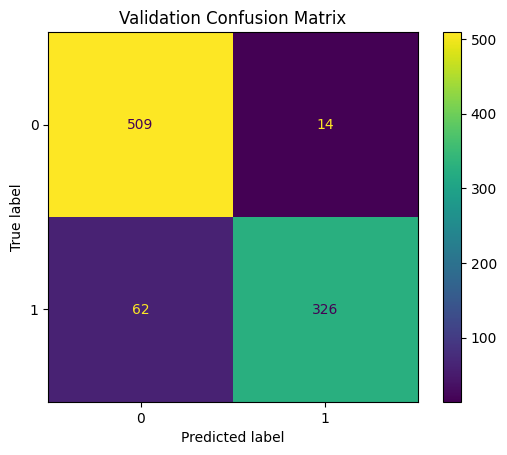

Epoch 7


Train Loss: 0.0369
Train Accuracy: 0.9893
Train Precision: 0.9863
Train Recall: 0.9894
Train F1 Score: 0.9879


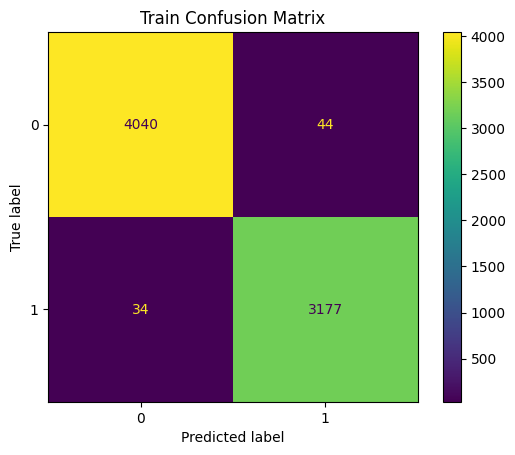

Validation Loss: 0.2634
Validation Accuracy: 0.9297
Validation Precision: 0.9263
Validation Recall: 0.9072
Validation F1 Score: 0.9167


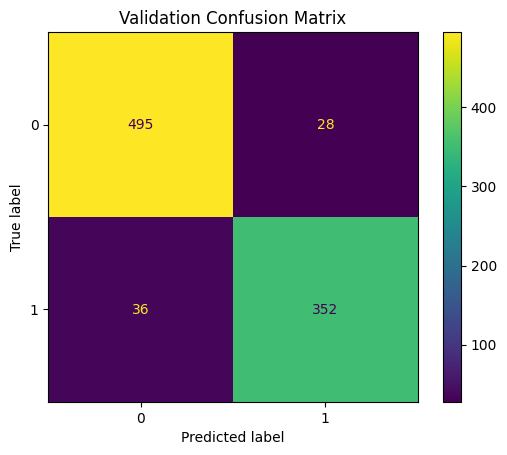

Epoch 8


Train Loss: 0.0304
Train Accuracy: 0.9888
Train Precision: 0.9783
Train Recall: 0.9966
Train F1 Score: 0.9873


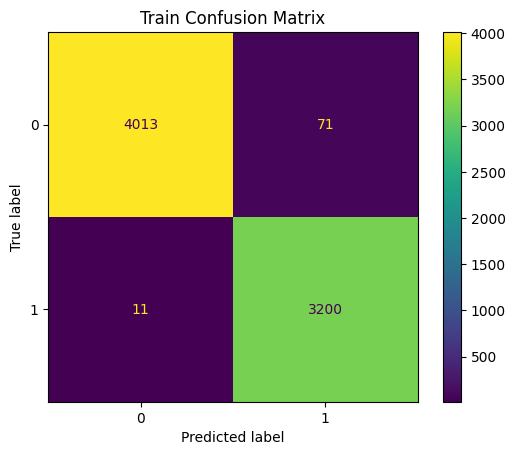

Validation Loss: 0.2832
Validation Accuracy: 0.9166
Validation Precision: 0.8900
Validation Recall: 0.9175
Validation F1 Score: 0.9036


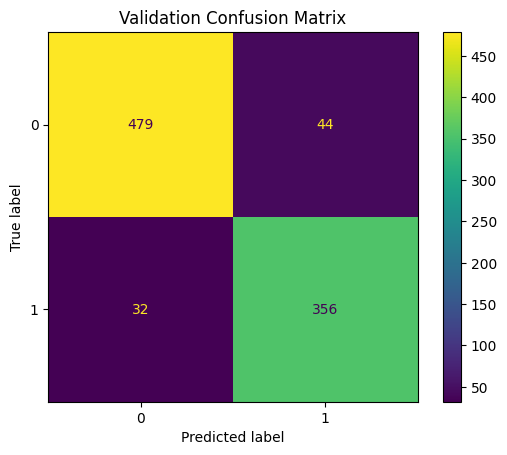

Epoch 9


Train Loss: 0.0238
Train Accuracy: 0.9914
Train Precision: 0.9910
Train Recall: 0.9894
Train F1 Score: 0.9902


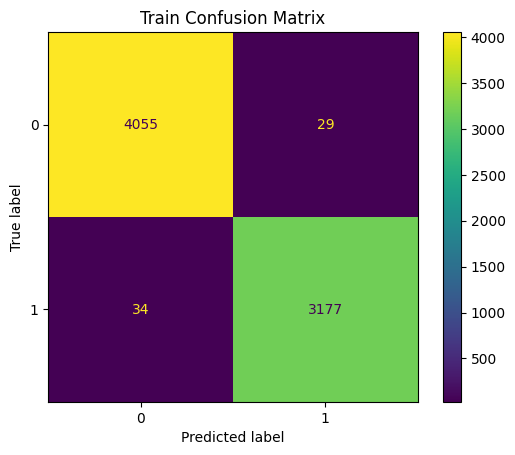

Validation Loss: 0.2715
Validation Accuracy: 0.9221
Validation Precision: 0.9249
Validation Recall: 0.8892
Validation F1 Score: 0.9067


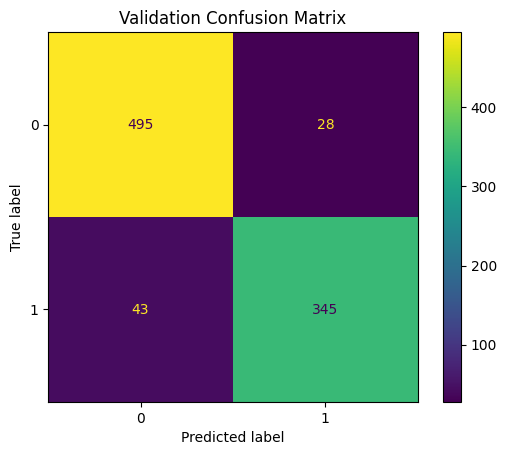

Epoch 10


Train Loss: 0.0156
Train Accuracy: 0.9944
Train Precision: 0.9969
Train Recall: 0.9903
Train F1 Score: 0.9936


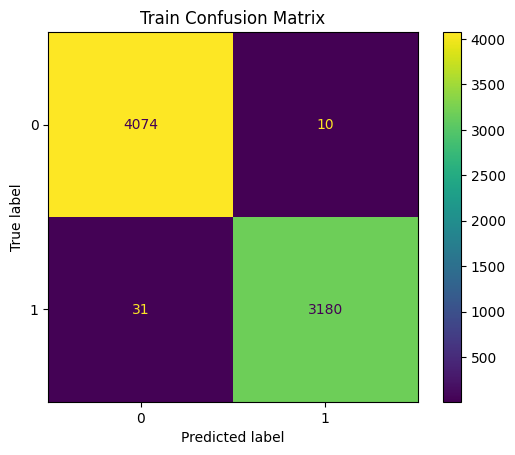

Validation Loss: 0.5321
Validation Accuracy: 0.9243
Validation Precision: 0.9493
Validation Recall: 0.8686
Validation F1 Score: 0.9071


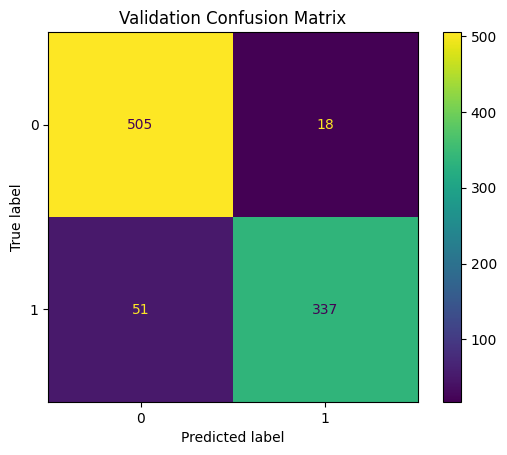

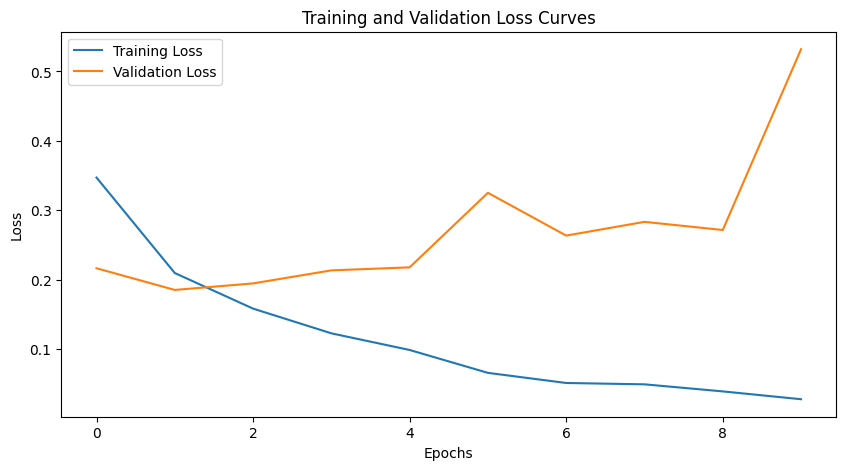

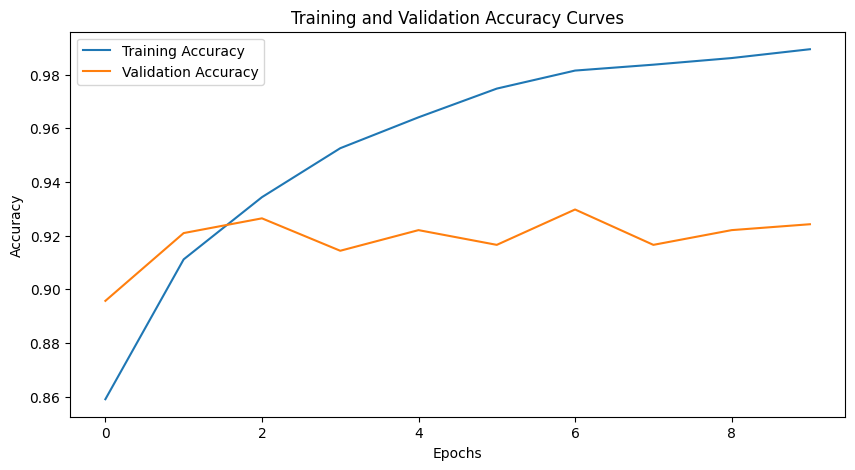

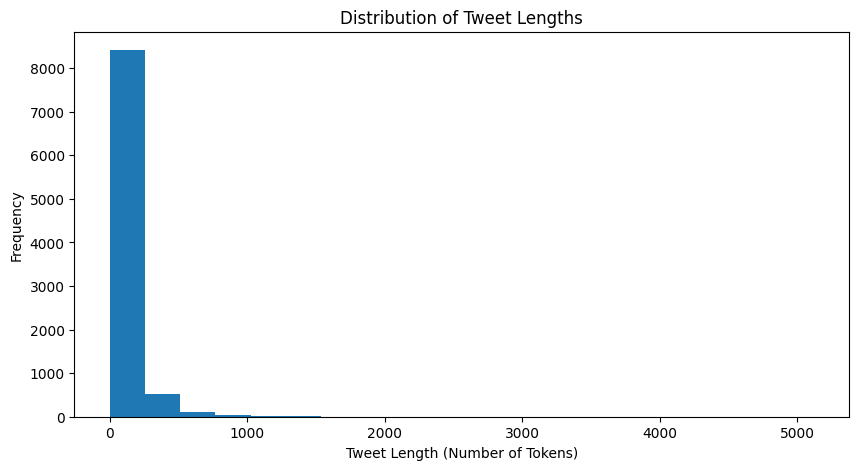

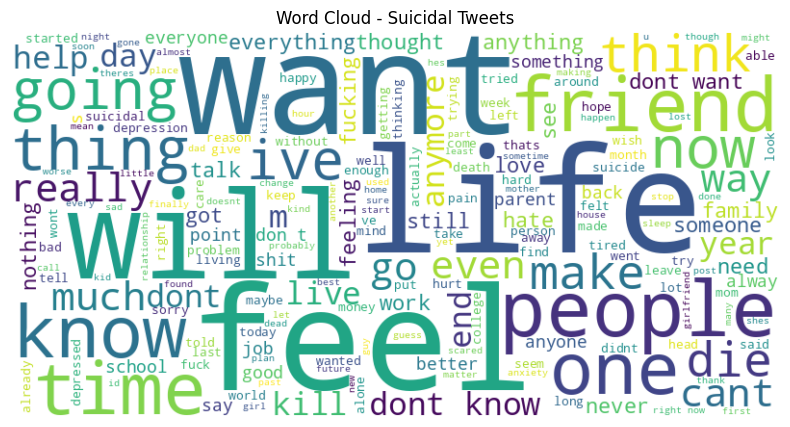

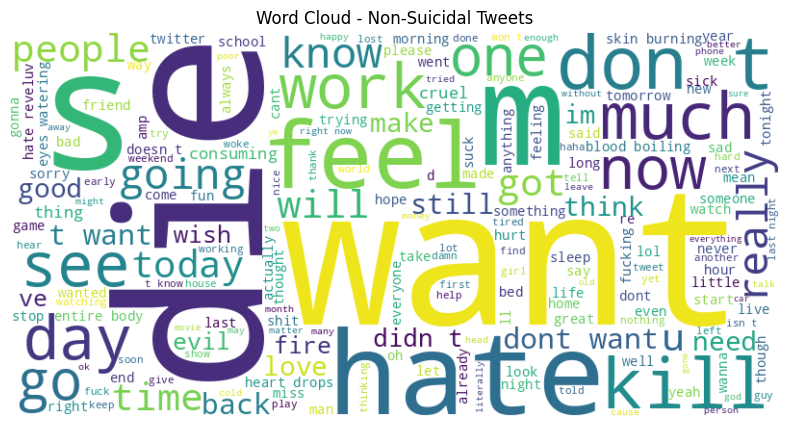

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from gensim.models import KeyedVectors
import nltk
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import string
from sklearn.metrics import ConfusionMatrixDisplay
from tqdm import tqdm
from wordcloud import WordCloud
from sklearn.manifold import TSNE

# 1. Data Preparation and Preprocessing
class TwitterDataset(Dataset):
    def __init__(self, data_path, word2vec_path):
        self.data = self.load_data(data_path)
        self.word2vec = KeyedVectors.load_word2vec_format(word2vec_path, binary=True)
        self.embedding = nn.Embedding.from_pretrained(torch.FloatTensor(self.word2vec.vectors))

    def load_data(self, data_path):
        data = pd.read_csv(data_path, encoding='utf-8')
        return data

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        tweet = self.data.iloc[idx]['tweet']
        intention = self.data.iloc[idx]['intention']
        tokens = nltk.word_tokenize(tweet)
        # Preprocess text
        processed_tokens = [token.lower() for token in tokens if token.isalpha()]
        stop_words = set(nltk.corpus.stopwords.words('english'))
        processed_tokens = [token for token in processed_tokens if token not in stop_words]
        # Convert tokens to word embeddings
        embeddings = [self.word2vec.get_vector(token)
                       for token in processed_tokens
                       if token in self.word2vec.key_to_index]
        # Handle missing words
        if len(embeddings) < len(processed_tokens):
            embeddings += [np.zeros(self.word2vec.vector_size)] * (len(processed_tokens) - len(embeddings))
        # Pad or truncate sequences
        max_length = 196  # Adjust if needed
        if len(embeddings) < max_length:
            embeddings += [np.zeros(self.word2vec.vector_size)] * (max_length - len(embeddings))
        else:
            embeddings = embeddings[:max_length]
        # Convert embeddings to float
        return torch.tensor(embeddings, dtype=torch.float), torch.tensor(intention)

# 2. CNN Model
class CNN(nn.Module):
    def __init__(self, embedding_dim, output_size):
        super(CNN, self).__init__()
        self.embedding_dim = embedding_dim
        self.output_size = output_size

        # Convolutional layers with dynamic padding
        self.conv1 = nn.Conv1d(embedding_dim, 64, kernel_size=3, padding='same')
        self.conv2 = nn.Conv1d(64, 64, kernel_size=5, padding='same')
        self.conv3 = nn.Conv1d(64, 64, kernel_size=7, padding='same')

        # Batch Normalization layers
        self.bn1 = nn.BatchNorm1d(64)
        self.bn2 = nn.BatchNorm1d(64)
        self.bn3 = nn.BatchNorm1d(64)

        # Activation function
        self.relu = nn.ReLU()

        # Max pooling layer
        self.maxpool = nn.MaxPool1d(kernel_size=2, stride=2)

        # Flatten layer
        self.flatten = nn.Flatten()

        # Linear layers
        self.fc1 = nn.Linear(128 * 147, 128)  # Adjusted input size
        self.fc2 = nn.Linear(128, output_size)

        # Dropout layer
        self.dropout = nn.Dropout(0.5)

    def forward(self, x):
        # Transpose the input
        x = x.transpose(1, 2)

        # Apply convolutional layers with Batch Normalization
        x1 = self.relu(self.bn1(self.conv1(x)))
        x2 = self.relu(self.bn2(self.conv2(x1)))
        x3 = self.relu(self.bn3(self.conv3(x2)))

        # Max pooling
        x1 = self.maxpool(x1)
        x2 = self.maxpool(x2)
        x3 = self.maxpool(x3)

        # Concatenate the output from different convolutional layers
        x = torch.cat([x1, x2, x3], dim=1)

        # Flatten the output
        x = self.flatten(x)

        # Apply linear layers with Dropout
        x = self.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.fc2(x)
        return x

# 3. Training and Evaluation
class Trainer:
    def __init__(self, model, optimizer, criterion, device):
        self.model = model
        self.optimizer = optimizer
        self.criterion = criterion
        self.device = device
        self.train_losses = []
        self.val_losses = []
        self.train_accuracies = []
        self.val_accuracies = []
        self.y_true = []
        self.y_pred = []

    def train_step(self, batch):
        self.model.train()
        self.optimizer.zero_grad()
        data, target = batch
        data = data.to(self.device)
        target = target.to(self.device)
        output = self.model(data)
        loss = self.criterion(output, target)
        loss.backward()
        self.optimizer.step()
        return loss.item(), output, target

    def train_epoch(self, train_loader):
        epoch_loss = 0
        correct = 0
        total = 0
        with tqdm(train_loader, unit='batch', leave=False) as tepoch:
            for batch in tepoch:
                loss, output, target = self.train_step(batch)
                epoch_loss += loss
                tepoch.set_description(f'Training Loss: {loss:.4f}')
                total += target.size(0)
                correct += (torch.argmax(output, dim=1) == target).sum().item()
        self.train_losses.append(epoch_loss / len(train_loader))
        self.train_accuracies.append(correct / total)

    def evaluate(self, data_loader, mode='Test'):
        self.model.eval()
        total_loss = 0
        correct = 0
        total = 0
        y_true = []
        y_pred = []

        with torch.no_grad():
            for batch in data_loader:
                data, target = batch
                data = data.to(self.device)
                target = target.to(self.device)
                output = self.model(data)
                loss = self.criterion(output, target)
                total_loss += loss.item()
                y_true.extend(target.tolist())
                y_pred.extend(torch.argmax(output, dim=1).tolist())
                total += target.size(0)
                correct += (torch.argmax(output, dim=1) == target).sum().item()

        accuracy = accuracy_score(y_true, y_pred)
        precision = precision_score(y_true, y_pred)
        recall = recall_score(y_true, y_pred)
        f1 = f1_score(y_true, y_pred)

        print(f'{mode} Loss: {total_loss/len(data_loader):.4f}')
        print(f'{mode} Accuracy: {accuracy:.4f}')
        print(f'{mode} Precision: {precision:.4f}')
        print(f'{mode} Recall: {recall:.4f}')
        print(f'{mode} F1 Score: {f1:.4f}')

        # Confusion matrix
        cm = confusion_matrix(y_true, y_pred)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm)
        disp.plot()
        plt.title(f'{mode} Confusion Matrix')
        plt.show()

        return total_loss/len(data_loader), accuracy, precision, recall, f1

    def train(self, train_loader, val_loader, epochs):
        for epoch in range(epochs):
            print(f"Epoch {epoch+1}")
            self.train_epoch(train_loader)
            _, _, _, _, _ = self.evaluate(train_loader, mode='Train')
            val_loss, val_accuracy, _, _, _ = self.evaluate(val_loader, mode='Validation')
            self.val_losses.append(val_loss)
            self.val_accuracies.append(val_accuracy)

            # Plot every 10 epochs
            if (epoch + 1) % 10 == 0:
                self.plot_metrics()

    def plot_metrics(self):
        # Plot training and validation loss
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses, label='Validation Loss')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss Curves')
        plt.legend()
        plt.show()

        # Plot training and validation accuracy
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_accuracies, label='Training Accuracy')
        plt.plot(self.val_accuracies, label='Validation Accuracy')
        plt.xlabel('Epochs')
        plt.ylabel('Accuracy')
        plt.title('Training and Validation Accuracy Curves')
        plt.legend()
        plt.show()

def run_experiment(batch_size, learning_rate):
    # Initialize model, optimizer, and loss function
    model = CNN(embedding_dim, output_size).to(device)
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    criterion = nn.CrossEntropyLoss() # Using Cross-Entropy Loss
    # Train the model
    trainer = Trainer(model, optimizer, criterion, device)
    trainer.train(train_loader, val_loader, epochs)

if __name__ == '__main__':
    # Define parameters
    data_path = 'twitter-suicidal-data.csv'
    word2vec_path = "/content/drive/MyDrive/Colab Notebooks/GoogleNews-vectors-negative300.bin"
    embedding_dim = 300
    output_size = 2
    epochs = 10
    # Load dataset
    dataset = TwitterDataset(data_path, word2vec_path)
    train_size = int(0.8 * len(dataset))
    val_size = int(0.1 * len(dataset))
    test_size = len(dataset) - train_size - val_size
    train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(dataset, [train_size, val_size, test_size])
    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)
    # Choose device (CPU or GPU if available)
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    # Experiment with different batch sizes and learning rates
    batch_sizes = [16, 32, 64]
    # learning_rates = [0.001, 0.0001, 0.00001]
    learning_rates = [0.001]
    for batch_size in batch_sizes:
        for learning_rate in learning_rates:
            print(f"Experiment with Batch Size: {batch_size}, Learning Rate: {learning_rate}")
            run_experiment(batch_size, learning_rate)

    # Additional Visualizations
    # Histogram of Tweet Lengths
    plt.figure(figsize=(10, 5))
    plt.hist([len(nltk.word_tokenize(tweet)) for tweet in dataset.data['tweet']], bins=20)
    plt.xlabel('Tweet Length (Number of Tokens)')
    plt.ylabel('Frequency')
    plt.title('Distribution of Tweet Lengths')
    plt.show()

    # Word Cloud
    suicidal_tweets = " ".join(dataset.data[dataset.data['intention'] == 1]['tweet'])
    non_suicidal_tweets = " ".join(dataset.data[dataset.data['intention'] == 0]['tweet'])

    wordcloud_suicidal = WordCloud(width=800, height=400, background_color='white').generate(suicidal_tweets)
    wordcloud_non_suicidal = WordCloud(width=800, height=400, background_color='white').generate(non_suicidal_tweets)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud_suicidal, interpolation='bilinear')
    plt.axis("off")
    plt.title('Word Cloud - Suicidal Tweets')
    plt.show()

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud_non_suicidal, interpolation='bilinear')
    plt.axis("off")
    plt.title('Word Cloud - Non-Suicidal Tweets')
    plt.show()

    # t-SNE Visualization of Embeddings
    embeddings = dataset.word2vec.vectors
    tsne = TSNE(n_components=2, random_state=42)
    embeddings_2d = tsne.fit_transform(embeddings)

    plt.figure(figsize=(10, 10))
    plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1])
    plt.title('t-SNE Visualization of Word Embeddings')
    plt.show()

### test

Experiment with Batch Size: 16, Learning Rate: 0.001
Epoch 1


  0%|          | 0/114 [00:00<?, ?batch/s]<ipython-input-9-8d676640dcdf>:53: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:274.)
  return torch.tensor(embeddings, dtype=torch.float), torch.tensor(intention)


Train Loss: 0.2106
Train Accuracy: 0.9080
Train Precision: 0.8960
Train Recall: 0.8918
Train F1 Score: 0.8939


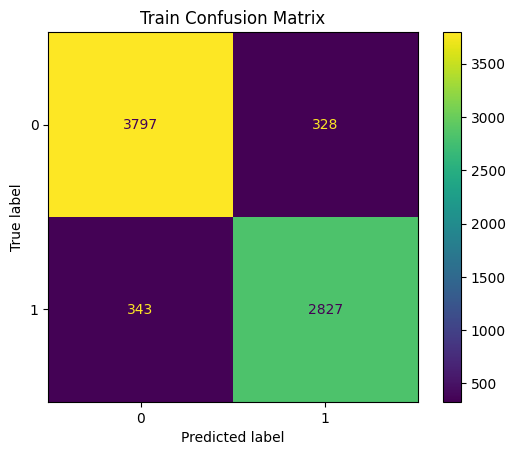

Validation Loss: 0.2278
Validation Accuracy: 0.9089
Validation Precision: 0.9043
Validation Recall: 0.8979
Validation F1 Score: 0.9011


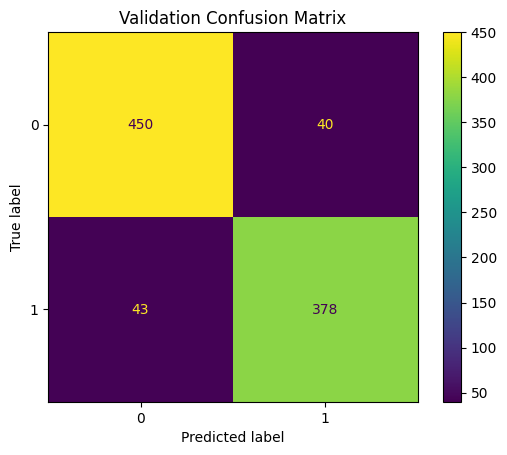

Epoch 2


Train Loss: 0.1870
Train Accuracy: 0.9034
Train Precision: 0.9897
Train Recall: 0.7858
Train F1 Score: 0.8760


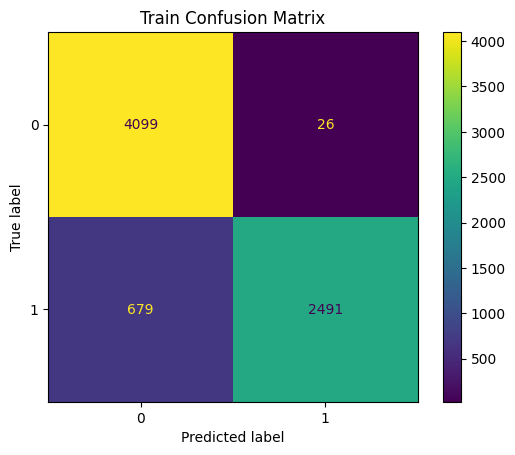

Validation Loss: 0.2412
Validation Accuracy: 0.8924
Validation Precision: 0.9764
Validation Recall: 0.7862
Validation F1 Score: 0.8711


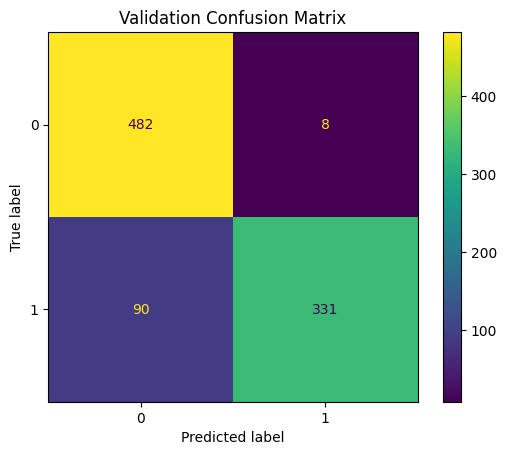

Epoch 3


Train Loss: 0.1377
Train Accuracy: 0.9453
Train Precision: 0.9746
Train Recall: 0.8975
Train F1 Score: 0.9345


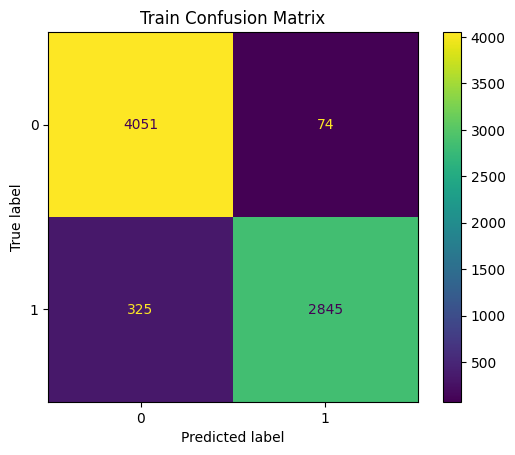

Validation Loss: 0.2077
Validation Accuracy: 0.9155
Validation Precision: 0.9343
Validation Recall: 0.8789
Validation F1 Score: 0.9058


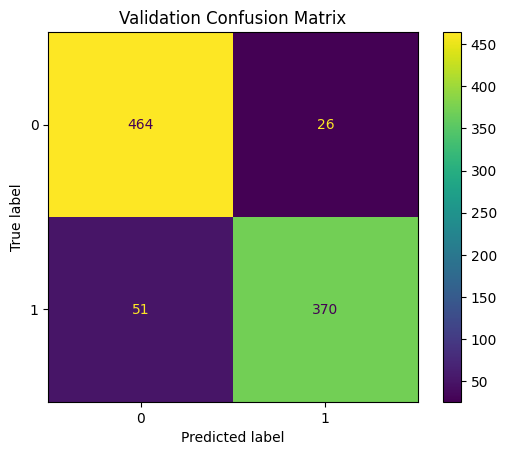

Epoch 4


Train Loss: 0.0842
Train Accuracy: 0.9700
Train Precision: 0.9567
Train Recall: 0.9751
Train F1 Score: 0.9658


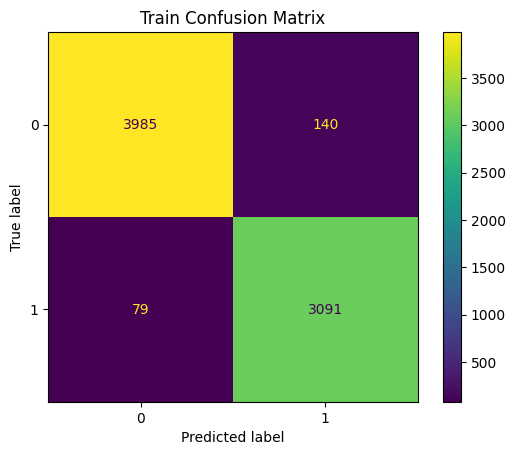

Validation Loss: 0.1818
Validation Accuracy: 0.9254
Validation Precision: 0.9021
Validation Recall: 0.9406
Validation F1 Score: 0.9209


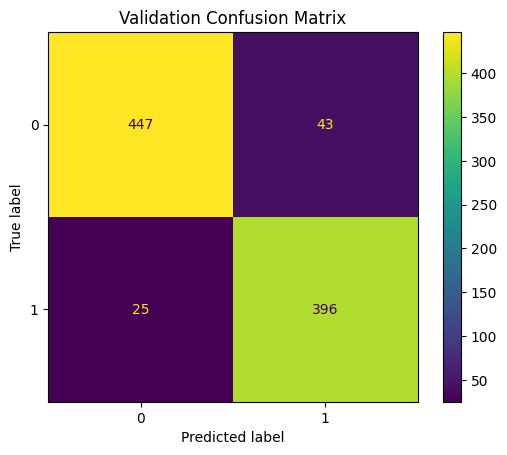

Epoch 5


Train Loss: 0.1425
Train Accuracy: 0.9490
Train Precision: 0.9011
Train Recall: 0.9915
Train F1 Score: 0.9441


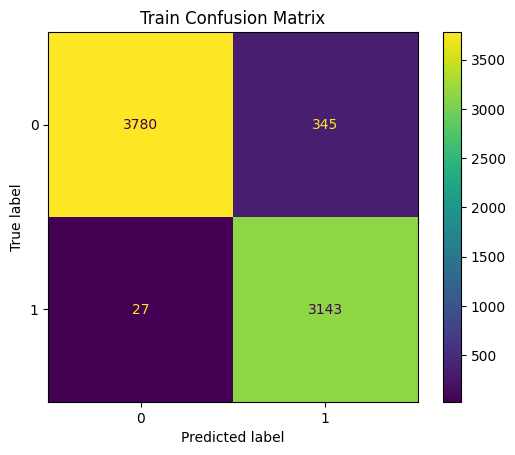

Validation Loss: 0.3594
Validation Accuracy: 0.8968
Validation Precision: 0.8428
Validation Recall: 0.9549
Validation F1 Score: 0.8953


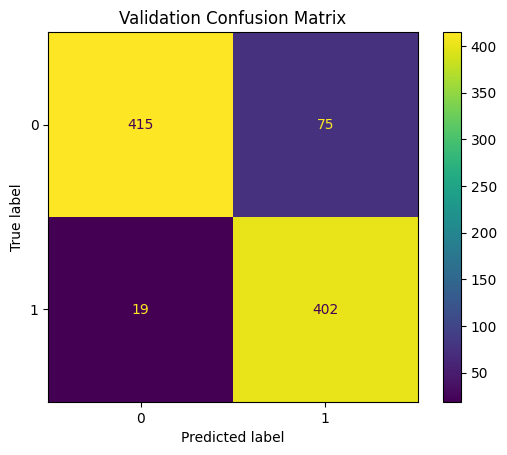

Epoch 6


Train Loss: 0.0360
Train Accuracy: 0.9896
Train Precision: 0.9939
Train Recall: 0.9820
Train F1 Score: 0.9879


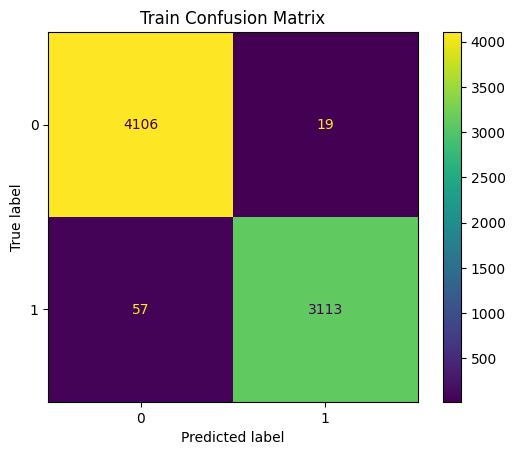

Validation Loss: 0.2752
Validation Accuracy: 0.9243
Validation Precision: 0.9356
Validation Recall: 0.8979
Validation F1 Score: 0.9164


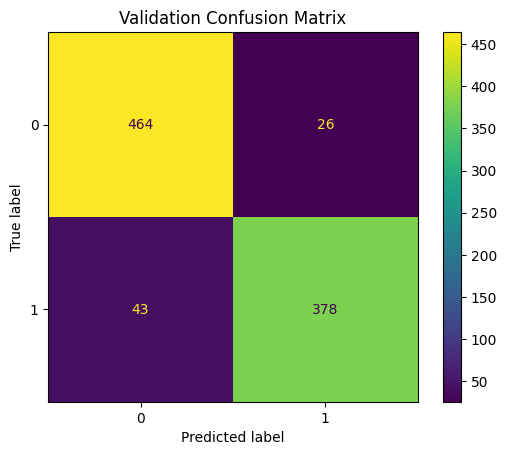

Epoch 7


Train Loss: 0.0336
Train Accuracy: 0.9926
Train Precision: 0.9851
Train Recall: 0.9981
Train F1 Score: 0.9915


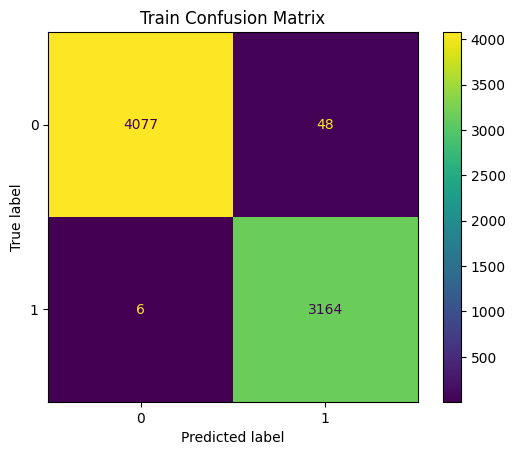

Validation Loss: 0.2506
Validation Accuracy: 0.9144
Validation Precision: 0.8998
Validation Recall: 0.9169
Validation F1 Score: 0.9082


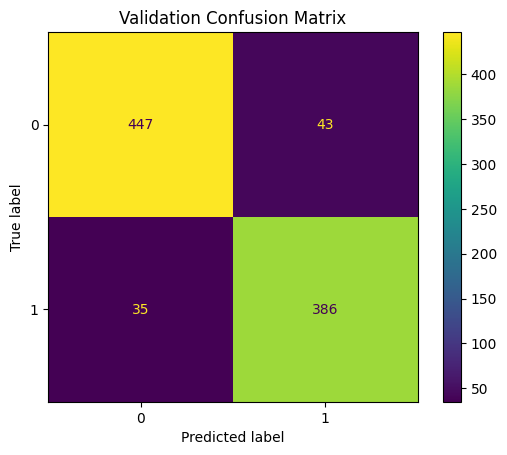

Epoch 8


Train Loss: 0.0904
Train Accuracy: 0.9687
Train Precision: 0.9950
Train Recall: 0.9328
Train F1 Score: 0.9629


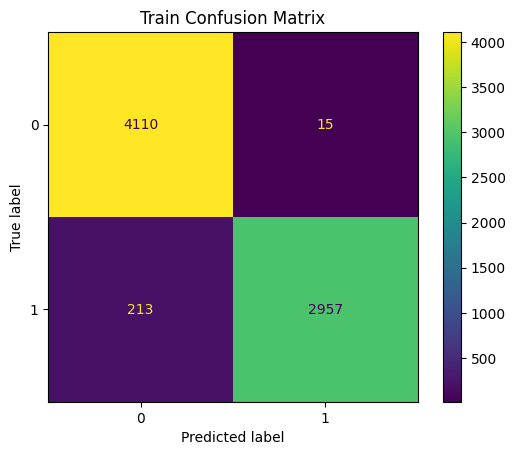

Validation Loss: 0.5885
Validation Accuracy: 0.9056
Validation Precision: 0.9491
Validation Recall: 0.8409
Validation F1 Score: 0.8917


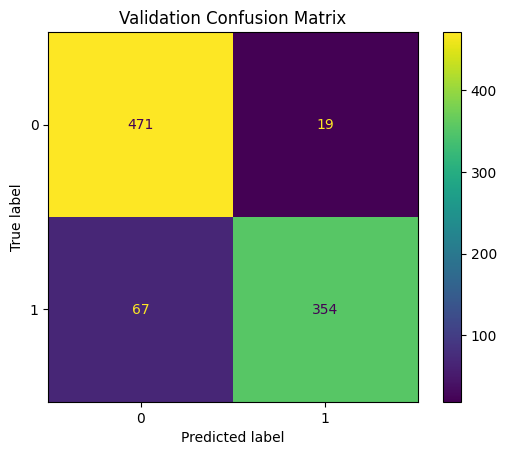

Epoch 9


Train Loss: 0.0688
Train Accuracy: 0.9741
Train Precision: 0.9967
Train Recall: 0.9435
Train F1 Score: 0.9694


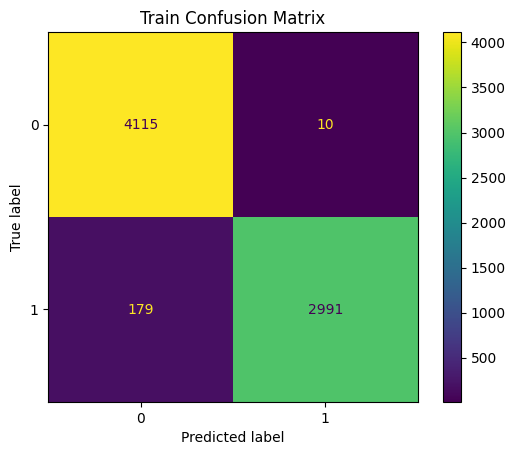

Validation Loss: 0.5094
Validation Accuracy: 0.9144
Validation Precision: 0.9623
Validation Recall: 0.8480
Validation F1 Score: 0.9015


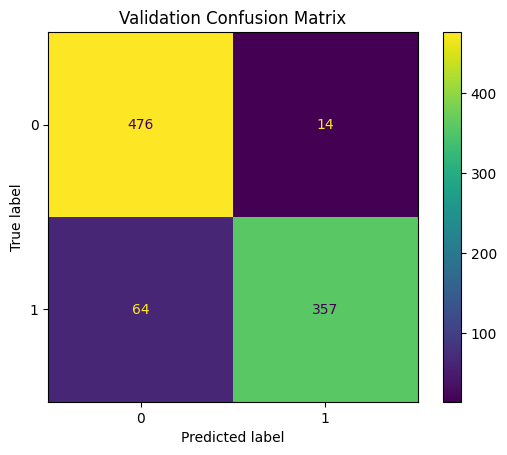

Epoch 10


Train Loss: 0.0807
Train Accuracy: 0.9708
Train Precision: 0.9383
Train Recall: 0.9984
Train F1 Score: 0.9674


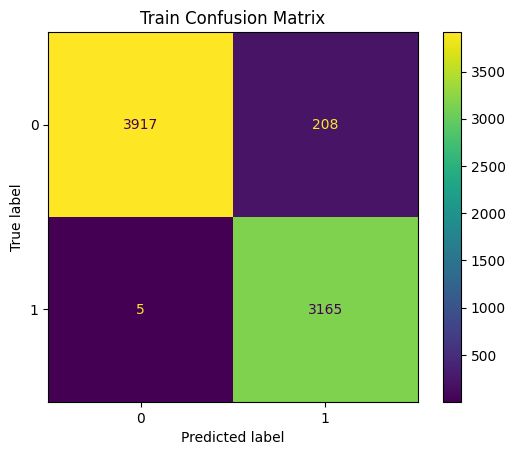

Validation Loss: 0.4738
Validation Accuracy: 0.8946
Validation Precision: 0.8337
Validation Recall: 0.9644
Validation F1 Score: 0.8943


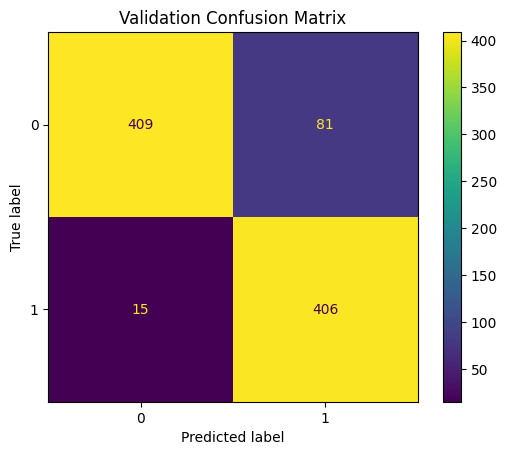

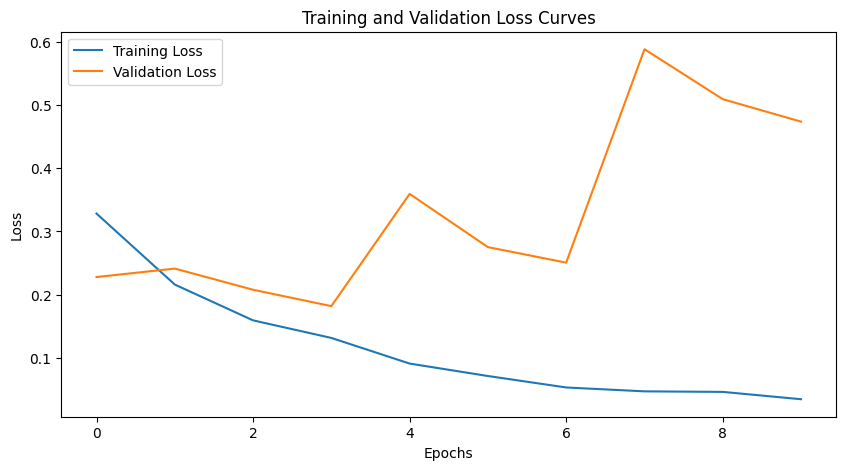

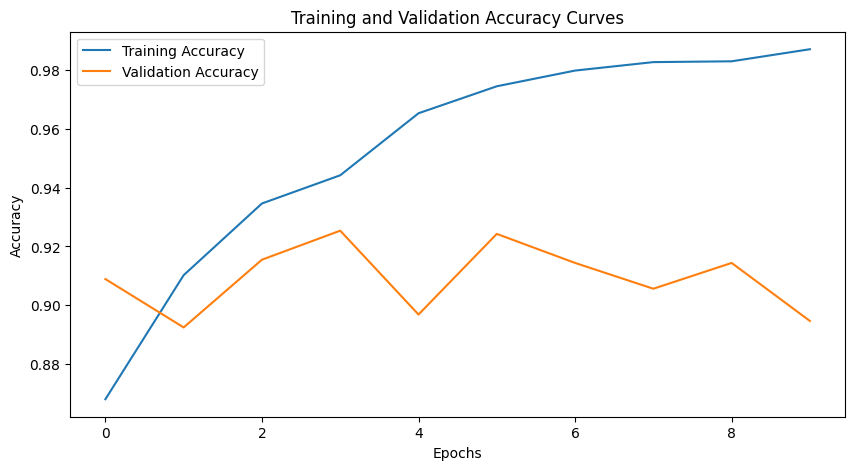

Experiment with Batch Size: 32, Learning Rate: 0.001
Epoch 1


Train Loss: 0.1812
Train Accuracy: 0.9205
Train Precision: 0.9423
Train Recall: 0.8703
Train F1 Score: 0.9049


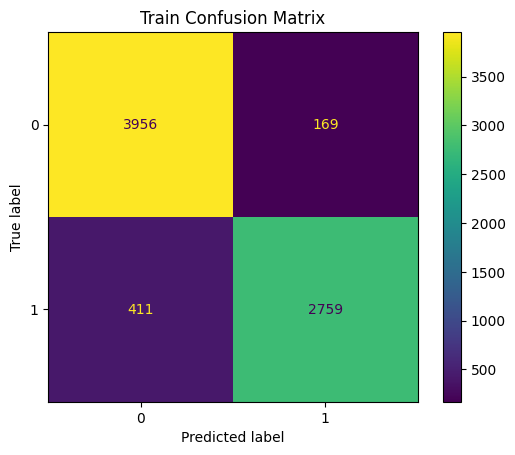

Validation Loss: 0.2130
Validation Accuracy: 0.9089
Validation Precision: 0.9401
Validation Recall: 0.8575
Validation F1 Score: 0.8969


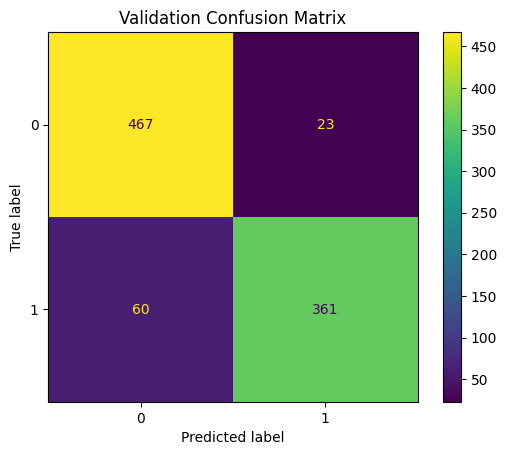

Epoch 2


Train Loss: 0.1343
Train Accuracy: 0.9493
Train Precision: 0.9648
Train Recall: 0.9167
Train F1 Score: 0.9401


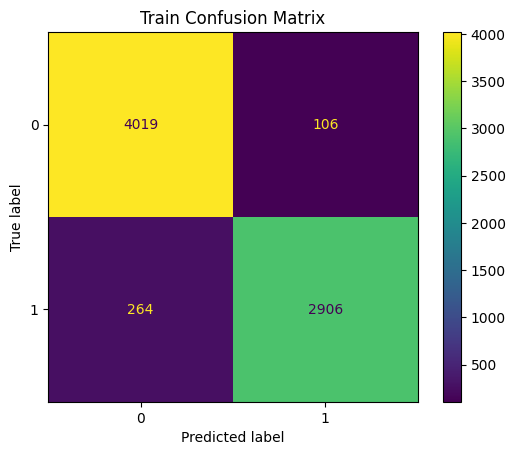

Validation Loss: 0.2014
Validation Accuracy: 0.9155
Validation Precision: 0.9257
Validation Recall: 0.8884
Validation F1 Score: 0.9067


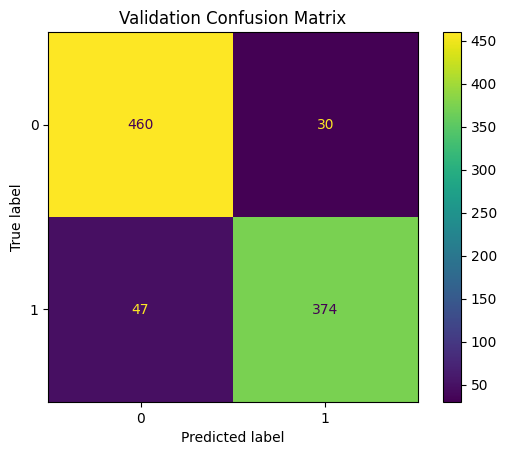

Epoch 3


Train Loss: 0.1088
Train Accuracy: 0.9619
Train Precision: 0.9348
Train Recall: 0.9808
Train F1 Score: 0.9572


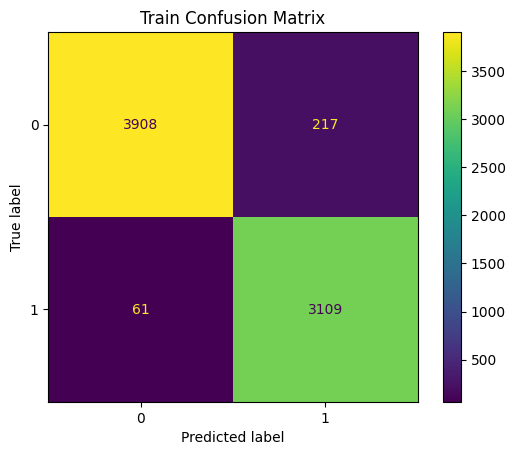

Validation Loss: 0.2298
Validation Accuracy: 0.9012
Validation Precision: 0.8686
Validation Recall: 0.9264
Validation F1 Score: 0.8966


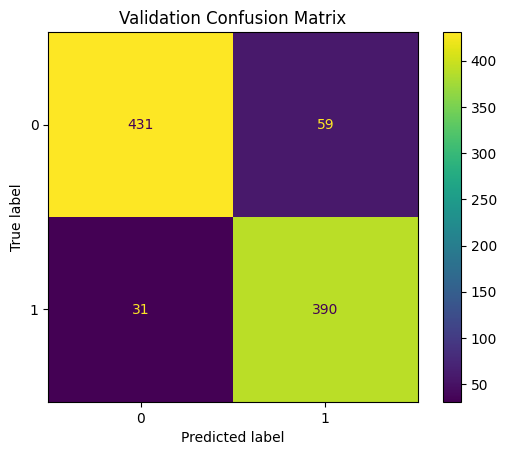

Epoch 4


Train Loss: 0.0898
Train Accuracy: 0.9623
Train Precision: 0.9912
Train Recall: 0.9215
Train F1 Score: 0.9550


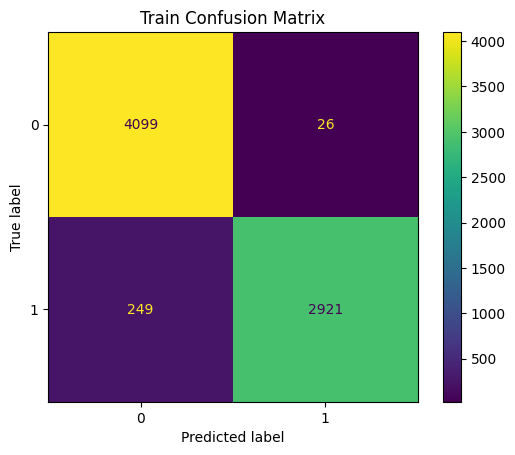

Validation Loss: 0.2628
Validation Accuracy: 0.9155
Validation Precision: 0.9649
Validation Recall: 0.8480
Validation F1 Score: 0.9027


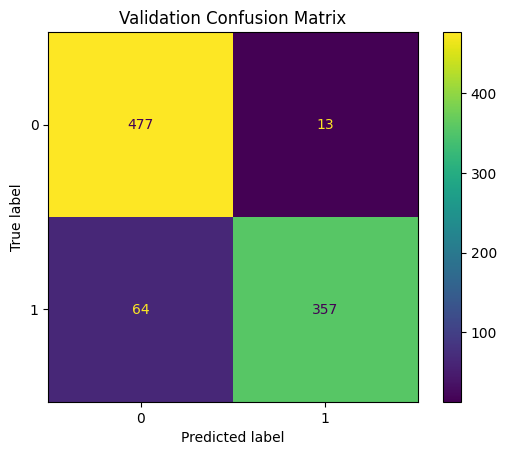

Epoch 5


Train Loss: 0.0455
Train Accuracy: 0.9844
Train Precision: 0.9860
Train Recall: 0.9779
Train F1 Score: 0.9819


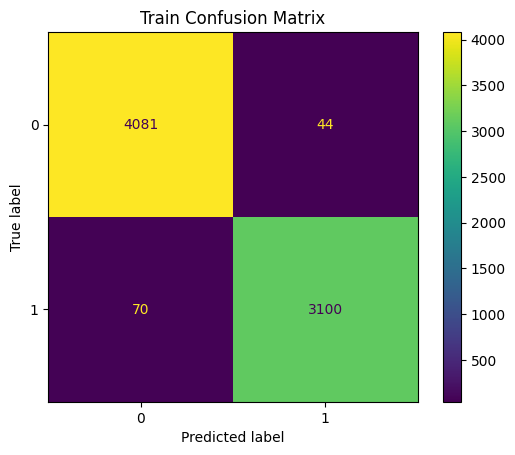

Validation Loss: 0.2785
Validation Accuracy: 0.9243
Validation Precision: 0.9335
Validation Recall: 0.9002
Validation F1 Score: 0.9166


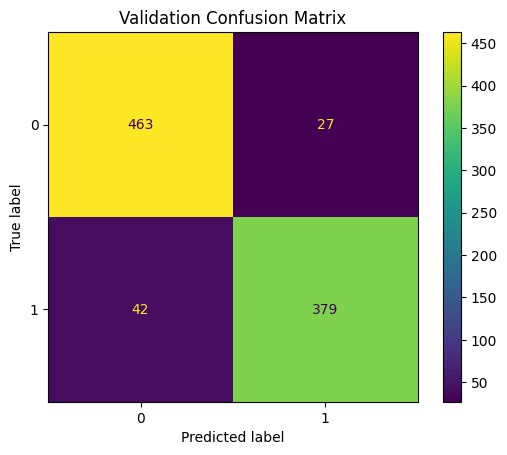

Epoch 6


Train Loss: 0.0599
Train Accuracy: 0.9724
Train Precision: 0.9963
Train Recall: 0.9401
Train F1 Score: 0.9674


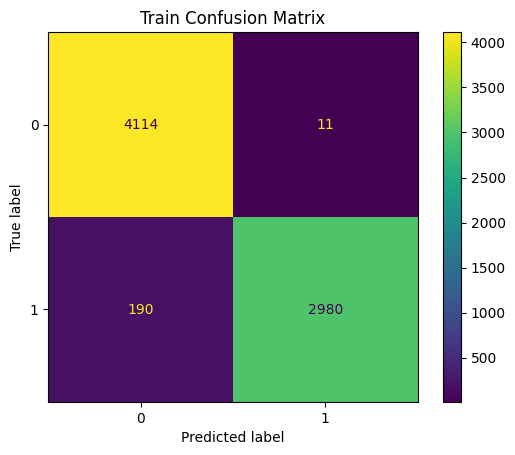

Validation Loss: 0.2466
Validation Accuracy: 0.9232
Validation Precision: 0.9655
Validation Recall: 0.8646
Validation F1 Score: 0.9123


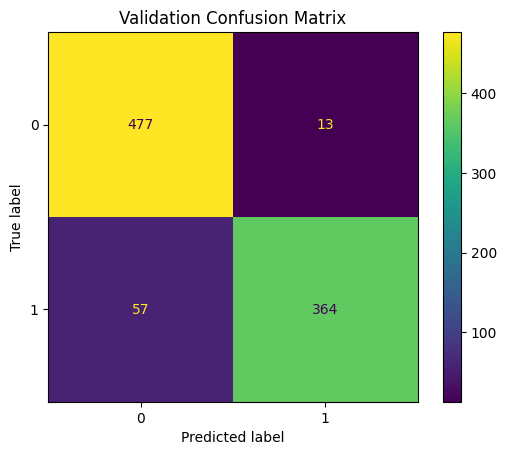

Epoch 7


Train Loss: 0.0268
Train Accuracy: 0.9915
Train Precision: 0.9856
Train Recall: 0.9950
Train F1 Score: 0.9903


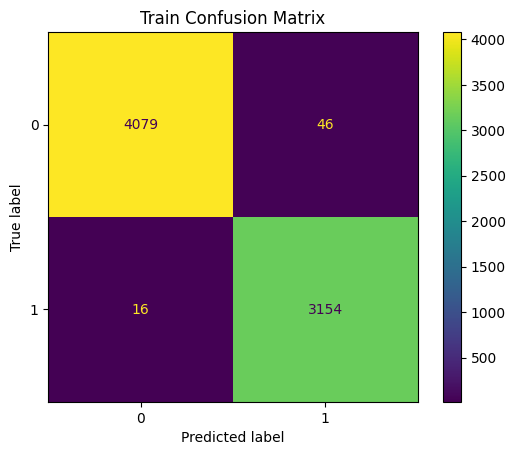

Validation Loss: 0.3088
Validation Accuracy: 0.9188
Validation Precision: 0.9007
Validation Recall: 0.9264
Validation F1 Score: 0.9133


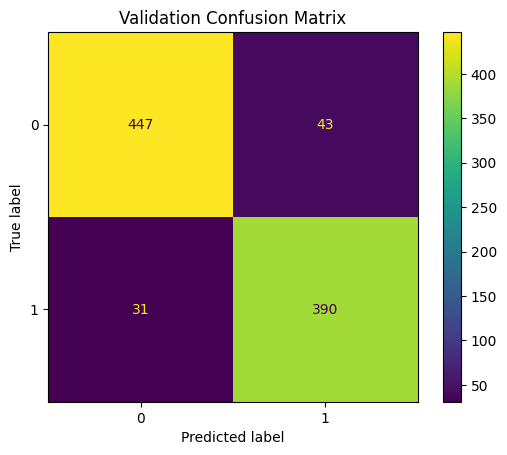

Epoch 8


Train Loss: 0.0392
Train Accuracy: 0.9853
Train Precision: 0.9955
Train Recall: 0.9707
Train F1 Score: 0.9829


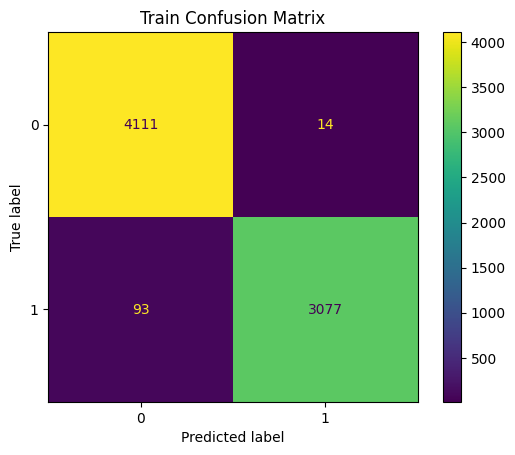

Validation Loss: 0.4058
Validation Accuracy: 0.9067
Validation Precision: 0.9492
Validation Recall: 0.8432
Validation F1 Score: 0.8931


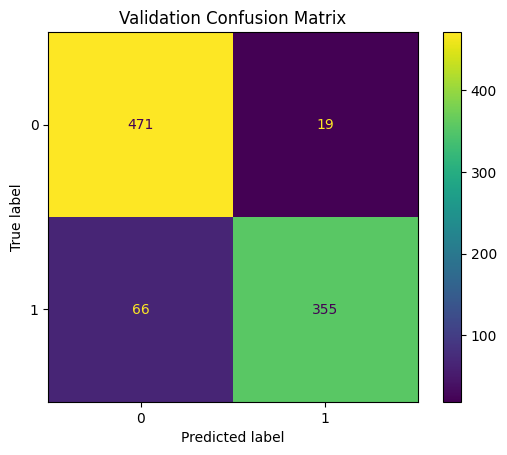

Epoch 9


Train Loss: 0.0473
Train Accuracy: 0.9805
Train Precision: 0.9970
Train Recall: 0.9580
Train F1 Score: 0.9772


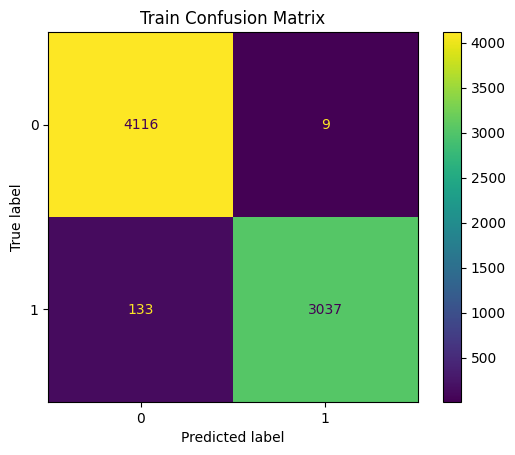

Validation Loss: 0.4732
Validation Accuracy: 0.9100
Validation Precision: 0.9593
Validation Recall: 0.8409
Validation F1 Score: 0.8962


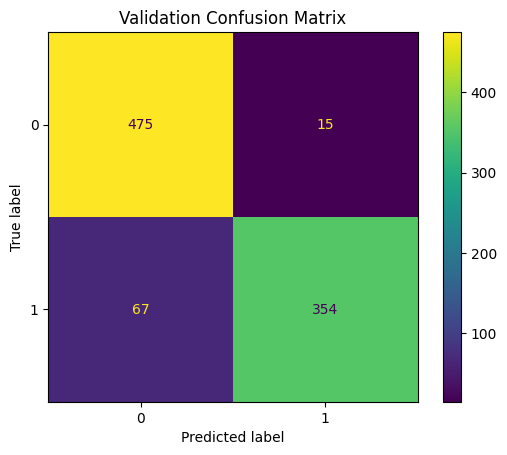

Epoch 10


Train Loss: 0.0097
Train Accuracy: 0.9973
Train Precision: 0.9962
Train Recall: 0.9975
Train F1 Score: 0.9968


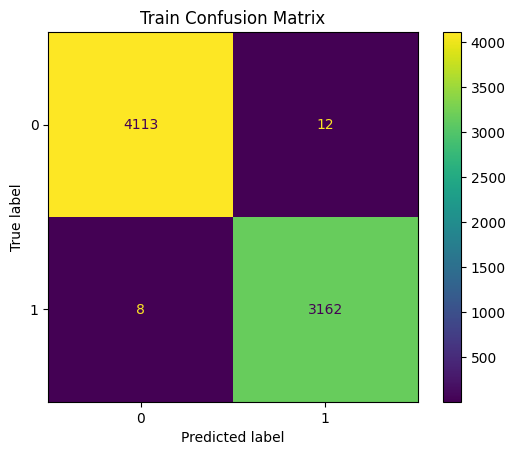

Validation Loss: 0.4457
Validation Accuracy: 0.9286
Validation Precision: 0.9384
Validation Recall: 0.9050
Validation F1 Score: 0.9214


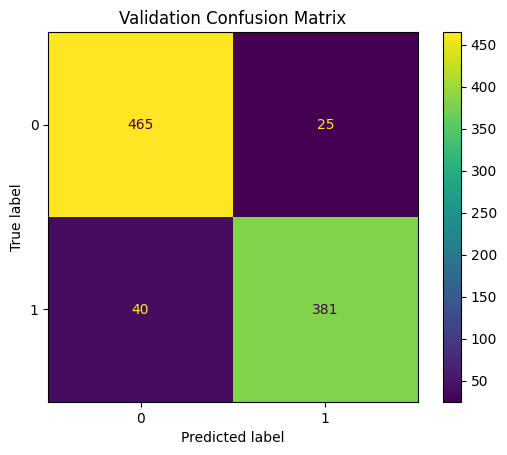

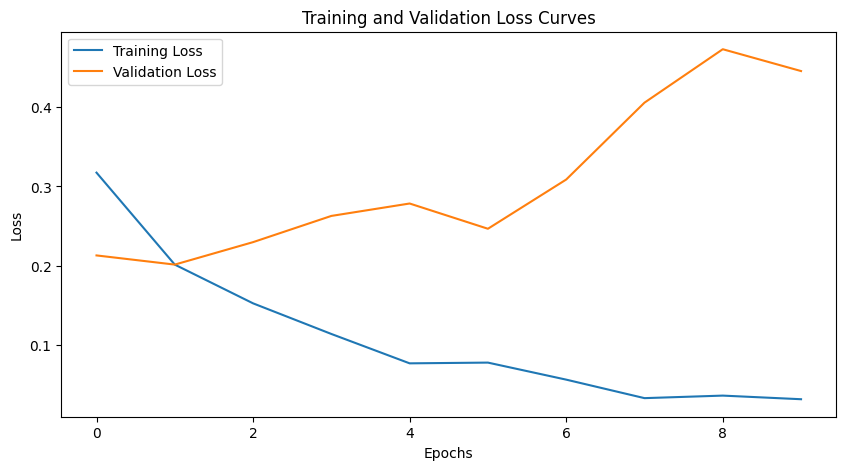

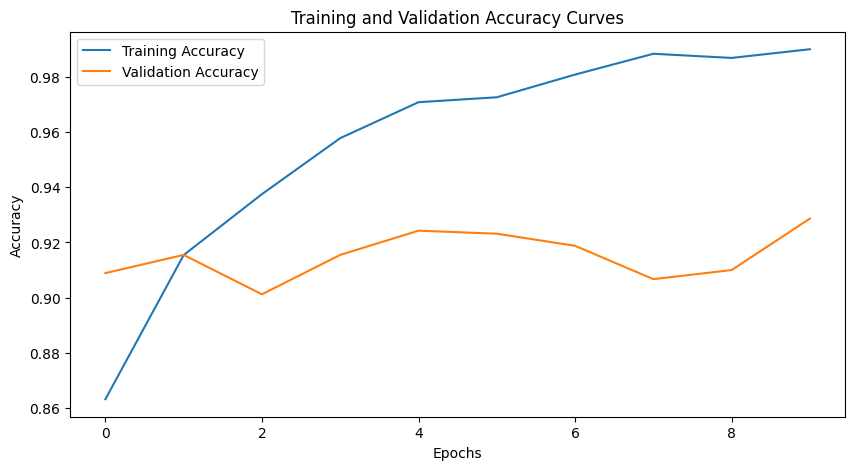

Experiment with Batch Size: 64, Learning Rate: 0.001
Epoch 1


Train Loss: 0.1911
Train Accuracy: 0.9146
Train Precision: 0.9196
Train Recall: 0.8804
Train F1 Score: 0.8996


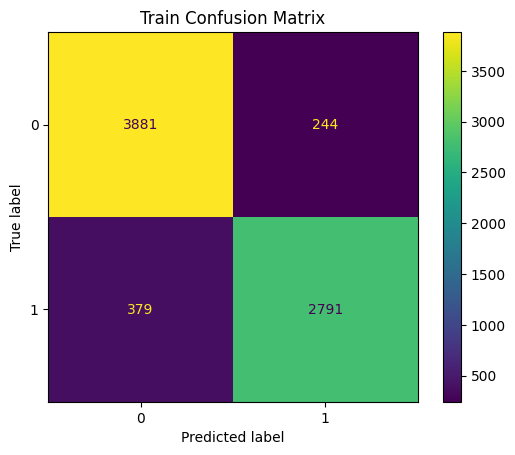

Validation Loss: 0.2207
Validation Accuracy: 0.9001
Validation Precision: 0.9005
Validation Recall: 0.8812
Validation F1 Score: 0.8908


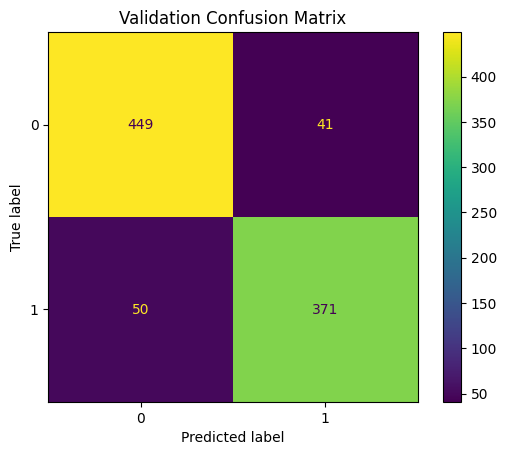

Epoch 2


Train Loss: 0.1778
Train Accuracy: 0.9102
Train Precision: 0.9941
Train Recall: 0.7981
Train F1 Score: 0.8854


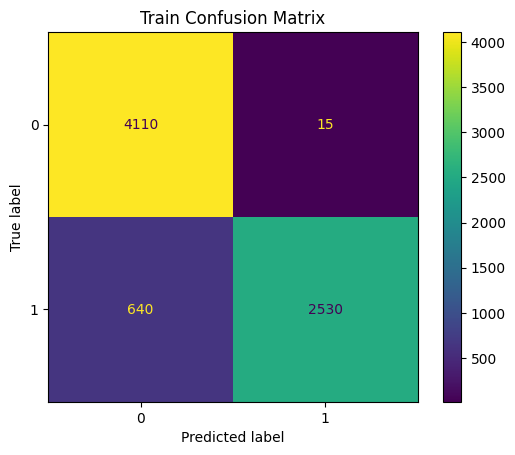

Validation Loss: 0.2467
Validation Accuracy: 0.8935
Validation Precision: 0.9880
Validation Recall: 0.7791
Validation F1 Score: 0.8712


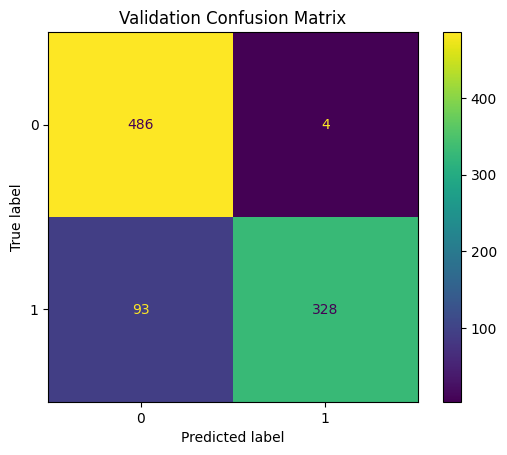

Epoch 3


Train Loss: 0.1067
Train Accuracy: 0.9560
Train Precision: 0.9395
Train Recall: 0.9606
Train F1 Score: 0.9499


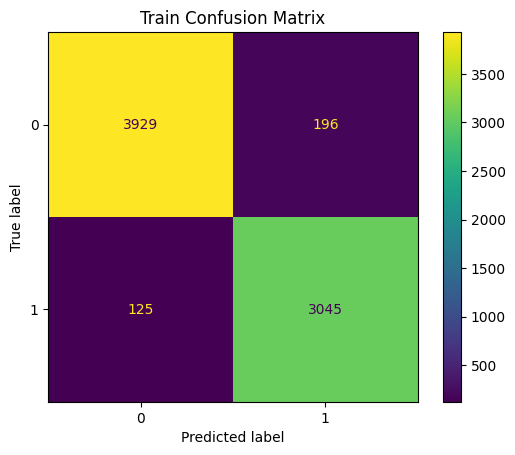

Validation Loss: 0.2077
Validation Accuracy: 0.9177
Validation Precision: 0.8932
Validation Recall: 0.9335
Validation F1 Score: 0.9129


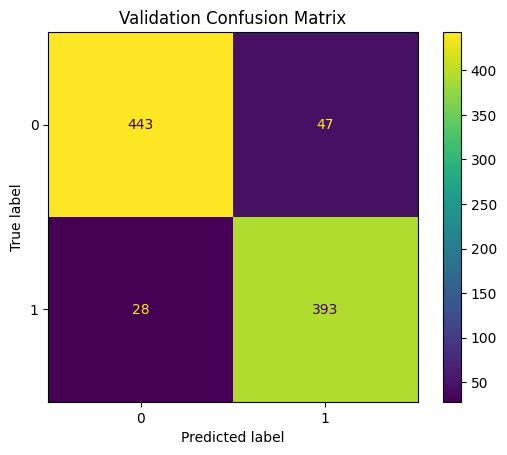

Epoch 4


Train Loss: 0.0672
Train Accuracy: 0.9767
Train Precision: 0.9873
Train Recall: 0.9587
Train F1 Score: 0.9728


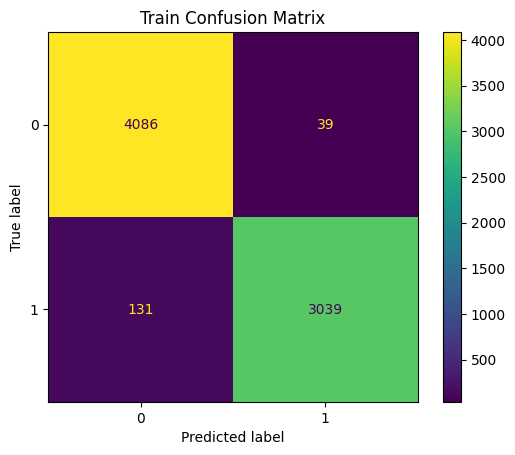

Validation Loss: 0.2055
Validation Accuracy: 0.9308
Validation Precision: 0.9387
Validation Recall: 0.9097
Validation F1 Score: 0.9240


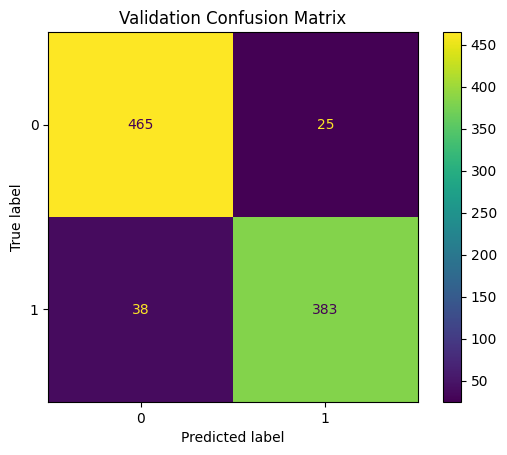

Epoch 5


Train Loss: 0.0588
Train Accuracy: 0.9789
Train Precision: 0.9824
Train Recall: 0.9688
Train F1 Score: 0.9755


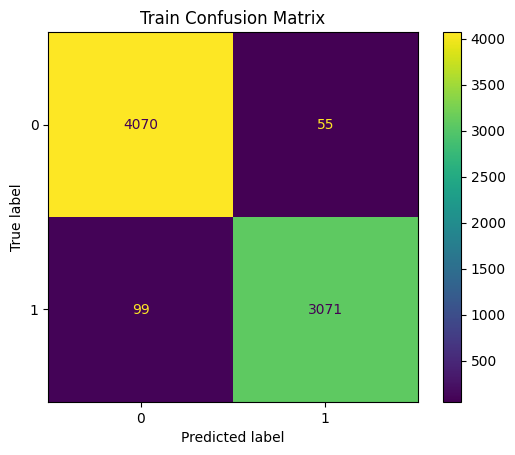

Validation Loss: 0.2588
Validation Accuracy: 0.9221
Validation Precision: 0.9207
Validation Recall: 0.9097
Validation F1 Score: 0.9152


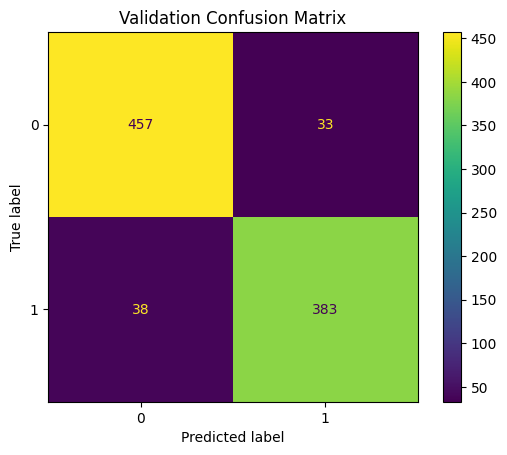

Epoch 6


Train Loss: 0.0509
Train Accuracy: 0.9825
Train Precision: 0.9677
Train Recall: 0.9927
Train F1 Score: 0.9801


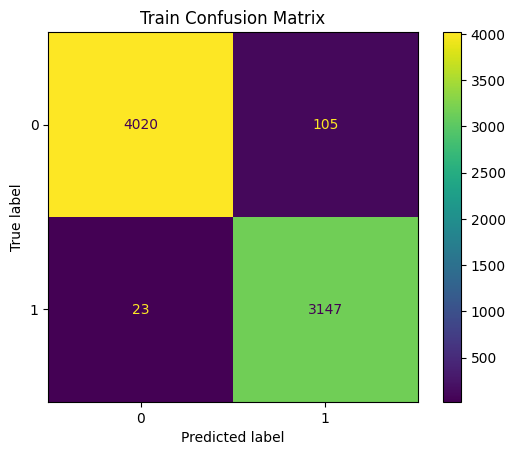

Validation Loss: 0.2303
Validation Accuracy: 0.9177
Validation Precision: 0.8827
Validation Recall: 0.9477
Validation F1 Score: 0.9141


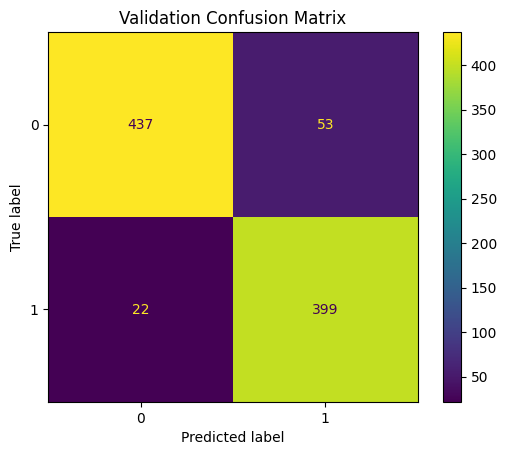

Epoch 7


Train Loss: 0.0314
Train Accuracy: 0.9915
Train Precision: 0.9875
Train Recall: 0.9931
Train F1 Score: 0.9902


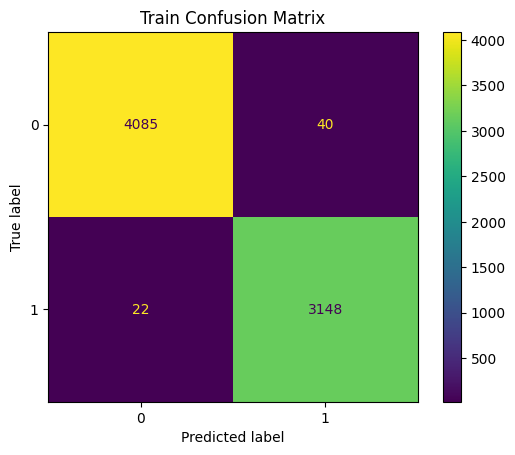

Validation Loss: 0.3205
Validation Accuracy: 0.9188
Validation Precision: 0.9181
Validation Recall: 0.9050
Validation F1 Score: 0.9115


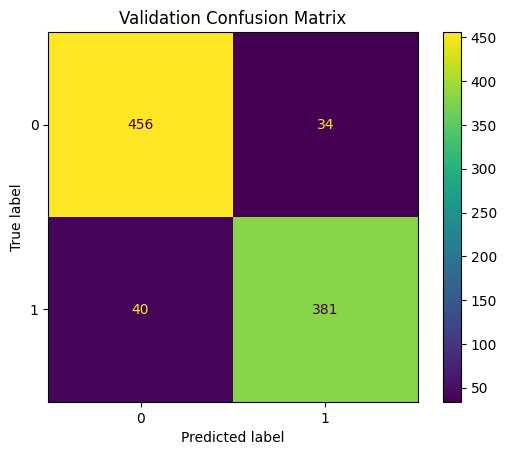

Epoch 8


Train Loss: 0.1113
Train Accuracy: 0.9619
Train Precision: 0.9966
Train Recall: 0.9155
Train F1 Score: 0.9543


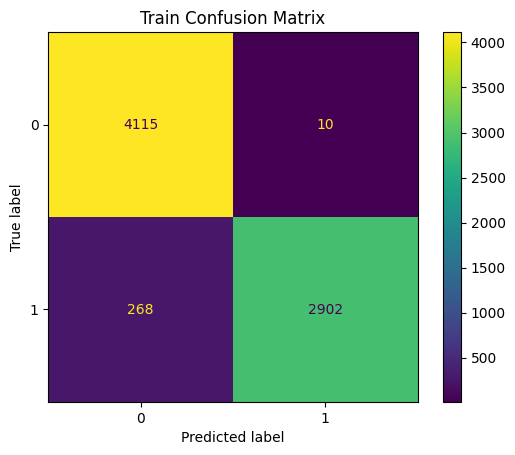

Validation Loss: 0.6292
Validation Accuracy: 0.9012
Validation Precision: 0.9688
Validation Recall: 0.8124
Validation F1 Score: 0.8837


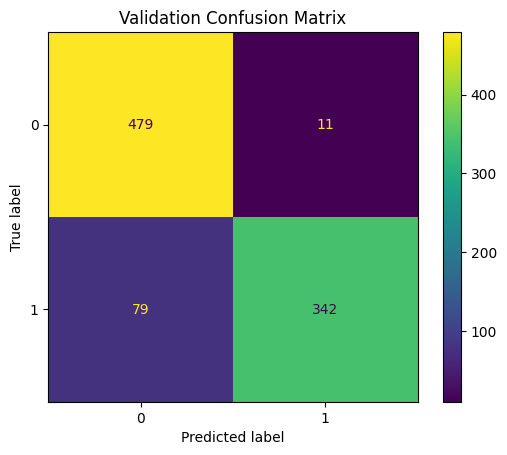

Epoch 9


Train Loss: 0.0283
Train Accuracy: 0.9915
Train Precision: 0.9955
Train Recall: 0.9849
Train F1 Score: 0.9902


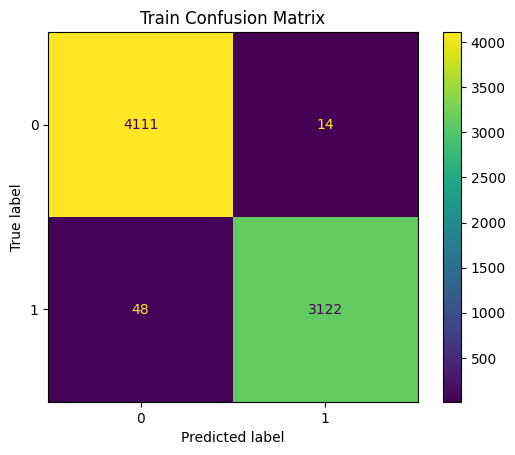

Validation Loss: 0.3072
Validation Accuracy: 0.9254
Validation Precision: 0.9380
Validation Recall: 0.8979
Validation F1 Score: 0.9175


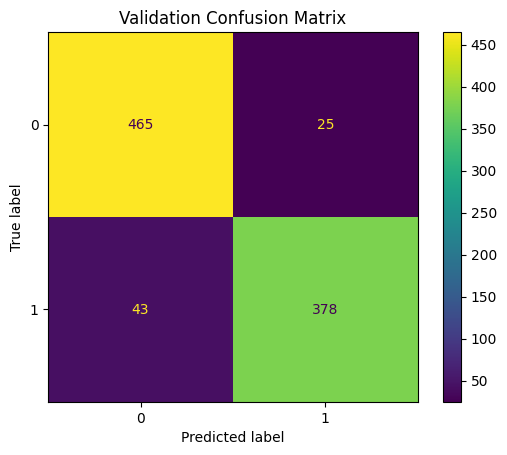

Epoch 10


Train Loss: 0.0126
Train Accuracy: 0.9960
Train Precision: 0.9934
Train Recall: 0.9975
Train F1 Score: 0.9954


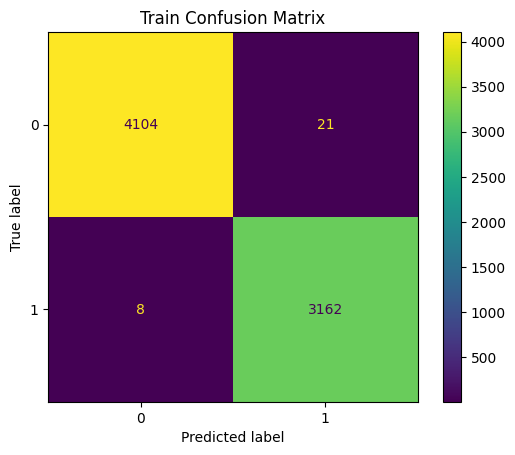

Validation Loss: 0.4054
Validation Accuracy: 0.9276
Validation Precision: 0.9196
Validation Recall: 0.9240
Validation F1 Score: 0.9218


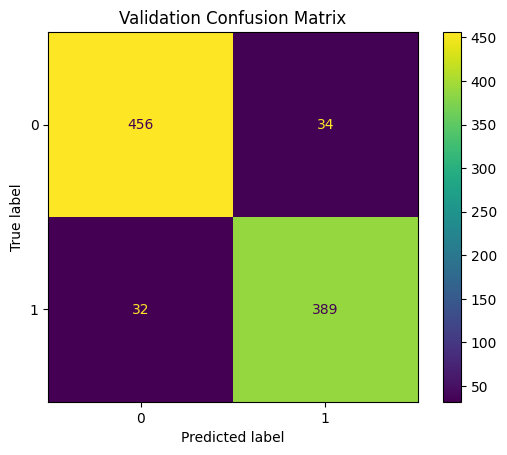

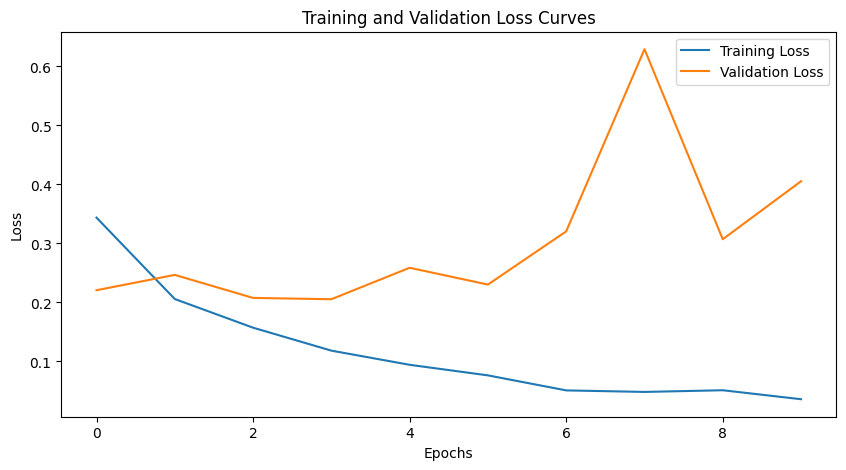

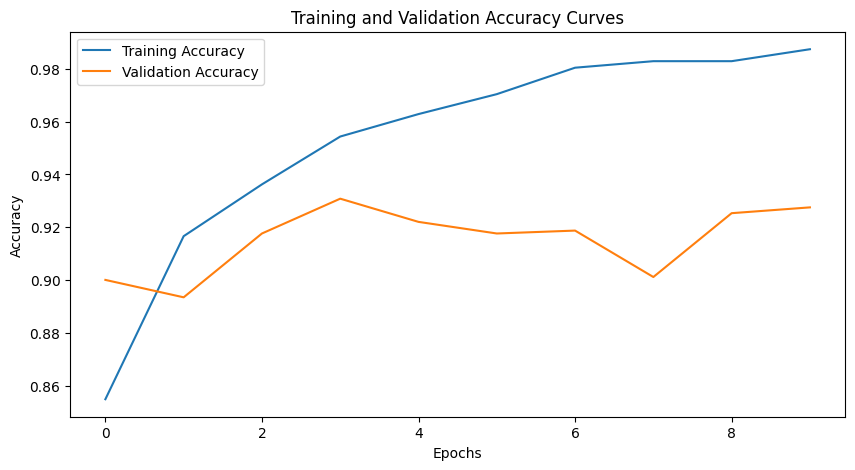

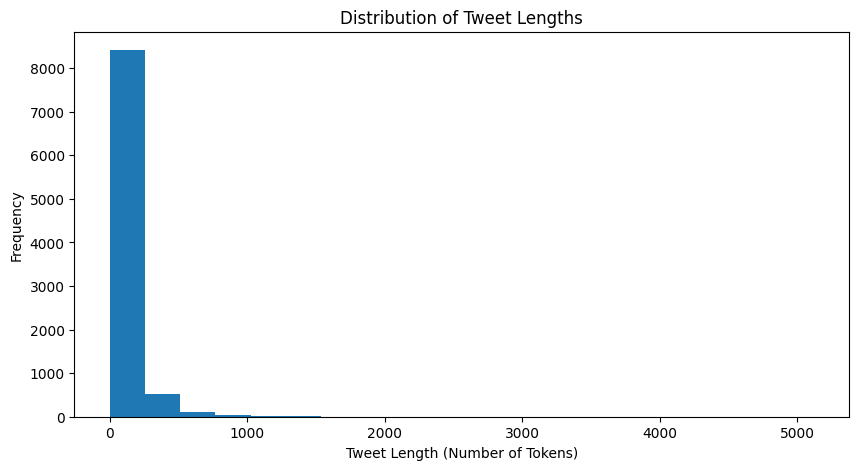

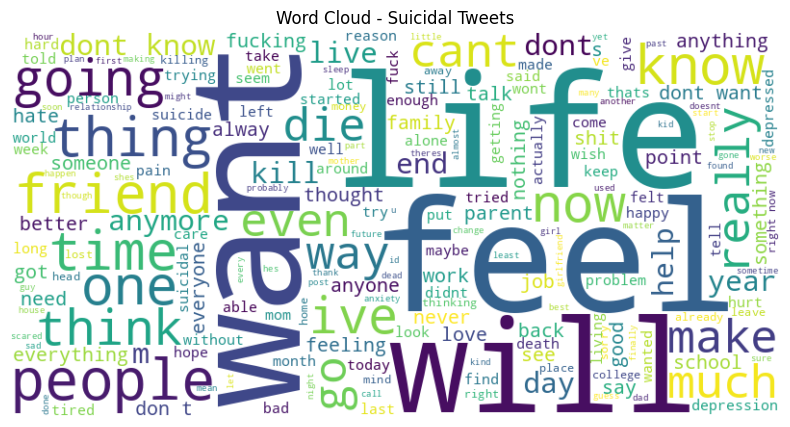

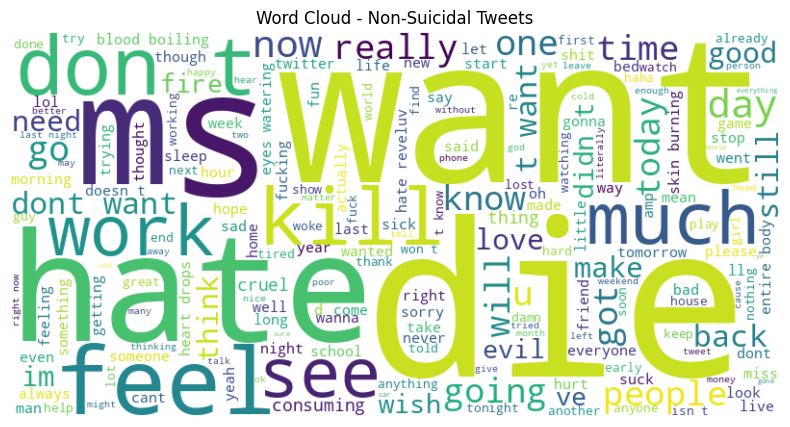

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from gensim.models import KeyedVectors
import nltk
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import string
from sklearn.metrics import ConfusionMatrixDisplay
from tqdm import tqdm
from wordcloud import WordCloud
from sklearn.manifold import TSNE

# 1. Data Preparation and Preprocessing
class TwitterDataset(Dataset):
    def __init__(self, data_path, word2vec_path):
        self.data = self.load_data(data_path)
        self.word2vec = KeyedVectors.load_word2vec_format(word2vec_path, binary=True)
        self.embedding = nn.Embedding.from_pretrained(torch.FloatTensor(self.word2vec.vectors))

    def load_data(self, data_path):
        data = pd.read_csv(data_path, encoding='utf-8')
        return data

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        tweet = self.data.iloc[idx]['tweet']
        intention = self.data.iloc[idx]['intention']
        tokens = nltk.word_tokenize(tweet)
        # Preprocess text
        processed_tokens = [token.lower() for token in tokens if token.isalpha()]
        stop_words = set(nltk.corpus.stopwords.words('english'))
        processed_tokens = [token for token in processed_tokens if token not in stop_words]
        # Convert tokens to word embeddings
        embeddings = [self.word2vec.get_vector(token)
                       for token in processed_tokens
                       if token in self.word2vec.key_to_index]
        # Handle missing words
        if len(embeddings) < len(processed_tokens):
            embeddings += [np.zeros(self.word2vec.vector_size)] * (len(processed_tokens) - len(embeddings))
        # Pad or truncate sequences
        max_length = 196  # Adjust if needed
        if len(embeddings) < max_length:
            embeddings += [np.zeros(self.word2vec.vector_size)] * (max_length - len(embeddings))
        else:
            embeddings = embeddings[:max_length]
        # Convert embeddings to float
        return torch.tensor(embeddings, dtype=torch.float), torch.tensor(intention)

# 2. CNN Model
class CNN(nn.Module):
    def __init__(self, embedding_dim, output_size):
        super(CNN, self).__init__()
        self.embedding_dim = embedding_dim
        self.output_size = output_size

        # Convolutional layers with dynamic padding
        self.conv1 = nn.Conv1d(embedding_dim, 64, kernel_size=3, padding='same')
        self.conv2 = nn.Conv1d(64, 64, kernel_size=5, padding='same')
        self.conv3 = nn.Conv1d(64, 64, kernel_size=7, padding='same')

        # Batch Normalization layers
        self.bn1 = nn.BatchNorm1d(64)
        self.bn2 = nn.BatchNorm1d(64)
        self.bn3 = nn.BatchNorm1d(64)

        # Activation function
        self.relu = nn.ReLU()

        # Max pooling layer
        self.maxpool = nn.MaxPool1d(kernel_size=2, stride=2)

        # Flatten layer
        self.flatten = nn.Flatten()

        # Linear layers
        self.fc1 = nn.Linear(128 * 147, 128)  # Adjusted input size
        self.fc2 = nn.Linear(128, output_size)

        # Dropout layer
        self.dropout = nn.Dropout(0.5)

    def forward(self, x):
        # Transpose the input
        x = x.transpose(1, 2)

        # Apply convolutional layers with Batch Normalization
        x1 = self.relu(self.bn1(self.conv1(x)))
        x2 = self.relu(self.bn2(self.conv2(x1)))
        x3 = self.relu(self.bn3(self.conv3(x2)))

        # Max pooling
        x1 = self.maxpool(x1)
        x2 = self.maxpool(x2)
        x3 = self.maxpool(x3)

        # Concatenate the output from different convolutional layers
        x = torch.cat([x1, x2, x3], dim=1)

        # Flatten the output
        x = self.flatten(x)

        # Apply linear layers with Dropout
        x = self.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.fc2(x)
        return x

# 3. Training and Evaluation
class Trainer:
    def __init__(self, model, optimizer, criterion, device):
        self.model = model
        self.optimizer = optimizer
        self.criterion = criterion
        self.device = device
        self.train_losses = []
        self.val_losses = []
        self.train_accuracies = []
        self.val_accuracies = []
        self.y_true = []
        self.y_pred = []

    def train_step(self, batch):
        self.model.train()
        self.optimizer.zero_grad()
        data, target = batch
        data = data.to(self.device)
        target = target.to(self.device)
        output = self.model(data)
        loss = self.criterion(output, target)
        loss.backward()
        self.optimizer.step()
        return loss.item(), output, target

    def train_epoch(self, train_loader):
        epoch_loss = 0
        correct = 0
        total = 0
        with tqdm(train_loader, unit='batch', leave=False) as tepoch:
            for batch in tepoch:
                loss, output, target = self.train_step(batch)
                epoch_loss += loss
                tepoch.set_description(f'Training Loss: {loss:.4f}')
                total += target.size(0)
                correct += (torch.argmax(output, dim=1) == target).sum().item()
        self.train_losses.append(epoch_loss / len(train_loader))
        self.train_accuracies.append(correct / total)

    def evaluate(self, data_loader, mode='Test'):
        self.model.eval()
        total_loss = 0
        correct = 0
        total = 0
        y_true = []
        y_pred = []

        with torch.no_grad():
            for batch in data_loader:
                data, target = batch
                data = data.to(self.device)
                target = target.to(self.device)
                output = self.model(data)
                loss = self.criterion(output, target)
                total_loss += loss.item()
                y_true.extend(target.tolist())
                y_pred.extend(torch.argmax(output, dim=1).tolist())
                total += target.size(0)
                correct += (torch.argmax(output, dim=1) == target).sum().item()

        accuracy = accuracy_score(y_true, y_pred)
        precision = precision_score(y_true, y_pred)
        recall = recall_score(y_true, y_pred)
        f1 = f1_score(y_true, y_pred)

        print(f'{mode} Loss: {total_loss/len(data_loader):.4f}')
        print(f'{mode} Accuracy: {accuracy:.4f}')
        print(f'{mode} Precision: {precision:.4f}')
        print(f'{mode} Recall: {recall:.4f}')
        print(f'{mode} F1 Score: {f1:.4f}')

        # Confusion matrix
        cm = confusion_matrix(y_true, y_pred)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm)
        disp.plot()
        plt.title(f'{mode} Confusion Matrix')
        plt.show()

        return total_loss/len(data_loader), accuracy, precision, recall, f1

    def train(self, train_loader, val_loader, epochs):
        for epoch in range(epochs):
            print(f"Epoch {epoch+1}")
            self.train_epoch(train_loader)
            _, _, _, _, _ = self.evaluate(train_loader, mode='Train')
            val_loss, val_accuracy, _, _, _ = self.evaluate(val_loader, mode='Validation')
            self.val_losses.append(val_loss)
            self.val_accuracies.append(val_accuracy)

            # Plot every 10 epochs
            if (epoch + 1) % 10 == 0:
                self.plot_metrics()

    def plot_metrics(self):
        # Plot training and validation loss
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses, label='Validation Loss')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss Curves')
        plt.legend()
        plt.show()

        # Plot training and validation accuracy
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_accuracies, label='Training Accuracy')
        plt.plot(self.val_accuracies, label='Validation Accuracy')
        plt.xlabel('Epochs')
        plt.ylabel('Accuracy')
        plt.title('Training and Validation Accuracy Curves')
        plt.legend()
        plt.show()

def run_experiment(batch_size, learning_rate):
    # Initialize model, optimizer, and loss function
    model = CNN(embedding_dim, output_size).to(device)
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    criterion = nn.CrossEntropyLoss() # Using Cross-Entropy Loss
    # Train the model
    trainer = Trainer(model, optimizer, criterion, device)
    trainer.train(train_loader, val_loader, epochs)

if __name__ == '__main__':
    # Define parameters
    data_path = 'twitter-suicidal-data.csv'
    word2vec_path = "/content/drive/MyDrive/Colab Notebooks/GoogleNews-vectors-negative300.bin"
    embedding_dim = 300
    output_size = 2
    epochs = 10
    # Load dataset
    dataset = TwitterDataset(data_path, word2vec_path)
    train_size = int(0.8 * len(dataset))
    val_size = int(0.1 * len(dataset))
    test_size = len(dataset) - train_size - val_size
    train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(dataset, [train_size, val_size, test_size])
    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)
    # Choose device (CPU or GPU if available)
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(device)
    # Experiment with different batch sizes and learning rates
    batch_sizes = [16, 32, 64]
    # learning_rates = [0.001, 0.0001, 0.00001]
    learning_rates = [0.001]
    for batch_size in batch_sizes:
        for learning_rate in learning_rates:
            print(f"Experiment with Batch Size: {batch_size}, Learning Rate: {learning_rate}")
            run_experiment(batch_size, learning_rate)

    # Additional Visualizations
    # Histogram of Tweet Lengths
    plt.figure(figsize=(10, 5))
    plt.hist([len(nltk.word_tokenize(tweet)) for tweet in dataset.data['tweet']], bins=20)
    plt.xlabel('Tweet Length (Number of Tokens)')
    plt.ylabel('Frequency')
    plt.title('Distribution of Tweet Lengths')
    plt.show()

    # Word Cloud
    suicidal_tweets = " ".join(dataset.data[dataset.data['intention'] == 1]['tweet'])
    non_suicidal_tweets = " ".join(dataset.data[dataset.data['intention'] == 0]['tweet'])

    wordcloud_suicidal = WordCloud(width=800, height=400, background_color='white').generate(suicidal_tweets)
    wordcloud_non_suicidal = WordCloud(width=800, height=400, background_color='white').generate(non_suicidal_tweets)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud_suicidal, interpolation='bilinear')
    plt.axis("off")
    plt.title('Word Cloud - Suicidal Tweets')
    plt.show()

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud_non_suicidal, interpolation='bilinear')
    plt.axis("off")
    plt.title('Word Cloud - Non-Suicidal Tweets')
    plt.show()

    # t-SNE Visualization of Embeddings
    embeddings = dataset.word2vec.vectors
    tsne = TSNE(n_components=2, random_state=42)
    embeddings_2d = tsne.fit_transform(embeddings)

    plt.figure(figsize=(10, 10))
    plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1])
    plt.title('t-SNE Visualization of Word Embeddings')
    plt.show()

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from gensim.models import KeyedVectors
import nltk
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import string
from sklearn.metrics import ConfusionMatrixDisplay
from tqdm import tqdm
from wordcloud import WordCloud
from sklearn.manifold import TSNE
model = KeyedVectors.load_word2vec_format("/content/drive/MyDrive/Colab Notebooks/GoogleNews-vectors-negative300.bin", binary=True)
semantically_similar_words = {
"computer": model.most_similar("computer", topn=5),
"football": model.most_similar("football", topn=5),
"ocean": model.most_similar("ocean", topn=5),
"music": model.most_similar("music", topn=5),
}

In [ ]:
semantically_similar_words

{'computer': [('computers', 0.7979379892349243),
  ('laptop', 0.6640493273735046),
  ('laptop_computer', 0.6548868417739868),
  ('Computer', 0.647333562374115),
  ('com_puter', 0.6082080006599426)],
 'football': [('soccer', 0.731354832649231),
  ('fooball', 0.7139959335327148),
  ('Football', 0.7124834060668945),
  ('basketball', 0.668246865272522),
  ('footbal', 0.6649289727210999)],
 'ocean': [('sea', 0.7643541693687439),
  ('oceans', 0.7482994198799133),
  ('Pacific_Ocean', 0.7037094831466675),
  ('Atlantic_Ocean', 0.6659377217292786),
  ('oceanic', 0.6610181927680969)],
 'music': [('classical_music', 0.7197794318199158),
  ('jazz', 0.6834640502929688),
  ('Music', 0.6595720648765564),
  ('Without_Donny_Kirshner', 0.6416222453117371),
  ('songs', 0.6396344304084778)]}

In [ ]:
model.most_similar(positive=["king","queen"], negative=["woman"],
topn=3)


[('kings', 0.6367637515068054),
 ('monarch', 0.5600019693374634),
 ('queens', 0.5444643497467041)]